<a href="https://colab.research.google.com/github/VictoriaGolovitsky/project-brain/blob/main/DeepLearningProject2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

In [ ]:
# Load the dataset
file_path = "healthcare-dataset-stroke-data.csv"
data = pd.read_csv(file_path)

# Data Exploration
print("Dataset Head:")
print(data.head())

Dataset Head:
      id  gender   age  hypertension  heart_disease ever_married  \
0   9046    Male  67.0             0              1          Yes   
1  51676  Female  61.0             0              0          Yes   
2  31112    Male  80.0             0              1          Yes   
3  60182  Female  49.0             0              0          Yes   
4   1665  Female  79.0             1              0          Yes   

       work_type Residence_type  avg_glucose_level   bmi   smoking_status  \
0        Private          Urban             228.69  36.6  formerly smoked   
1  Self-employed          Rural             202.21   NaN     never smoked   
2        Private          Rural             105.92  32.5     never smoked   
3        Private          Urban             171.23  34.4           smokes   
4  Self-employed          Rural             174.12  24.0     never smoked   

   stroke  
0       1  
1       1  
2       1  
3       1  
4       1  


# Data cleaning

In [ ]:
data.drop(['id'], inplace = True, axis = 1)
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5110 entries, 0 to 5109
Data columns (total 11 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   gender             5110 non-null   object 
 1   age                5110 non-null   float64
 2   hypertension       5110 non-null   int64  
 3   heart_disease      5110 non-null   int64  
 4   ever_married       5110 non-null   object 
 5   work_type          5110 non-null   object 
 6   Residence_type     5110 non-null   object 
 7   avg_glucose_level  5110 non-null   float64
 8   bmi                4909 non-null   float64
 9   smoking_status     5110 non-null   object 
 10  stroke             5110 non-null   int64  
dtypes: float64(3), int64(3), object(5)
memory usage: 439.3+ KB


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5110 entries, 0 to 5109
Data columns (total 11 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   gender             5110 non-null   object 
 1   age                5110 non-null   float64
 2   hypertension       5110 non-null   int64  
 3   heart_disease      5110 non-null   int64  
 4   ever_married       5110 non-null   object 
 5   work_type          5110 non-null   object 
 6   Residence_type     5110 non-null   object 
 7   avg_glucose_level  5110 non-null   float64
 8   bmi                4909 non-null   float64
 9   smoking_status     5110 non-null   object 
 10  stroke             5110 non-null   int64  
dtypes: float64(3), int64(3), object(5)
memory usage: 439.3+ KB


In [ ]:
data['hypertension'] = data['hypertension'].astype('category')
data['heart_disease'] = data['heart_disease'].astype('category')
data['smoking_status'] = data['smoking_status'].astype('category')
data['gender'] = data['gender'].astype('category')
data['ever_married'] = data['ever_married'].astype('category')
data['work_type'] = data['work_type'].astype('category')
data['Residence_type'] = data['Residence_type'].astype('category')
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5110 entries, 0 to 5109
Data columns (total 11 columns):
 #   Column             Non-Null Count  Dtype   
---  ------             --------------  -----   
 0   gender             5110 non-null   category
 1   age                5110 non-null   float64 
 2   hypertension       5110 non-null   category
 3   heart_disease      5110 non-null   category
 4   ever_married       5110 non-null   category
 5   work_type          5110 non-null   category
 6   Residence_type     5110 non-null   category
 7   avg_glucose_level  5110 non-null   float64 
 8   bmi                4909 non-null   float64 
 9   smoking_status     5110 non-null   category
 10  stroke             5110 non-null   int64   
dtypes: category(7), float64(3), int64(1)
memory usage: 195.8 KB


### Filling missing BMI values ###

In [ ]:
# Debugging: Check initial smoking_status distribution
print("Before handling 'Unknown':")
print(data['smoking_status'].value_counts())

# Step 1: Assign 'never smoked' to children under 14 with 'Unknown'
data.loc[(data['age'] < 14) & (data['smoking_status'] == "Unknown"), 'smoking_status'] = "never smoked"

# Debugging: Check if any 'Unknown' remains for children
print("After assigning 'never smoked' to children under 14:")
print(data['smoking_status'].value_counts())

# Step 2: Split rows for training and testing
train_data = data[data['smoking_status'] != "Unknown"]
test_data = data[data['smoking_status'] == "Unknown"]

# Debugging: Check test_data size
print(f"Number of rows in test_data with 'Unknown': {len(test_data)}")

# Verify test_data content
if not test_data.empty:
    print("Test data includes:")
    print(test_data.head())

Before handling 'Unknown':
smoking_status
never smoked       1892
Unknown            1544
formerly smoked     885
smokes              789
Name: count, dtype: int64
After assigning 'never smoked' to children under 14:
smoking_status
never smoked       2477
Unknown             959
formerly smoked     885
smokes              789
Name: count, dtype: int64
Number of rows in test_data with 'Unknown': 959
Test data includes:
    gender   age hypertension heart_disease ever_married work_type  \
8   Female  59.0            0             0          Yes   Private   
9   Female  78.0            0             0          Yes   Private   
13    Male  78.0            0             1          Yes   Private   
19    Male  57.0            0             1           No  Govt_job   
23    Male  82.0            0             1          Yes   Private   

   Residence_type  avg_glucose_level   bmi smoking_status  stroke  
8           Rural              76.15   NaN        Unknown       1  
9           Urban    

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder, StandardScaler

# Step 1: Encode categorical features in both train_data and test_data
categorical_features = ['ever_married', 'work_type', 'Residence_type']

# Create a LabelEncoder for each categorical feature
label_encoders = {col: LabelEncoder() for col in categorical_features}

# Encode the categorical features
for col in categorical_features:
    train_data[col] = label_encoders[col].fit_transform(train_data[col])
    test_data[col] = label_encoders[col].transform(test_data[col])

# Step 2: Prepare features and labels
features = ['age', 'ever_married', 'work_type', 'Residence_type', 'avg_glucose_level', 'bmi']
X_train = train_data[features]
y_train = train_data['smoking_status']

# Encode target labels (smoking_status)
label_encoder_smoking = LabelEncoder()
y_train_encoded = label_encoder_smoking.fit_transform(y_train)

# Scale features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)

# Prepare features for test_data
X_test = test_data[features]
X_test_scaled = scaler.transform(X_test)

# Step 3: Train the RandomForestClassifier
smoking_model = RandomForestClassifier(random_state=42)
smoking_model.fit(X_train_scaled, y_train_encoded)

# Step 4: Predict for test_data
y_test_pred_encoded = smoking_model.predict(X_test_scaled)
y_test_pred = label_encoder_smoking.inverse_transform(y_test_pred_encoded)

# Step 5: Fill the missing smoking_status values
data.loc[data['smoking_status'] == "Unknown", 'smoking_status'] = y_test_pred

# Verify the changes
print("Updated smoking_status values:")
print(data['smoking_status'].value_counts())

<ipython-input-7-000e1dbe9e01>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_data[col] = label_encoders[col].fit_transform(train_data[col])
<ipython-input-7-000e1dbe9e01>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_data[col] = label_encoders[col].transform(test_data[col])
<ipython-input-7-000e1dbe9e01>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentati

Updated smoking_status values:
smoking_status
never smoked       3199
formerly smoked    1014
smokes              897
Unknown               0
Name: count, dtype: int64


In [ ]:
print(data['smoking_status'].unique())

['formerly smoked', 'never smoked', 'smokes']
Categories (4, object): ['Unknown', 'formerly smoked', 'never smoked', 'smokes']


In [ ]:
from scipy.stats import pointbiserialr, pearsonr
import pandas as pd
import numpy as np
from itertools import combinations

# Assuming `df` is the dataset
non_missing_bmi = data[data['bmi'].notnull()]

# Initialize dictionary to store correlations
correlations = {}

# Numeric columns
numeric_columns = ['age', 'avg_glucose_level']

# Compute correlations for numeric columns
for col in numeric_columns:
    correlation, _ = pearsonr(non_missing_bmi[col], non_missing_bmi['bmi'])
    correlations[col] = correlation

# Categorical columns
categorical_columns = ['gender', 'work_type', 'Residence_type', 'smoking_status', 'ever_married']

# Compute correlations for categorical columns
for col in categorical_columns:
    unique_values = non_missing_bmi[col].unique()
    correlations[col] = {}
    for value in unique_values:
        binary_col = non_missing_bmi[col].apply(lambda x: 1 if x == value else 0)
        correlation, _ = pointbiserialr(binary_col, non_missing_bmi['bmi'])
        correlations[col][value] = correlation

# Compute correlations for combinations of features
feature_combinations = list(combinations(categorical_columns + numeric_columns, 2))

# Store combined feature correlations
combined_correlations = {}

for feature1, feature2 in feature_combinations:
    if feature1 in categorical_columns:
        # One-hot encode feature1
        one_hot_1 = pd.get_dummies(non_missing_bmi[feature1], prefix=feature1)
    else:
        one_hot_1 = non_missing_bmi[[feature1]]

    if feature2 in categorical_columns:
        # One-hot encode feature2
        one_hot_2 = pd.get_dummies(non_missing_bmi[feature2], prefix=feature2)
    else:
        one_hot_2 = non_missing_bmi[[feature2]]

    # Combine one-hot encoded features
    combined_features = pd.concat([one_hot_1, one_hot_2], axis=1)

    # Compute correlation with bmi
    combined_corr = combined_features.corrwith(non_missing_bmi['bmi'])
    combined_correlations[f"{feature1} & {feature2}"] = combined_corr

# Print individual and combined correlations
print("Individual Correlations:")
for key, value in correlations.items():
    print(f"{key}: {value}")

print("\nCombined Correlations:")
for key, value in combined_correlations.items():
    print(f"{key}: {value}")

threshold = 0.3
strong_correlations = {key: val for key, val in correlations.items() if isinstance(val, dict) and any(abs(v) > threshold for v in val.values())}
strong_combined_correlations = {key: val for key, val in combined_correlations.items() if any(abs(v) > threshold for v in val.values)}

print("Strong Individual Correlations:", strong_correlations)
print("Strong Combined Correlations:", strong_combined_correlations)


Individual Correlations:
age: 0.33339799516043944
avg_glucose_level: 0.17550217613626068
gender: {'Male': -0.026019865041934064, 'Female': 0.02636035749848806, 'Other': -0.011802081897688646}
work_type: {'Private': 0.20802890595535736, 'Self-employed': 0.07270086116871444, 'Govt_job': 0.07958360930247275, 'children': -0.4486735569407565, 'Never_worked': -0.02860204203744405}
Residence_type: {'Urban': -0.0001224411931268165, 'Rural': 0.0001224411931268165}
smoking_status: {'formerly smoked': 0.12356171758029923, 'never smoked': -0.18300996335951578, 'smokes': 0.10459084778401498}
ever_married: {'Yes': 0.3416946515968082, 'No': -0.3416946515968082}

Combined Correlations:
gender & work_type: gender_Female              0.026360
gender_Male               -0.026020
gender_Other              -0.011802
work_type_Govt_job         0.079584
work_type_Never_worked    -0.028602
work_type_Private          0.208029
work_type_Self-employed    0.072701
work_type_children        -0.448674
dtype: float6

/usr/local/lib/python3.11/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/local/lib/python3.11/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/usr/local/lib/python3.11/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/local/lib/python3.11/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/usr/local/lib/python3.11/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/local/lib/python3.11/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/usr/local/lib/python3.11/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encounter

In [ ]:
from itertools import combinations

# Initialize dictionary to store 3-feature combined correlations
three_combined_correlations = {}

# Get all combinations of 3 features
feature_combinations_3 = list(combinations(categorical_columns + numeric_columns, 3))

for feature1, feature2, feature3 in feature_combinations_3:
    # Handle first feature
    if feature1 in categorical_columns:
        one_hot_1 = pd.get_dummies(non_missing_bmi[feature1], prefix=feature1)
    else:
        one_hot_1 = non_missing_bmi[[feature1]]

    # Handle second feature
    if feature2 in categorical_columns:
        one_hot_2 = pd.get_dummies(non_missing_bmi[feature2], prefix=feature2)
    else:
        one_hot_2 = non_missing_bmi[[feature2]]

    # Handle third feature
    if feature3 in categorical_columns:
        one_hot_3 = pd.get_dummies(non_missing_bmi[feature3], prefix=feature3)
    else:
        one_hot_3 = non_missing_bmi[[feature3]]

    # Combine one-hot encoded features
    combined_features = pd.concat([one_hot_1, one_hot_2, one_hot_3], axis=1)

    # Compute correlation with bmi
    combined_corr = combined_features.corrwith(non_missing_bmi['bmi'])
    three_combined_correlations[f"{feature1} & {feature2} & {feature3}"] = combined_corr

# Print 3-feature combined correlations
print("\nThree-Feature Combined Correlations:")
for key, value in three_combined_correlations.items():
    print(f"{key}: {value}")

threshold = 0.3
strong_three_combined_correlations = {
    key: val for key, val in three_combined_correlations.items() if any(abs(v) > threshold for v in val.values)
}

print("\nStrong Three-Feature Combined Correlations:")
for key, value in strong_three_combined_correlations.items():
    print(f"{key}: {value}")

/usr/local/lib/python3.11/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/local/lib/python3.11/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/usr/local/lib/python3.11/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/local/lib/python3.11/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/usr/local/lib/python3.11/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/local/lib/python3.11/dist-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
/usr/local/lib/python3.11/dist-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encounter


Three-Feature Combined Correlations:
gender & work_type & Residence_type: gender_Female              0.026360
gender_Male               -0.026020
gender_Other              -0.011802
work_type_Govt_job         0.079584
work_type_Never_worked    -0.028602
work_type_Private          0.208029
work_type_Self-employed    0.072701
work_type_children        -0.448674
Residence_type_Rural       0.000122
Residence_type_Urban      -0.000122
dtype: float64
gender & work_type & smoking_status: gender_Female                     0.026360
gender_Male                      -0.026020
gender_Other                     -0.011802
work_type_Govt_job                0.079584
work_type_Never_worked           -0.028602
work_type_Private                 0.208029
work_type_Self-employed           0.072701
work_type_children               -0.448674
smoking_status_Unknown                 NaN
smoking_status_formerly smoked    0.123562
smoking_status_never smoked      -0.183010
smoking_status_smokes             0.1045

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
import pandas as pd
import numpy as np

# Step 1: Prepare Data
# Select features based on correlation analysis
features = ['age', 'gender', 'work_type', 'avg_glucose_level', 'ever_married', 'Residence_type', 'smoking_status']

# Encode categorical variables
label_encoders = {}
for col in ['gender', 'work_type', 'ever_married', 'Residence_type', 'smoking_status']:
    label_encoders[col] = LabelEncoder()
    data[col] = label_encoders[col].fit_transform(data[col])

# Split data into rows with and without missing BMI values
non_missing_bmi = data[data['bmi'].notnull()]
missing_bmi = data[data['bmi'].isnull()]

# Extract features and target for training
X = non_missing_bmi[features]
y = non_missing_bmi['bmi']

# Features for predicting missing BMI
X_missing = missing_bmi[features]

# Step 2: Split Training Data
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 3: Scale the Features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_val_scaled = scaler.transform(X_val)
X_missing_scaled = scaler.transform(X_missing)

# Step 4: Train the Random Forest Regressor
bmi_model = RandomForestRegressor(random_state=42, n_estimators=100)
bmi_model.fit(X_train_scaled, y_train)

# Step 5: Evaluate the Model
val_predictions = bmi_model.predict(X_val_scaled)
val_mae = np.mean(abs(val_predictions - y_val))
print(f"Validation Mean Absolute Error: {val_mae:.2f}")

# Step 6: Predict Missing BMI Values
missing_bmi_predictions = bmi_model.predict(X_missing_scaled)

# Step 7: Fill Missing BMI Values
data.loc[data['bmi'].isnull(), 'bmi'] = missing_bmi_predictions

# Verify the imputation
print("Missing BMI values filled successfully.")
print(data['bmi'].isnull().sum())

Validation Mean Absolute Error: 5.49
Missing BMI values filled successfully.
0


# First model- Costom Sequential



Run 1: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7481 - loss: 1.2318 - val_accuracy: 0.7650 - val_loss: 0.4806
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7893 - loss: 1.0915 - val_accuracy: 0.8098 - val_loss: 0.4229
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8116 - loss: 0.9944 - val_accuracy: 0.8093 - val_loss: 0.4167
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8142 - loss: 1.0023 - val_accuracy: 0.8082 - val_loss: 0.4316
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8235 - loss: 0.9621 - val_accuracy: 0.8293 - val_loss: 0.4023
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8216 - loss: 0.9582 - val_accuracy: 0.8344 - val_loss: 0.3879
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - ac

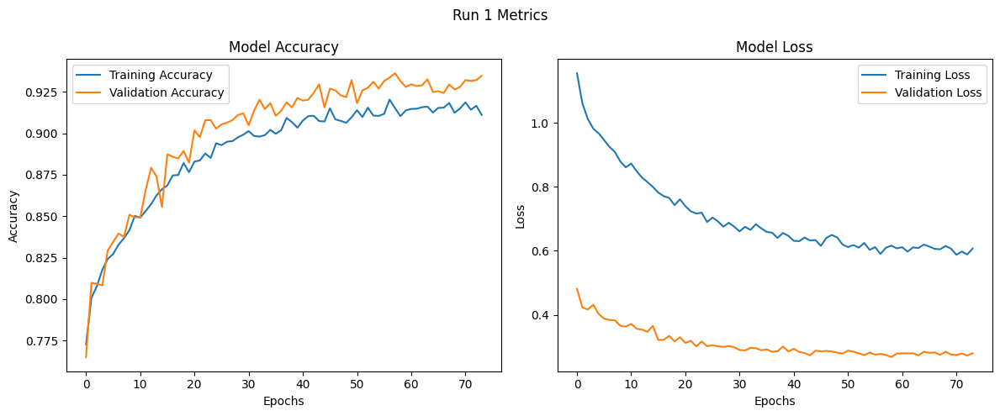

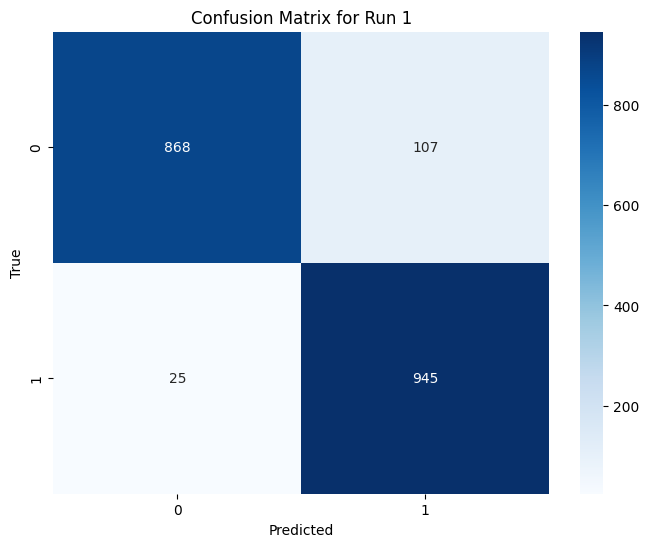

Run 2: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - accuracy: 0.7315 - loss: 1.2558 - val_accuracy: 0.7959 - val_loss: 0.4621
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8030 - loss: 1.0841 - val_accuracy: 0.8031 - val_loss: 0.4450
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8015 - loss: 1.0718 - val_accuracy: 0.8087 - val_loss: 0.4251
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.8119 - loss: 1.0003 - val_accuracy: 0.8057 - val_loss: 0.4324
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8157 - loss: 0.9711 - val_accuracy: 0.8283 - val_loss: 0.4079
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8368 - loss: 0.9387 - val_accuracy: 0.8221 - val_loss: 0.4009
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - a

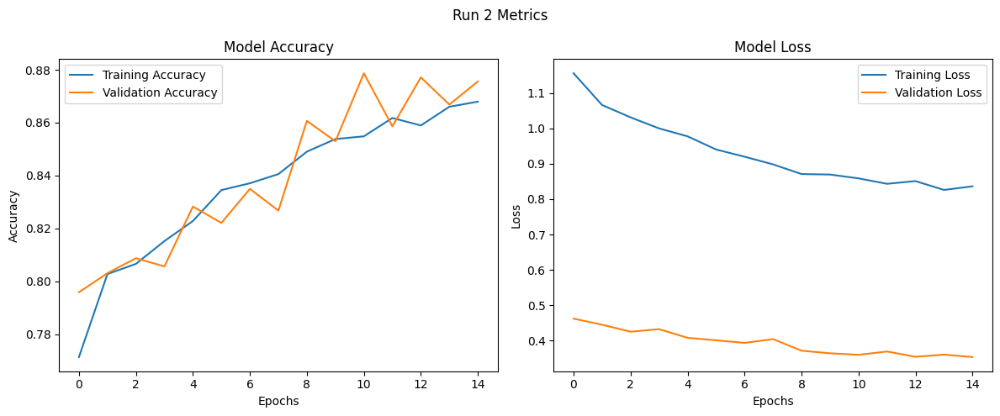

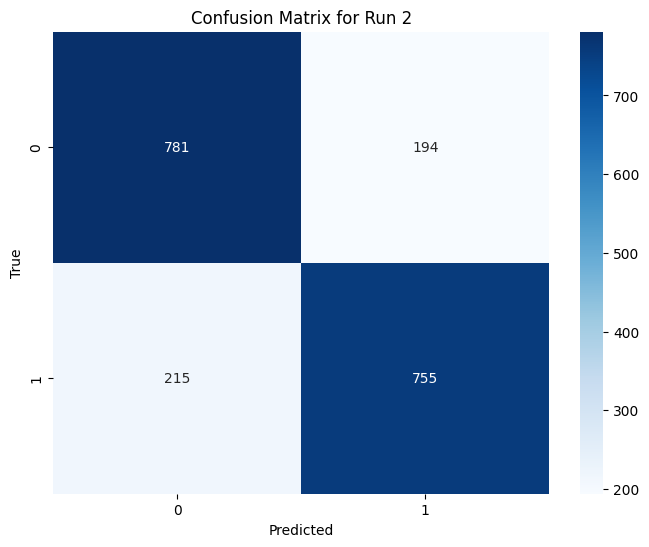

Run 3: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 0.7460 - loss: 1.2309 - val_accuracy: 0.7897 - val_loss: 0.4747
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7886 - loss: 1.0901 - val_accuracy: 0.7882 - val_loss: 0.4570
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8073 - loss: 1.0286 - val_accuracy: 0.8021 - val_loss: 0.4463
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8150 - loss: 1.0123 - val_accuracy: 0.8000 - val_loss: 0.4383
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8235 - loss: 1.0044 - val_accuracy: 0.8201 - val_loss: 0.4234
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8142 - loss: 1.0143 - val_accuracy: 0.8180 - val_loss: 0.4149
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - acc

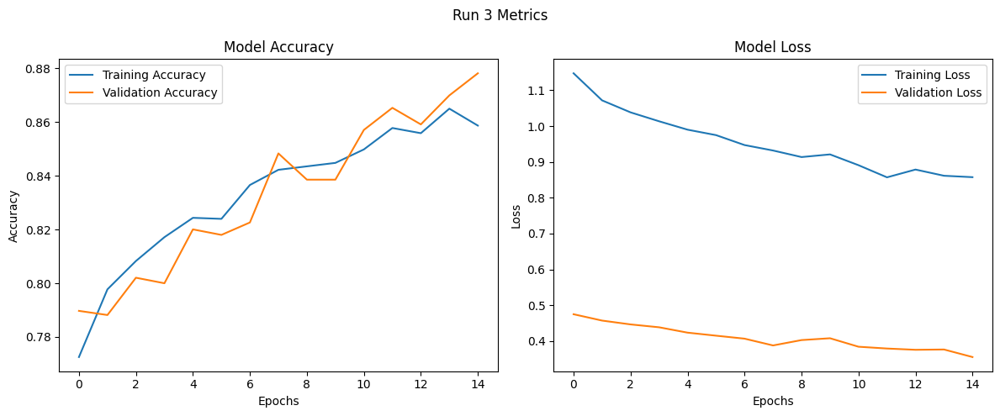

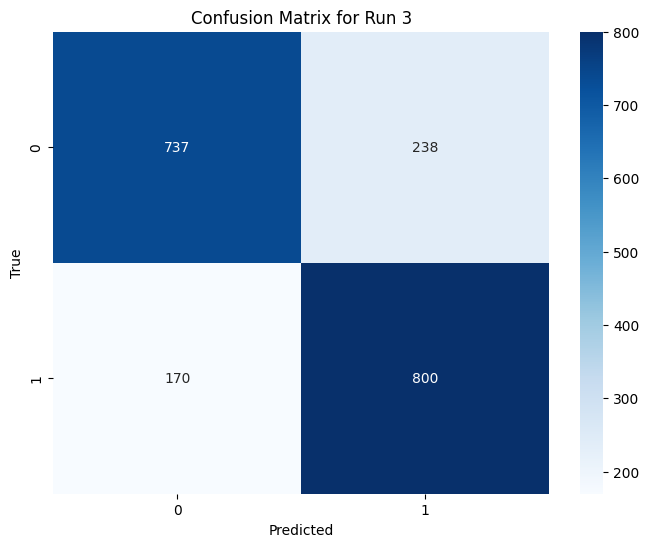

Run 4: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - accuracy: 0.7531 - loss: 1.7420 - val_accuracy: 0.7851 - val_loss: 0.4568
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7966 - loss: 1.5164 - val_accuracy: 0.8103 - val_loss: 0.4258
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8062 - loss: 1.4660 - val_accuracy: 0.8072 - val_loss: 0.4139
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8226 - loss: 1.3696 - val_accuracy: 0.8185 - val_loss: 0.4083
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8226 - loss: 1.3670 - val_accuracy: 0.8129 - val_loss: 0.4068
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8323 - loss: 1.2989 - val_accuracy: 0.8530 - val_loss: 0.3742
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - ac

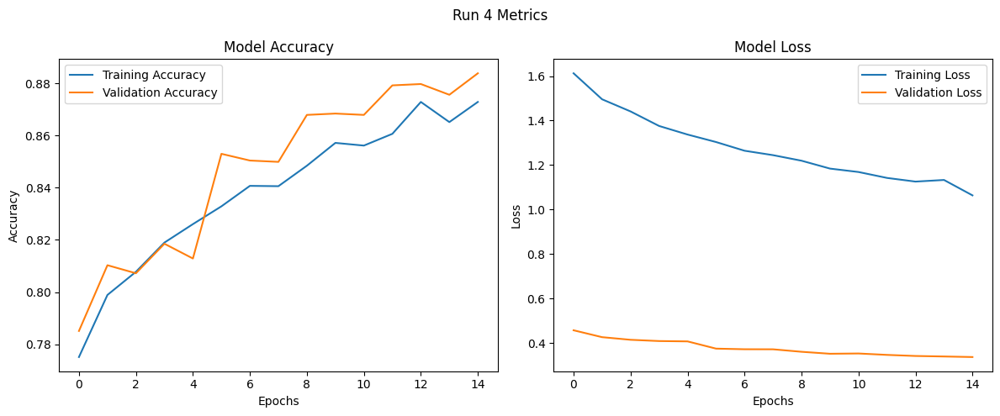

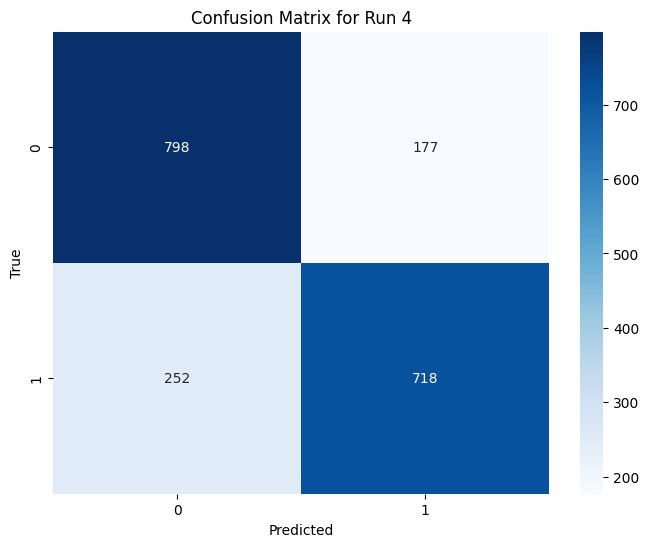

Run 5: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - accuracy: 0.7610 - loss: 1.7513 - val_accuracy: 0.7882 - val_loss: 0.4497
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7950 - loss: 1.5176 - val_accuracy: 0.7995 - val_loss: 0.4338
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8076 - loss: 1.4159 - val_accuracy: 0.8005 - val_loss: 0.4216
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8091 - loss: 1.4258 - val_accuracy: 0.8175 - val_loss: 0.4105
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8175 - loss: 1.3933 - val_accuracy: 0.8380 - val_loss: 0.3901
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8366 - loss: 1.3356 - val_accuracy: 0.8427 - val_loss: 0.3836
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - a

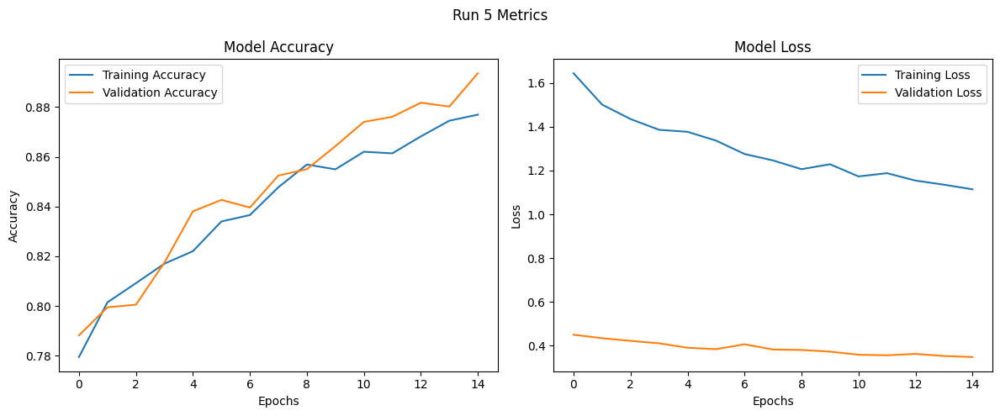

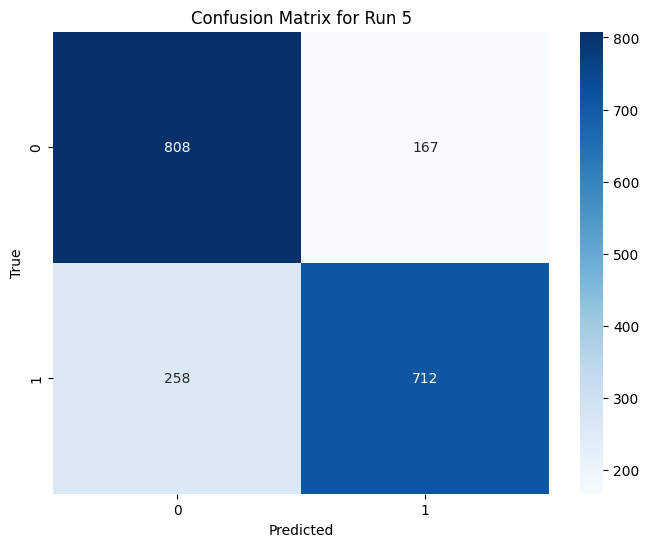

Run 6: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 0.7509 - loss: 1.7173 - val_accuracy: 0.7882 - val_loss: 0.4694
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8102 - loss: 1.5011 - val_accuracy: 0.8026 - val_loss: 0.4321
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8042 - loss: 1.4471 - val_accuracy: 0.8159 - val_loss: 0.4201
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8147 - loss: 1.4004 - val_accuracy: 0.8252 - val_loss: 0.4088
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8312 - loss: 1.3576 - val_accuracy: 0.8298 - val_loss: 0.4155
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8230 - loss: 1.3735 - val_accuracy: 0.8314 - val_loss: 0.4052
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - acc

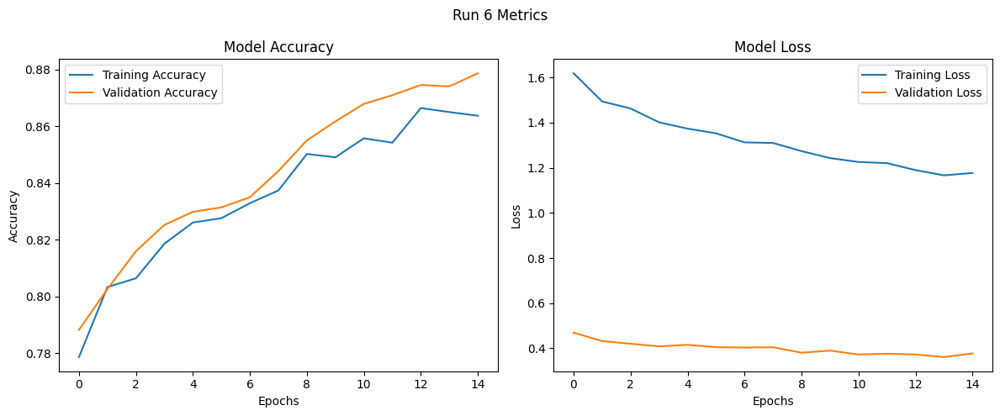

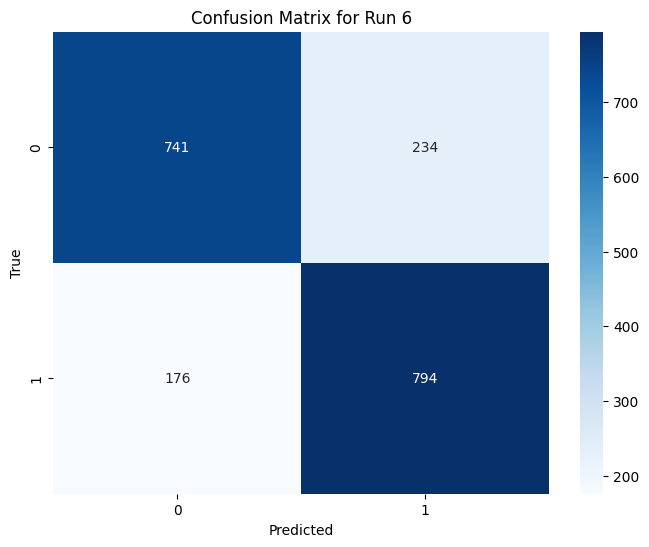

Run 7: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 0.7420 - loss: 1.2519 - val_accuracy: 0.7964 - val_loss: 0.4569
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7973 - loss: 1.0450 - val_accuracy: 0.8000 - val_loss: 0.4436
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8171 - loss: 1.0036 - val_accuracy: 0.8108 - val_loss: 0.4197
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8128 - loss: 0.9879 - val_accuracy: 0.8113 - val_loss: 0.4117
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8183 - loss: 0.9767 - val_accuracy: 0.8278 - val_loss: 0.3881
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8326 - loss: 0.9426 - val_accuracy: 0.8288 - val_loss: 0.3917
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - a

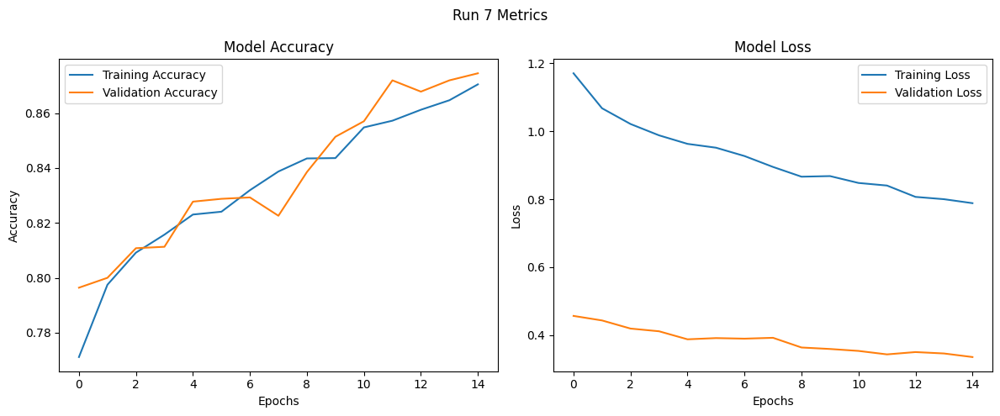

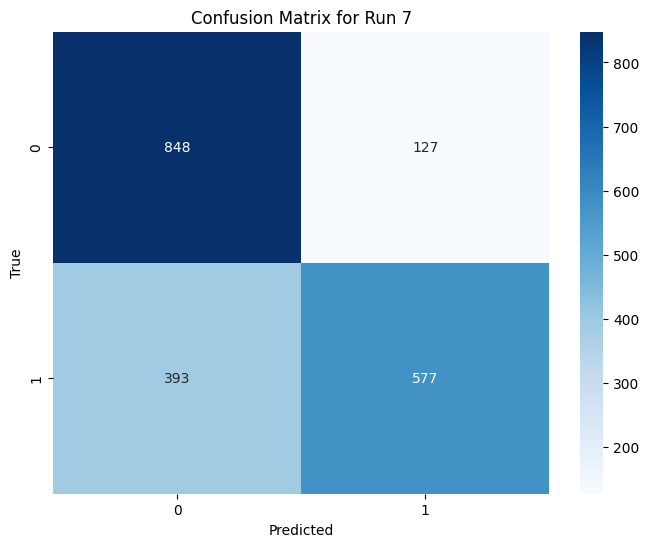

Run 8: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - accuracy: 0.7300 - loss: 1.2516 - val_accuracy: 0.7830 - val_loss: 0.4570
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7905 - loss: 1.0668 - val_accuracy: 0.8098 - val_loss: 0.4355
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8007 - loss: 1.0399 - val_accuracy: 0.8072 - val_loss: 0.4219
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8125 - loss: 0.9750 - val_accuracy: 0.7913 - val_loss: 0.4398
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8164 - loss: 0.9805 - val_accuracy: 0.8303 - val_loss: 0.3882
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8184 - loss: 0.9699 - val_accuracy: 0.8201 - val_loss: 0.4089
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - 

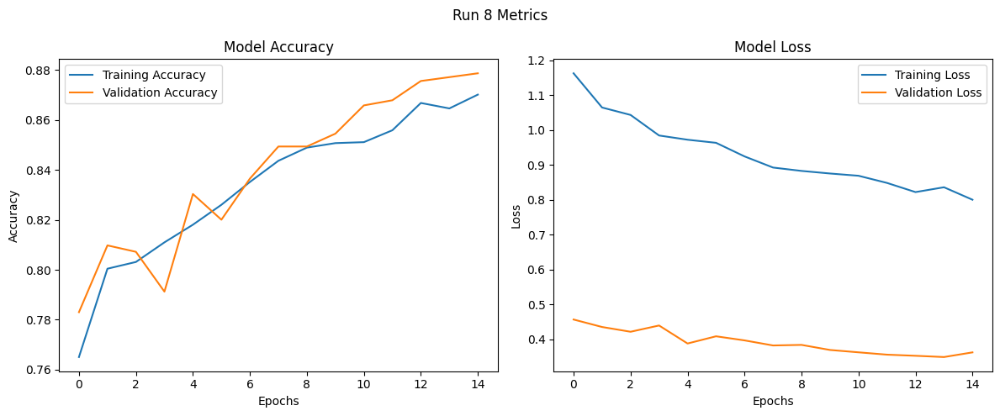

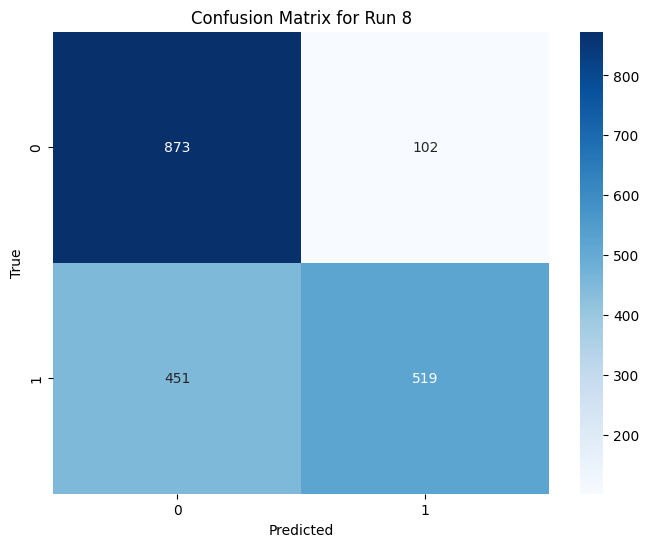

Run 9: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step - accuracy: 0.7386 - loss: 1.2467 - val_accuracy: 0.8015 - val_loss: 0.4503
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.7989 - loss: 1.0784 - val_accuracy: 0.8051 - val_loss: 0.4403
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8104 - loss: 1.0082 - val_accuracy: 0.8036 - val_loss: 0.4414
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8211 - loss: 0.9915 - val_accuracy: 0.8026 - val_loss: 0.4313
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8212 - loss: 0.9888 - val_accuracy: 0.8216 - val_loss: 0.4095
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8274 - loss: 0.9818 - val_accuracy: 0.8370 - val_loss: 0.4018
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - ac

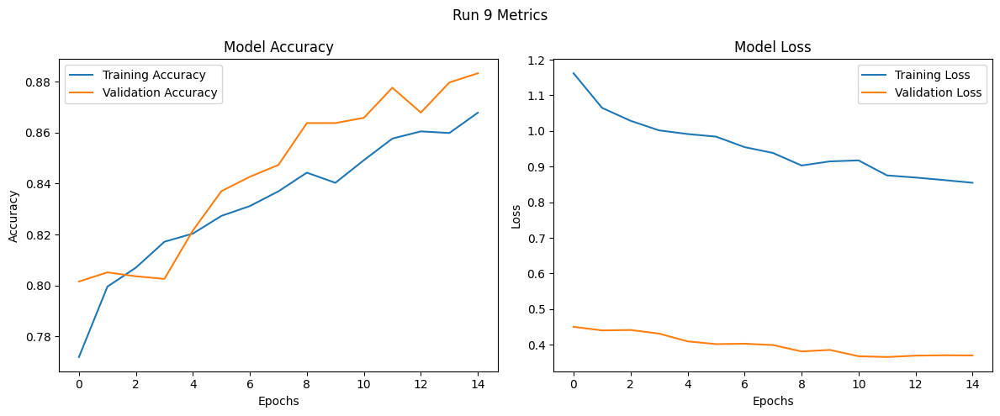

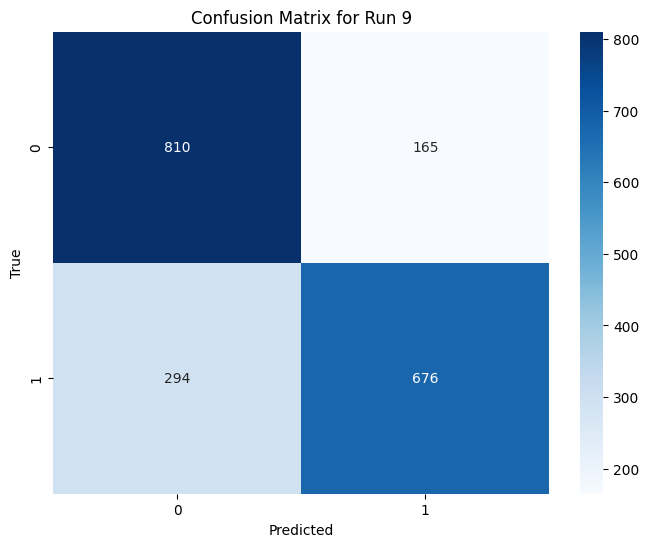

Run 10: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - accuracy: 0.7450 - loss: 1.7676 - val_accuracy: 0.8015 - val_loss: 0.4499
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8019 - loss: 1.5220 - val_accuracy: 0.8082 - val_loss: 0.4258
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8038 - loss: 1.4461 - val_accuracy: 0.8113 - val_loss: 0.4217
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8170 - loss: 1.4043 - val_accuracy: 0.8113 - val_loss: 0.4115
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8287 - loss: 1.3254 - val_accuracy: 0.8175 - val_loss: 0.3999
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8196 - loss: 1.3570 - val_accuracy: 0.8252 - val_loss: 0.3895
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - 

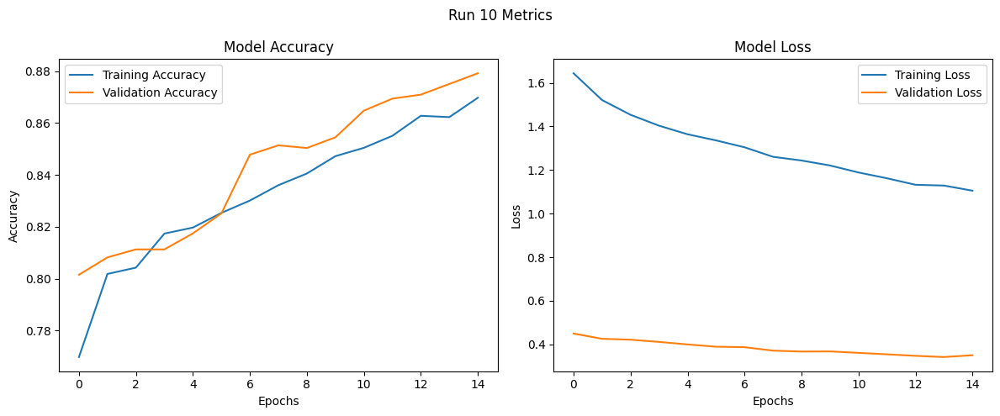

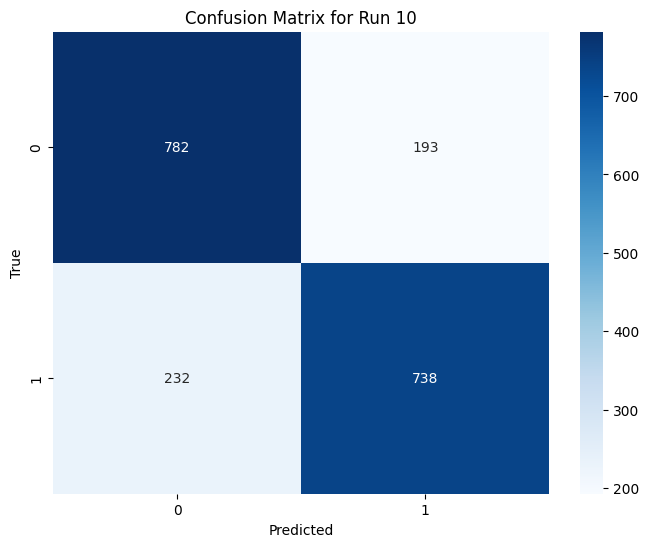

Run 11: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - accuracy: 0.7414 - loss: 1.7479 - val_accuracy: 0.7995 - val_loss: 0.4500
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8023 - loss: 1.4925 - val_accuracy: 0.8005 - val_loss: 0.4357
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8132 - loss: 1.4420 - val_accuracy: 0.8170 - val_loss: 0.4140
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8328 - loss: 1.3354 - val_accuracy: 0.8324 - val_loss: 0.3995
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8259 - loss: 1.3401 - val_accuracy: 0.8370 - val_loss: 0.3968
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8361 - loss: 1.2952 - val_accuracy: 0.8329 - val_loss: 0.3988
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step -

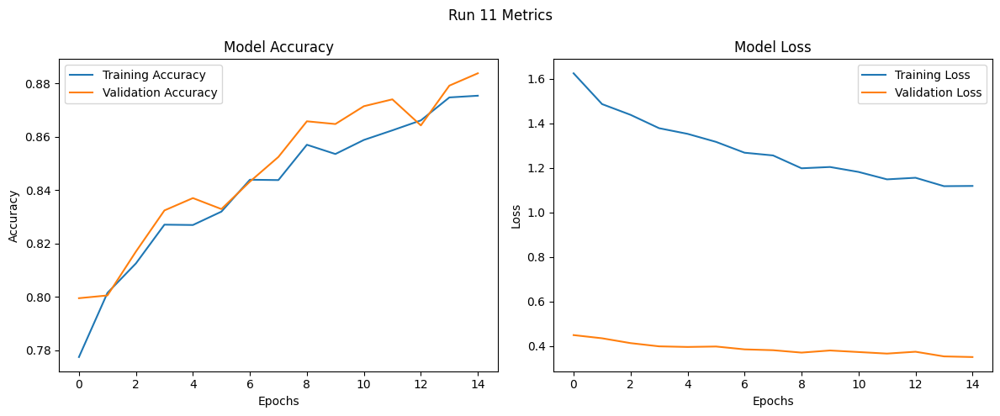

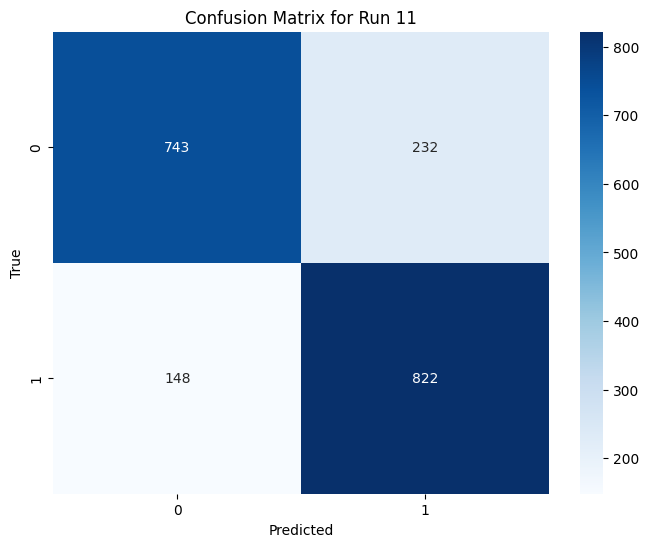

Run 12: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7521 - loss: 1.7501 - val_accuracy: 0.7918 - val_loss: 0.4511
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.7870 - loss: 1.5415 - val_accuracy: 0.8098 - val_loss: 0.4423
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8141 - loss: 1.4482 - val_accuracy: 0.8139 - val_loss: 0.4239
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8156 - loss: 1.4204 - val_accuracy: 0.8103 - val_loss: 0.4364
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8254 - loss: 1.3842 - val_accuracy: 0.8339 - val_loss: 0.4109
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8330 - loss: 1.3244 - val_accuracy: 0.8355 - val_loss: 0.4104
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - 

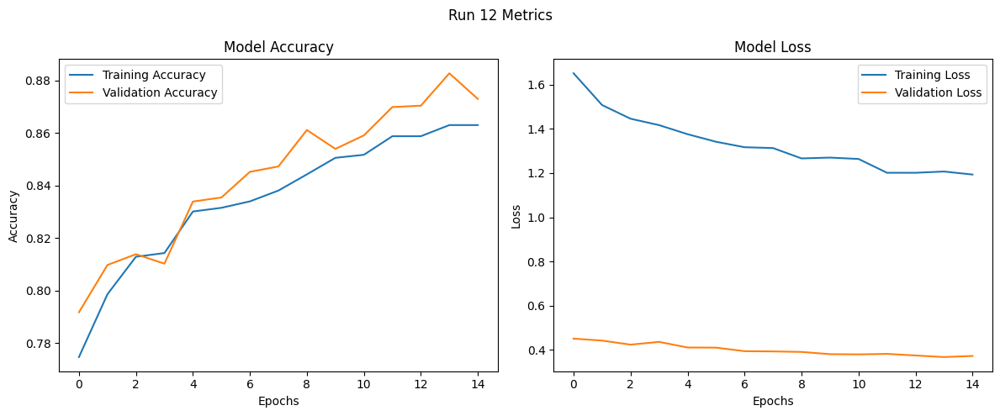

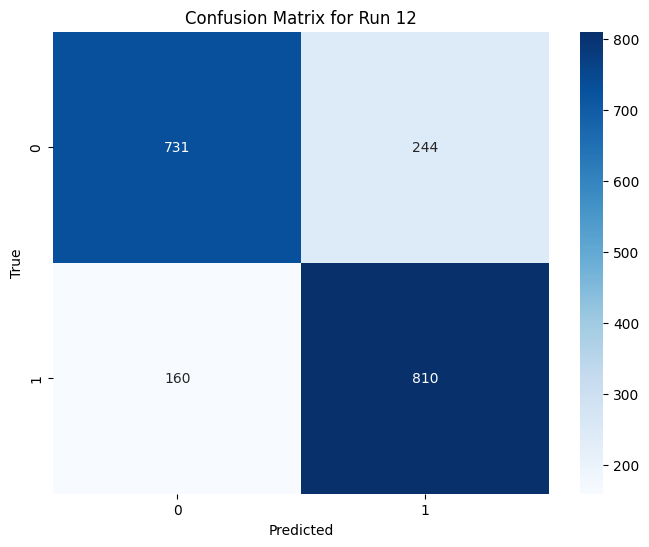

Run 13: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - accuracy: 0.7394 - loss: 0.4342 - val_accuracy: 0.7990 - val_loss: 0.1544
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8007 - loss: 0.3483 - val_accuracy: 0.8108 - val_loss: 0.1495
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8186 - loss: 0.3287 - val_accuracy: 0.7990 - val_loss: 0.1536
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8261 - loss: 0.3267 - val_accuracy: 0.8067 - val_loss: 0.1454
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8285 - loss: 0.3111 - val_accuracy: 0.8298 - val_loss: 0.1382
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8341 - loss: 0.3111 - val_accuracy: 0.8185 - val_loss: 0.1457
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accurac

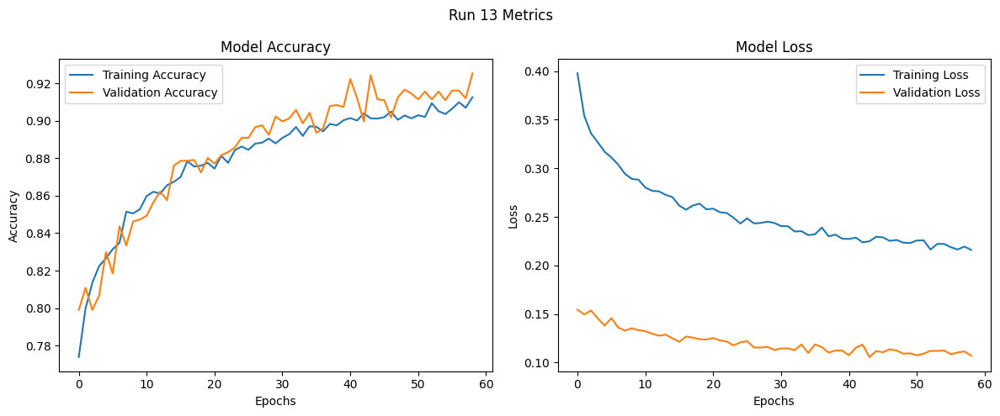

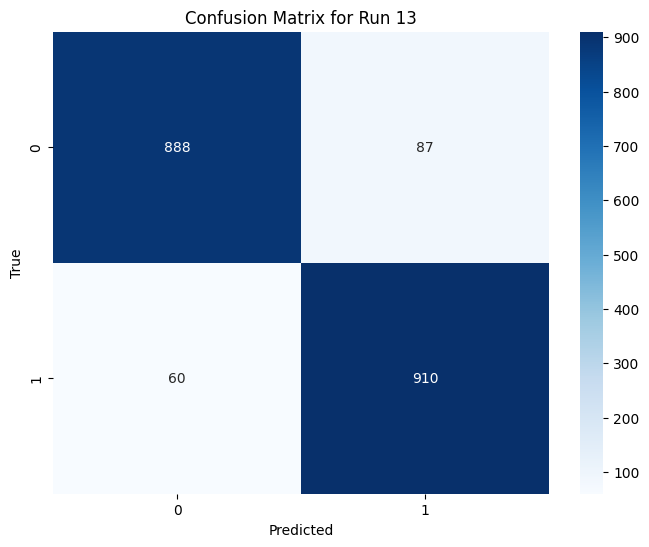

Run 14: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7482 - loss: 0.4210 - val_accuracy: 0.7743 - val_loss: 0.1628
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7954 - loss: 0.3604 - val_accuracy: 0.8031 - val_loss: 0.1496
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8156 - loss: 0.3372 - val_accuracy: 0.8046 - val_loss: 0.1475
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8263 - loss: 0.3300 - val_accuracy: 0.8165 - val_loss: 0.1448
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8285 - loss: 0.3194 - val_accuracy: 0.8180 - val_loss: 0.1441
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8321 - loss: 0.3216 - val_accuracy: 0.8237 - val_loss: 0.1444
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accura

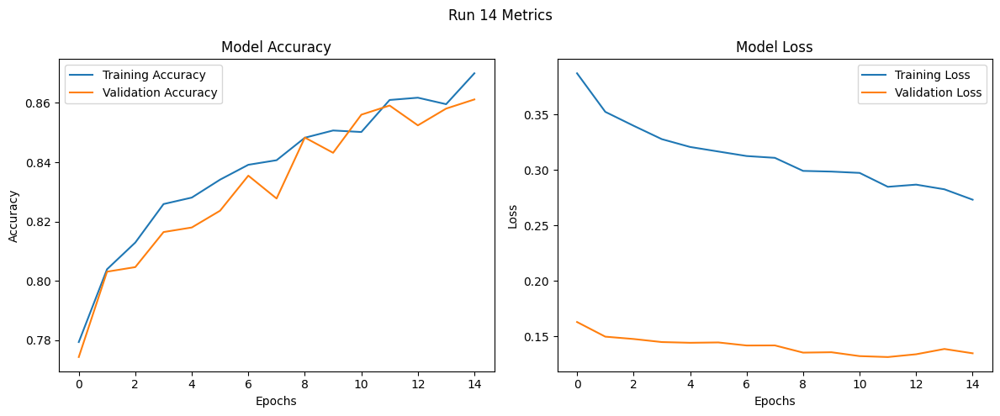

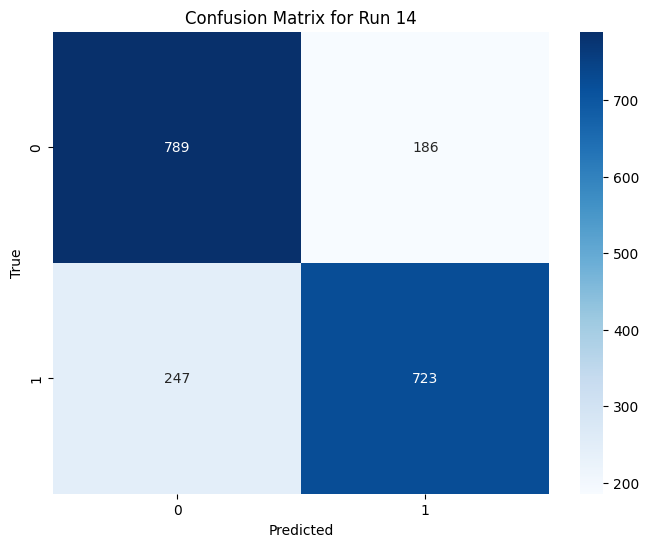

Run 15: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7512 - loss: 0.4174 - val_accuracy: 0.8057 - val_loss: 0.1528
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7986 - loss: 0.3534 - val_accuracy: 0.8010 - val_loss: 0.1548
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8147 - loss: 0.3462 - val_accuracy: 0.8041 - val_loss: 0.1497
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8143 - loss: 0.3391 - val_accuracy: 0.8123 - val_loss: 0.1501
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8311 - loss: 0.3225 - val_accuracy: 0.8031 - val_loss: 0.1577
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8312 - loss: 0.3165 - val_accuracy: 0.8195 - val_loss: 0.1505
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy

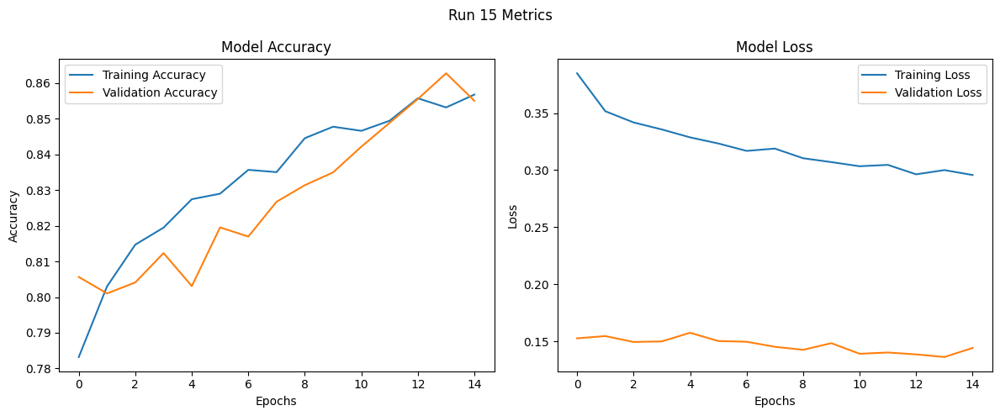

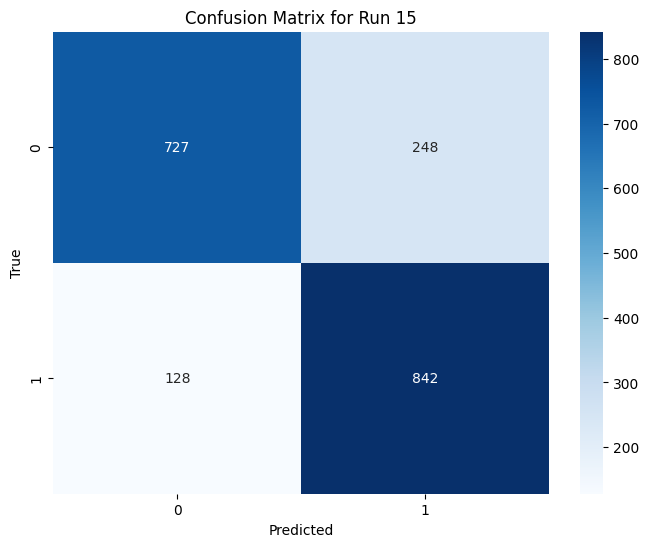

Run 16: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7468 - loss: 0.6028 - val_accuracy: 0.7969 - val_loss: 0.1570
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7924 - loss: 0.5175 - val_accuracy: 0.8051 - val_loss: 0.1462
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8170 - loss: 0.4715 - val_accuracy: 0.8134 - val_loss: 0.1442
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8276 - loss: 0.4570 - val_accuracy: 0.8242 - val_loss: 0.1414
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8375 - loss: 0.4392 - val_accuracy: 0.8185 - val_loss: 0.1401
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8350 - loss: 0.4322 - val_accuracy: 0.8252 - val_loss: 0.1385
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accurac

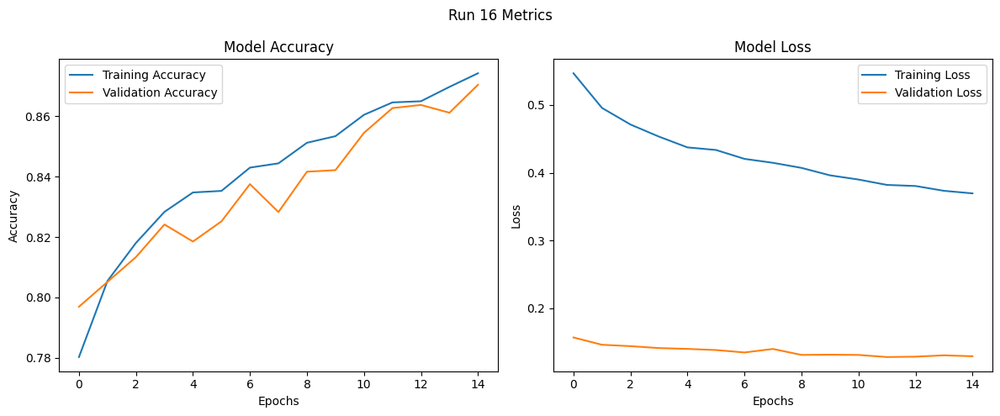

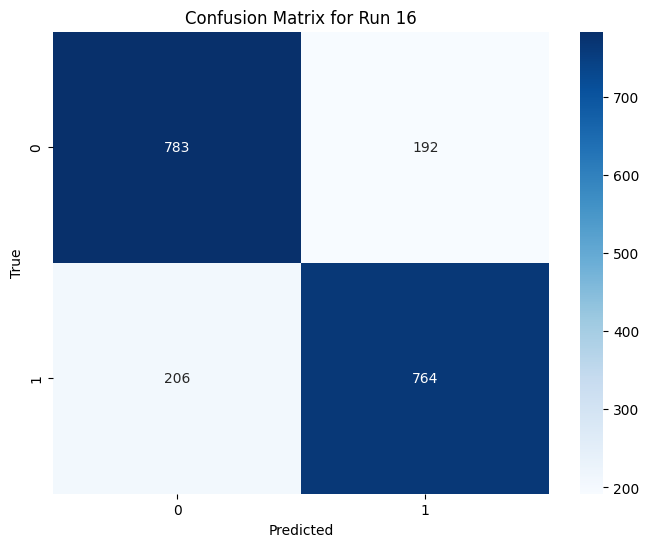

Run 17: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - accuracy: 0.7458 - loss: 0.5992 - val_accuracy: 0.8149 - val_loss: 0.1527
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8110 - loss: 0.4903 - val_accuracy: 0.8015 - val_loss: 0.1507
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8213 - loss: 0.4662 - val_accuracy: 0.8154 - val_loss: 0.1490
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8321 - loss: 0.4482 - val_accuracy: 0.8329 - val_loss: 0.1406
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8367 - loss: 0.4378 - val_accuracy: 0.8293 - val_loss: 0.1447
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8415 - loss: 0.4255 - val_accuracy: 0.8416 - val_loss: 0.1408
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accura

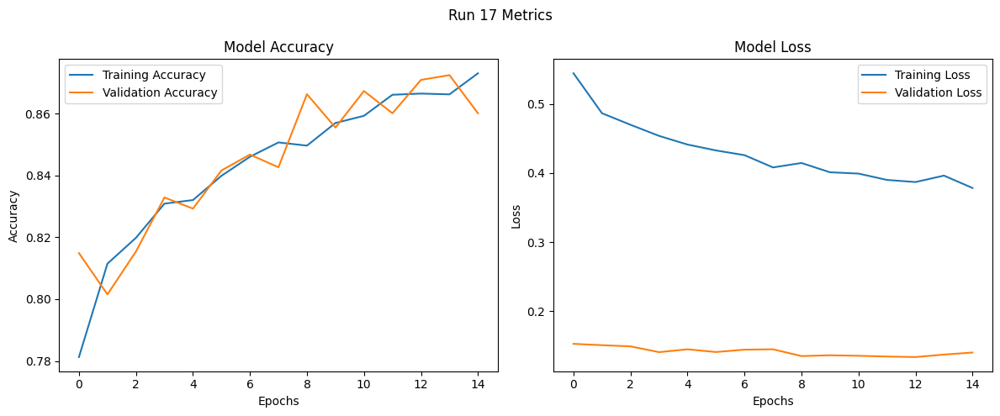

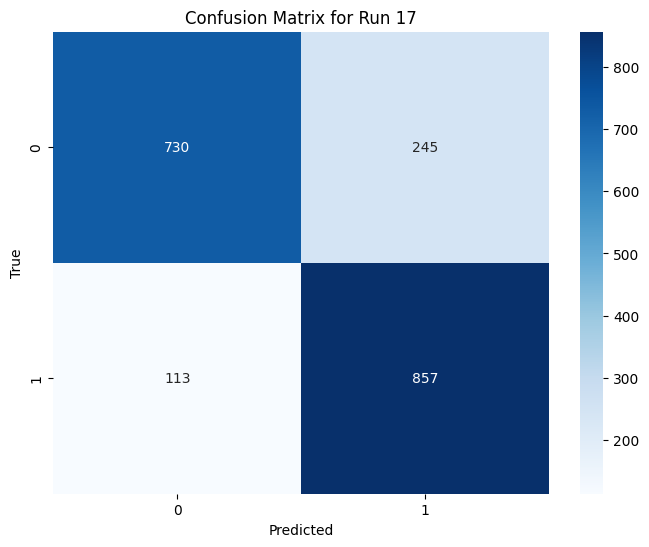

Run 18: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.7493 - loss: 0.6015 - val_accuracy: 0.7964 - val_loss: 0.1518
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8057 - loss: 0.5000 - val_accuracy: 0.7995 - val_loss: 0.1548
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8081 - loss: 0.4724 - val_accuracy: 0.8190 - val_loss: 0.1481
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8213 - loss: 0.4632 - val_accuracy: 0.8129 - val_loss: 0.1513
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8412 - loss: 0.4403 - val_accuracy: 0.8391 - val_loss: 0.1442
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8400 - loss: 0.4442 - val_accuracy: 0.8329 - val_loss: 0.1471
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy

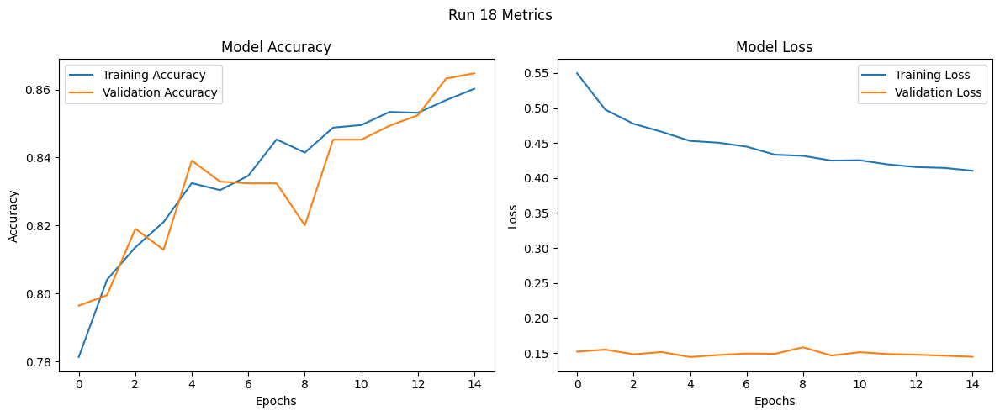

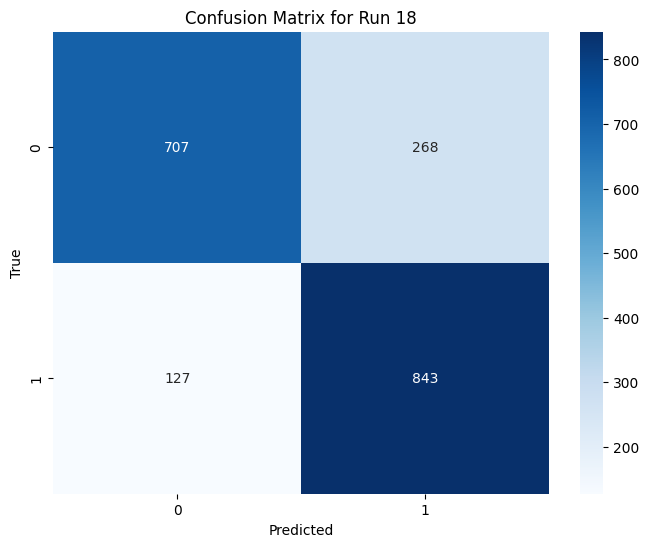

Run 19: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.7403 - loss: 0.4409 - val_accuracy: 0.7851 - val_loss: 0.1665
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7930 - loss: 0.3602 - val_accuracy: 0.7943 - val_loss: 0.1557
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8094 - loss: 0.3365 - val_accuracy: 0.8041 - val_loss: 0.1488
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8235 - loss: 0.3204 - val_accuracy: 0.8226 - val_loss: 0.1431
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8312 - loss: 0.3235 - val_accuracy: 0.8211 - val_loss: 0.1449
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8337 - loss: 0.3208 - val_accuracy: 0.8272 - val_loss: 0.1407
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accura

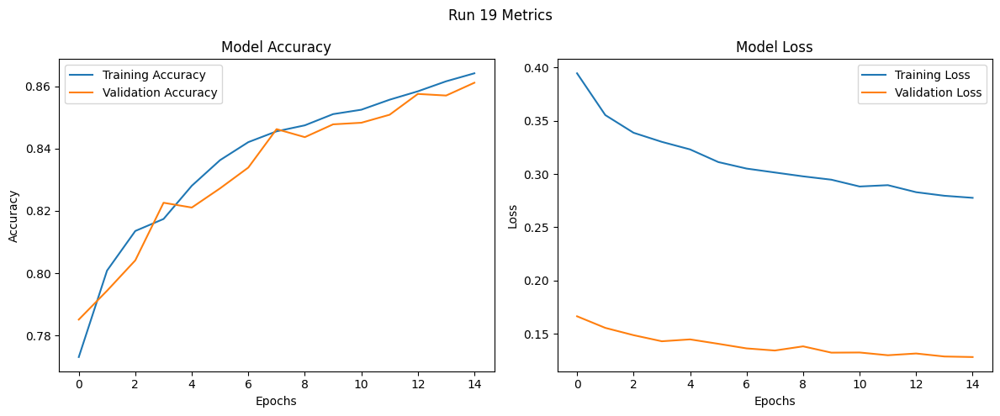

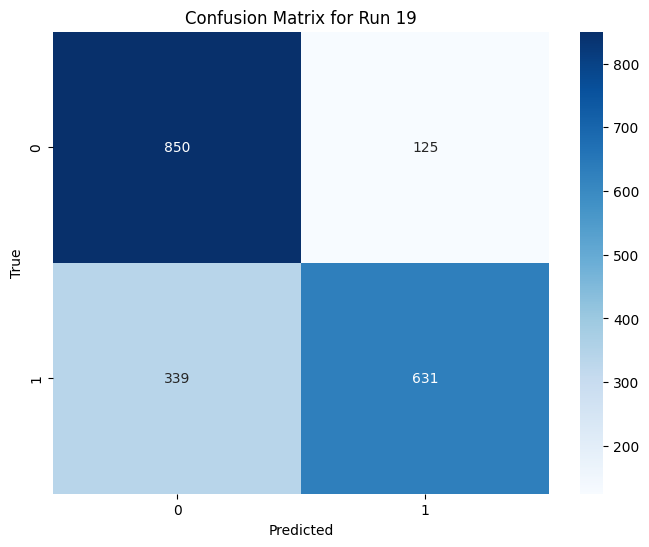

Run 20: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.7440 - loss: 0.4264 - val_accuracy: 0.7995 - val_loss: 0.1532
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7969 - loss: 0.3576 - val_accuracy: 0.8026 - val_loss: 0.1474
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8181 - loss: 0.3350 - val_accuracy: 0.8072 - val_loss: 0.1466
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8258 - loss: 0.3237 - val_accuracy: 0.8067 - val_loss: 0.1539
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8203 - loss: 0.3277 - val_accuracy: 0.8159 - val_loss: 0.1465
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8313 - loss: 0.3236 - val_accuracy: 0.8334 - val_loss: 0.1440
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accur

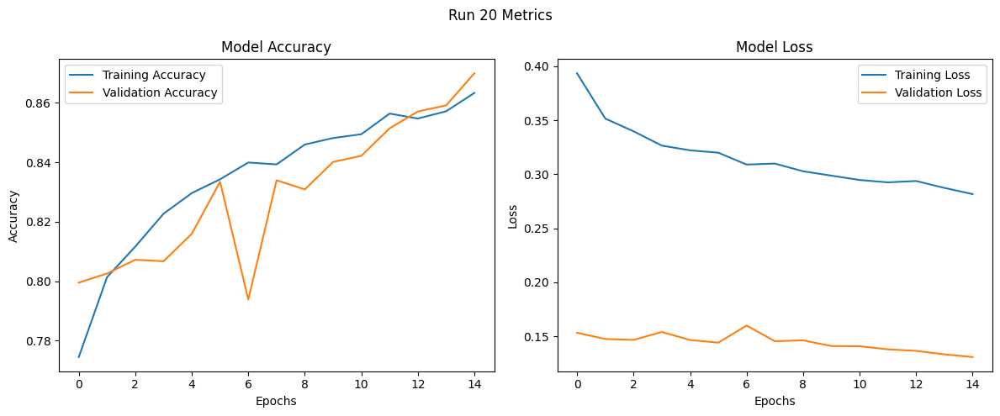

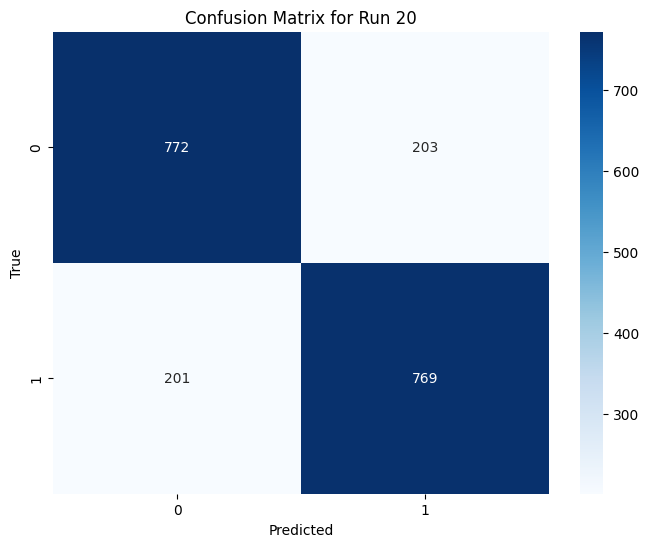

Run 21: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - accuracy: 0.7509 - loss: 0.4213 - val_accuracy: 0.7604 - val_loss: 0.1721
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7864 - loss: 0.3650 - val_accuracy: 0.8041 - val_loss: 0.1502
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8180 - loss: 0.3455 - val_accuracy: 0.8015 - val_loss: 0.1588
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8236 - loss: 0.3371 - val_accuracy: 0.7861 - val_loss: 0.1634
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8179 - loss: 0.3281 - val_accuracy: 0.8237 - val_loss: 0.1451
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8330 - loss: 0.3198 - val_accuracy: 0.8216 - val_loss: 0.1428
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accurac

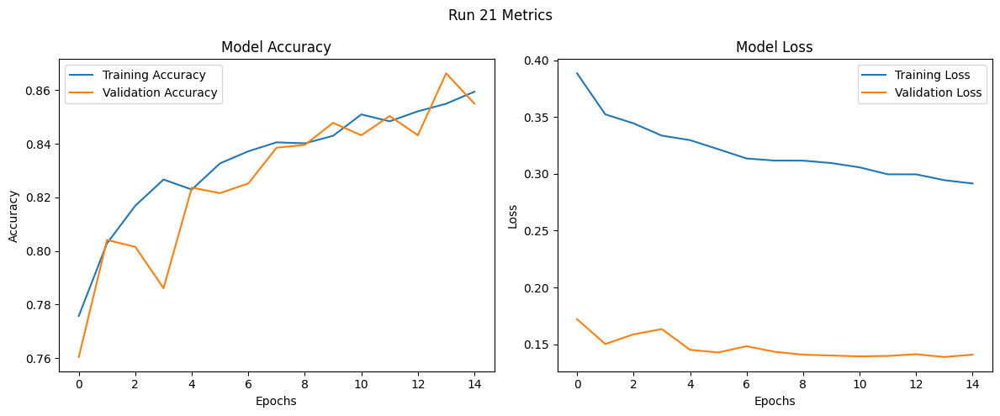

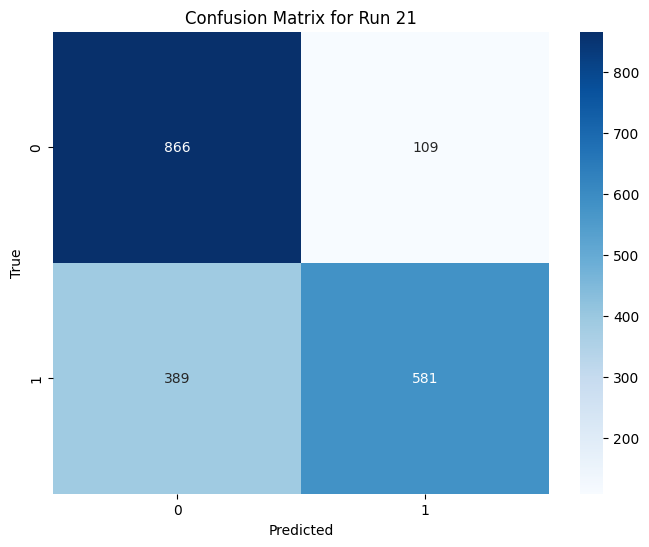

Run 22: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - accuracy: 0.7332 - loss: 0.6065 - val_accuracy: 0.7820 - val_loss: 0.1621
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8077 - loss: 0.4951 - val_accuracy: 0.8159 - val_loss: 0.1469
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8211 - loss: 0.4661 - val_accuracy: 0.8077 - val_loss: 0.1469
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8327 - loss: 0.4513 - val_accuracy: 0.8262 - val_loss: 0.1431
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8419 - loss: 0.4298 - val_accuracy: 0.8226 - val_loss: 0.1403
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8384 - loss: 0.4232 - val_accuracy: 0.8334 - val_loss: 0.1388
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accura

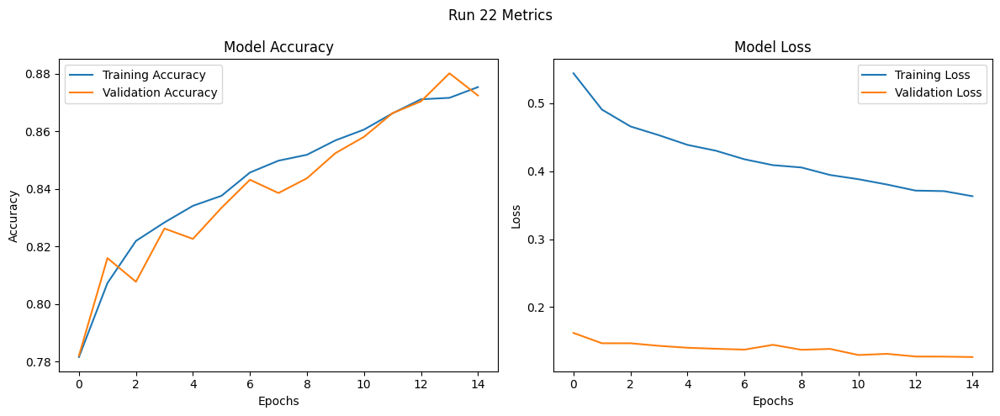

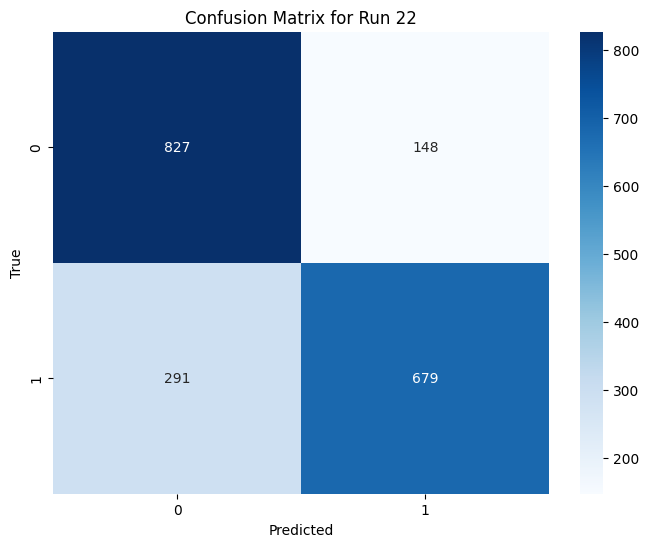

Run 23: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - accuracy: 0.7514 - loss: 0.6011 - val_accuracy: 0.7943 - val_loss: 0.1542
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8038 - loss: 0.4982 - val_accuracy: 0.7964 - val_loss: 0.1553
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8120 - loss: 0.4773 - val_accuracy: 0.8149 - val_loss: 0.1491
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8170 - loss: 0.4757 - val_accuracy: 0.8195 - val_loss: 0.1461
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8339 - loss: 0.4439 - val_accuracy: 0.8226 - val_loss: 0.1463
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8503 - loss: 0.4175 - val_accuracy: 0.8149 - val_loss: 0.1512
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accur

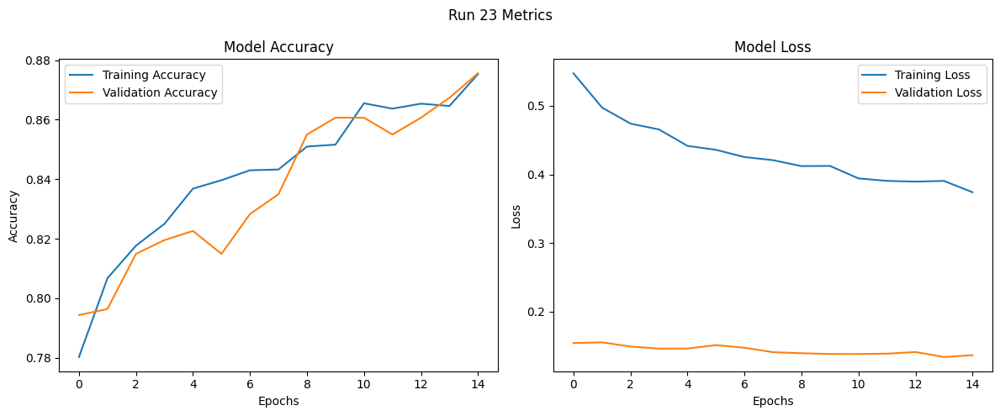

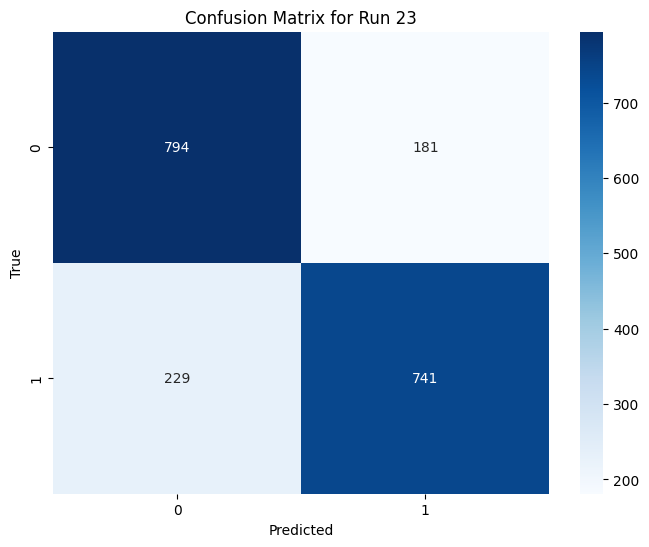

Run 24: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - accuracy: 0.7604 - loss: 0.5875 - val_accuracy: 0.8000 - val_loss: 0.1576
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8017 - loss: 0.5052 - val_accuracy: 0.8149 - val_loss: 0.1498
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8166 - loss: 0.4664 - val_accuracy: 0.8010 - val_loss: 0.1523
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8181 - loss: 0.4724 - val_accuracy: 0.8221 - val_loss: 0.1489
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8265 - loss: 0.4501 - val_accuracy: 0.8262 - val_loss: 0.1501
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8317 - loss: 0.4510 - val_accuracy: 0.8283 - val_loss: 0.1507
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accurac

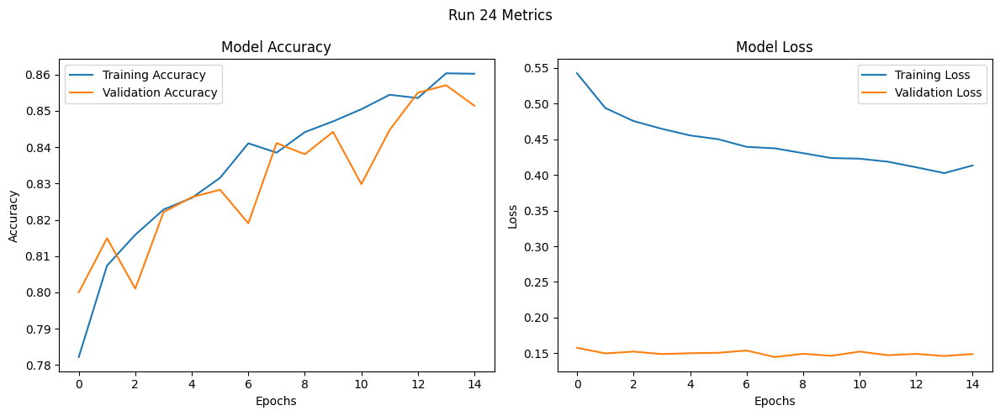

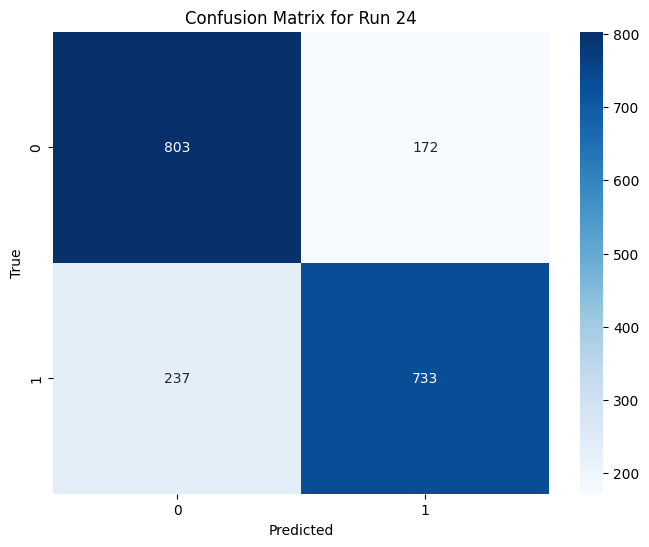

Run 25: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7399 - loss: 0.2126 - val_accuracy: 0.7799 - val_loss: 0.0804
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8048 - loss: 0.1690 - val_accuracy: 0.7985 - val_loss: 0.0739
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8142 - loss: 0.1622 - val_accuracy: 0.8041 - val_loss: 0.0725
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8253 - loss: 0.1568 - val_accuracy: 0.8129 - val_loss: 0.0710
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8180 - loss: 0.1578 - val_accuracy: 0.8154 - val_loss: 0.0707
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8343 - loss: 0.1520 - val_accuracy: 0.8046 - val_loss: 0.0734
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8414 

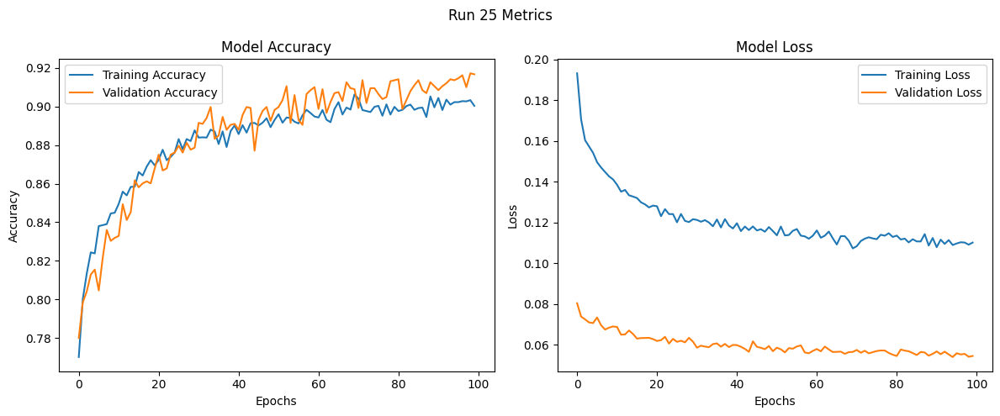

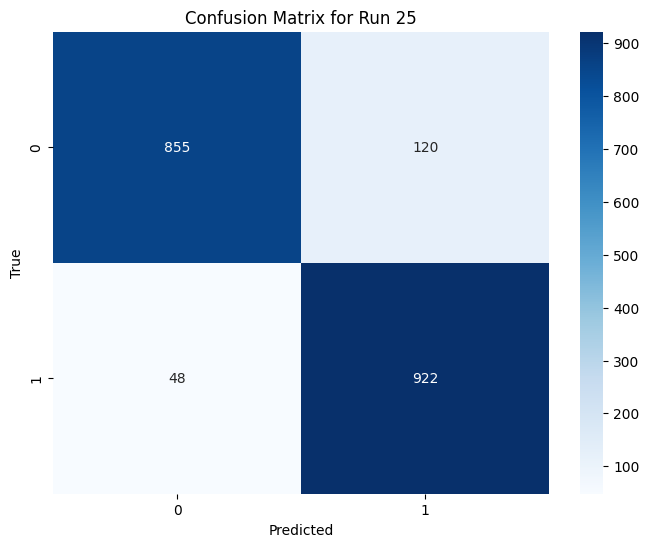

Run 26: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.7588 - loss: 0.2040 - val_accuracy: 0.7969 - val_loss: 0.0766
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8064 - loss: 0.1679 - val_accuracy: 0.8067 - val_loss: 0.0735
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8135 - loss: 0.1622 - val_accuracy: 0.7969 - val_loss: 0.0758
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8198 - loss: 0.1568 - val_accuracy: 0.8195 - val_loss: 0.0712
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8203 - loss: 0.1583 - val_accuracy: 0.8272 - val_loss: 0.0703
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8317 - loss: 0.1525 - val_accuracy: 0.8046 - val_loss: 0.0757
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8337

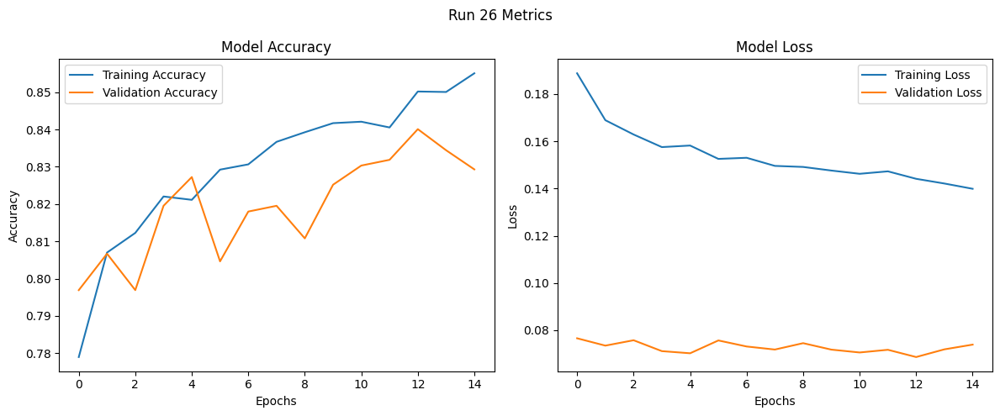

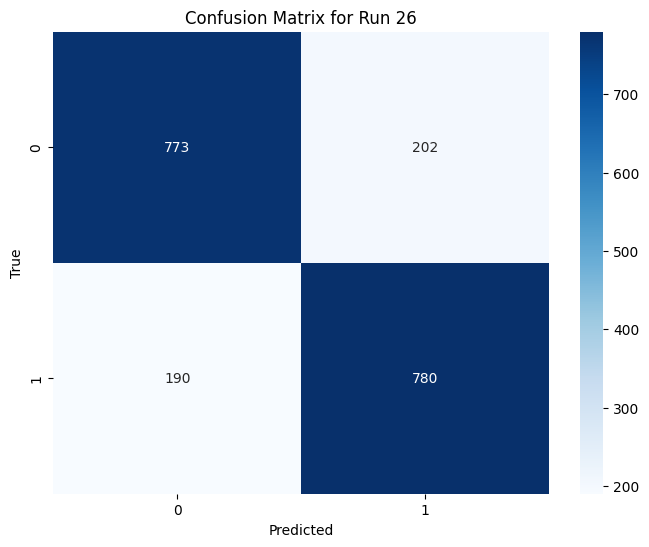

Run 27: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7410 - loss: 0.2127 - val_accuracy: 0.7640 - val_loss: 0.0837
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7995 - loss: 0.1728 - val_accuracy: 0.8103 - val_loss: 0.0740
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8101 - loss: 0.1639 - val_accuracy: 0.7979 - val_loss: 0.0778
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8223 - loss: 0.1557 - val_accuracy: 0.8129 - val_loss: 0.0744
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8281 - loss: 0.1551 - val_accuracy: 0.8231 - val_loss: 0.0717
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8227 - loss: 0.1609 - val_accuracy: 0.8149 - val_loss: 0.0747
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8299 -

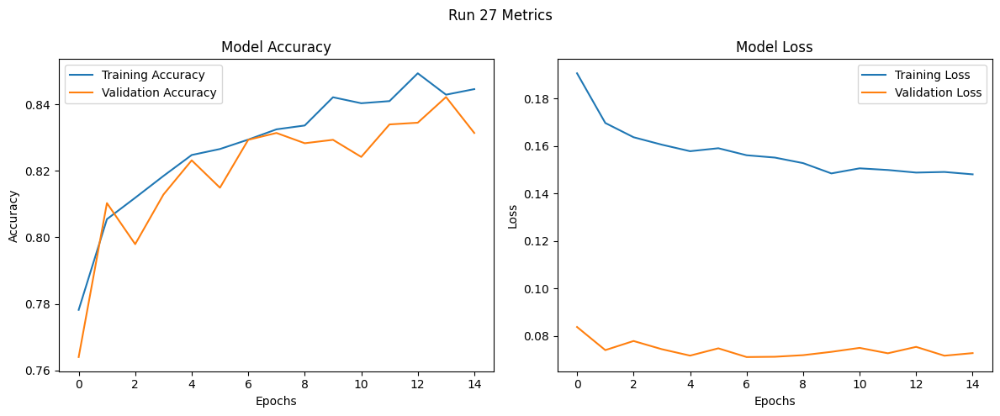

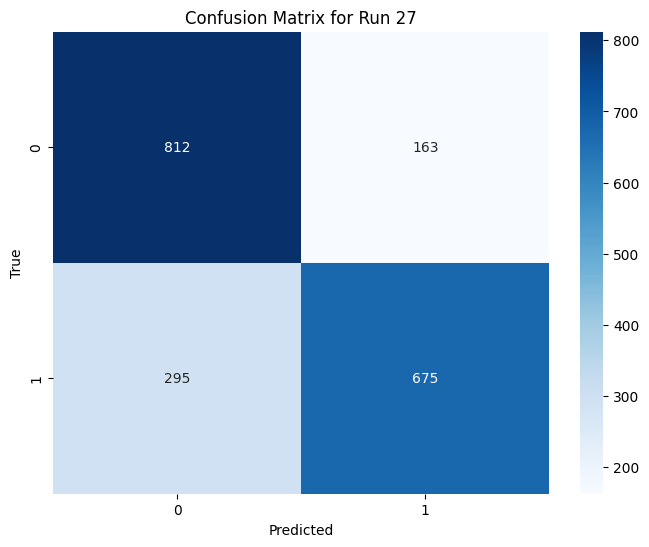

Run 28: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7518 - loss: 0.2968 - val_accuracy: 0.7959 - val_loss: 0.0769
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8068 - loss: 0.2352 - val_accuracy: 0.8051 - val_loss: 0.0741
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8169 - loss: 0.2237 - val_accuracy: 0.8154 - val_loss: 0.0718
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8309 - loss: 0.2114 - val_accuracy: 0.7995 - val_loss: 0.0780
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8323 - loss: 0.2112 - val_accuracy: 0.8257 - val_loss: 0.0705
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8317 - loss: 0.2119 - val_accuracy: 0.8283 - val_loss: 0.0696
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8383 

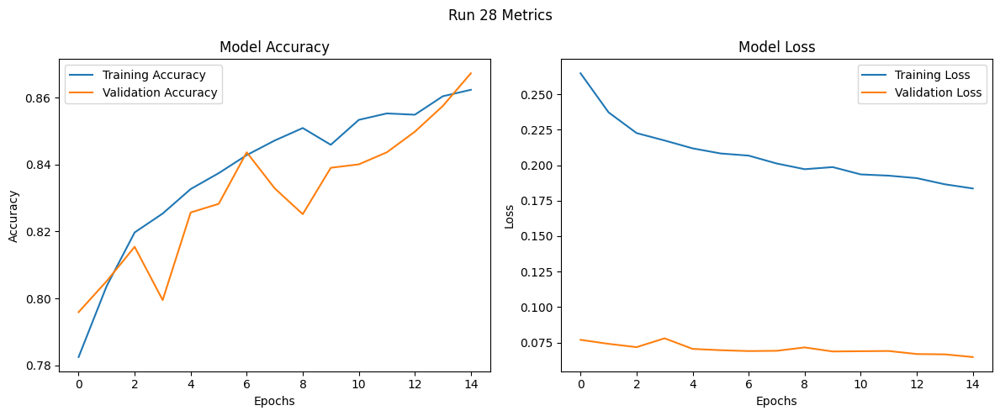

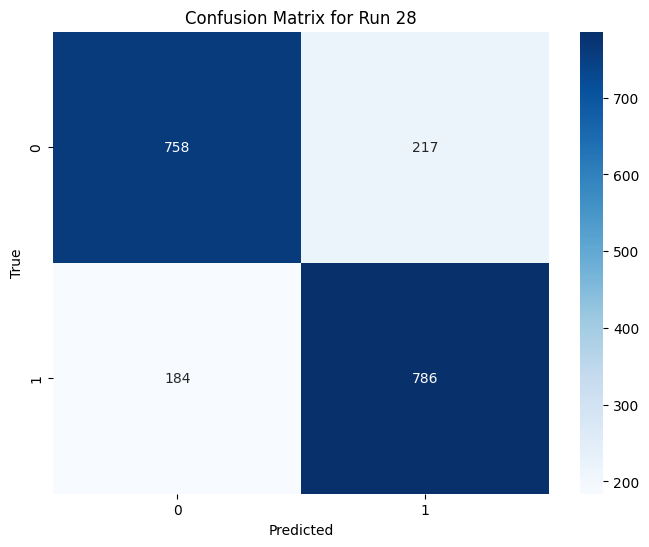

Run 29: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - accuracy: 0.7541 - loss: 0.2870 - val_accuracy: 0.8026 - val_loss: 0.0761
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8061 - loss: 0.2406 - val_accuracy: 0.8041 - val_loss: 0.0740
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8091 - loss: 0.2266 - val_accuracy: 0.8195 - val_loss: 0.0719
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8265 - loss: 0.2187 - val_accuracy: 0.8021 - val_loss: 0.0745
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8310 - loss: 0.2125 - val_accuracy: 0.8077 - val_loss: 0.0760
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8355 - loss: 0.2103 - val_accuracy: 0.8226 - val_loss: 0.0733
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8357

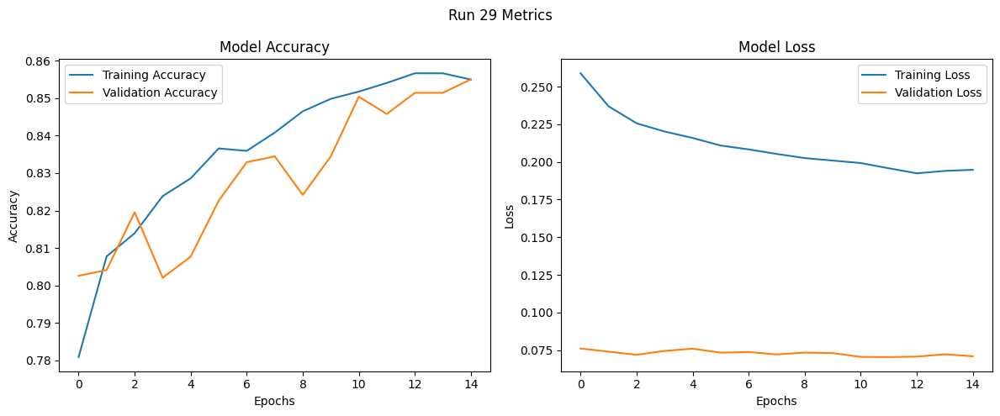

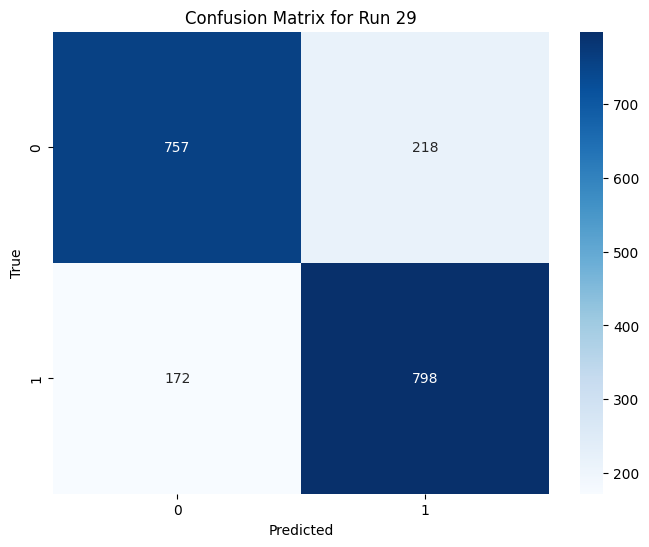

Run 30: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7431 - loss: 0.2892 - val_accuracy: 0.7902 - val_loss: 0.0803
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8045 - loss: 0.2408 - val_accuracy: 0.7918 - val_loss: 0.0786
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8228 - loss: 0.2234 - val_accuracy: 0.8057 - val_loss: 0.0764
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8145 - loss: 0.2303 - val_accuracy: 0.8237 - val_loss: 0.0756
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8227 - loss: 0.2269 - val_accuracy: 0.8221 - val_loss: 0.0752
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8269 - loss: 0.2218 - val_accuracy: 0.8201 - val_loss: 0.0762
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8356 -

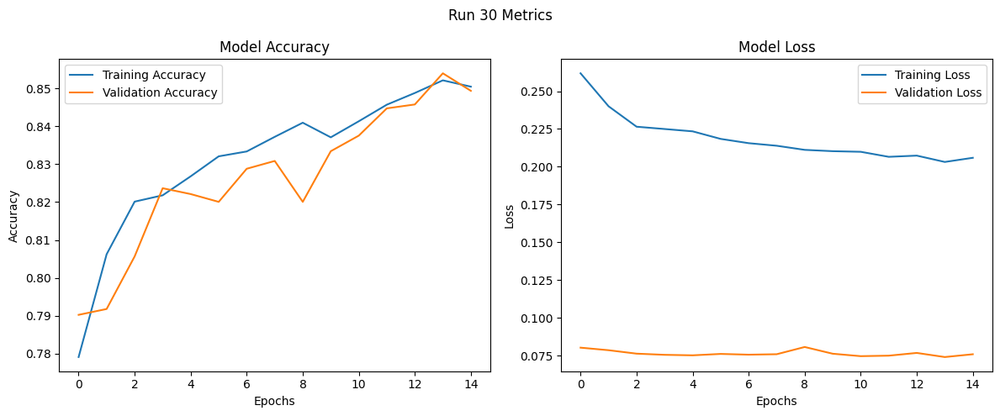

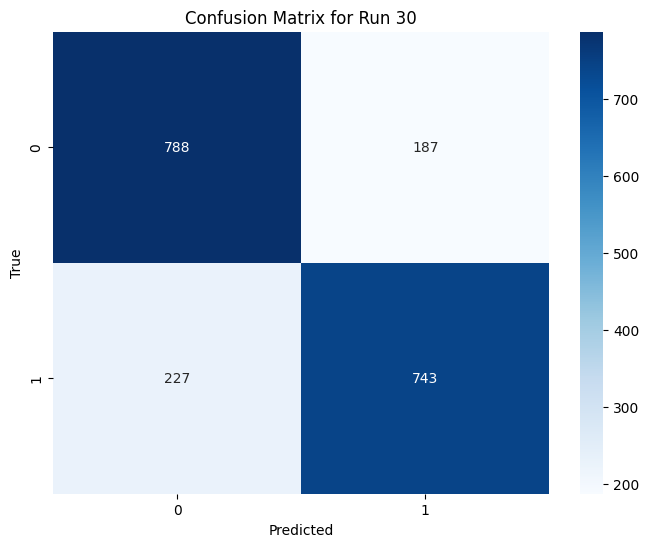

Run 31: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.7336 - loss: 0.2152 - val_accuracy: 0.8062 - val_loss: 0.0759
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7982 - loss: 0.1702 - val_accuracy: 0.7969 - val_loss: 0.0741
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8113 - loss: 0.1629 - val_accuracy: 0.7979 - val_loss: 0.0755
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8115 - loss: 0.1611 - val_accuracy: 0.8021 - val_loss: 0.0739
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8270 - loss: 0.1544 - val_accuracy: 0.8195 - val_loss: 0.0691
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8220 - loss: 0.1575 - val_accuracy: 0.8242 - val_loss: 0.0679
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8332

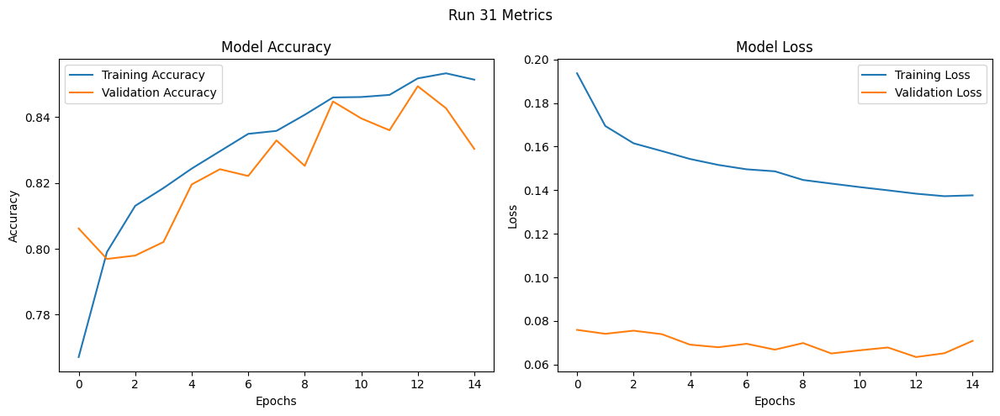

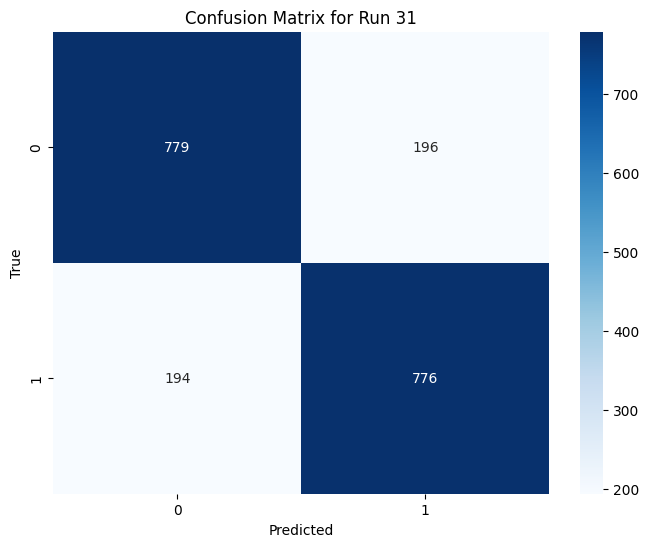

Run 32: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7399 - loss: 0.2071 - val_accuracy: 0.7841 - val_loss: 0.0780
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7970 - loss: 0.1710 - val_accuracy: 0.8015 - val_loss: 0.0747
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8084 - loss: 0.1644 - val_accuracy: 0.7923 - val_loss: 0.0751
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8214 - loss: 0.1581 - val_accuracy: 0.8180 - val_loss: 0.0726
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8238 - loss: 0.1586 - val_accuracy: 0.8087 - val_loss: 0.0722
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8311 - loss: 0.1521 - val_accuracy: 0.8093 - val_loss: 0.0714
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.834

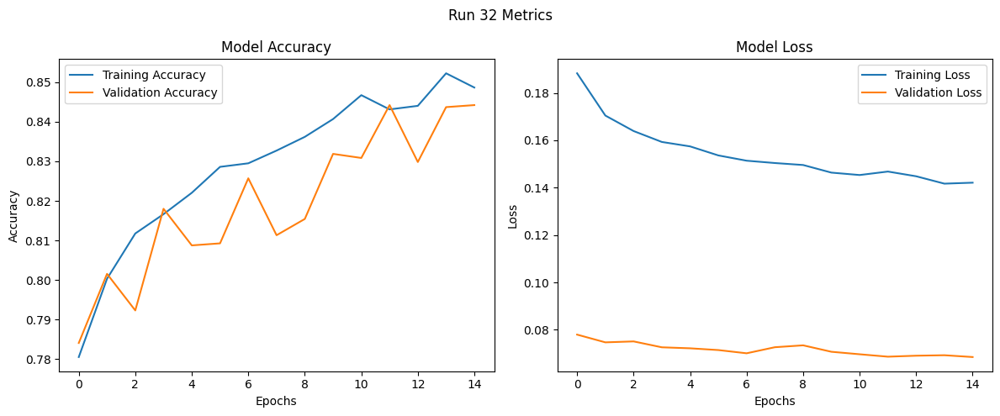

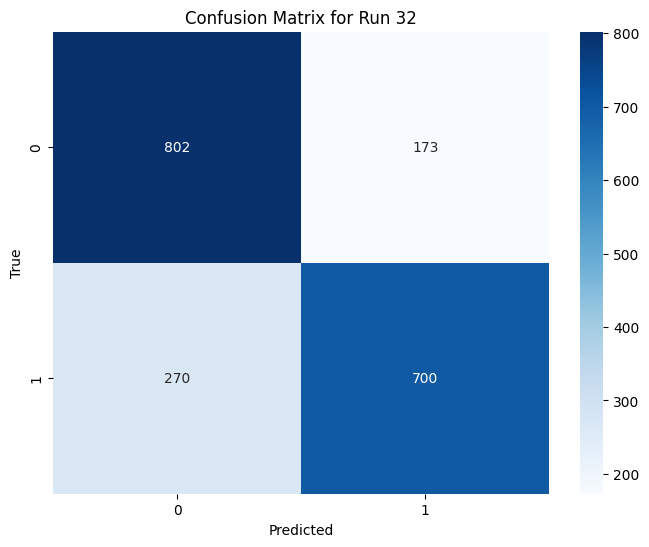

Run 33: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.7388 - loss: 0.2071 - val_accuracy: 0.7856 - val_loss: 0.0777
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7974 - loss: 0.1732 - val_accuracy: 0.7897 - val_loss: 0.0763
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8075 - loss: 0.1659 - val_accuracy: 0.8082 - val_loss: 0.0737
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8147 - loss: 0.1656 - val_accuracy: 0.7990 - val_loss: 0.0757
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8194 - loss: 0.1614 - val_accuracy: 0.8144 - val_loss: 0.0744
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8271 - loss: 0.1572 - val_accuracy: 0.8185 - val_loss: 0.0733
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8311 

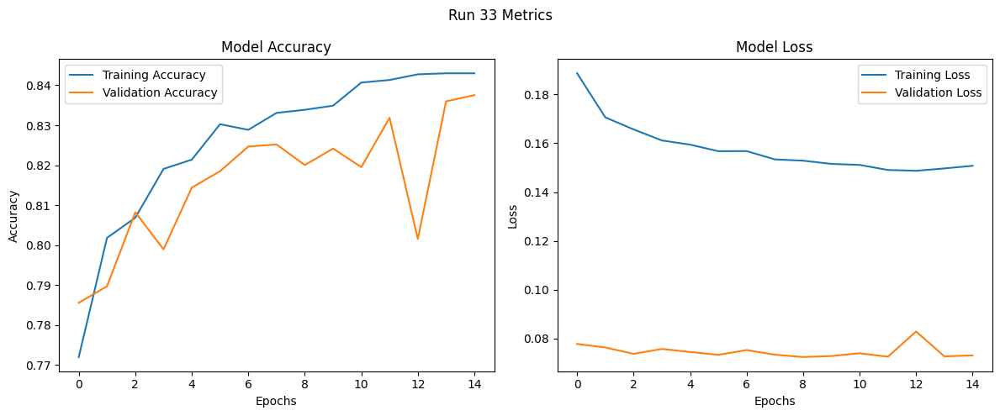

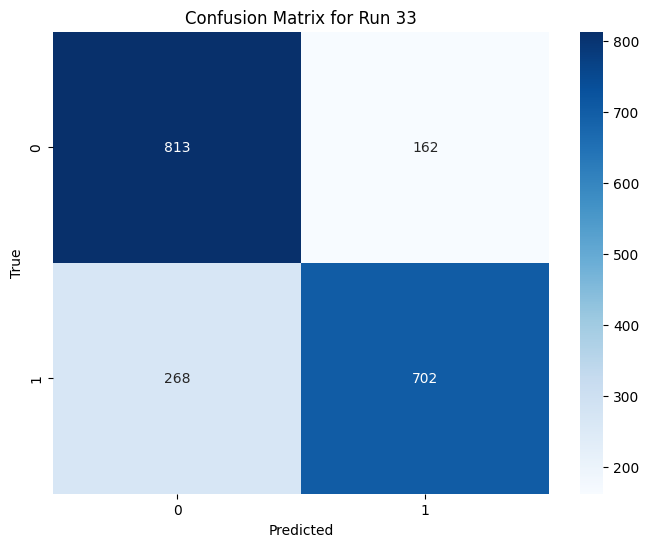

Run 34: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.7486 - loss: 0.2936 - val_accuracy: 0.8005 - val_loss: 0.0766
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8066 - loss: 0.2387 - val_accuracy: 0.7969 - val_loss: 0.0760
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8144 - loss: 0.2281 - val_accuracy: 0.8098 - val_loss: 0.0724
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8234 - loss: 0.2175 - val_accuracy: 0.8154 - val_loss: 0.0721
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8327 - loss: 0.2117 - val_accuracy: 0.8159 - val_loss: 0.0719
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8440 - loss: 0.1963 - val_accuracy: 0.8339 - val_loss: 0.0682
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8386

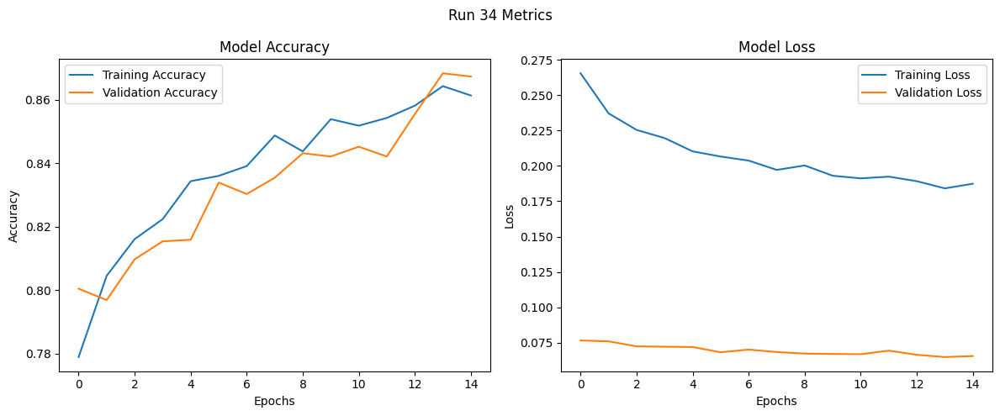

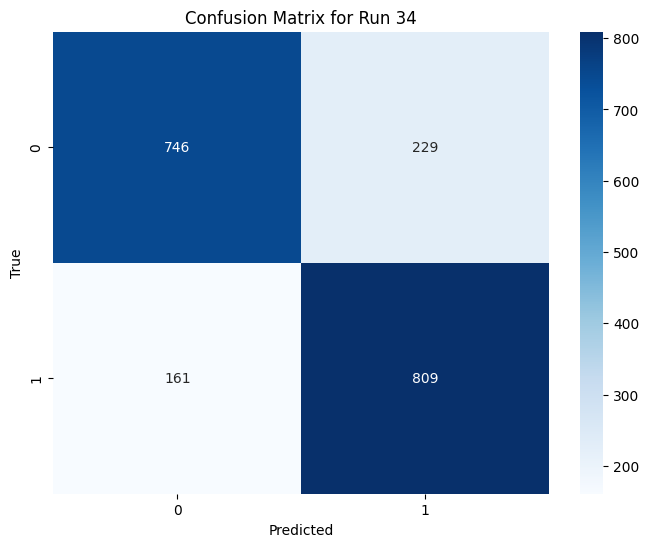

Run 35: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7409 - loss: 0.2987 - val_accuracy: 0.7923 - val_loss: 0.0790
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8056 - loss: 0.2384 - val_accuracy: 0.8113 - val_loss: 0.0736
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8206 - loss: 0.2231 - val_accuracy: 0.8118 - val_loss: 0.0756
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8202 - loss: 0.2222 - val_accuracy: 0.8190 - val_loss: 0.0724
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8177 - loss: 0.2262 - val_accuracy: 0.8272 - val_loss: 0.0722
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8405 - loss: 0.2056 - val_accuracy: 0.8344 - val_loss: 0.0719
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.840

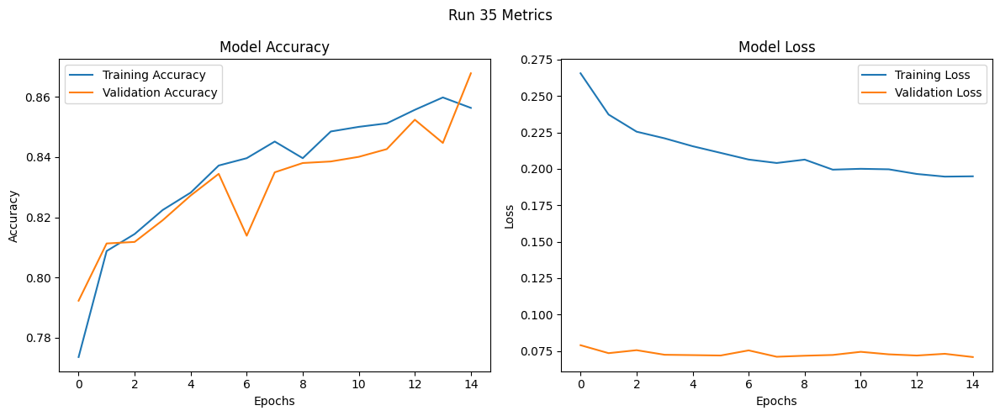

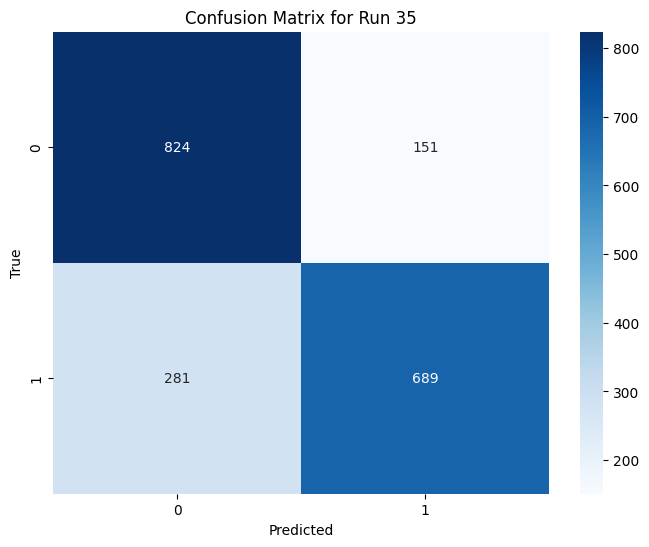

Run 36: L2: 0.0001, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7540 - loss: 0.2890 - val_accuracy: 0.8041 - val_loss: 0.0767
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8032 - loss: 0.2390 - val_accuracy: 0.7995 - val_loss: 0.0776
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8176 - loss: 0.2285 - val_accuracy: 0.8211 - val_loss: 0.0757
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8235 - loss: 0.2268 - val_accuracy: 0.8123 - val_loss: 0.0757
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8282 - loss: 0.2192 - val_accuracy: 0.8272 - val_loss: 0.0761
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8260 - loss: 0.2198 - val_accuracy: 0.8298 - val_loss: 0.0742
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8460 

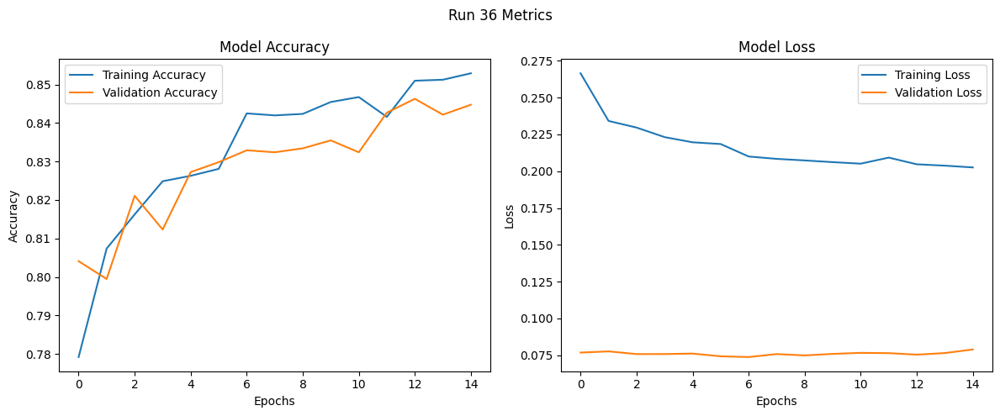

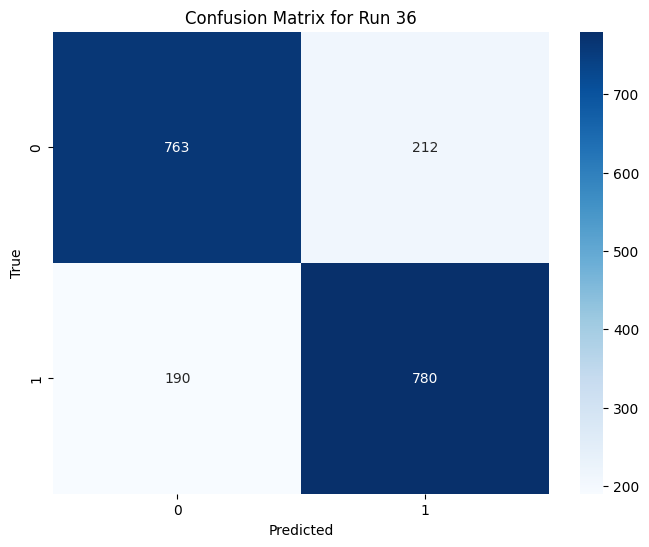

Run 37: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - accuracy: 0.7578 - loss: 1.2265 - val_accuracy: 0.8026 - val_loss: 0.4500
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.8005 - loss: 1.0441 - val_accuracy: 0.8093 - val_loss: 0.4321
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8014 - loss: 1.0501 - val_accuracy: 0.8170 - val_loss: 0.4212
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8244 - loss: 0.9569 - val_accuracy: 0.8118 - val_loss: 0.4144
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8188 - loss: 0.9446 - val_accuracy: 0.8144 - val_loss: 0.4058
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8382 - loss: 0.8999 - val_accuracy: 0.8262 - val_loss: 0.4142
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step -

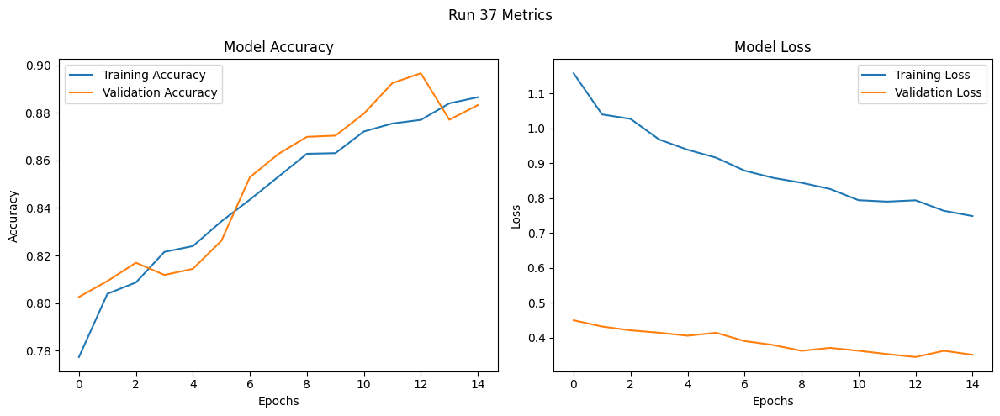

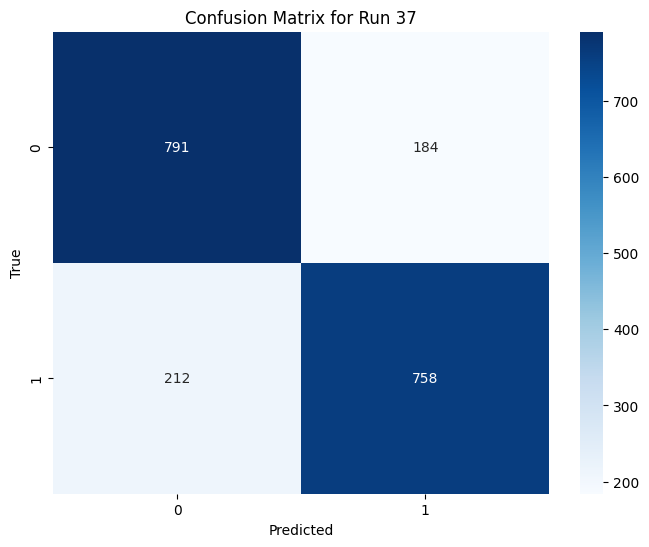

Run 38: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - accuracy: 0.7543 - loss: 1.2235 - val_accuracy: 0.7954 - val_loss: 0.4597
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7979 - loss: 1.0677 - val_accuracy: 0.8000 - val_loss: 0.4608
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8098 - loss: 1.0134 - val_accuracy: 0.8005 - val_loss: 0.4324
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8246 - loss: 0.9732 - val_accuracy: 0.8118 - val_loss: 0.4383
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8240 - loss: 0.9603 - val_accuracy: 0.8360 - val_loss: 0.4059
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8323 - loss: 0.9350 - val_accuracy: 0.8566 - val_loss: 0.3831
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step -

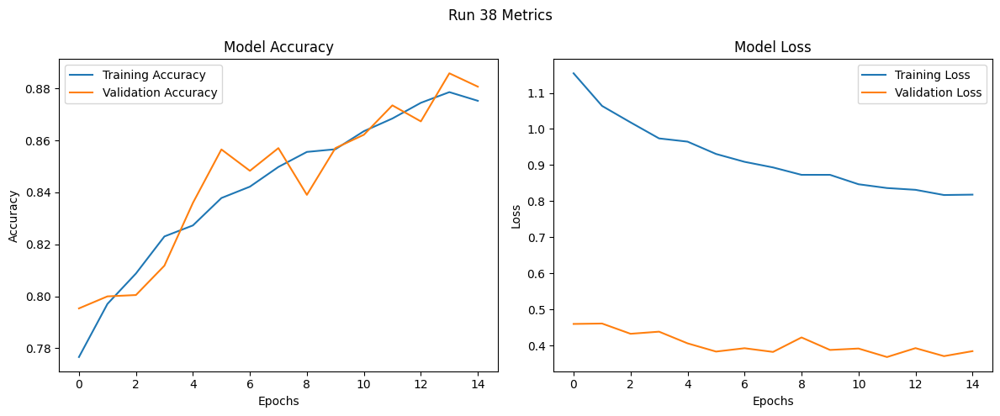

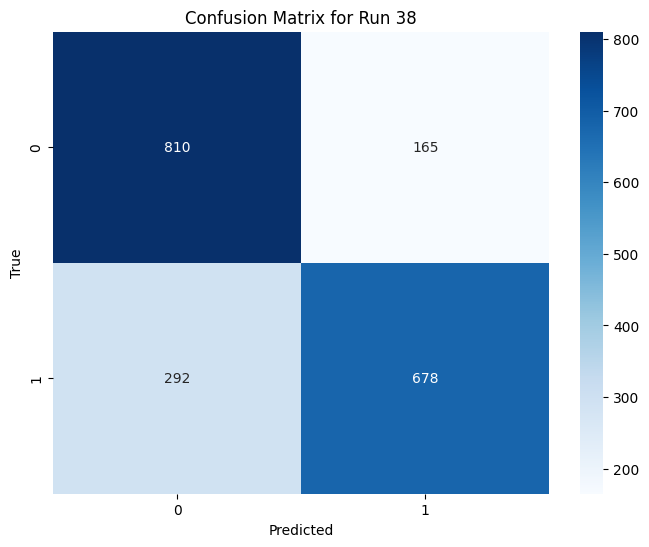

Run 39: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 8s 10ms/step - accuracy: 0.7516 - loss: 1.2362 - val_accuracy: 0.7964 - val_loss: 0.4612
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.7892 - loss: 1.0958 - val_accuracy: 0.7835 - val_loss: 0.4586
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8089 - loss: 1.0269 - val_accuracy: 0.8057 - val_loss: 0.4473
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8211 - loss: 0.9830 - val_accuracy: 0.8252 - val_loss: 0.4209
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8247 - loss: 0.9810 - val_accuracy: 0.8344 - val_loss: 0.4287
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8316 - loss: 0.9627 - val_accuracy: 0.8303 - val_loss: 0.4191
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step -

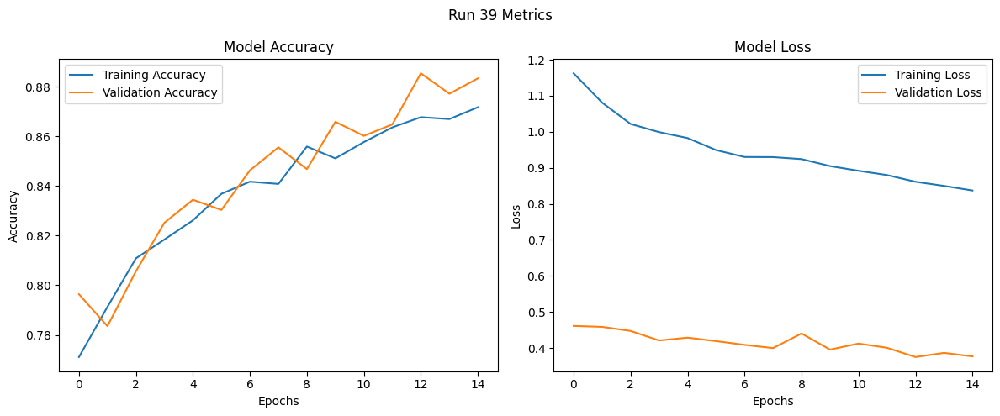

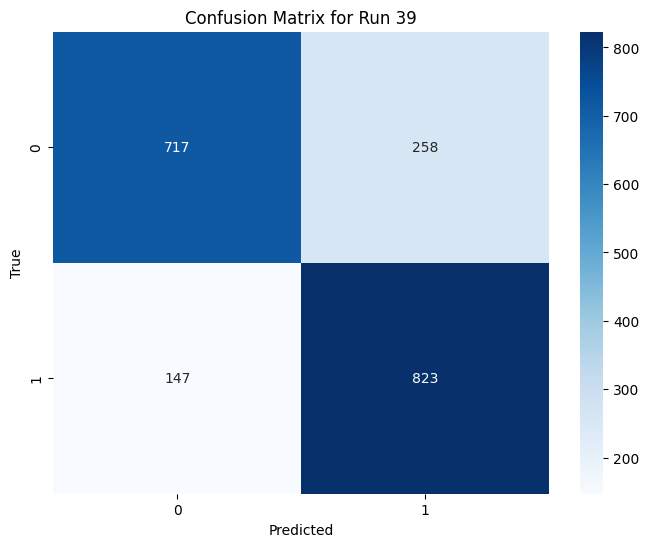

Run 40: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - accuracy: 0.7358 - loss: 1.7742 - val_accuracy: 0.7964 - val_loss: 0.4450
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8132 - loss: 1.4303 - val_accuracy: 0.7722 - val_loss: 0.4850
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8104 - loss: 1.4359 - val_accuracy: 0.8211 - val_loss: 0.4199
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8260 - loss: 1.3426 - val_accuracy: 0.8242 - val_loss: 0.3999
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8394 - loss: 1.2992 - val_accuracy: 0.8483 - val_loss: 0.3866
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8499 - loss: 1.2731 - val_accuracy: 0.8386 - val_loss: 0.3986
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step -

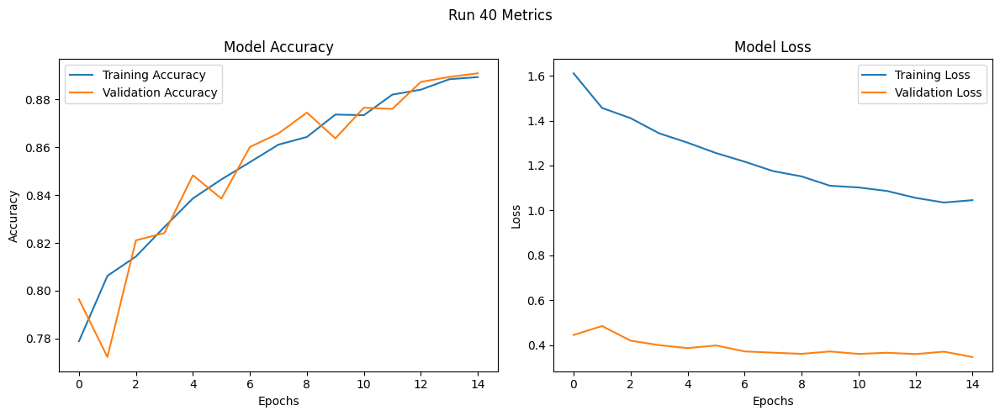

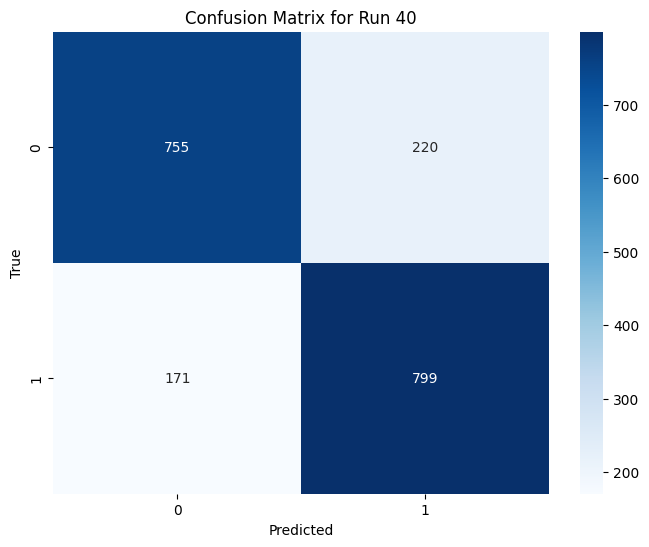

Run 41: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step - accuracy: 0.7370 - loss: 1.7723 - val_accuracy: 0.7712 - val_loss: 0.4729
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.8095 - loss: 1.4854 - val_accuracy: 0.8165 - val_loss: 0.4294
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8139 - loss: 1.4337 - val_accuracy: 0.8077 - val_loss: 0.4415
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8258 - loss: 1.3794 - val_accuracy: 0.8360 - val_loss: 0.4024
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8399 - loss: 1.3034 - val_accuracy: 0.8401 - val_loss: 0.4094
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8428 - loss: 1.2850 - val_accuracy: 0.8509 - val_loss: 0.4021
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/ste

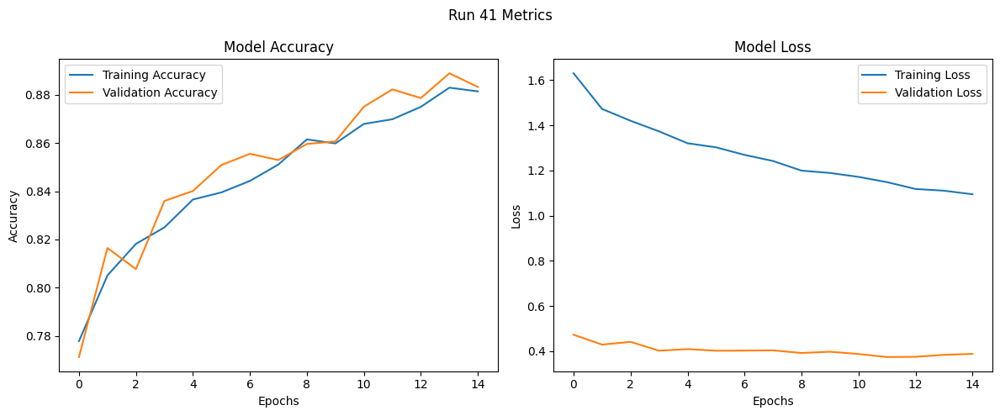

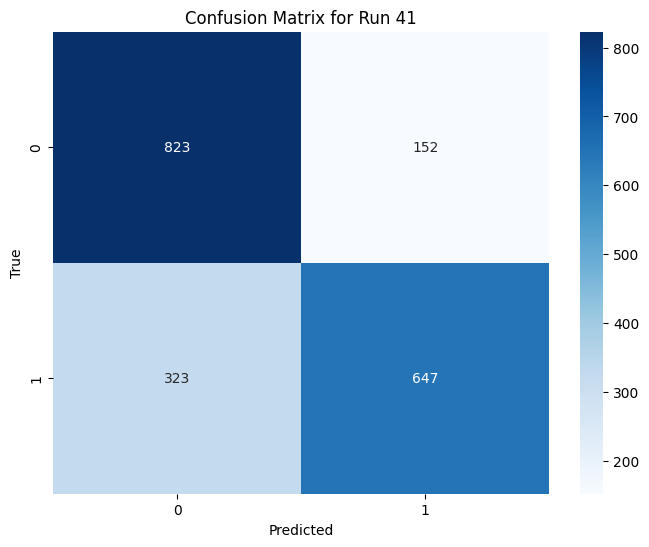

Run 42: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - accuracy: 0.7493 - loss: 1.7920 - val_accuracy: 0.7861 - val_loss: 0.4820
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.7971 - loss: 1.5446 - val_accuracy: 0.8046 - val_loss: 0.4663
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8056 - loss: 1.5034 - val_accuracy: 0.7866 - val_loss: 0.4914
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8225 - loss: 1.4013 - val_accuracy: 0.8139 - val_loss: 0.4403
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8217 - loss: 1.3800 - val_accuracy: 0.8375 - val_loss: 0.4231
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8356 - loss: 1.3110 - val_accuracy: 0.8278 - val_loss: 0.4281
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step 

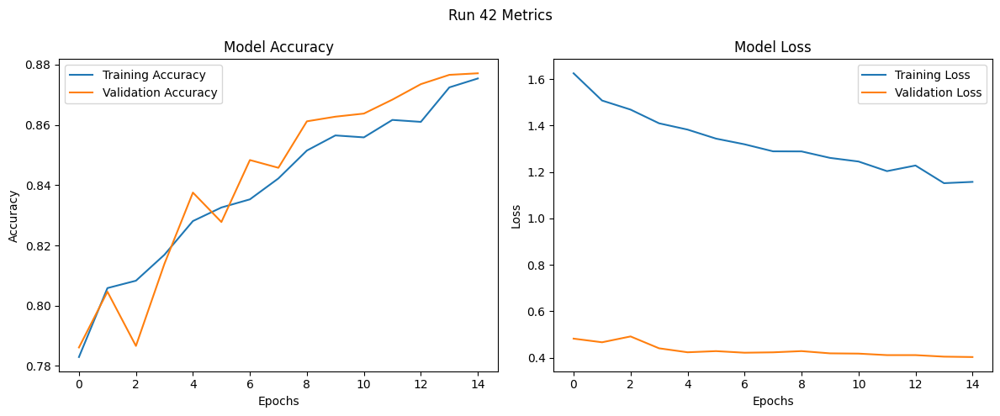

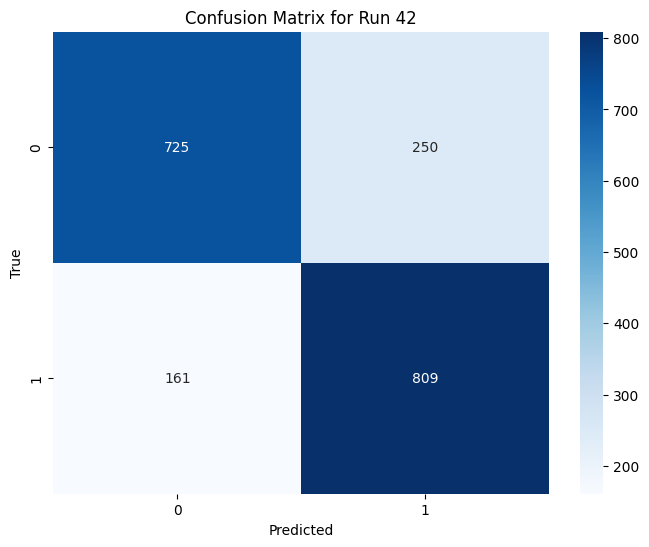

Run 43: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7500 - loss: 1.2321 - val_accuracy: 0.7702 - val_loss: 0.4936
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8057 - loss: 1.0363 - val_accuracy: 0.8103 - val_loss: 0.4480
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8161 - loss: 1.0069 - val_accuracy: 0.8170 - val_loss: 0.4168
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8229 - loss: 0.9658 - val_accuracy: 0.8010 - val_loss: 0.4346
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8348 - loss: 0.9472 - val_accuracy: 0.8175 - val_loss: 0.4002
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8453 - loss: 0.8855 - val_accuracy: 0.8550 - val_loss: 0.3895
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step 

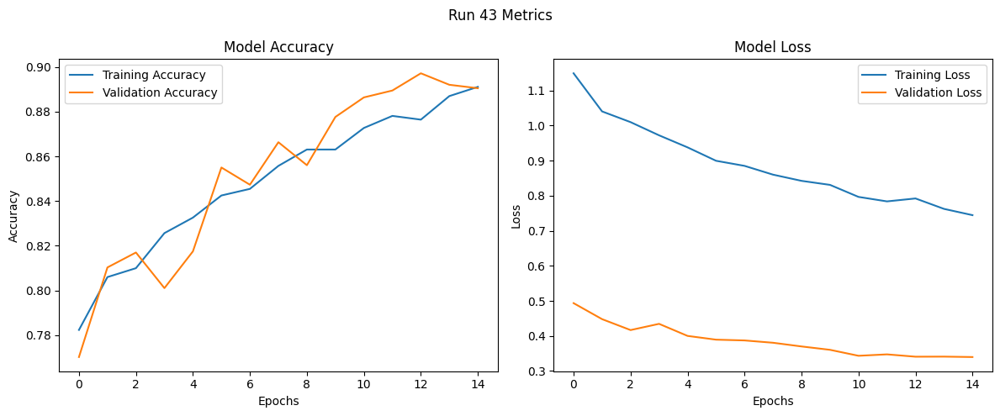

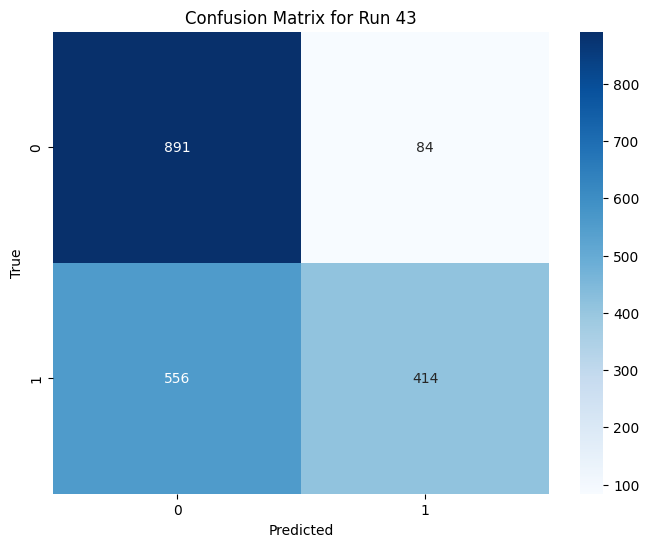

Run 44: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - accuracy: 0.7473 - loss: 1.2356 - val_accuracy: 0.7882 - val_loss: 0.4640
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8003 - loss: 1.0570 - val_accuracy: 0.7974 - val_loss: 0.4652
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8144 - loss: 1.0067 - val_accuracy: 0.7851 - val_loss: 0.4570
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8151 - loss: 0.9768 - val_accuracy: 0.7995 - val_loss: 0.4387
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8257 - loss: 0.9679 - val_accuracy: 0.8211 - val_loss: 0.4101
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8309 - loss: 0.9555 - val_accuracy: 0.8411 - val_loss: 0.4159
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step

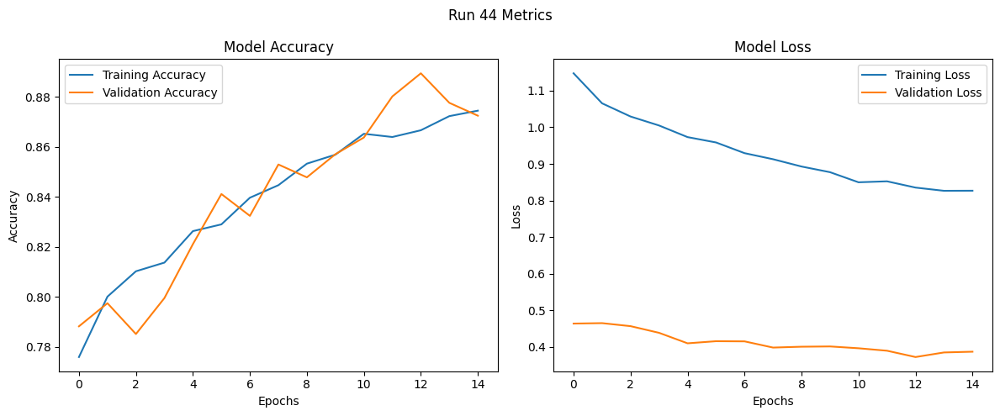

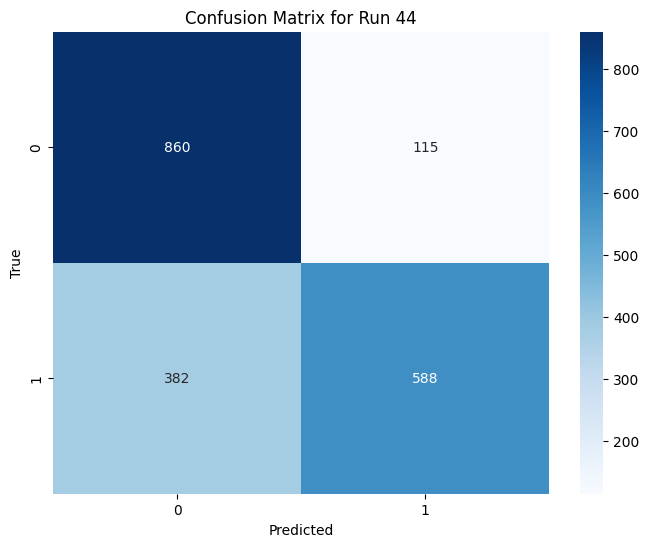

Run 45: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7558 - loss: 1.2490 - val_accuracy: 0.7871 - val_loss: 0.4776
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.8075 - loss: 1.0458 - val_accuracy: 0.8000 - val_loss: 0.4530
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8150 - loss: 1.0089 - val_accuracy: 0.8139 - val_loss: 0.4303
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8068 - loss: 1.0018 - val_accuracy: 0.8118 - val_loss: 0.4544
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8152 - loss: 1.0049 - val_accuracy: 0.8257 - val_loss: 0.4324
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8408 - loss: 0.9401 - val_accuracy: 0.8267 - val_loss: 0.4256
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step -

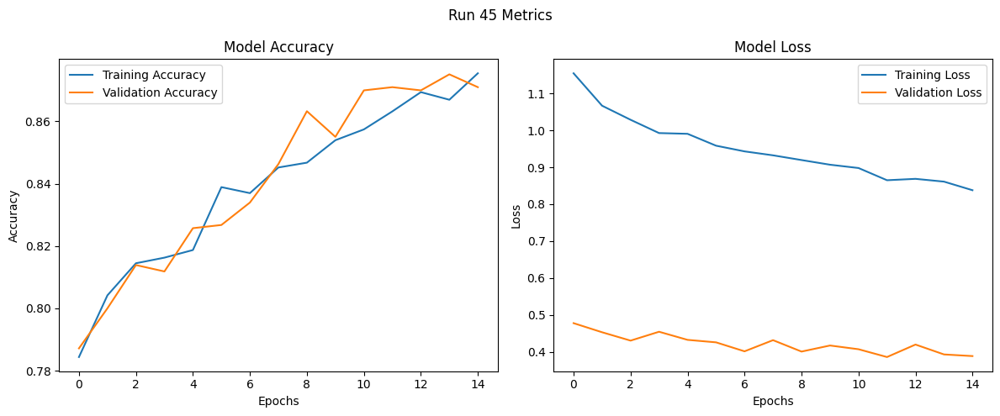

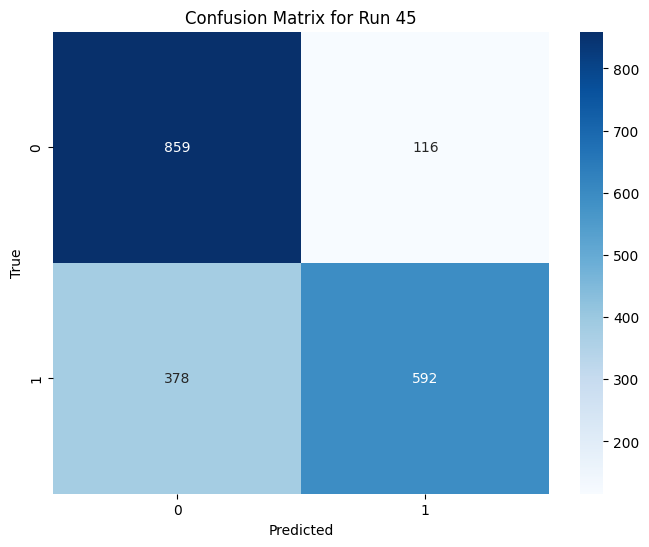

Run 46: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - accuracy: 0.7457 - loss: 1.7272 - val_accuracy: 0.7969 - val_loss: 0.4563
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8055 - loss: 1.4742 - val_accuracy: 0.8190 - val_loss: 0.4381
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8188 - loss: 1.4048 - val_accuracy: 0.8051 - val_loss: 0.4291
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8231 - loss: 1.3653 - val_accuracy: 0.8411 - val_loss: 0.4160
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8331 - loss: 1.3413 - val_accuracy: 0.8231 - val_loss: 0.4005
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8500 - loss: 1.2457 - val_accuracy: 0.8530 - val_loss: 0.3822
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step 

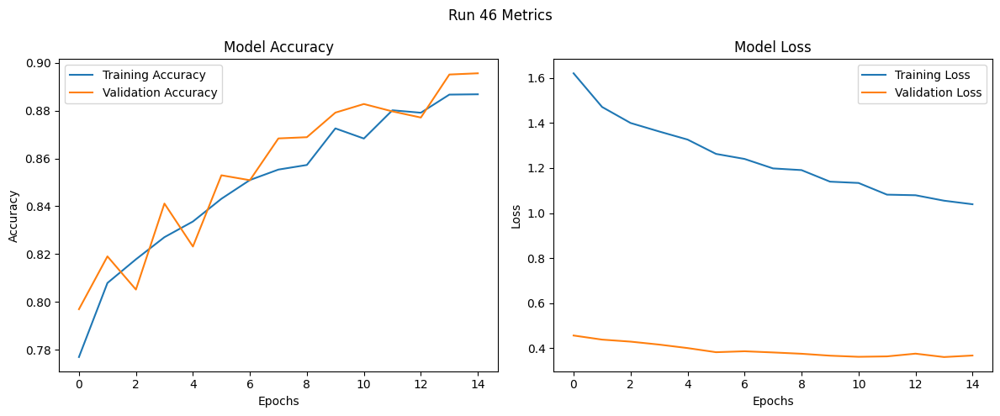

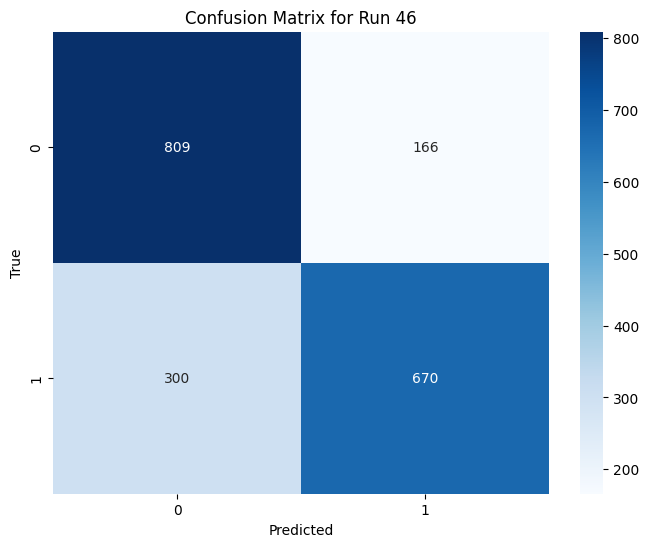

Run 47: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7576 - loss: 1.7587 - val_accuracy: 0.7918 - val_loss: 0.4552
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7973 - loss: 1.5032 - val_accuracy: 0.7964 - val_loss: 0.4362
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8150 - loss: 1.4175 - val_accuracy: 0.8057 - val_loss: 0.4310
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8248 - loss: 1.3439 - val_accuracy: 0.8257 - val_loss: 0.4173
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8309 - loss: 1.3665 - val_accuracy: 0.8298 - val_loss: 0.4154
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8418 - loss: 1.2856 - val_accuracy: 0.8468 - val_loss: 0.3993
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/ste

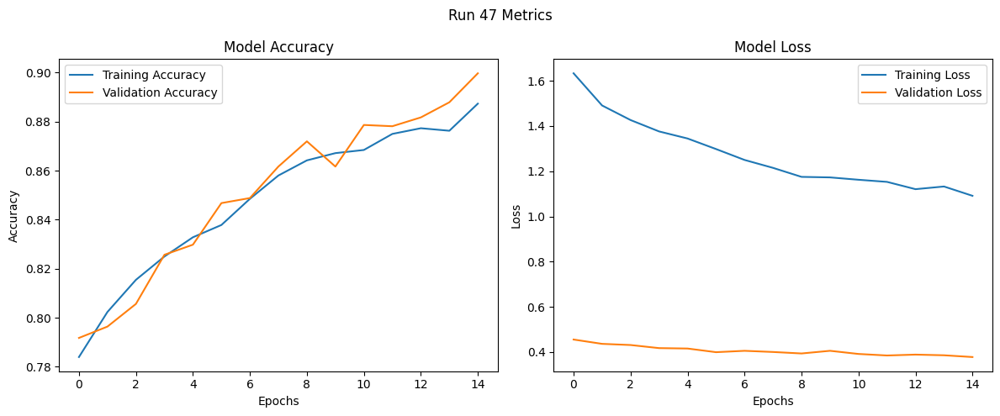

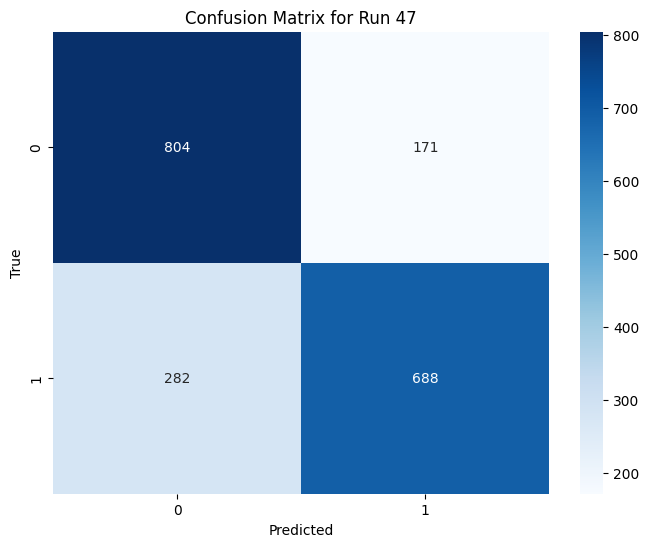

Run 48: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step - accuracy: 0.7541 - loss: 1.7253 - val_accuracy: 0.8031 - val_loss: 0.4598
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8015 - loss: 1.5229 - val_accuracy: 0.8144 - val_loss: 0.4513
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8132 - loss: 1.4646 - val_accuracy: 0.7779 - val_loss: 0.4597
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8202 - loss: 1.4170 - val_accuracy: 0.8046 - val_loss: 0.4619
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8218 - loss: 1.3927 - val_accuracy: 0.8257 - val_loss: 0.4281
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8398 - loss: 1.3320 - val_accuracy: 0.8344 - val_loss: 0.4263
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step -

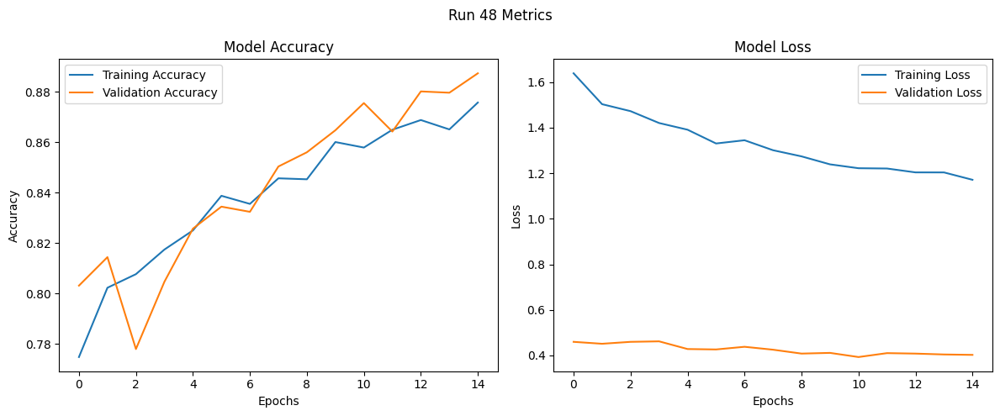

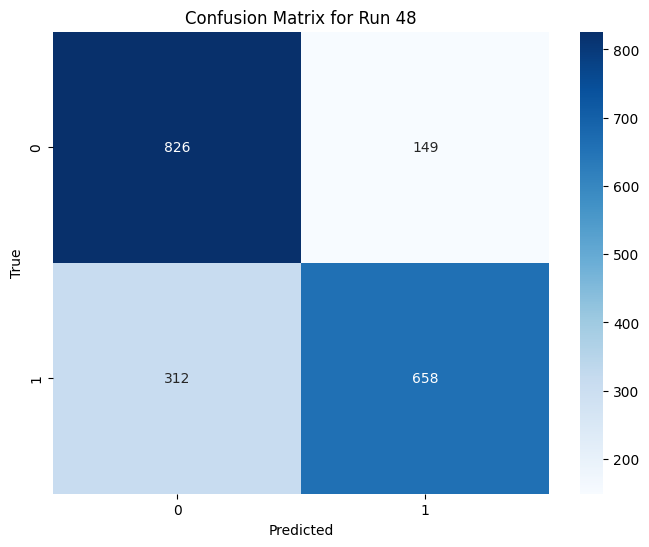

Run 49: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7482 - loss: 0.4329 - val_accuracy: 0.7779 - val_loss: 0.1685
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7979 - loss: 0.3613 - val_accuracy: 0.8072 - val_loss: 0.1528
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8169 - loss: 0.3417 - val_accuracy: 0.8093 - val_loss: 0.1528
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8293 - loss: 0.3264 - val_accuracy: 0.8093 - val_loss: 0.1520
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8371 - loss: 0.3051 - val_accuracy: 0.8298 - val_loss: 0.1416
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8385 - loss: 0.3132 - val_accuracy: 0.8324 - val_loss: 0.1438
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accur

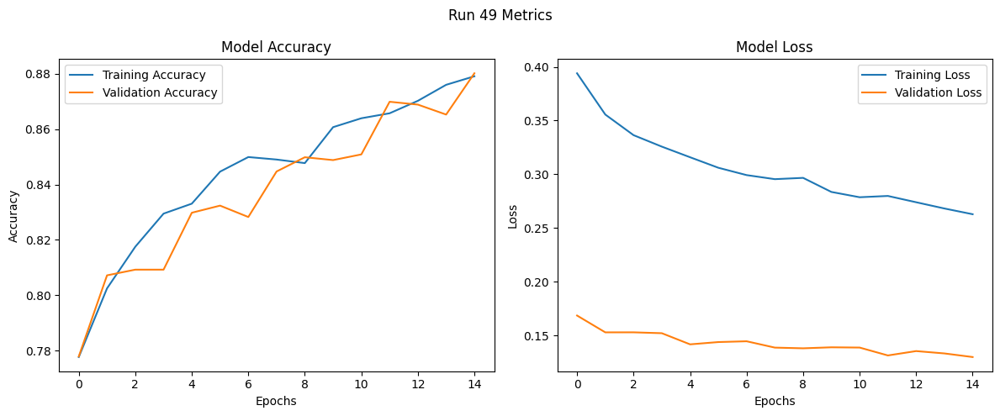

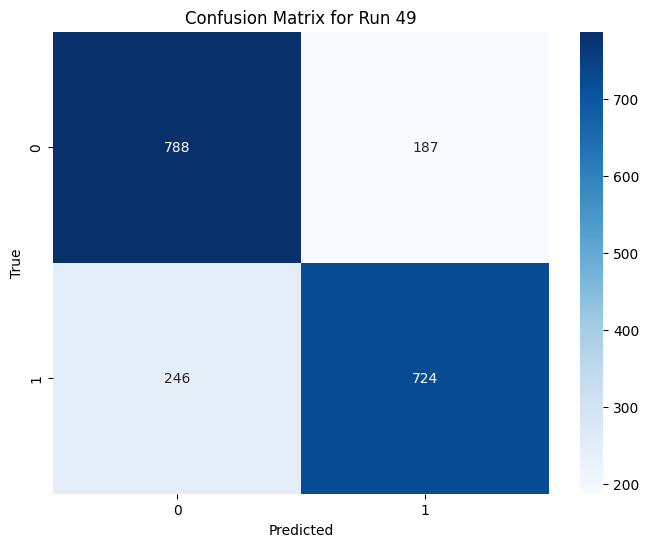

Run 50: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - accuracy: 0.7647 - loss: 0.4155 - val_accuracy: 0.7866 - val_loss: 0.1636
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7983 - loss: 0.3582 - val_accuracy: 0.8057 - val_loss: 0.1572
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8101 - loss: 0.3411 - val_accuracy: 0.8072 - val_loss: 0.1502
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8264 - loss: 0.3255 - val_accuracy: 0.8123 - val_loss: 0.1514
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8275 - loss: 0.3231 - val_accuracy: 0.8298 - val_loss: 0.1485
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8327 - loss: 0.3189 - val_accuracy: 0.8360 - val_loss: 0.1471
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accur

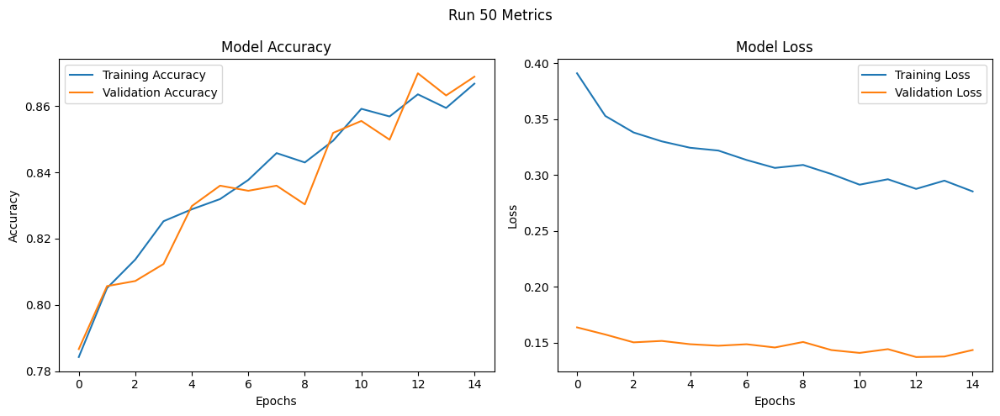

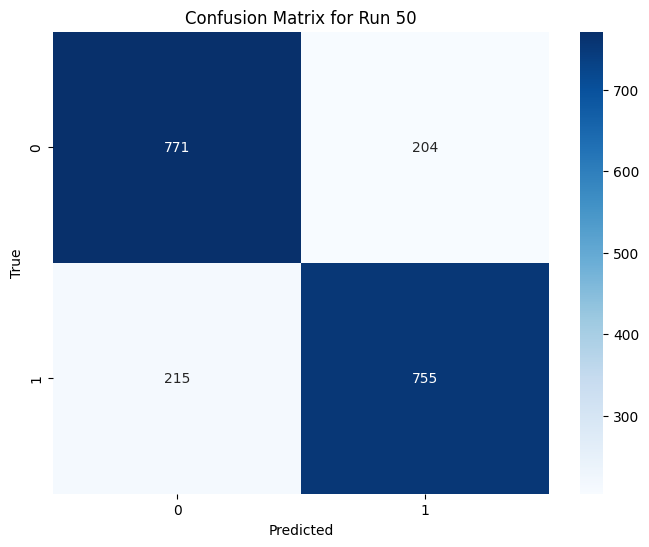

Run 51: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7487 - loss: 0.4394 - val_accuracy: 0.7774 - val_loss: 0.1676
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.8079 - loss: 0.3522 - val_accuracy: 0.7897 - val_loss: 0.1635
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8124 - loss: 0.3431 - val_accuracy: 0.8046 - val_loss: 0.1562
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8213 - loss: 0.3421 - val_accuracy: 0.8036 - val_loss: 0.1631
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8273 - loss: 0.3296 - val_accuracy: 0.8257 - val_loss: 0.1520
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8301 - loss: 0.3359 - val_accuracy: 0.8267 - val_loss: 0.1540
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accura

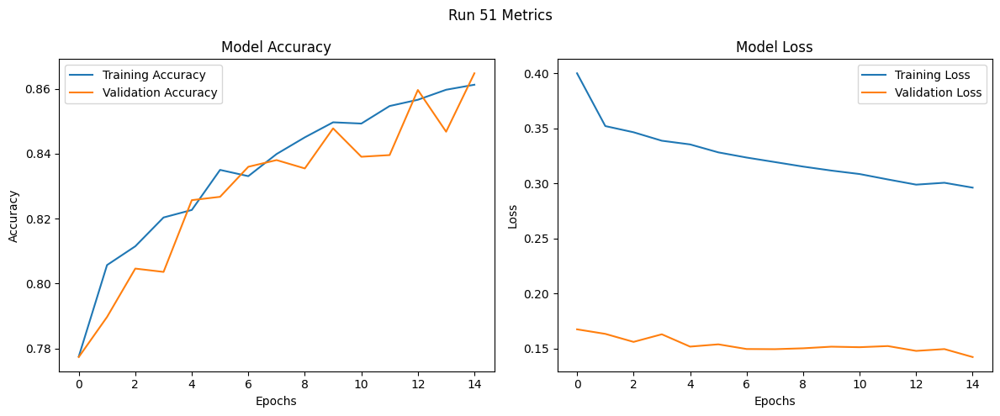

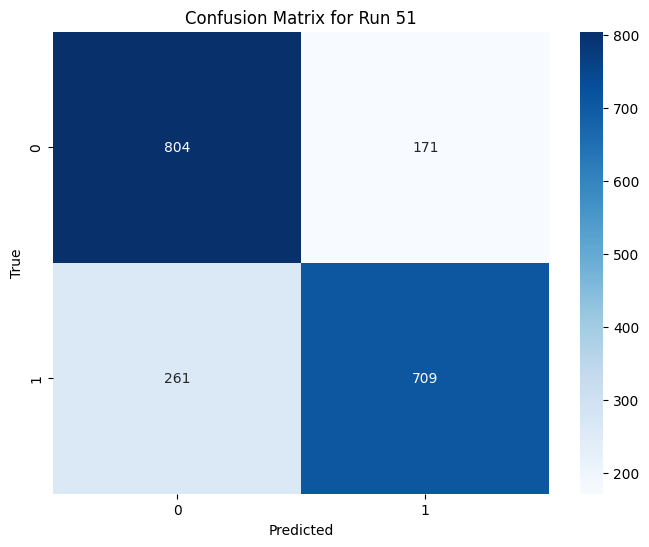

Run 52: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - accuracy: 0.7652 - loss: 0.5937 - val_accuracy: 0.8010 - val_loss: 0.1575
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8135 - loss: 0.4897 - val_accuracy: 0.8046 - val_loss: 0.1540
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8247 - loss: 0.4622 - val_accuracy: 0.8144 - val_loss: 0.1465
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8304 - loss: 0.4417 - val_accuracy: 0.7974 - val_loss: 0.1561
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8371 - loss: 0.4368 - val_accuracy: 0.8370 - val_loss: 0.1420
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8429 - loss: 0.4331 - val_accuracy: 0.8355 - val_loss: 0.1490
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accu

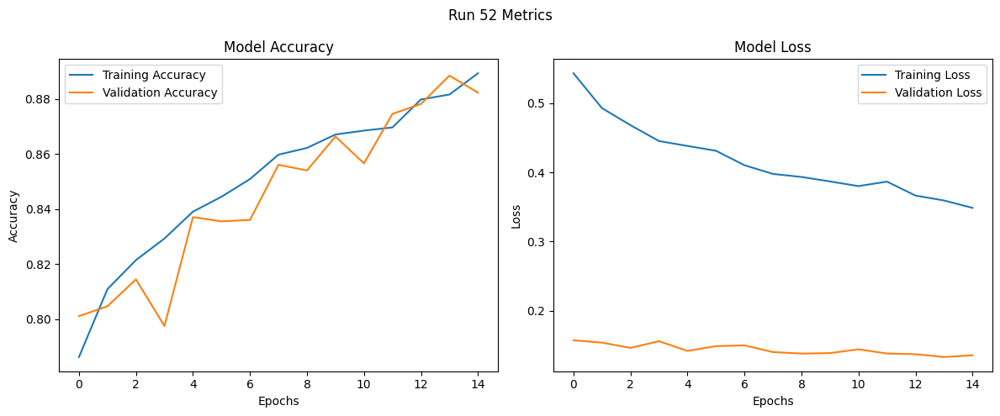

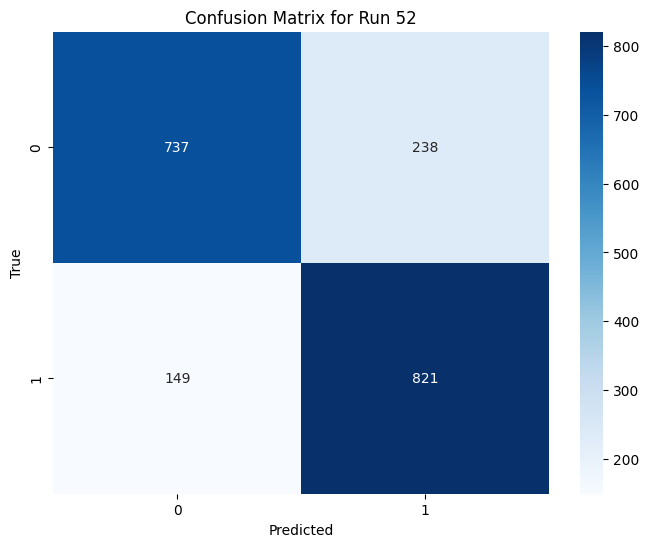

Run 53: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7520 - loss: 0.5911 - val_accuracy: 0.7907 - val_loss: 0.1679
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8169 - loss: 0.4889 - val_accuracy: 0.8000 - val_loss: 0.1616
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8171 - loss: 0.4834 - val_accuracy: 0.8201 - val_loss: 0.1548
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8268 - loss: 0.4677 - val_accuracy: 0.8201 - val_loss: 0.1514
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8402 - loss: 0.4394 - val_accuracy: 0.8267 - val_loss: 0.1551
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8475 - loss: 0.4219 - val_accuracy: 0.8324 - val_loss: 0.1568
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accu

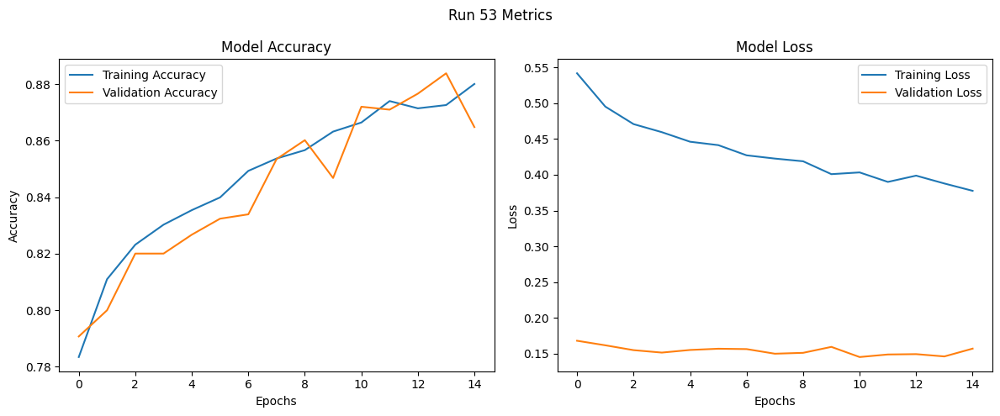

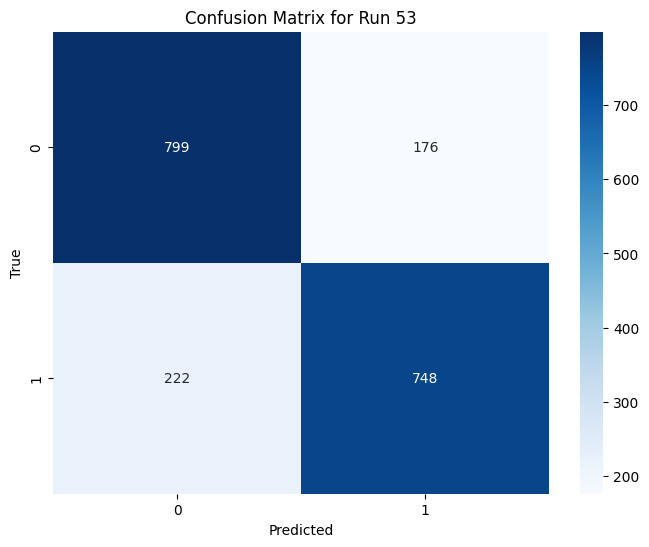

Run 54: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step - accuracy: 0.7618 - loss: 0.5912 - val_accuracy: 0.8026 - val_loss: 0.1637
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8004 - loss: 0.5150 - val_accuracy: 0.7995 - val_loss: 0.1589
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8201 - loss: 0.4740 - val_accuracy: 0.8175 - val_loss: 0.1614
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8291 - loss: 0.4723 - val_accuracy: 0.8226 - val_loss: 0.1559
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8432 - loss: 0.4342 - val_accuracy: 0.8087 - val_loss: 0.1666
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8357 - loss: 0.4573 - val_accuracy: 0.8144 - val_loss: 0.1618
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accura

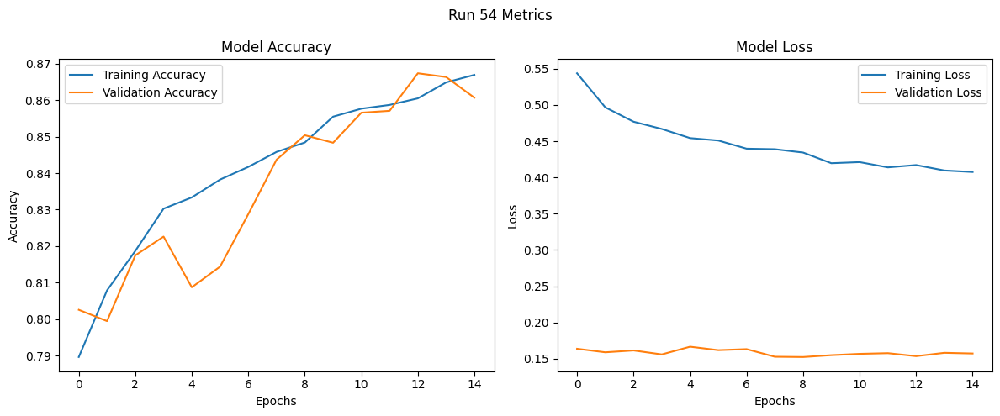

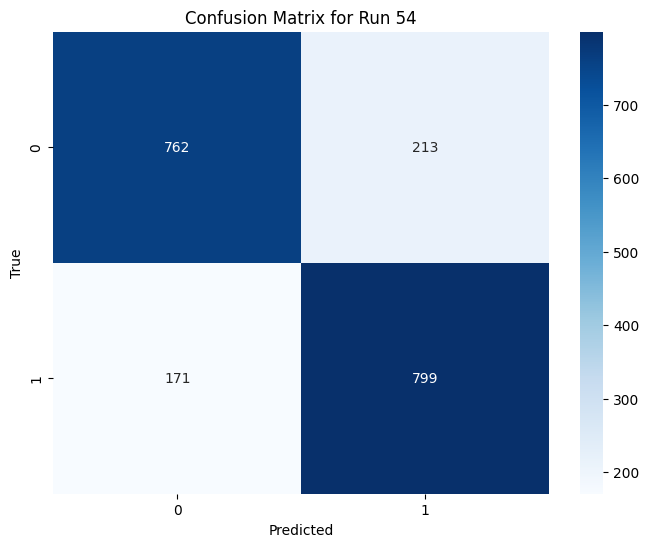

Run 55: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7518 - loss: 0.4271 - val_accuracy: 0.7933 - val_loss: 0.1605
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8094 - loss: 0.3514 - val_accuracy: 0.7892 - val_loss: 0.1580
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8124 - loss: 0.3409 - val_accuracy: 0.8134 - val_loss: 0.1527
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8263 - loss: 0.3226 - val_accuracy: 0.8165 - val_loss: 0.1465
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8308 - loss: 0.3200 - val_accuracy: 0.8237 - val_loss: 0.1434
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8431 - loss: 0.3024 - val_accuracy: 0.8298 - val_loss: 0.1430
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accu

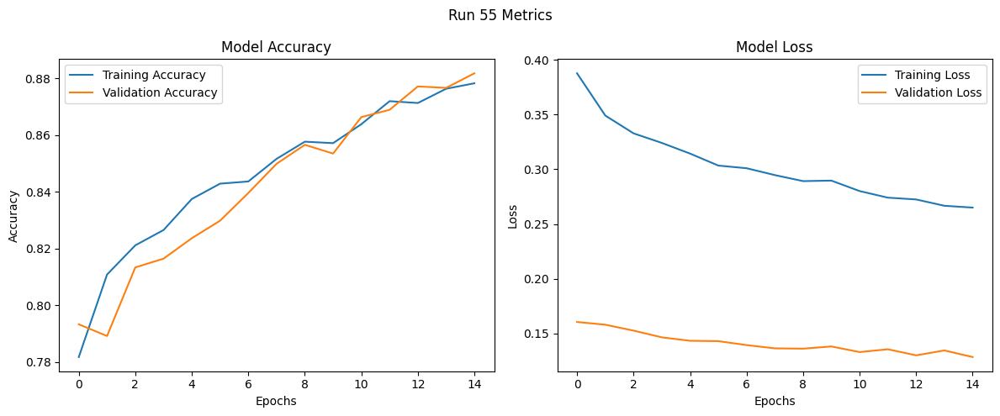

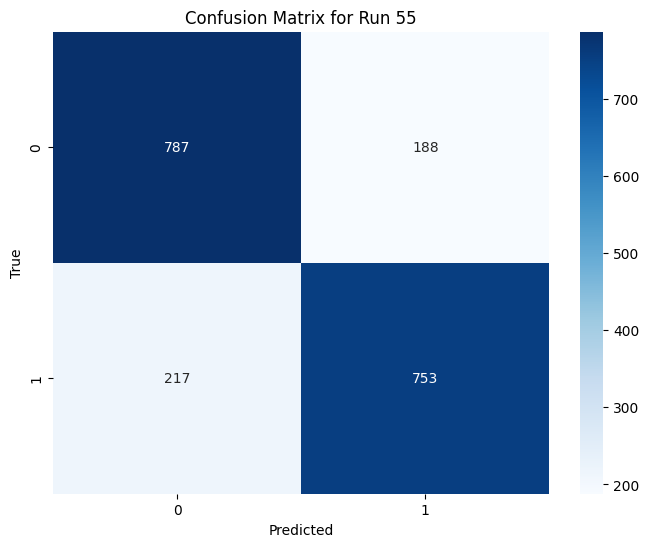

Run 56: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7472 - loss: 0.4311 - val_accuracy: 0.7974 - val_loss: 0.1570
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7866 - loss: 0.3691 - val_accuracy: 0.7979 - val_loss: 0.1630
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8050 - loss: 0.3515 - val_accuracy: 0.8134 - val_loss: 0.1528
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8202 - loss: 0.3299 - val_accuracy: 0.8180 - val_loss: 0.1512
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8317 - loss: 0.3186 - val_accuracy: 0.8139 - val_loss: 0.1492
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8357 - loss: 0.3134 - val_accuracy: 0.8134 - val_loss: 0.1548
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - acc

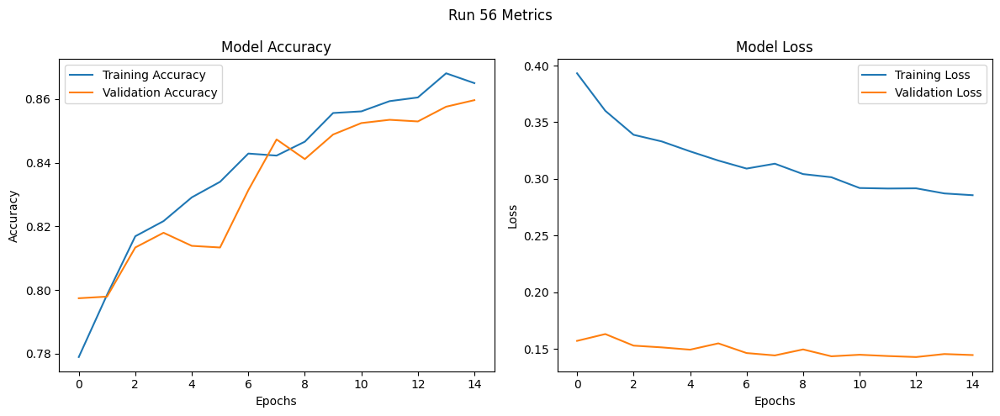

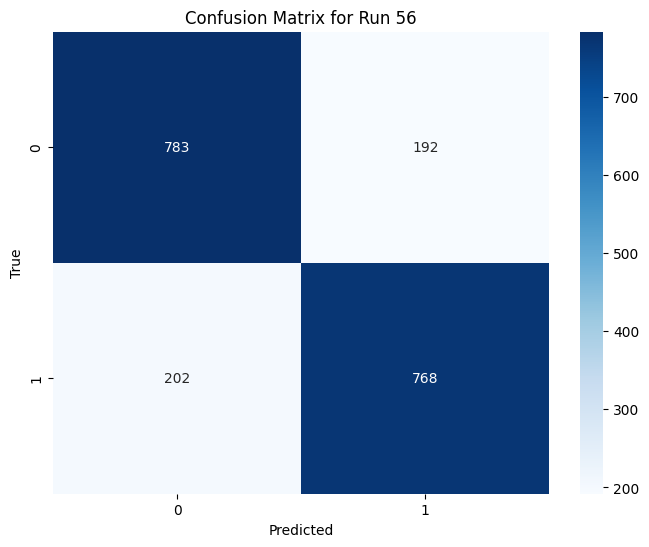

Run 57: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step - accuracy: 0.7435 - loss: 0.4298 - val_accuracy: 0.7933 - val_loss: 0.1601
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.7911 - loss: 0.3705 - val_accuracy: 0.8098 - val_loss: 0.1553
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8150 - loss: 0.3507 - val_accuracy: 0.7954 - val_loss: 0.1605
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8216 - loss: 0.3352 - val_accuracy: 0.8211 - val_loss: 0.1545
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8233 - loss: 0.3381 - val_accuracy: 0.8272 - val_loss: 0.1512
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8328 - loss: 0.3198 - val_accuracy: 0.8226 - val_loss: 0.1587
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accur

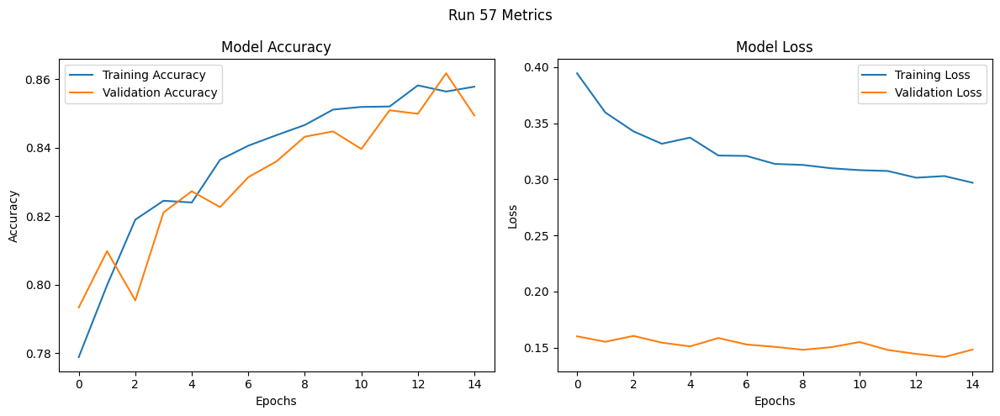

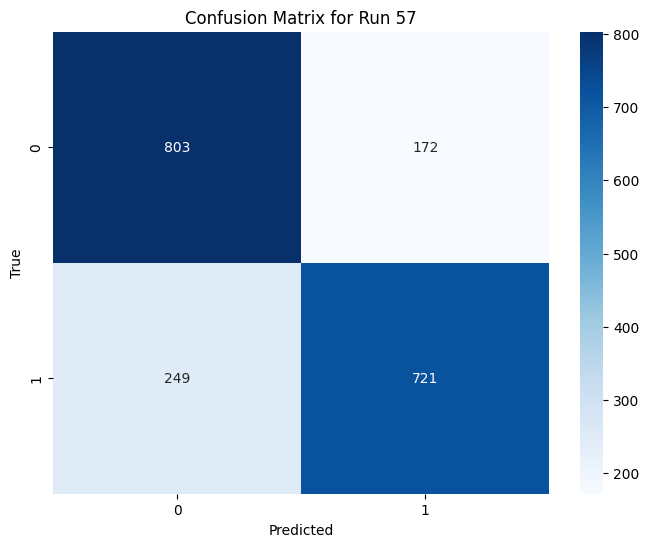

Run 58: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7363 - loss: 0.6150 - val_accuracy: 0.7758 - val_loss: 0.1659
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8054 - loss: 0.4919 - val_accuracy: 0.8057 - val_loss: 0.1569
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8198 - loss: 0.4649 - val_accuracy: 0.8149 - val_loss: 0.1510
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8345 - loss: 0.4450 - val_accuracy: 0.8195 - val_loss: 0.1534
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8360 - loss: 0.4378 - val_accuracy: 0.8319 - val_loss: 0.1474
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8407 - loss: 0.4324 - val_accuracy: 0.8406 - val_loss: 0.1412
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accu

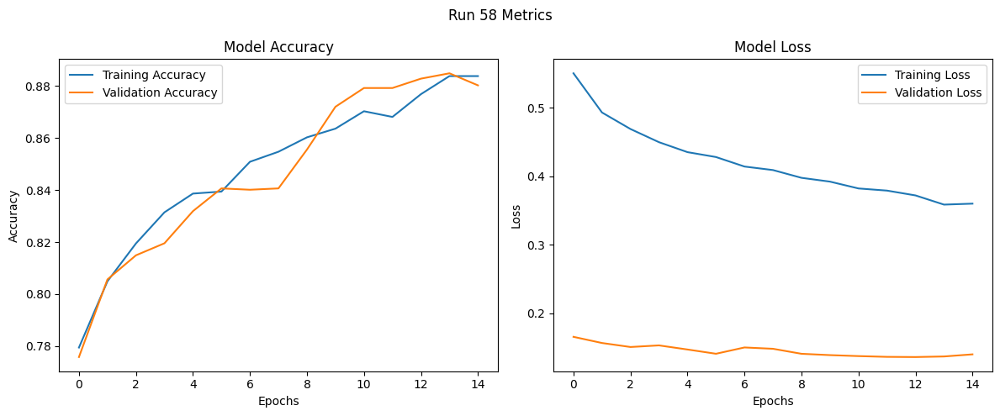

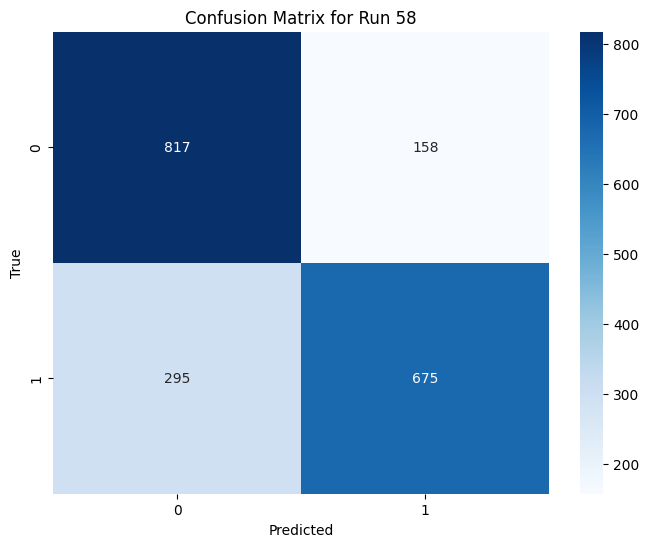

Run 59: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7737 - loss: 0.5831 - val_accuracy: 0.8031 - val_loss: 0.1604
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8083 - loss: 0.4878 - val_accuracy: 0.7866 - val_loss: 0.1680
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8292 - loss: 0.4577 - val_accuracy: 0.8113 - val_loss: 0.1546
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8304 - loss: 0.4466 - val_accuracy: 0.8252 - val_loss: 0.1490
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8353 - loss: 0.4409 - val_accuracy: 0.8221 - val_loss: 0.1550
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8414 - loss: 0.4341 - val_accuracy: 0.8314 - val_loss: 0.1523
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accu

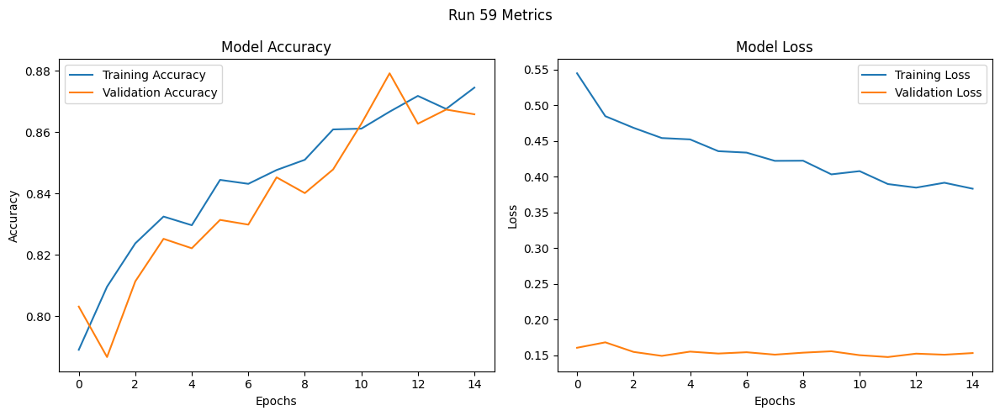

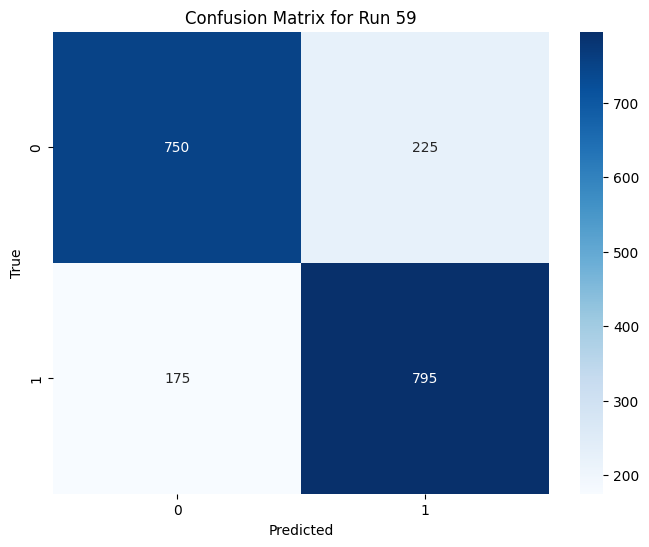

Run 60: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step - accuracy: 0.7644 - loss: 0.5870 - val_accuracy: 0.7861 - val_loss: 0.1665
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8027 - loss: 0.5068 - val_accuracy: 0.8098 - val_loss: 0.1585
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8207 - loss: 0.4816 - val_accuracy: 0.8134 - val_loss: 0.1587
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8235 - loss: 0.4706 - val_accuracy: 0.8231 - val_loss: 0.1538
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8273 - loss: 0.4630 - val_accuracy: 0.8303 - val_loss: 0.1596
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8319 - loss: 0.4606 - val_accuracy: 0.8350 - val_loss: 0.1563
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accur

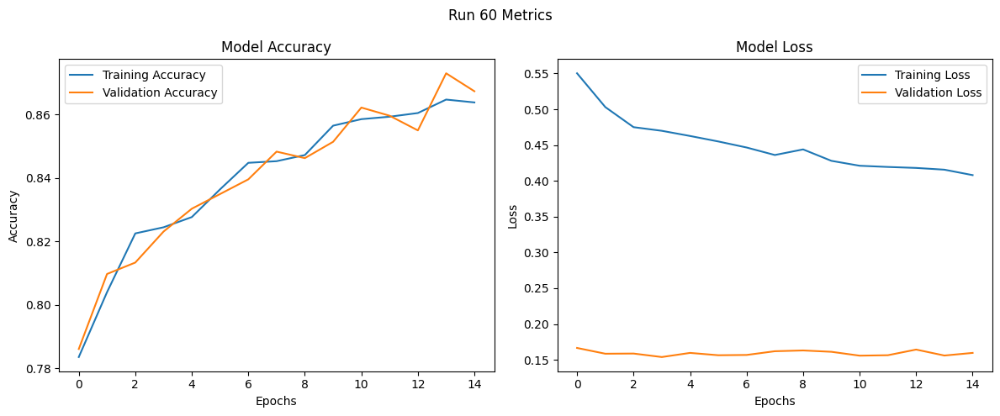

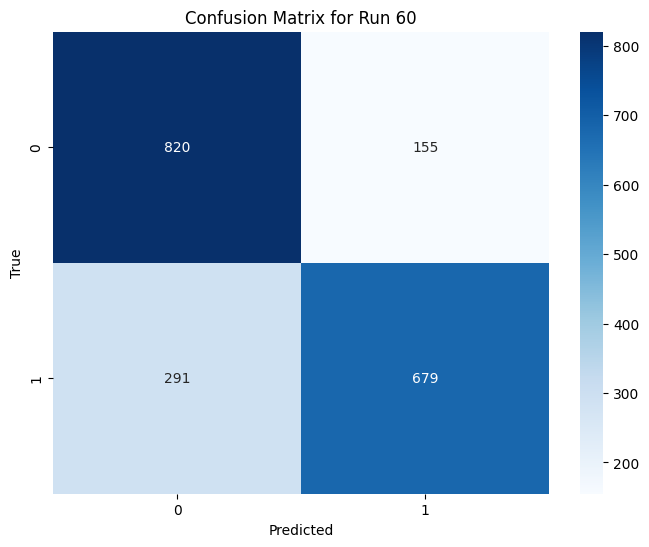

Run 61: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7568 - loss: 0.2069 - val_accuracy: 0.7866 - val_loss: 0.0825
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8024 - loss: 0.1716 - val_accuracy: 0.8015 - val_loss: 0.0757
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8100 - loss: 0.1659 - val_accuracy: 0.8123 - val_loss: 0.0733
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8193 - loss: 0.1575 - val_accuracy: 0.8206 - val_loss: 0.0710
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8355 - loss: 0.1486 - val_accuracy: 0.8221 - val_loss: 0.0711
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8385 - loss: 0.1483 - val_accuracy: 0.8370 - val_loss: 0.0686
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8376

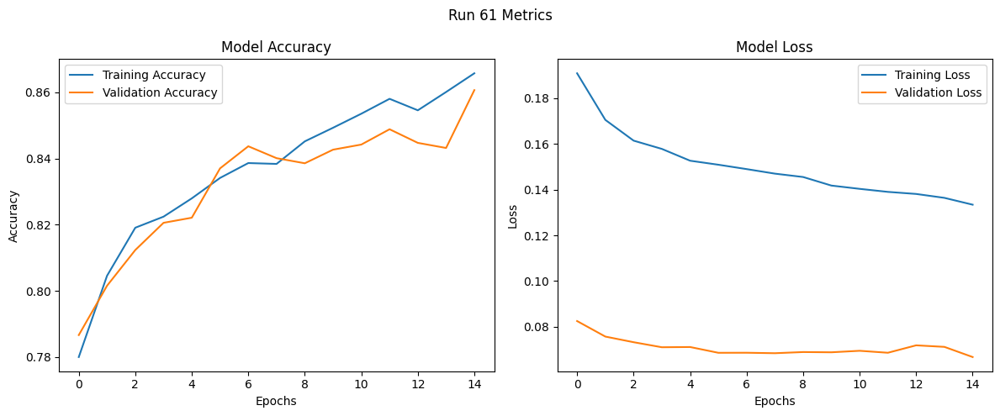

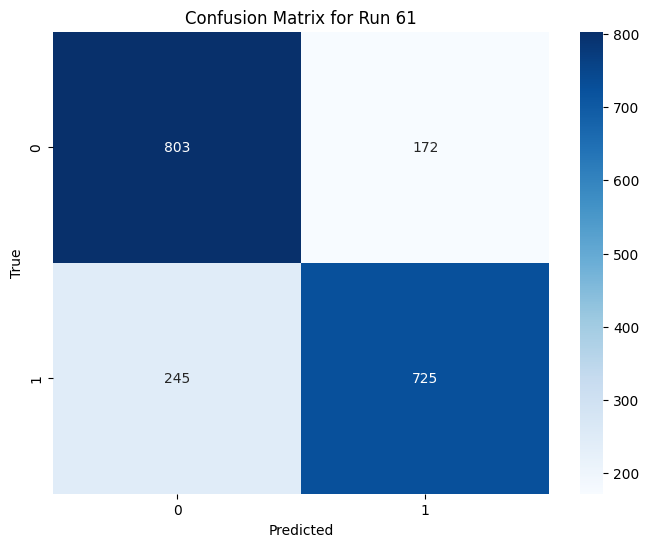

Run 62: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7566 - loss: 0.2095 - val_accuracy: 0.7907 - val_loss: 0.0773
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8056 - loss: 0.1682 - val_accuracy: 0.8010 - val_loss: 0.0750
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8111 - loss: 0.1618 - val_accuracy: 0.8123 - val_loss: 0.0743
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8218 - loss: 0.1585 - val_accuracy: 0.7918 - val_loss: 0.0789
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8173 - loss: 0.1592 - val_accuracy: 0.8087 - val_loss: 0.0761
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8241 - loss: 0.1601 - val_accuracy: 0.8278 - val_loss: 0.0733
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.84

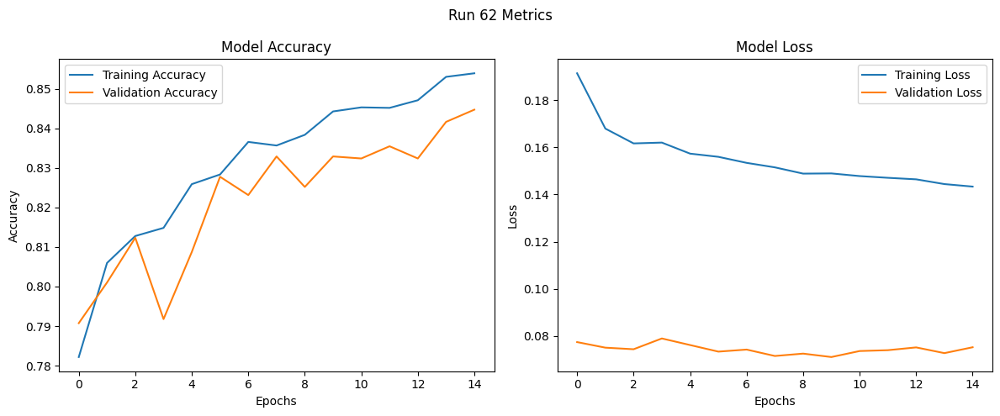

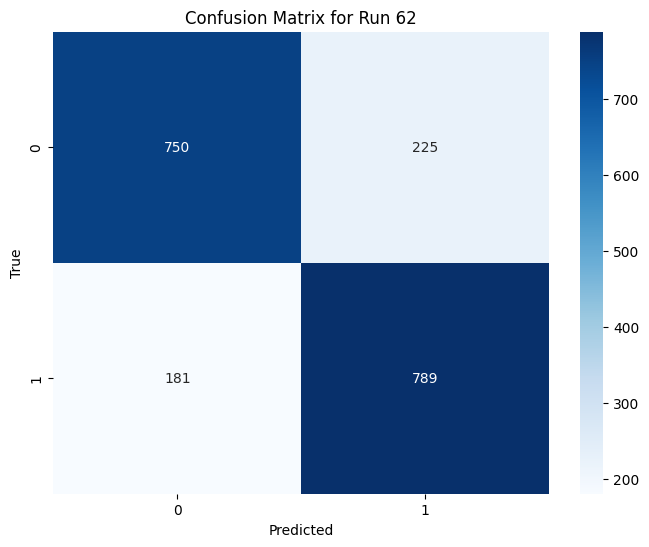

Run 63: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7802 - loss: 0.2067 - val_accuracy: 0.7877 - val_loss: 0.0810
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8117 - loss: 0.1663 - val_accuracy: 0.7892 - val_loss: 0.0812
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8211 - loss: 0.1623 - val_accuracy: 0.7990 - val_loss: 0.0784
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8210 - loss: 0.1606 - val_accuracy: 0.8159 - val_loss: 0.0753
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8269 - loss: 0.1611 - val_accuracy: 0.8216 - val_loss: 0.0743
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8247 - loss: 0.1609 - val_accuracy: 0.8226 - val_loss: 0.0750
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8388

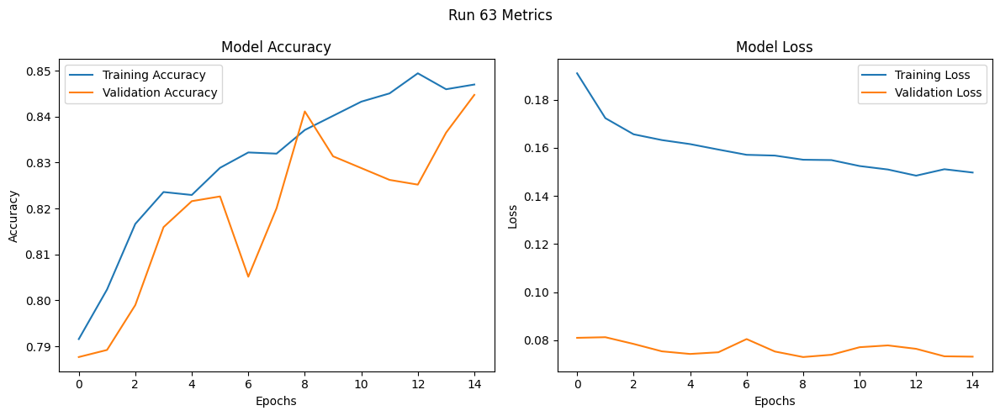

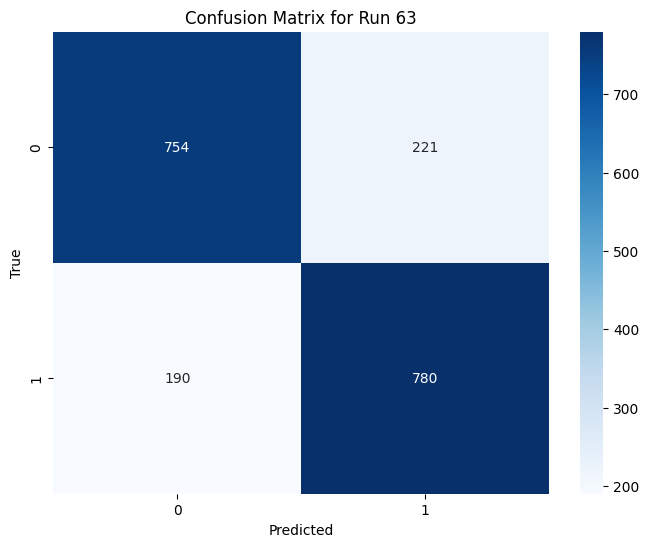

Run 64: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7680 - loss: 0.2893 - val_accuracy: 0.8031 - val_loss: 0.0801
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8038 - loss: 0.2396 - val_accuracy: 0.8144 - val_loss: 0.0764
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8147 - loss: 0.2283 - val_accuracy: 0.8165 - val_loss: 0.0745
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8134 - loss: 0.2240 - val_accuracy: 0.8267 - val_loss: 0.0736
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8335 - loss: 0.2111 - val_accuracy: 0.8206 - val_loss: 0.0748
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8496 - loss: 0.2004 - val_accuracy: 0.8303 - val_loss: 0.0737
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8346

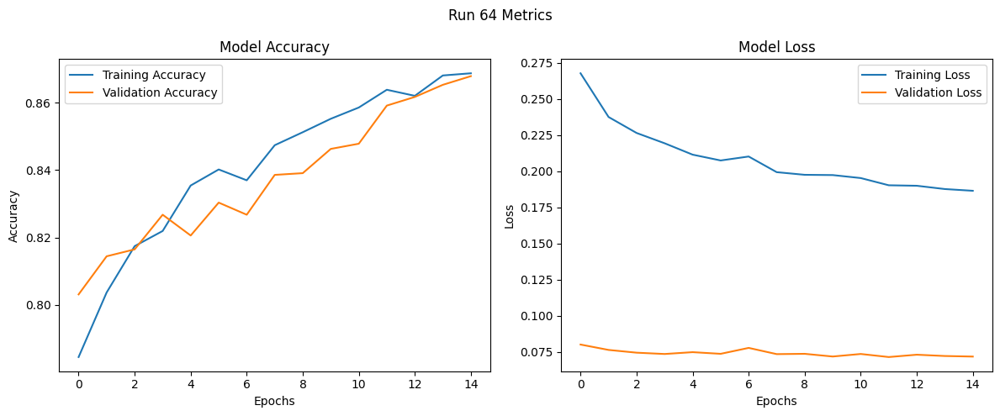

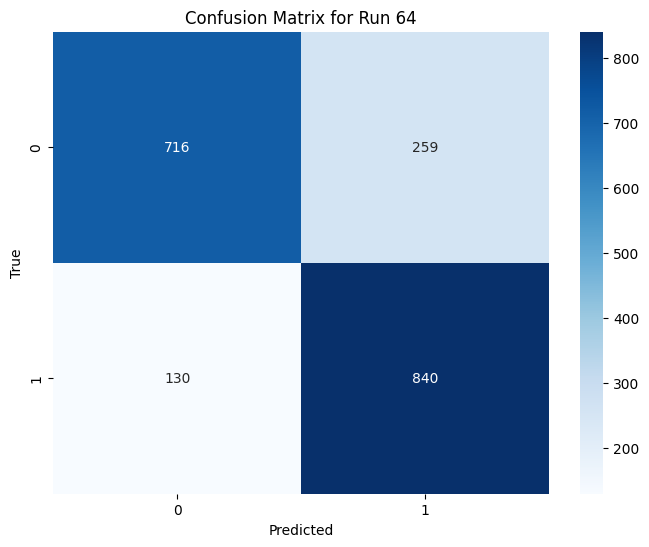

Run 65: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7612 - loss: 0.2882 - val_accuracy: 0.7877 - val_loss: 0.0825
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8017 - loss: 0.2422 - val_accuracy: 0.8108 - val_loss: 0.0756
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8216 - loss: 0.2214 - val_accuracy: 0.8129 - val_loss: 0.0756
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8320 - loss: 0.2138 - val_accuracy: 0.7918 - val_loss: 0.0807
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8327 - loss: 0.2136 - val_accuracy: 0.8206 - val_loss: 0.0762
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8343 - loss: 0.2126 - val_accuracy: 0.8278 - val_loss: 0.0767
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.840

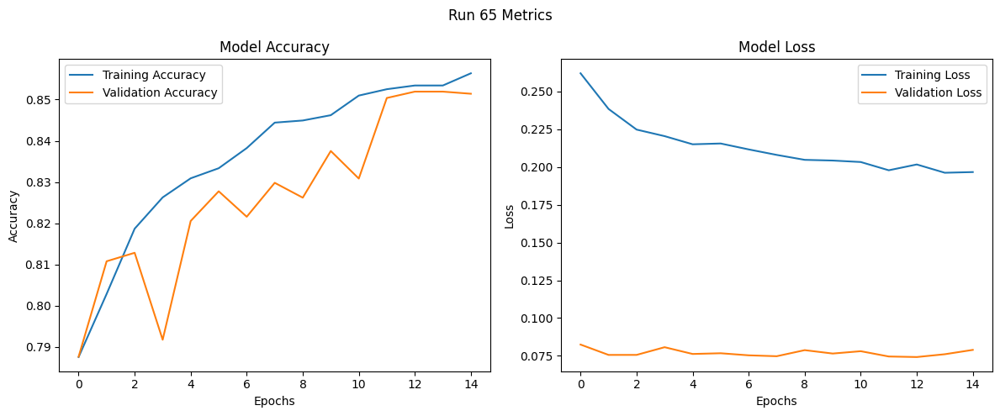

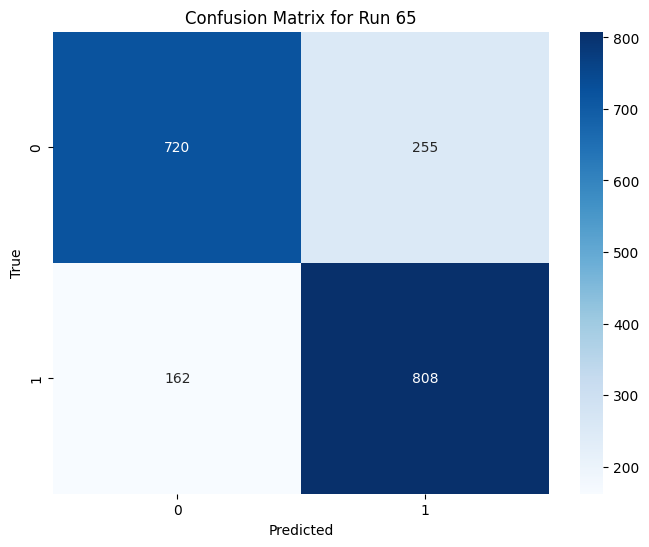

Run 66: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7526 - loss: 0.2894 - val_accuracy: 0.7820 - val_loss: 0.0855
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.7981 - loss: 0.2453 - val_accuracy: 0.7830 - val_loss: 0.0876
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8090 - loss: 0.2388 - val_accuracy: 0.7969 - val_loss: 0.0872
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8221 - loss: 0.2301 - val_accuracy: 0.8046 - val_loss: 0.0808
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8297 - loss: 0.2203 - val_accuracy: 0.8103 - val_loss: 0.0810
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8230 - loss: 0.2233 - val_accuracy: 0.8036 - val_loss: 0.0828
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8338

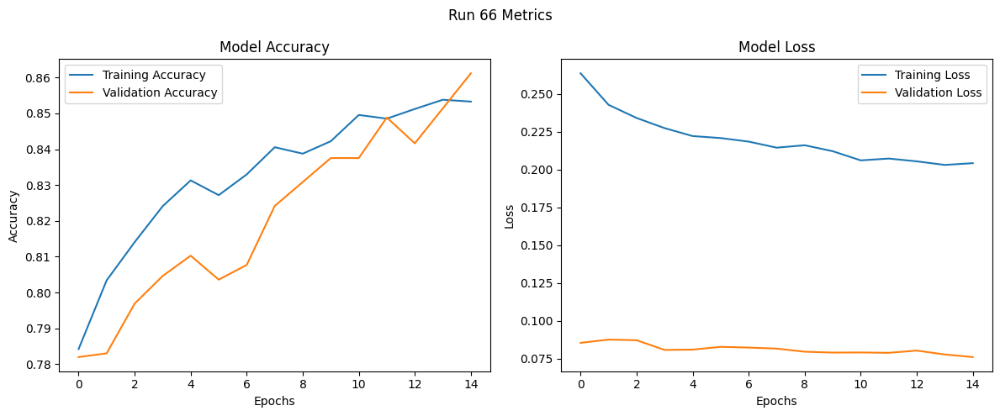

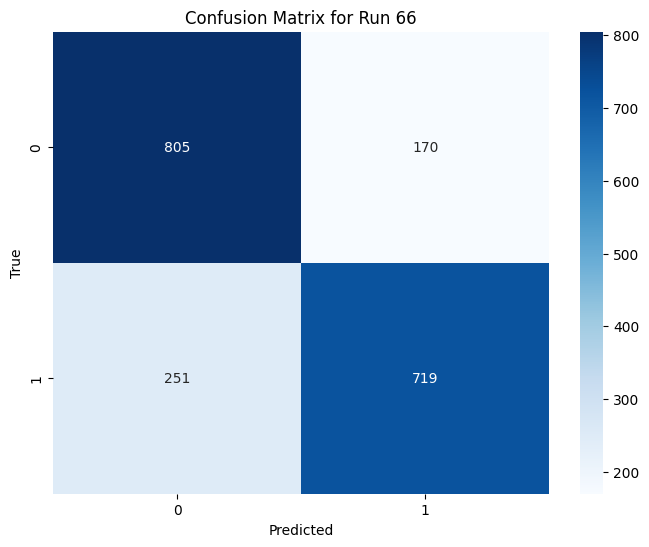

Run 67: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7375 - loss: 0.2110 - val_accuracy: 0.7923 - val_loss: 0.0802
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8094 - loss: 0.1670 - val_accuracy: 0.7769 - val_loss: 0.0822
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8054 - loss: 0.1654 - val_accuracy: 0.7969 - val_loss: 0.0780
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8175 - loss: 0.1560 - val_accuracy: 0.8113 - val_loss: 0.0741
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8331 - loss: 0.1507 - val_accuracy: 0.8226 - val_loss: 0.0705
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8507 - loss: 0.1411 - val_accuracy: 0.8303 - val_loss: 0.0711
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.83

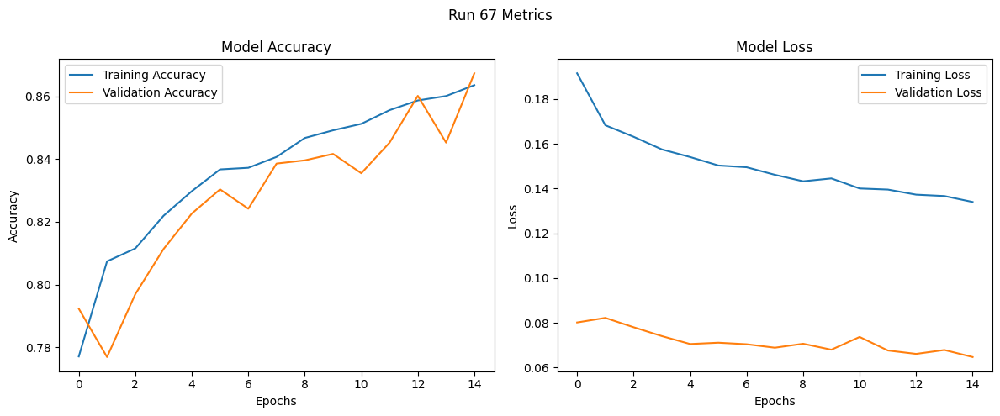

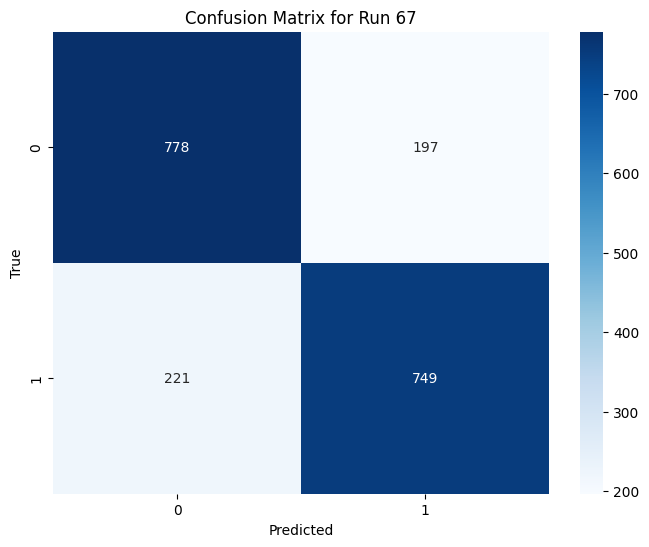

Run 68: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7508 - loss: 0.2057 - val_accuracy: 0.7810 - val_loss: 0.0845
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8067 - loss: 0.1698 - val_accuracy: 0.7779 - val_loss: 0.0815
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8091 - loss: 0.1693 - val_accuracy: 0.8206 - val_loss: 0.0746
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8257 - loss: 0.1592 - val_accuracy: 0.8159 - val_loss: 0.0753
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8263 - loss: 0.1594 - val_accuracy: 0.8211 - val_loss: 0.0741
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8341 - loss: 0.1546 - val_accuracy: 0.8216 - val_loss: 0.0744
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8

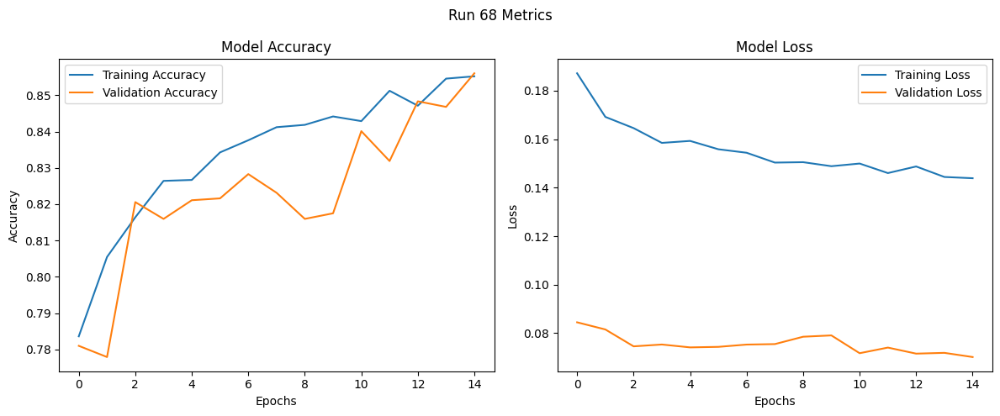

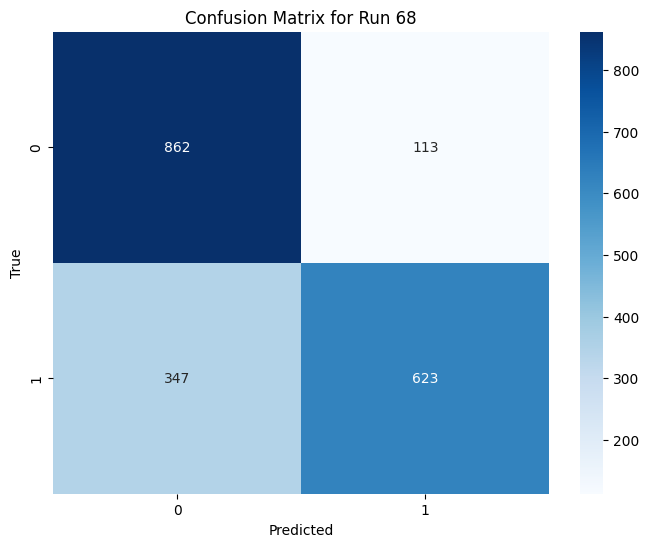

Run 69: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7516 - loss: 0.2113 - val_accuracy: 0.7769 - val_loss: 0.0836
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8005 - loss: 0.1737 - val_accuracy: 0.7830 - val_loss: 0.0820
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8066 - loss: 0.1697 - val_accuracy: 0.7943 - val_loss: 0.0788
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8165 - loss: 0.1644 - val_accuracy: 0.8216 - val_loss: 0.0734
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8158 - loss: 0.1641 - val_accuracy: 0.8123 - val_loss: 0.0757
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8266 - loss: 0.1591 - val_accuracy: 0.8113 - val_loss: 0.0766
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.823

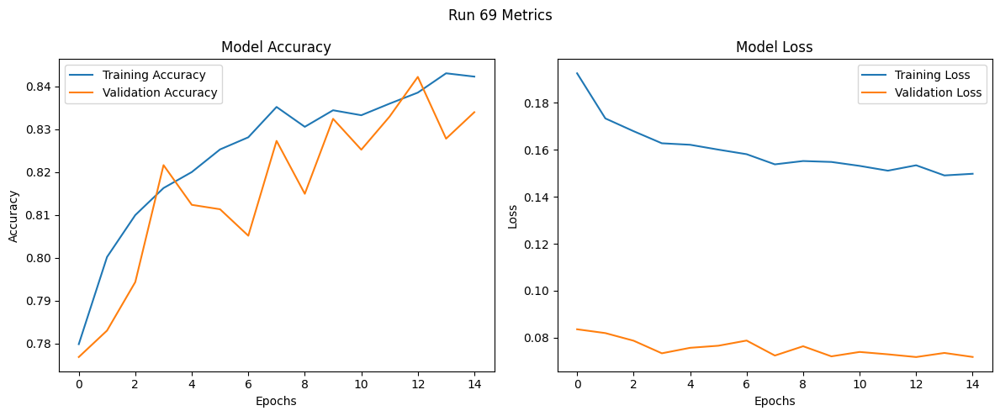

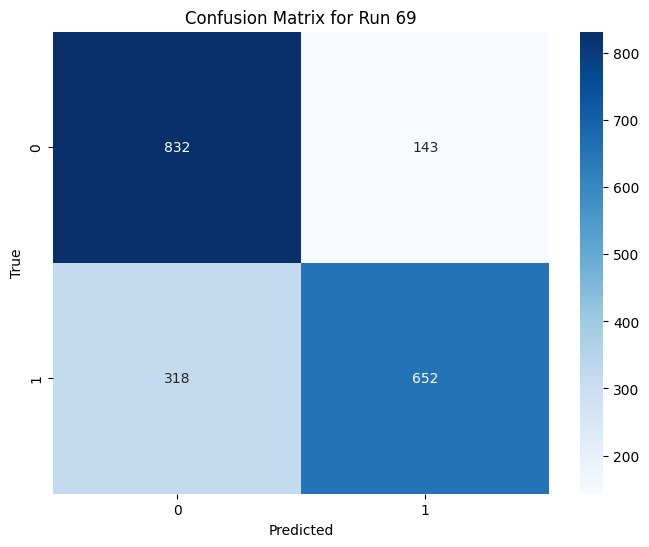

Run 70: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7603 - loss: 0.2877 - val_accuracy: 0.7866 - val_loss: 0.0802
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8131 - loss: 0.2391 - val_accuracy: 0.7907 - val_loss: 0.0801
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8115 - loss: 0.2291 - val_accuracy: 0.8180 - val_loss: 0.0754
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8290 - loss: 0.2153 - val_accuracy: 0.8144 - val_loss: 0.0753
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8332 - loss: 0.2113 - val_accuracy: 0.8293 - val_loss: 0.0744
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8369 - loss: 0.2068 - val_accuracy: 0.8360 - val_loss: 0.0721
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.842

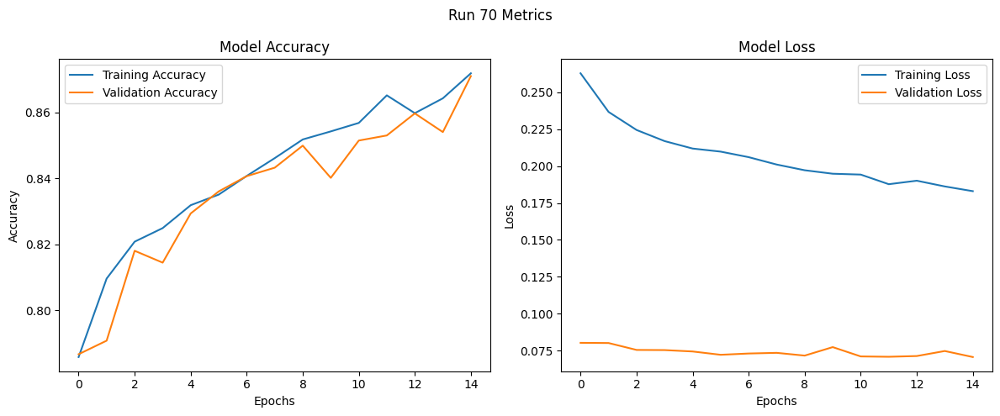

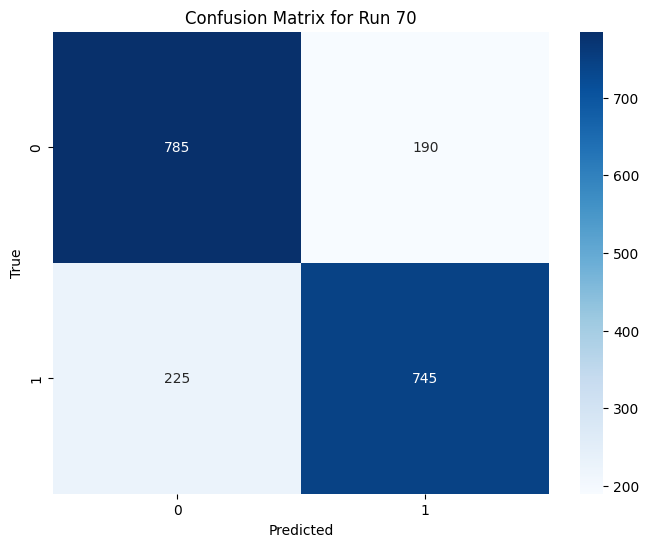

Run 71: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7724 - loss: 0.2840 - val_accuracy: 0.8067 - val_loss: 0.0796
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.8008 - loss: 0.2433 - val_accuracy: 0.8098 - val_loss: 0.0779
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8234 - loss: 0.2255 - val_accuracy: 0.8134 - val_loss: 0.0772
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8140 - loss: 0.2322 - val_accuracy: 0.8149 - val_loss: 0.0778
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8281 - loss: 0.2202 - val_accuracy: 0.8221 - val_loss: 0.0782
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8349 - loss: 0.2152 - val_accuracy: 0.8170 - val_loss: 0.0788
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8

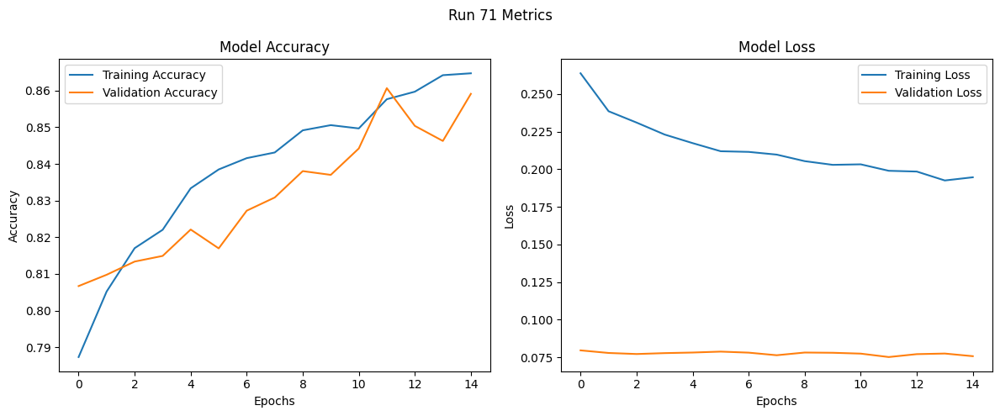

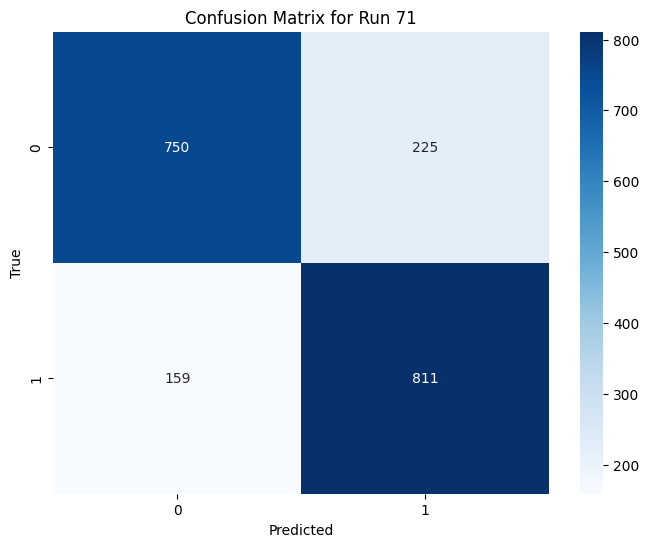

Run 72: L2: 0.0001, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 12s 12ms/step - accuracy: 0.7654 - loss: 0.2870 - val_accuracy: 0.8005 - val_loss: 0.0806
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7962 - loss: 0.2475 - val_accuracy: 0.8010 - val_loss: 0.0798
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8196 - loss: 0.2266 - val_accuracy: 0.7928 - val_loss: 0.0846
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8200 - loss: 0.2327 - val_accuracy: 0.8041 - val_loss: 0.0822
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8295 - loss: 0.2171 - val_accuracy: 0.8046 - val_loss: 0.0842
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8289 - loss: 0.2276 - val_accuracy: 0.8180 - val_loss: 0.0814
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.83

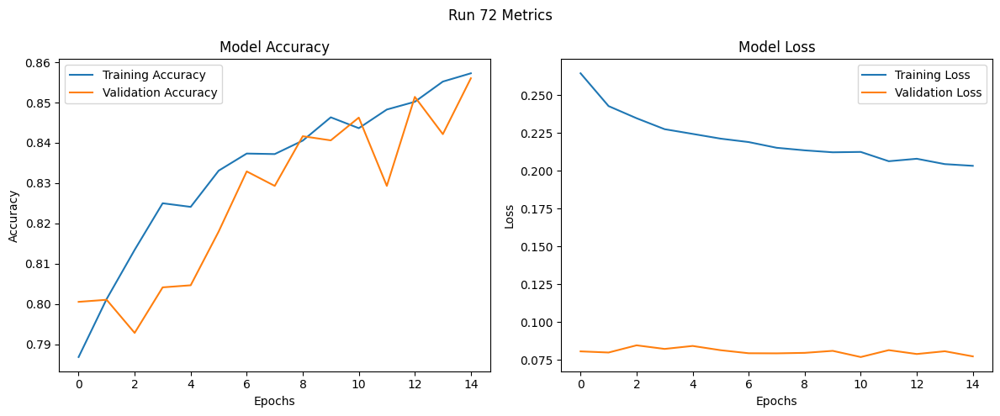

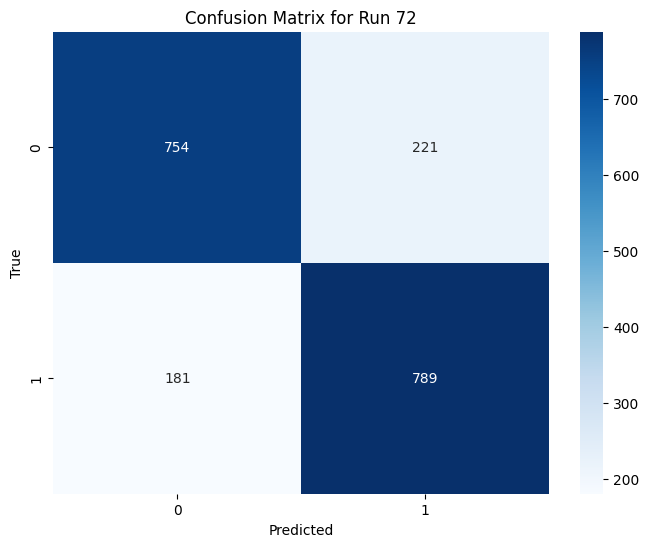

Run 73: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7449 - loss: 1.2430 - val_accuracy: 0.7943 - val_loss: 0.4443
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8093 - loss: 1.0276 - val_accuracy: 0.7949 - val_loss: 0.4364
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8083 - loss: 1.0101 - val_accuracy: 0.8123 - val_loss: 0.4141
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8120 - loss: 0.9831 - val_accuracy: 0.8180 - val_loss: 0.4072
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8266 - loss: 0.9405 - val_accuracy: 0.8298 - val_loss: 0.3817
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8235 - loss: 0.9341 - val_accuracy: 0.8242 - val_loss: 0.3898
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - ac

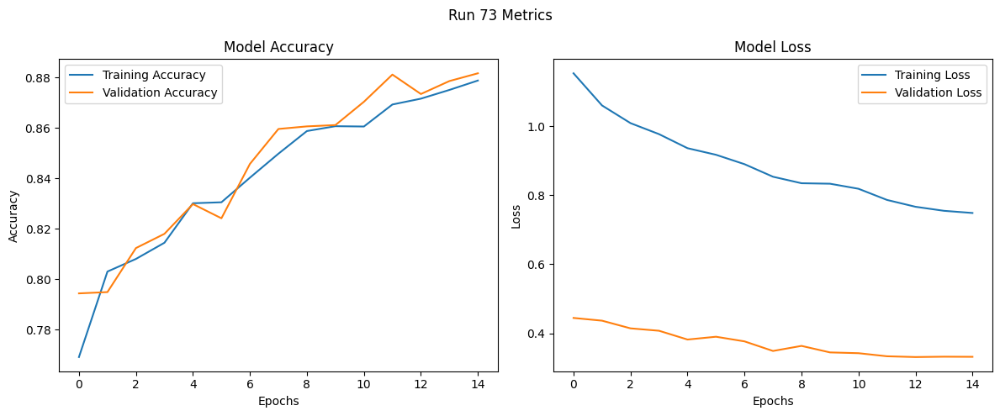

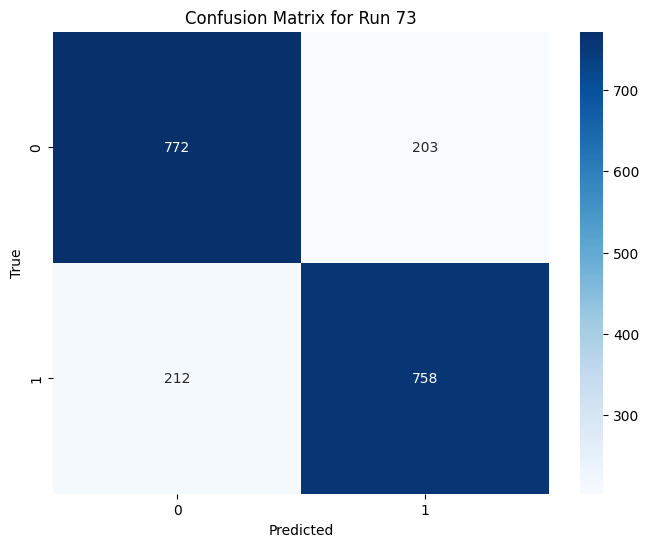

Run 74: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7313 - loss: 1.2788 - val_accuracy: 0.7604 - val_loss: 0.4978
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7910 - loss: 1.0606 - val_accuracy: 0.7969 - val_loss: 0.4359
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8123 - loss: 1.0020 - val_accuracy: 0.8103 - val_loss: 0.4148
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8263 - loss: 0.9436 - val_accuracy: 0.8267 - val_loss: 0.3983
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8284 - loss: 0.9608 - val_accuracy: 0.8005 - val_loss: 0.4328
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8254 - loss: 0.9367 - val_accuracy: 0.8478 - val_loss: 0.3970
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - a

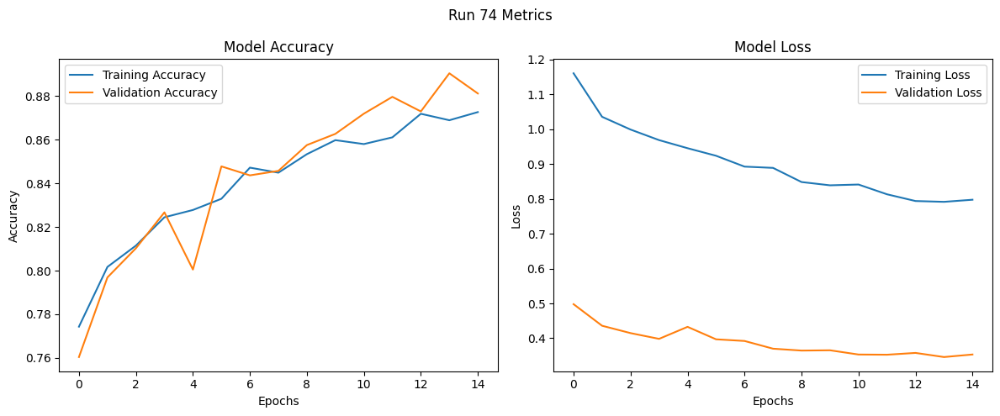

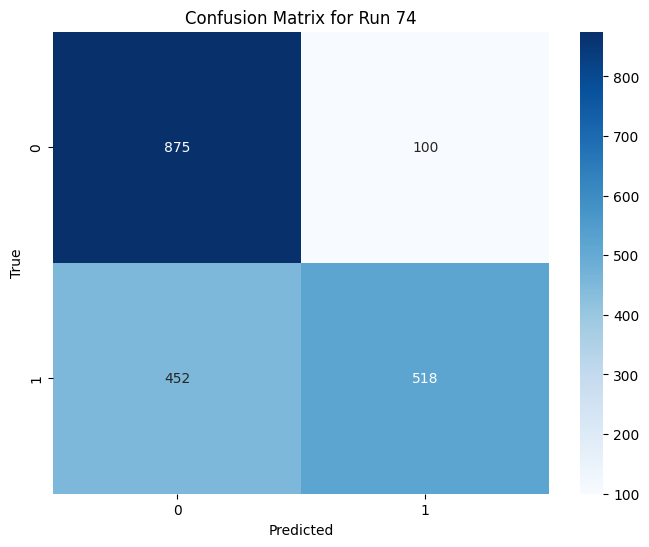

Run 75: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7389 - loss: 1.2568 - val_accuracy: 0.7918 - val_loss: 0.4603
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7974 - loss: 1.0683 - val_accuracy: 0.7805 - val_loss: 0.4563
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8102 - loss: 1.0110 - val_accuracy: 0.7866 - val_loss: 0.4454
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8138 - loss: 0.9938 - val_accuracy: 0.8051 - val_loss: 0.4240
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8185 - loss: 0.9661 - val_accuracy: 0.8231 - val_loss: 0.4070
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8252 - loss: 0.9565 - val_accuracy: 0.8257 - val_loss: 0.4080
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - ac

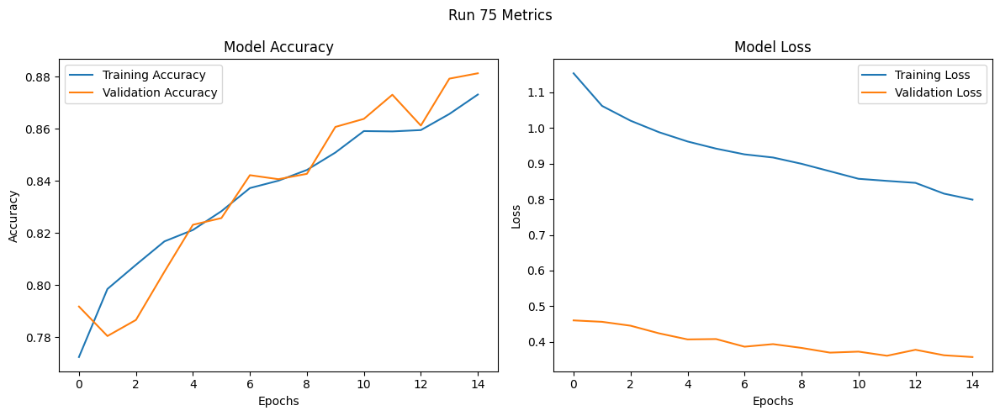

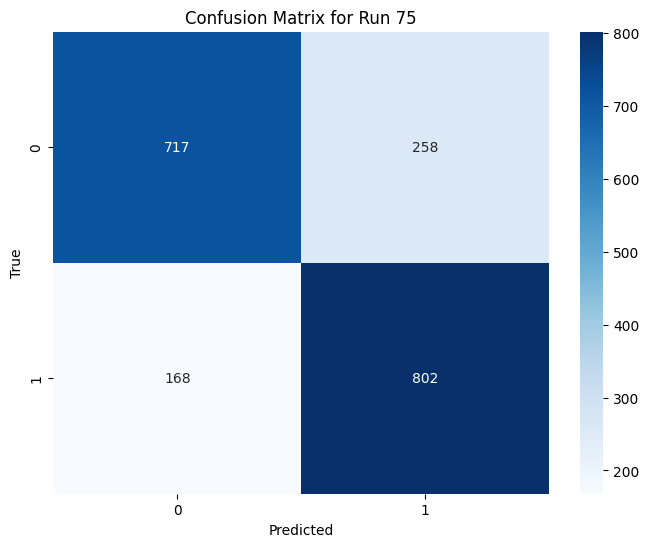

Run 76: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.7326 - loss: 1.7822 - val_accuracy: 0.8026 - val_loss: 0.4418
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8003 - loss: 1.5102 - val_accuracy: 0.7841 - val_loss: 0.4475
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8038 - loss: 1.4503 - val_accuracy: 0.8159 - val_loss: 0.4105
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8236 - loss: 1.3254 - val_accuracy: 0.8165 - val_loss: 0.4002
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8265 - loss: 1.3352 - val_accuracy: 0.8231 - val_loss: 0.3989
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8364 - loss: 1.2738 - val_accuracy: 0.8437 - val_loss: 0.3861
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - ac

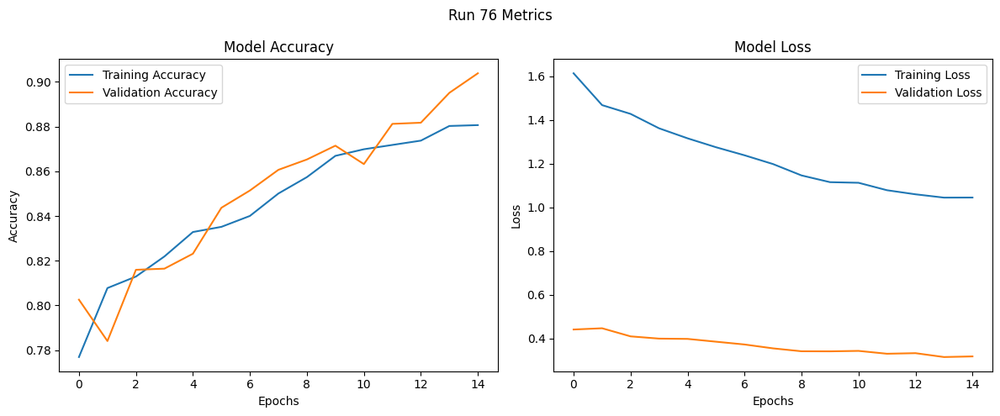

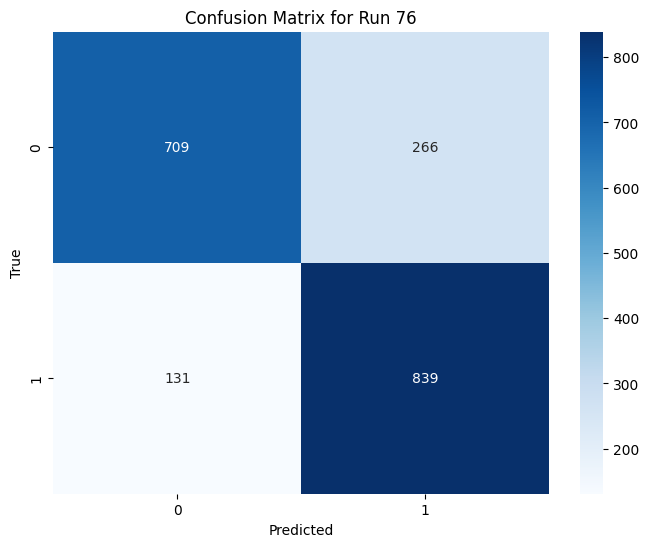

Run 77: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7462 - loss: 1.7735 - val_accuracy: 0.8108 - val_loss: 0.4286
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8106 - loss: 1.4684 - val_accuracy: 0.8046 - val_loss: 0.4209
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8274 - loss: 1.3657 - val_accuracy: 0.8201 - val_loss: 0.4147
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8267 - loss: 1.3574 - val_accuracy: 0.8144 - val_loss: 0.4067
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8305 - loss: 1.3235 - val_accuracy: 0.8247 - val_loss: 0.4004
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8512 - loss: 1.2324 - val_accuracy: 0.8252 - val_loss: 0.3795
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - 

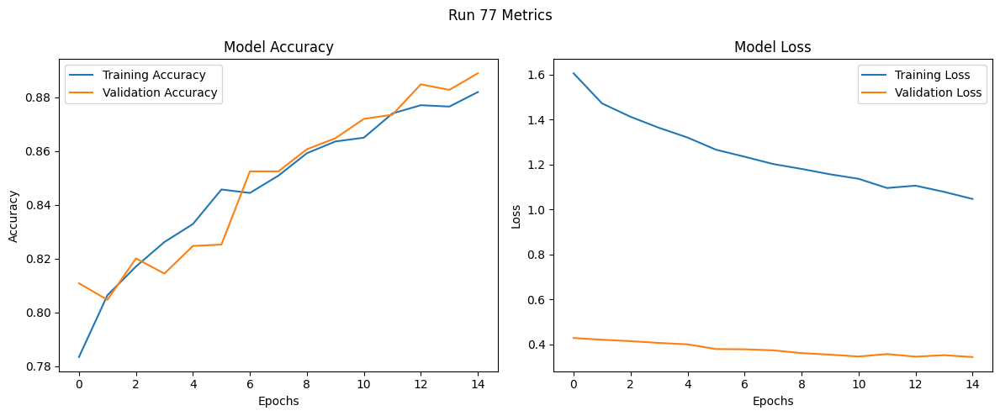

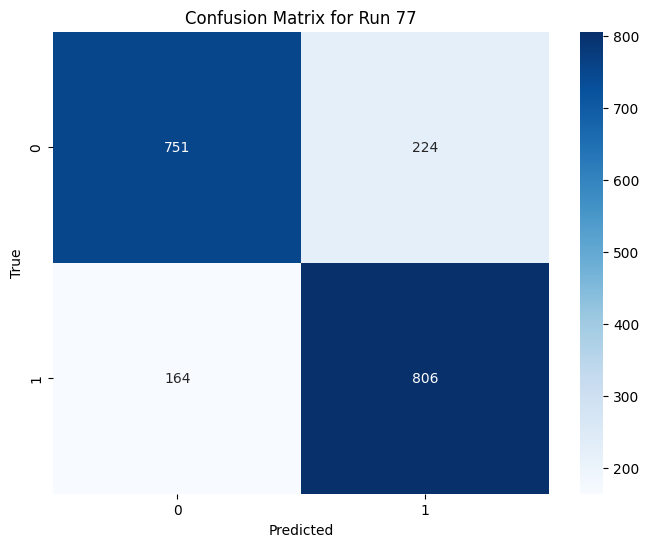

Run 78: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7580 - loss: 1.7398 - val_accuracy: 0.8031 - val_loss: 0.4420
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8001 - loss: 1.4947 - val_accuracy: 0.8185 - val_loss: 0.4308
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8267 - loss: 1.3769 - val_accuracy: 0.8195 - val_loss: 0.4241
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8240 - loss: 1.3648 - val_accuracy: 0.8195 - val_loss: 0.4182
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8366 - loss: 1.3144 - val_accuracy: 0.8324 - val_loss: 0.4104
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8321 - loss: 1.3665 - val_accuracy: 0.8334 - val_loss: 0.3941
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - acc

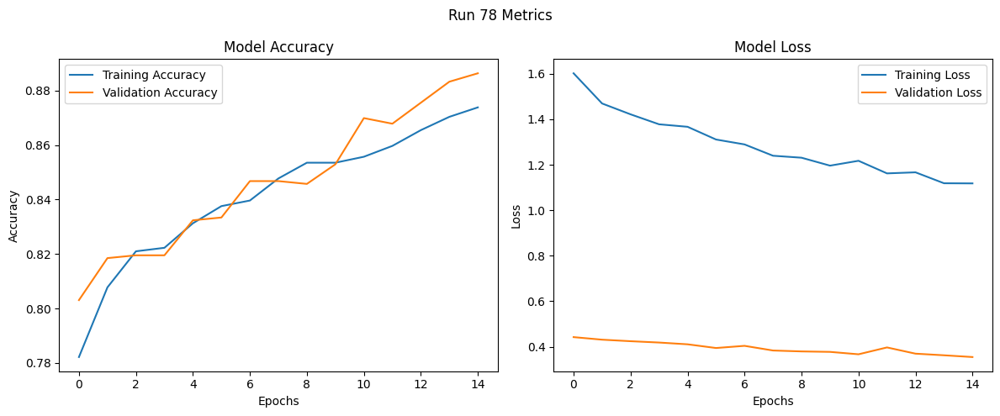

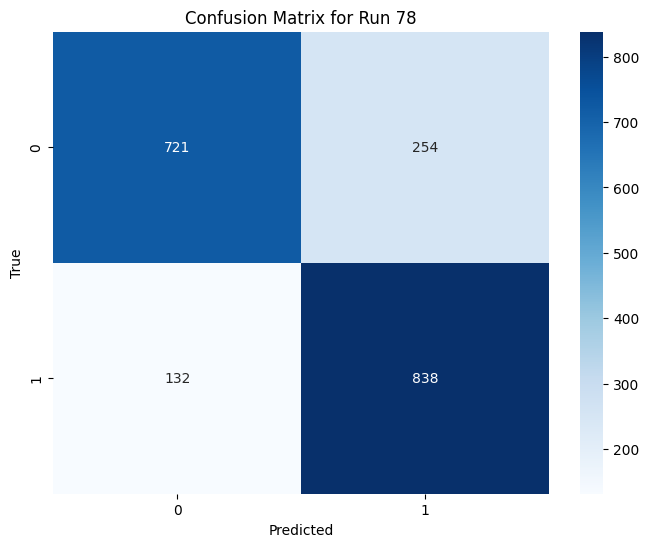

Run 79: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.7315 - loss: 1.2555 - val_accuracy: 0.7805 - val_loss: 0.4672
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7844 - loss: 1.0649 - val_accuracy: 0.8175 - val_loss: 0.4181
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8033 - loss: 1.0265 - val_accuracy: 0.8021 - val_loss: 0.4213
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8072 - loss: 0.9933 - val_accuracy: 0.8010 - val_loss: 0.4151
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8163 - loss: 0.9741 - val_accuracy: 0.8185 - val_loss: 0.4021
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8453 - loss: 0.8914 - val_accuracy: 0.8201 - val_loss: 0.4073
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - a

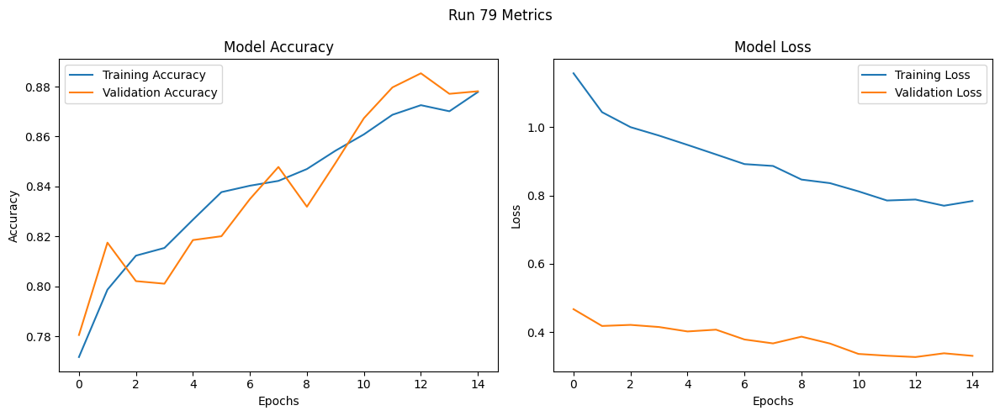

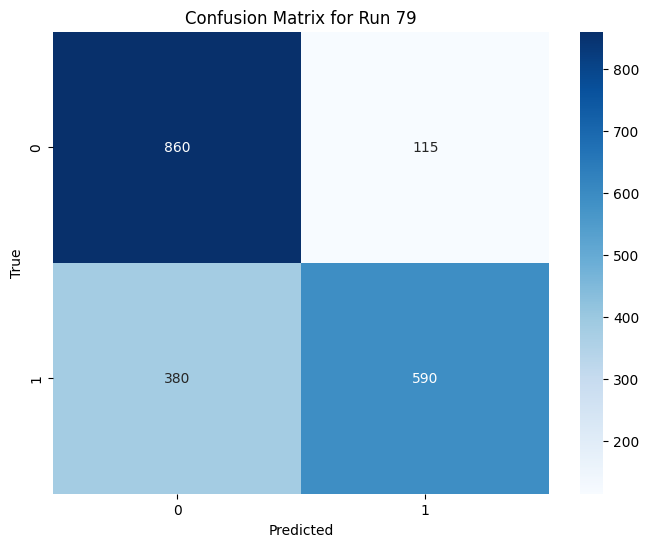

Run 80: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7481 - loss: 1.2119 - val_accuracy: 0.8026 - val_loss: 0.4436
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8019 - loss: 1.0670 - val_accuracy: 0.8031 - val_loss: 0.4215
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8100 - loss: 1.0178 - val_accuracy: 0.8237 - val_loss: 0.4029
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8127 - loss: 0.9789 - val_accuracy: 0.8283 - val_loss: 0.3946
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8232 - loss: 0.9748 - val_accuracy: 0.8324 - val_loss: 0.3883
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8406 - loss: 0.9082 - val_accuracy: 0.8380 - val_loss: 0.3857
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - 

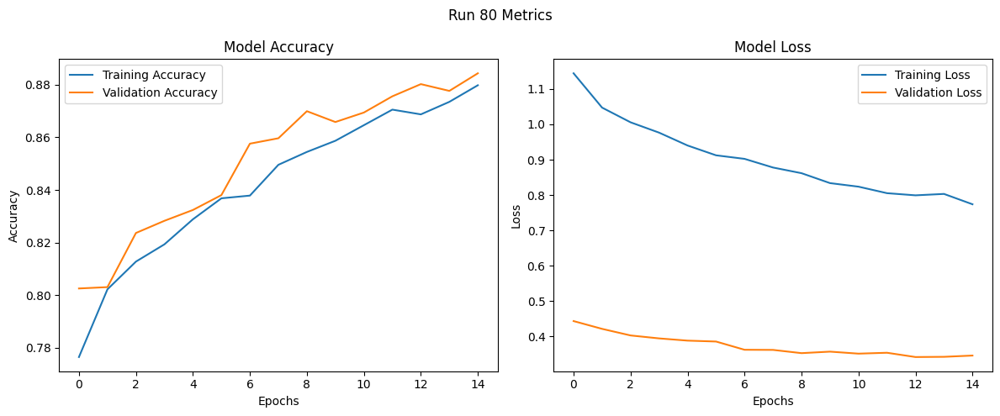

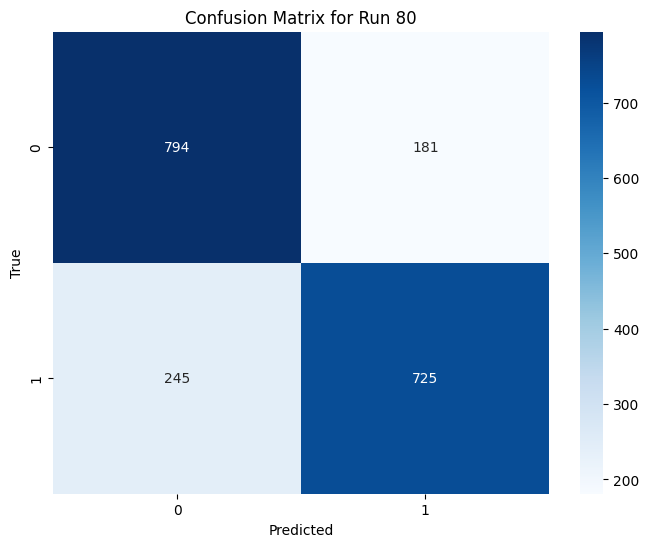

Run 81: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7434 - loss: 1.2348 - val_accuracy: 0.8082 - val_loss: 0.4383
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7979 - loss: 1.0769 - val_accuracy: 0.8026 - val_loss: 0.4402
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8068 - loss: 1.0353 - val_accuracy: 0.7949 - val_loss: 0.4454
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8066 - loss: 1.0146 - val_accuracy: 0.8190 - val_loss: 0.4113
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8209 - loss: 0.9775 - val_accuracy: 0.8257 - val_loss: 0.4025
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8278 - loss: 0.9336 - val_accuracy: 0.8247 - val_loss: 0.4116
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - ac

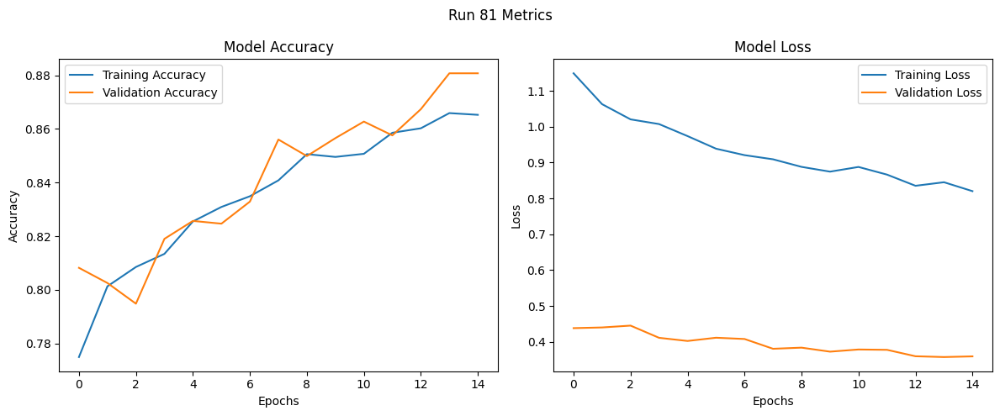

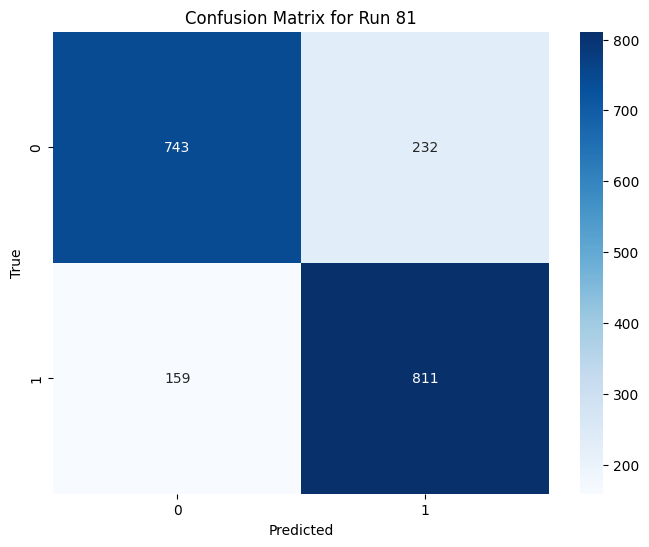

Run 82: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7590 - loss: 1.7308 - val_accuracy: 0.7938 - val_loss: 0.4509
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7916 - loss: 1.5192 - val_accuracy: 0.8118 - val_loss: 0.4252
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8111 - loss: 1.4385 - val_accuracy: 0.8175 - val_loss: 0.4054
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8182 - loss: 1.3894 - val_accuracy: 0.8237 - val_loss: 0.4012
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8388 - loss: 1.2784 - val_accuracy: 0.8257 - val_loss: 0.3907
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8340 - loss: 1.2863 - val_accuracy: 0.8365 - val_loss: 0.3719
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - a

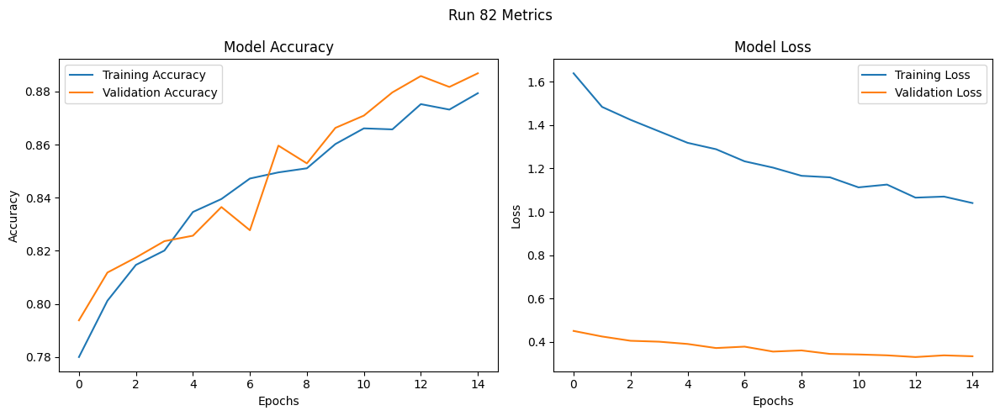

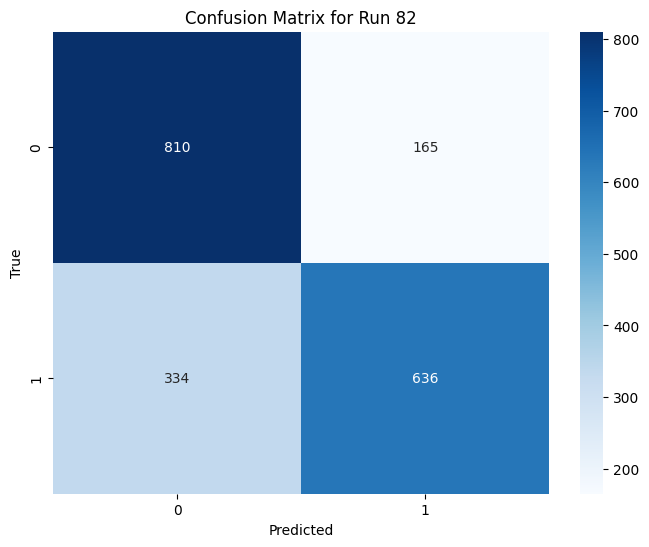

Run 83: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7503 - loss: 1.7408 - val_accuracy: 0.7990 - val_loss: 0.4468
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8030 - loss: 1.4863 - val_accuracy: 0.8098 - val_loss: 0.4290
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8193 - loss: 1.4158 - val_accuracy: 0.8082 - val_loss: 0.4105
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8270 - loss: 1.3497 - val_accuracy: 0.8231 - val_loss: 0.3992
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8299 - loss: 1.2954 - val_accuracy: 0.8365 - val_loss: 0.3878
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8350 - loss: 1.2962 - val_accuracy: 0.8350 - val_loss: 0.3847
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - 

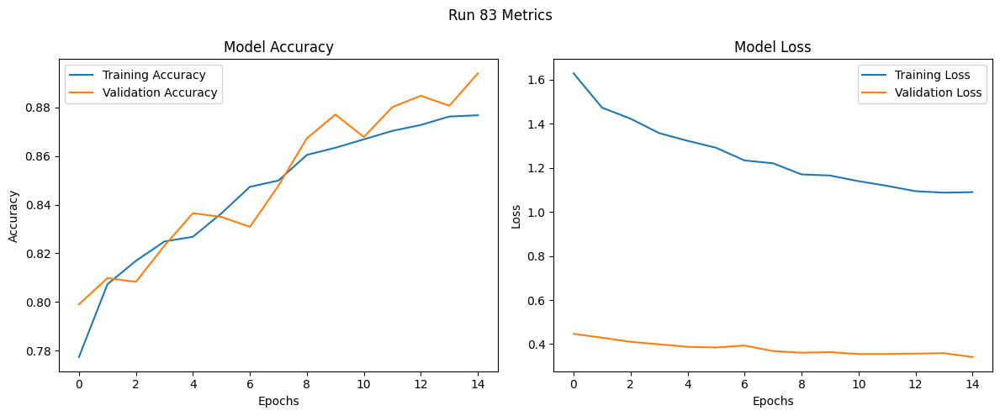

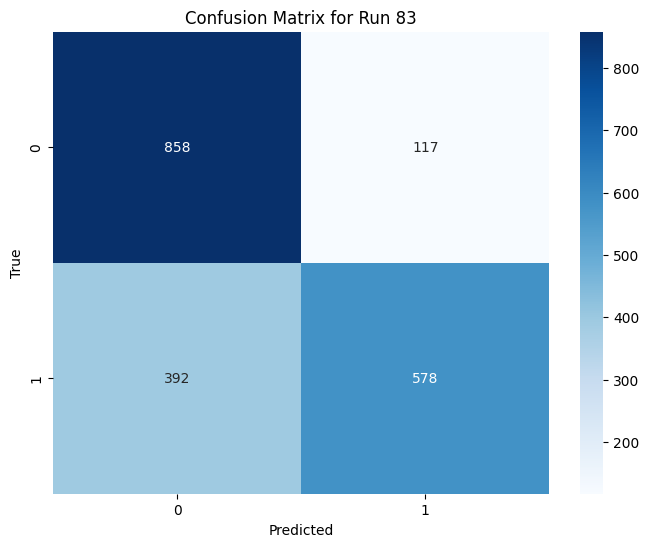

Run 84: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7537 - loss: 1.7635 - val_accuracy: 0.7943 - val_loss: 0.4628
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8085 - loss: 1.4648 - val_accuracy: 0.8108 - val_loss: 0.4275
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8054 - loss: 1.4844 - val_accuracy: 0.8144 - val_loss: 0.4351
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8216 - loss: 1.3769 - val_accuracy: 0.8211 - val_loss: 0.4122
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8343 - loss: 1.3253 - val_accuracy: 0.8350 - val_loss: 0.3967
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8290 - loss: 1.2869 - val_accuracy: 0.8370 - val_loss: 0.4086
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - ac

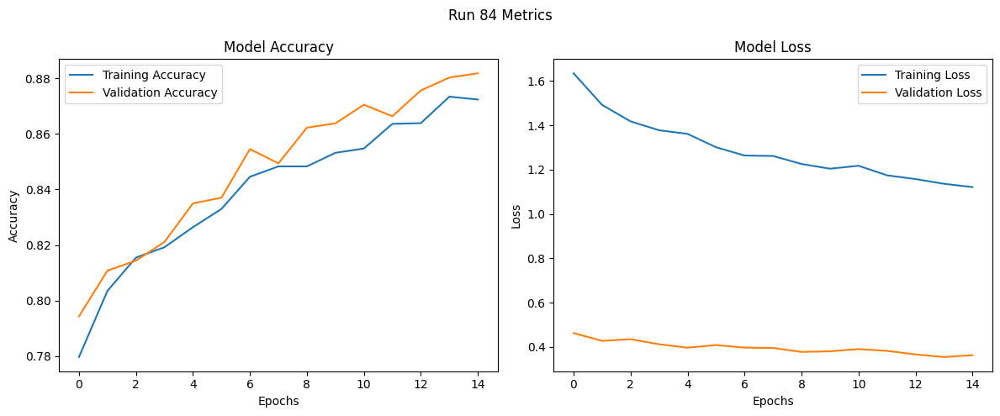

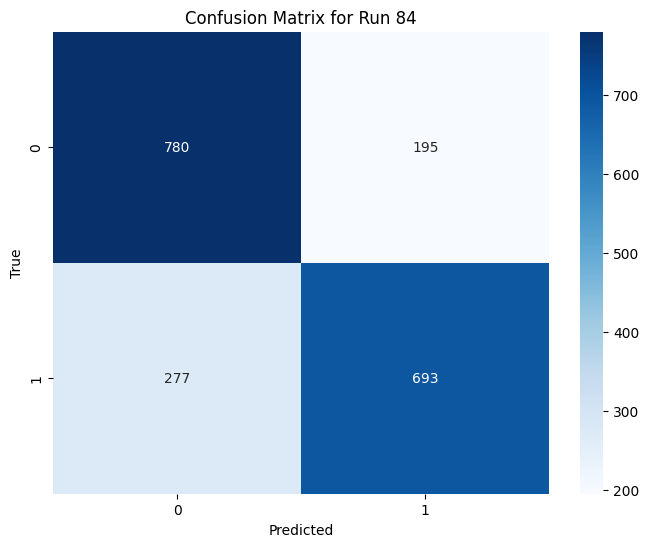

Run 85: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.7525 - loss: 0.4310 - val_accuracy: 0.8077 - val_loss: 0.1485
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7964 - loss: 0.3574 - val_accuracy: 0.8031 - val_loss: 0.1478
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8215 - loss: 0.3253 - val_accuracy: 0.8031 - val_loss: 0.1487
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8297 - loss: 0.3221 - val_accuracy: 0.8129 - val_loss: 0.1415
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8289 - loss: 0.3224 - val_accuracy: 0.7892 - val_loss: 0.1527
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8370 - loss: 0.2968 - val_accuracy: 0.8288 - val_loss: 0.1413
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy

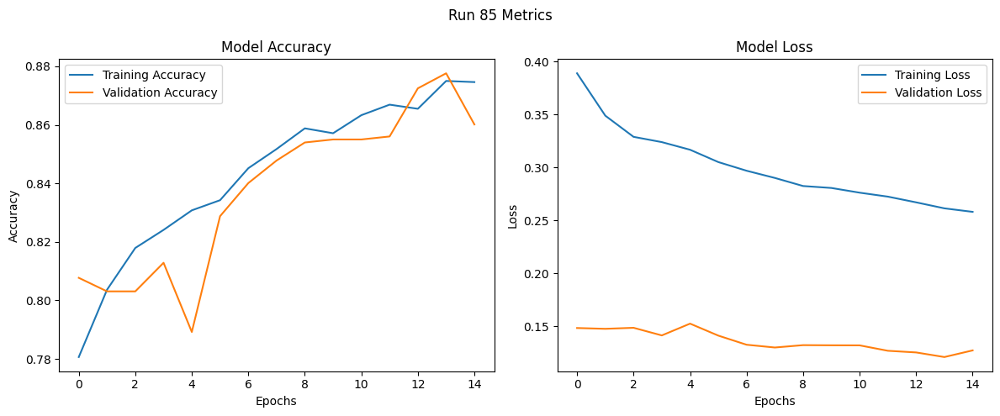

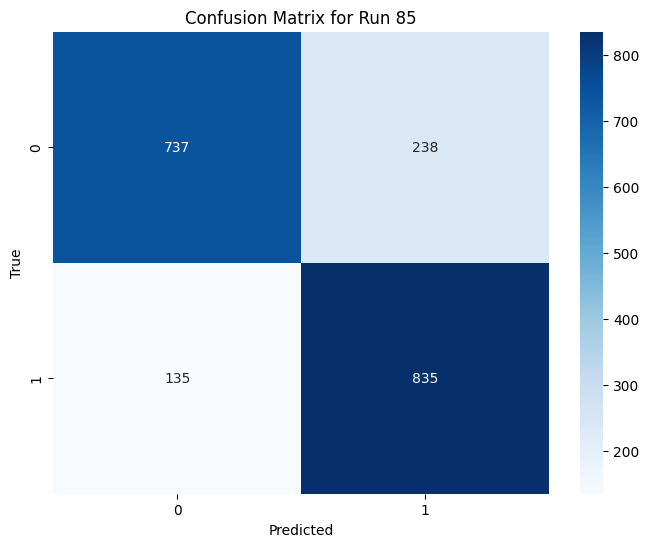

Run 86: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7361 - loss: 0.4256 - val_accuracy: 0.8046 - val_loss: 0.1503
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8097 - loss: 0.3541 - val_accuracy: 0.8082 - val_loss: 0.1470
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8178 - loss: 0.3318 - val_accuracy: 0.8087 - val_loss: 0.1499
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8223 - loss: 0.3245 - val_accuracy: 0.8247 - val_loss: 0.1387
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8395 - loss: 0.3103 - val_accuracy: 0.8113 - val_loss: 0.1469
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8451 - loss: 0.3035 - val_accuracy: 0.8386 - val_loss: 0.1402
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accurac

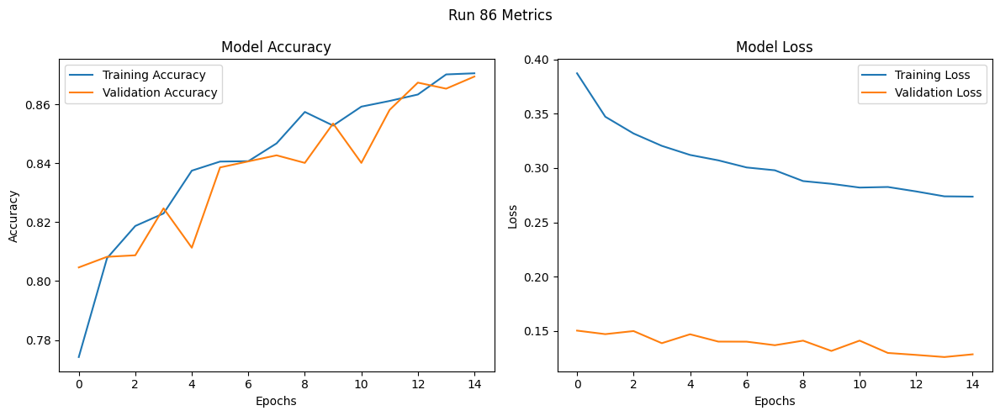

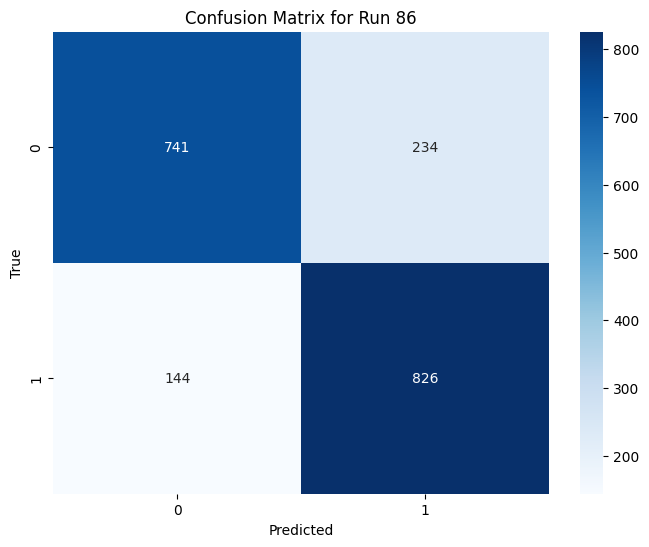

Run 87: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.7399 - loss: 0.4348 - val_accuracy: 0.8000 - val_loss: 0.1586
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8009 - loss: 0.3605 - val_accuracy: 0.7933 - val_loss: 0.1607
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8131 - loss: 0.3415 - val_accuracy: 0.8113 - val_loss: 0.1515
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8232 - loss: 0.3246 - val_accuracy: 0.8144 - val_loss: 0.1503
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8401 - loss: 0.3149 - val_accuracy: 0.8288 - val_loss: 0.1516
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8350 - loss: 0.3229 - val_accuracy: 0.8360 - val_loss: 0.1427
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy:

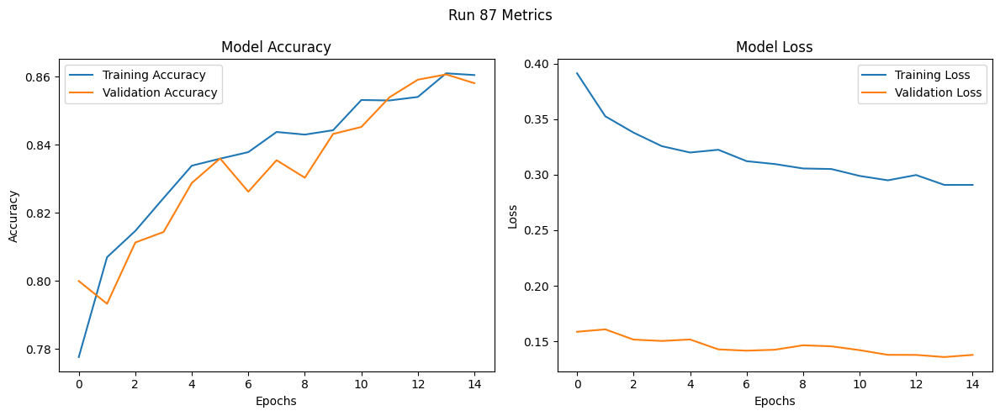

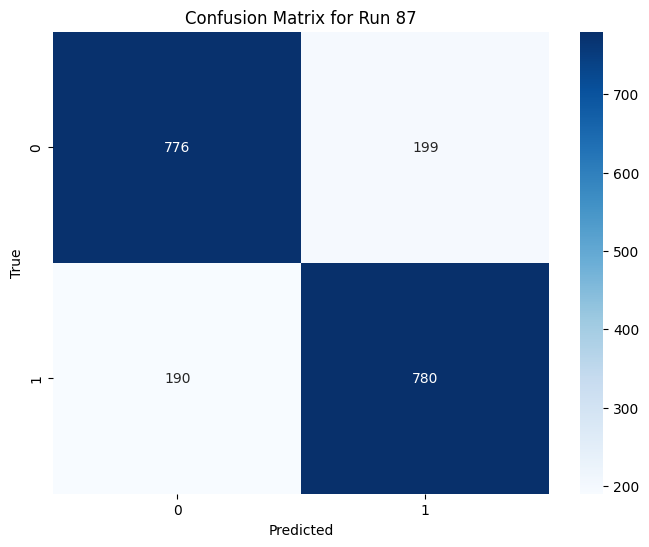

Run 88: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7603 - loss: 0.5752 - val_accuracy: 0.8010 - val_loss: 0.1529
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8107 - loss: 0.4814 - val_accuracy: 0.8036 - val_loss: 0.1492
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8240 - loss: 0.4575 - val_accuracy: 0.8154 - val_loss: 0.1447
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8249 - loss: 0.4515 - val_accuracy: 0.8216 - val_loss: 0.1407
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8392 - loss: 0.4324 - val_accuracy: 0.8303 - val_loss: 0.1399
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8486 - loss: 0.4210 - val_accuracy: 0.8339 - val_loss: 0.1369
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy

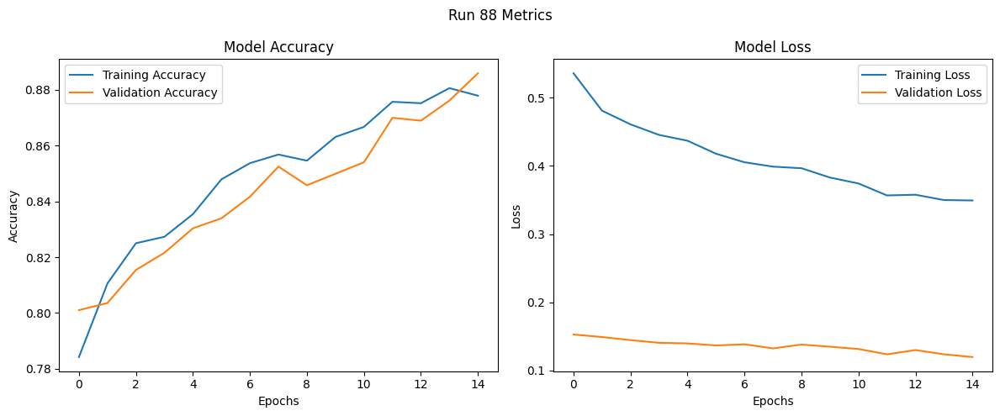

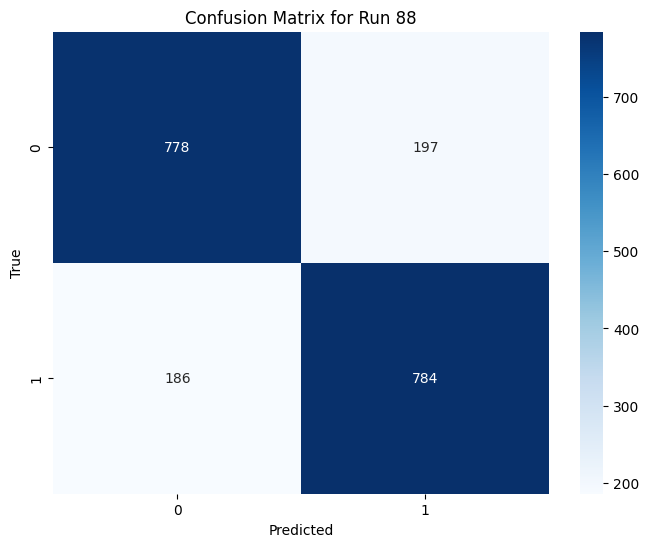

Run 89: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7567 - loss: 0.5983 - val_accuracy: 0.7979 - val_loss: 0.1536
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8092 - loss: 0.4908 - val_accuracy: 0.7959 - val_loss: 0.1546
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8277 - loss: 0.4575 - val_accuracy: 0.8098 - val_loss: 0.1485
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8400 - loss: 0.4296 - val_accuracy: 0.8108 - val_loss: 0.1518
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8314 - loss: 0.4404 - val_accuracy: 0.8283 - val_loss: 0.1430
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8459 - loss: 0.4204 - val_accuracy: 0.8350 - val_loss: 0.1430
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accurac

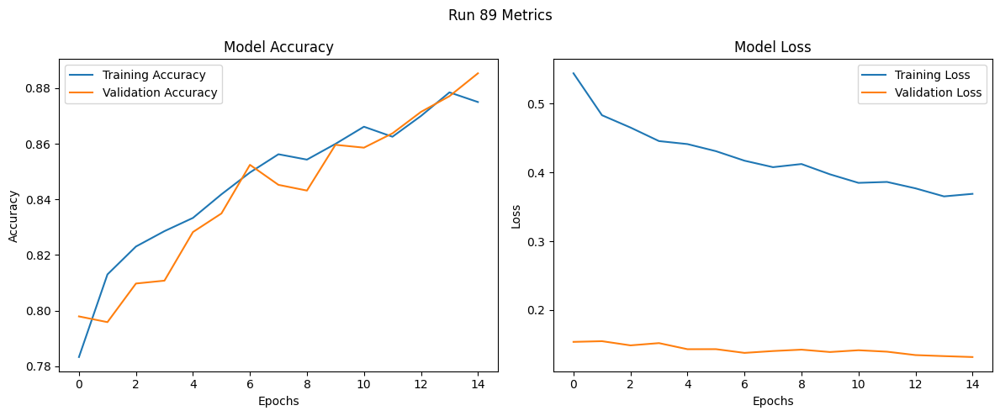

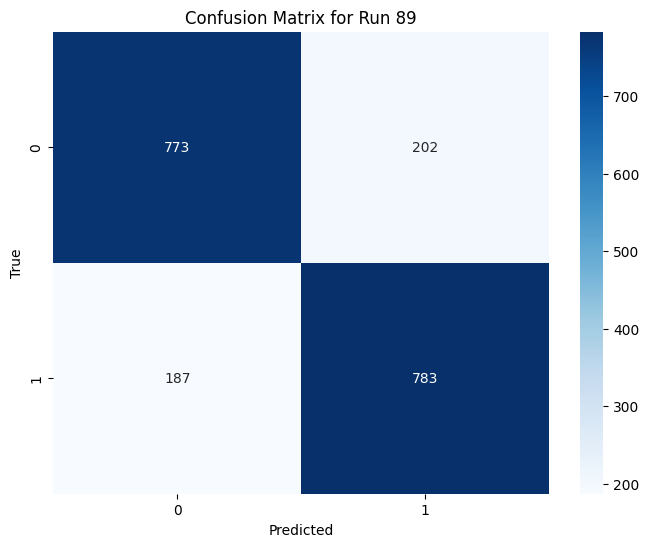

Run 90: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.7622 - loss: 0.5825 - val_accuracy: 0.7974 - val_loss: 0.1543
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7999 - loss: 0.5113 - val_accuracy: 0.8139 - val_loss: 0.1495
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8159 - loss: 0.4779 - val_accuracy: 0.8170 - val_loss: 0.1484
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8316 - loss: 0.4439 - val_accuracy: 0.8226 - val_loss: 0.1460
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8353 - loss: 0.4418 - val_accuracy: 0.8226 - val_loss: 0.1519
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8474 - loss: 0.4237 - val_accuracy: 0.8123 - val_loss: 0.1537
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy:

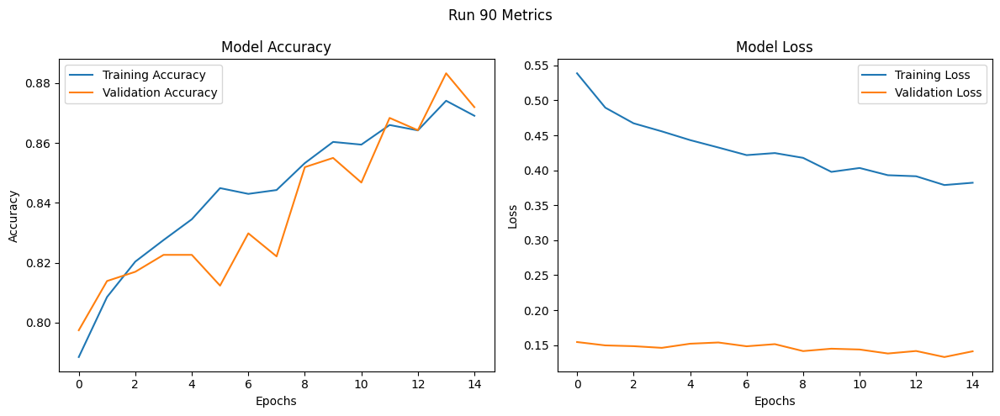

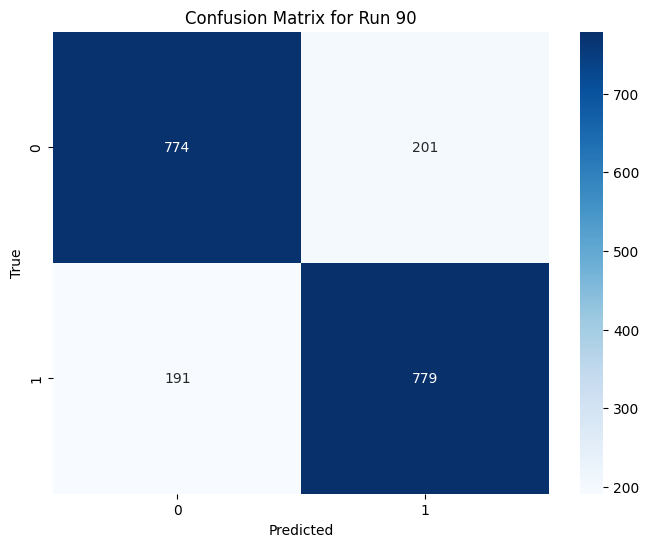

Run 91: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7495 - loss: 0.4358 - val_accuracy: 0.8010 - val_loss: 0.1517
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8032 - loss: 0.3593 - val_accuracy: 0.8082 - val_loss: 0.1482
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8214 - loss: 0.3280 - val_accuracy: 0.8031 - val_loss: 0.1488
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8220 - loss: 0.3213 - val_accuracy: 0.8082 - val_loss: 0.1441
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8311 - loss: 0.3106 - val_accuracy: 0.8242 - val_loss: 0.1410
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8361 - loss: 0.3091 - val_accuracy: 0.8355 - val_loss: 0.1348
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accurac

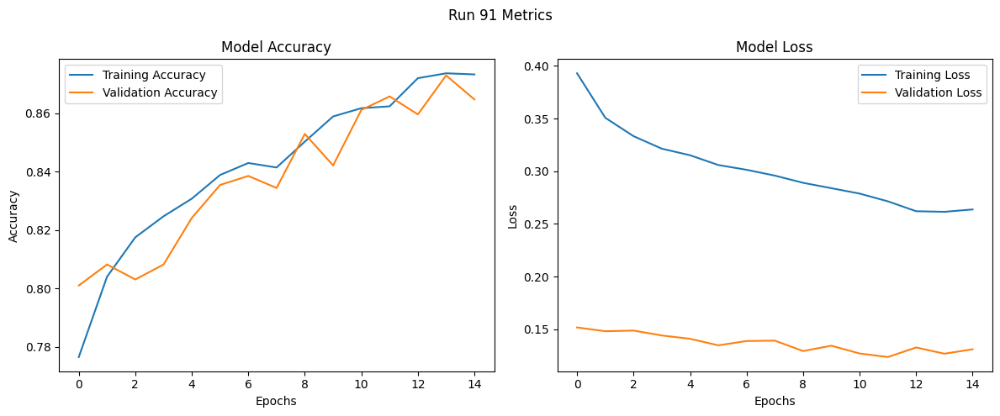

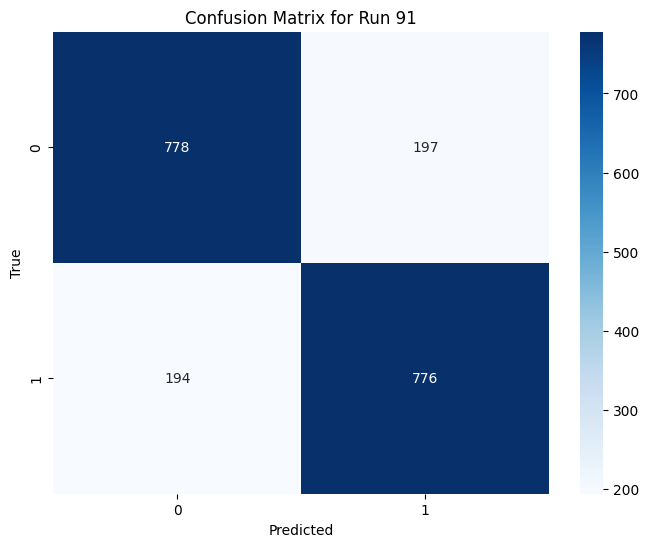

Run 92: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7460 - loss: 0.4337 - val_accuracy: 0.7995 - val_loss: 0.1587
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8112 - loss: 0.3458 - val_accuracy: 0.7871 - val_loss: 0.1571
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8166 - loss: 0.3345 - val_accuracy: 0.8067 - val_loss: 0.1490
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8221 - loss: 0.3268 - val_accuracy: 0.8190 - val_loss: 0.1436
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8246 - loss: 0.3229 - val_accuracy: 0.8242 - val_loss: 0.1412
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8433 - loss: 0.3050 - val_accuracy: 0.8242 - val_loss: 0.1440
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accura

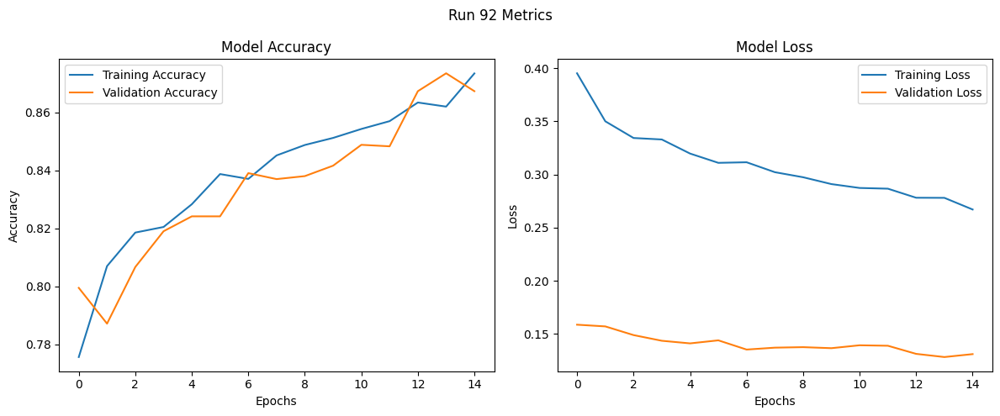

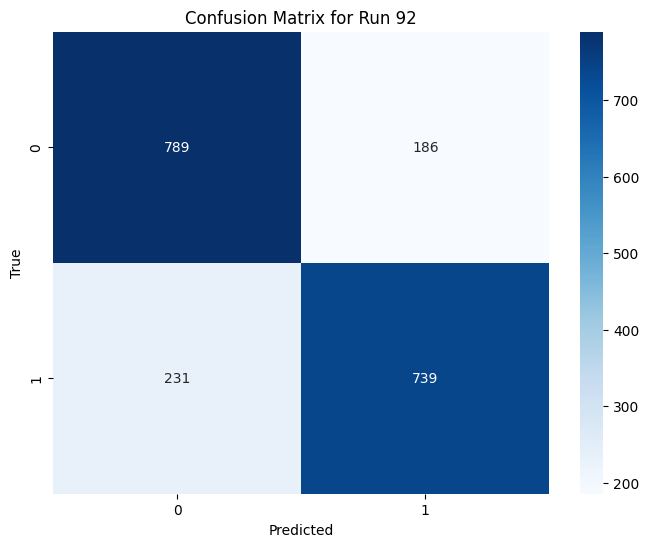

Run 93: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.7530 - loss: 0.4194 - val_accuracy: 0.8072 - val_loss: 0.1538
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8057 - loss: 0.3570 - val_accuracy: 0.8036 - val_loss: 0.1511
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8266 - loss: 0.3302 - val_accuracy: 0.8129 - val_loss: 0.1465
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8251 - loss: 0.3220 - val_accuracy: 0.8180 - val_loss: 0.1504
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8390 - loss: 0.3204 - val_accuracy: 0.8180 - val_loss: 0.1474
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8379 - loss: 0.3139 - val_accuracy: 0.8334 - val_loss: 0.1423
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy

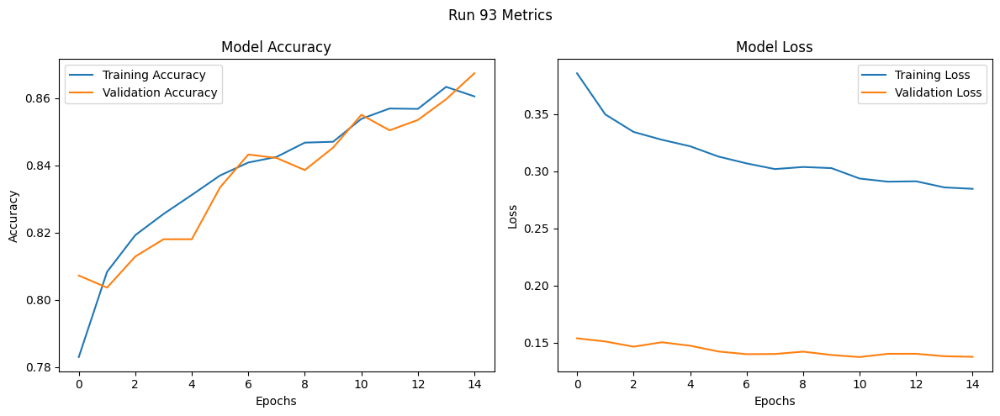

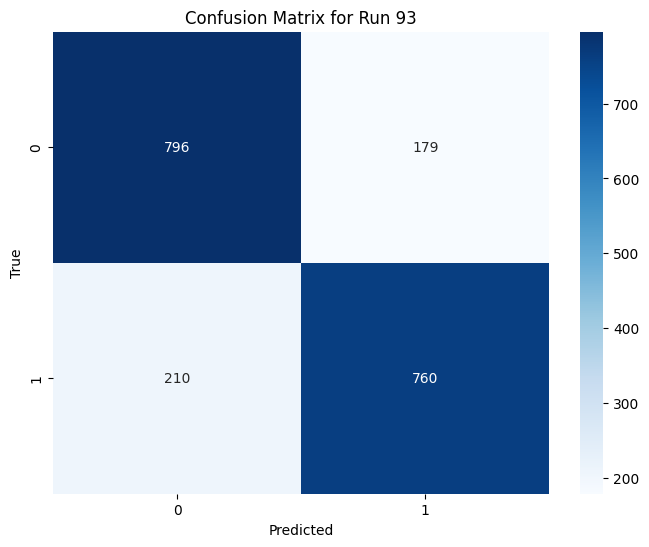

Run 94: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7269 - loss: 0.6088 - val_accuracy: 0.7990 - val_loss: 0.1524
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8079 - loss: 0.4845 - val_accuracy: 0.8149 - val_loss: 0.1453
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8133 - loss: 0.4636 - val_accuracy: 0.8216 - val_loss: 0.1417
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8319 - loss: 0.4502 - val_accuracy: 0.8237 - val_loss: 0.1411
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8361 - loss: 0.4358 - val_accuracy: 0.8206 - val_loss: 0.1425
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8399 - loss: 0.4279 - val_accuracy: 0.8283 - val_loss: 0.1394
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accurac

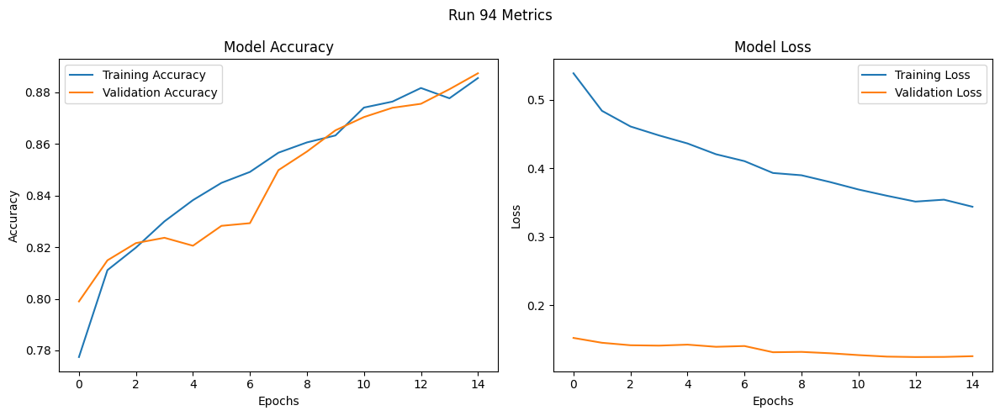

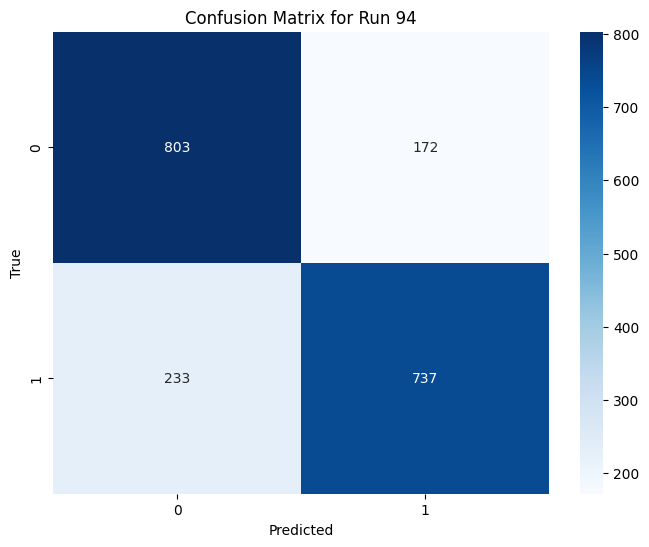

Run 95: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7333 - loss: 0.6046 - val_accuracy: 0.7964 - val_loss: 0.1583
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8050 - loss: 0.4924 - val_accuracy: 0.8057 - val_loss: 0.1532
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8215 - loss: 0.4639 - val_accuracy: 0.8123 - val_loss: 0.1460
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8288 - loss: 0.4533 - val_accuracy: 0.8272 - val_loss: 0.1426
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8365 - loss: 0.4372 - val_accuracy: 0.8221 - val_loss: 0.1471
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8452 - loss: 0.4217 - val_accuracy: 0.8098 - val_loss: 0.1569
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accura

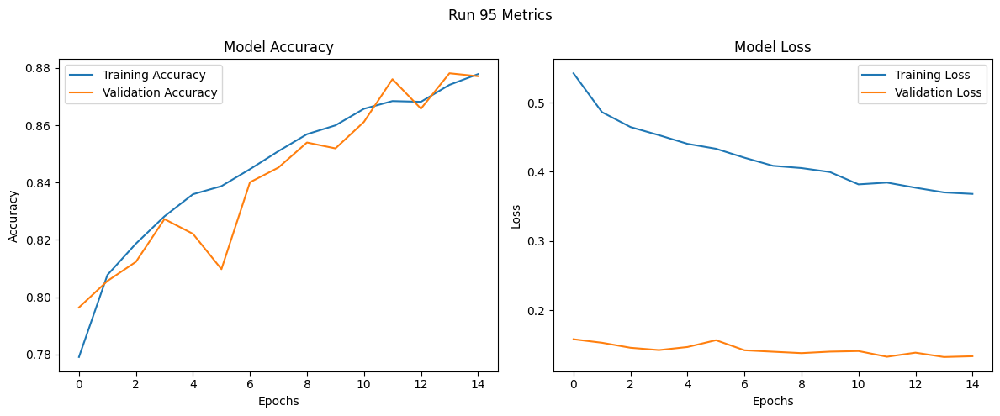

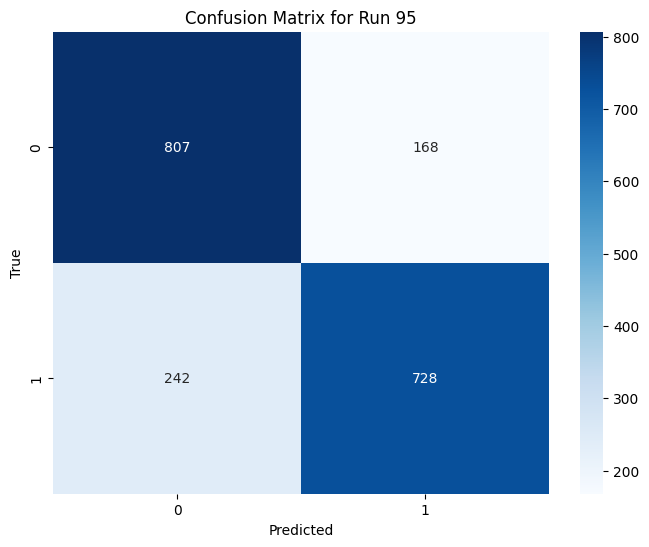

Run 96: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7475 - loss: 0.6033 - val_accuracy: 0.8000 - val_loss: 0.1534
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8028 - loss: 0.4964 - val_accuracy: 0.8010 - val_loss: 0.1562
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8157 - loss: 0.4750 - val_accuracy: 0.8057 - val_loss: 0.1514
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8227 - loss: 0.4726 - val_accuracy: 0.8062 - val_loss: 0.1533
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8324 - loss: 0.4563 - val_accuracy: 0.8159 - val_loss: 0.1524
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8354 - loss: 0.4462 - val_accuracy: 0.8226 - val_loss: 0.1541
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy

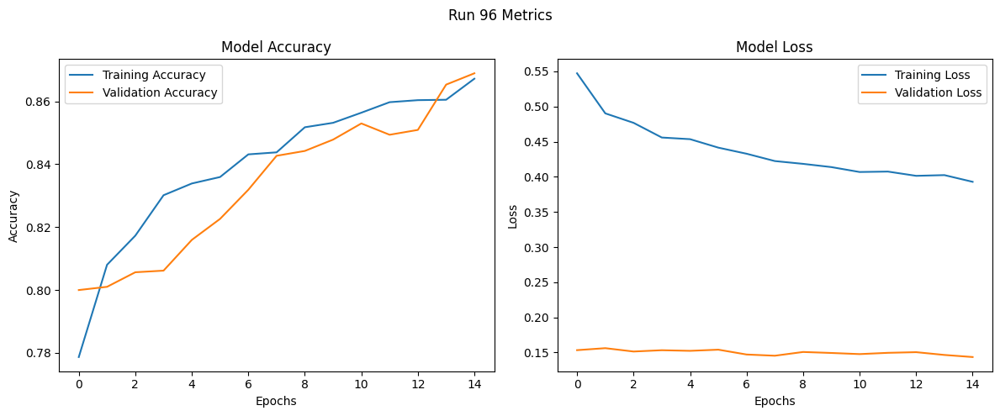

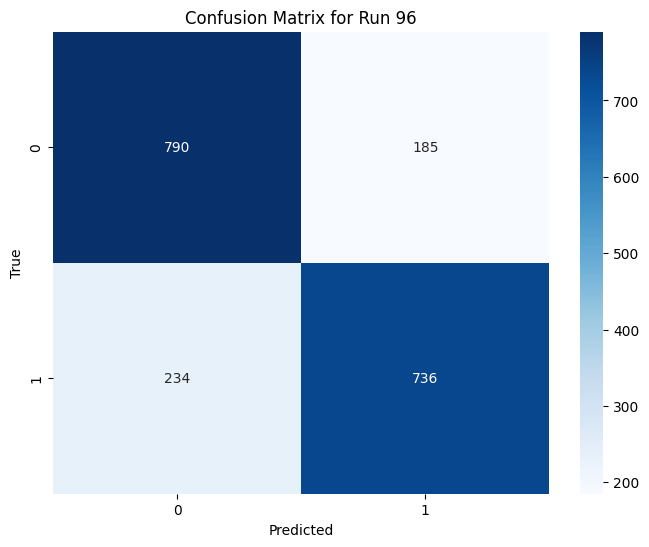

Run 97: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7209 - loss: 0.2135 - val_accuracy: 0.7964 - val_loss: 0.0750
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7995 - loss: 0.1710 - val_accuracy: 0.8057 - val_loss: 0.0749
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8199 - loss: 0.1574 - val_accuracy: 0.7851 - val_loss: 0.0779
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8086 - loss: 0.1601 - val_accuracy: 0.8118 - val_loss: 0.0712
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8267 - loss: 0.1563 - val_accuracy: 0.8267 - val_loss: 0.0695
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8341 - loss: 0.1489 - val_accuracy: 0.8237 - val_loss: 0.0723
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8298 -

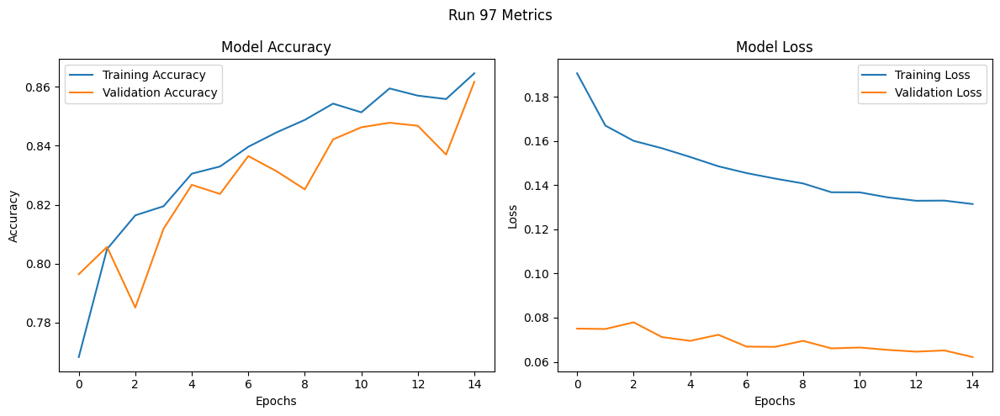

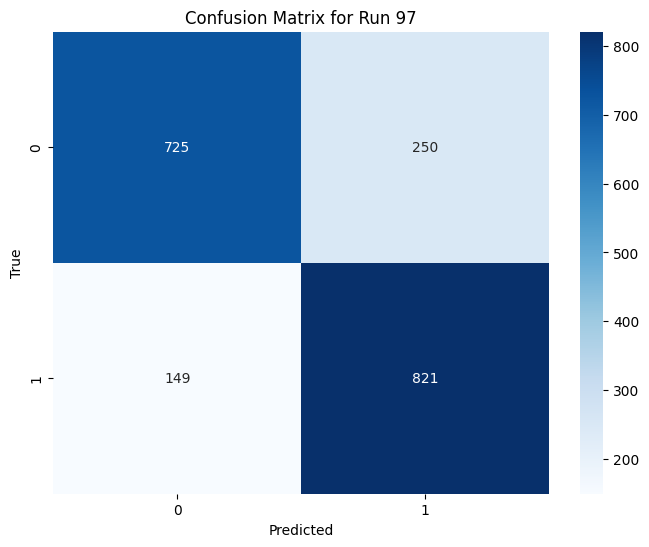

Run 98: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7592 - loss: 0.2031 - val_accuracy: 0.7769 - val_loss: 0.0813
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7993 - loss: 0.1718 - val_accuracy: 0.7974 - val_loss: 0.0777
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8129 - loss: 0.1630 - val_accuracy: 0.7789 - val_loss: 0.0788
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8192 - loss: 0.1579 - val_accuracy: 0.8272 - val_loss: 0.0701
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8365 - loss: 0.1485 - val_accuracy: 0.8015 - val_loss: 0.0775
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8343 - loss: 0.1483 - val_accuracy: 0.8221 - val_loss: 0.0704
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8374 

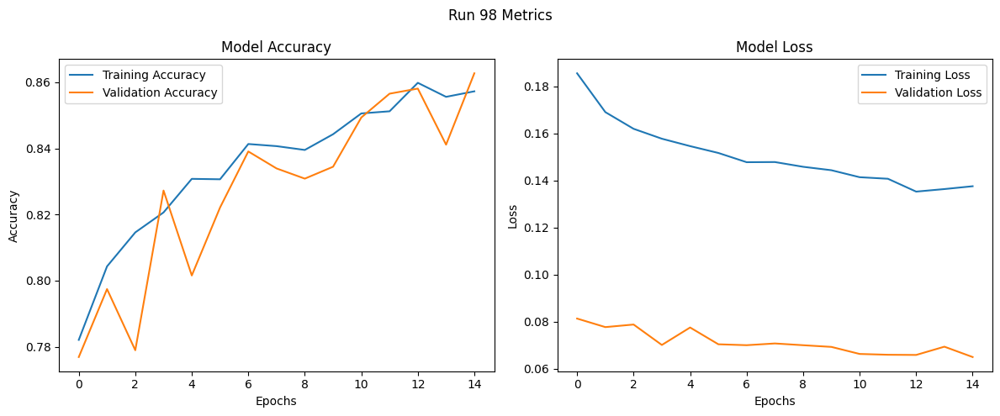

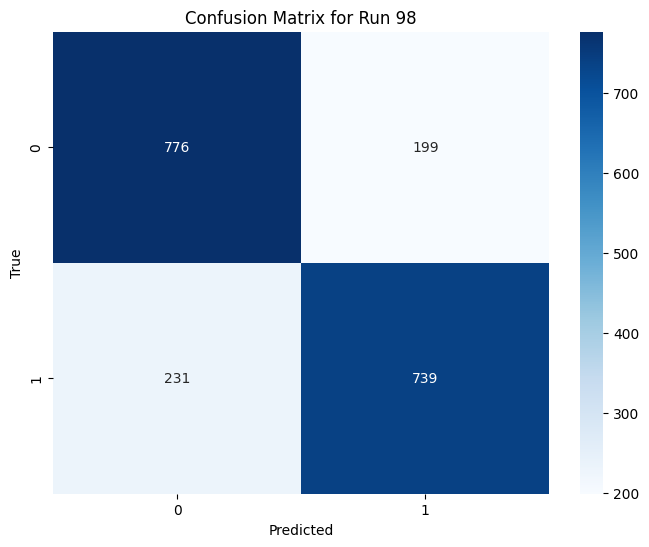

Run 99: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7433 - loss: 0.2064 - val_accuracy: 0.8031 - val_loss: 0.0749
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7980 - loss: 0.1682 - val_accuracy: 0.7974 - val_loss: 0.0752
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8076 - loss: 0.1656 - val_accuracy: 0.7985 - val_loss: 0.0759
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8204 - loss: 0.1560 - val_accuracy: 0.8046 - val_loss: 0.0747
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8276 - loss: 0.1580 - val_accuracy: 0.8010 - val_loss: 0.0764
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8377 - loss: 0.1495 - val_accuracy: 0.8319 - val_loss: 0.0708
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8344 - 

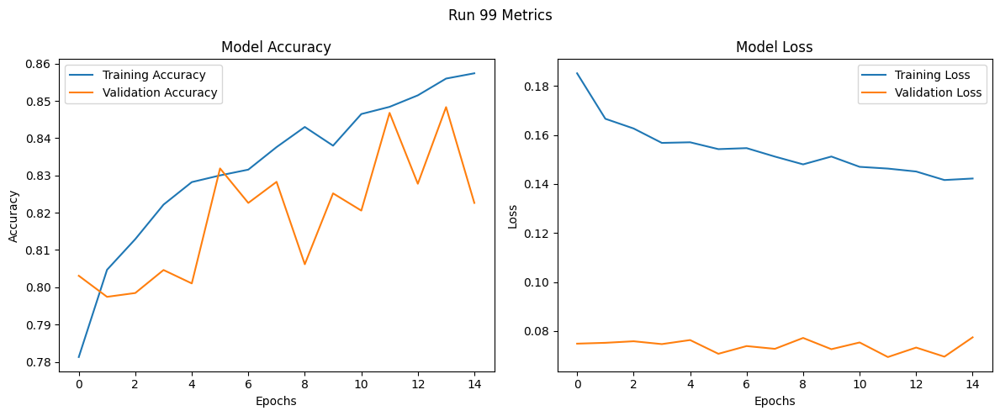

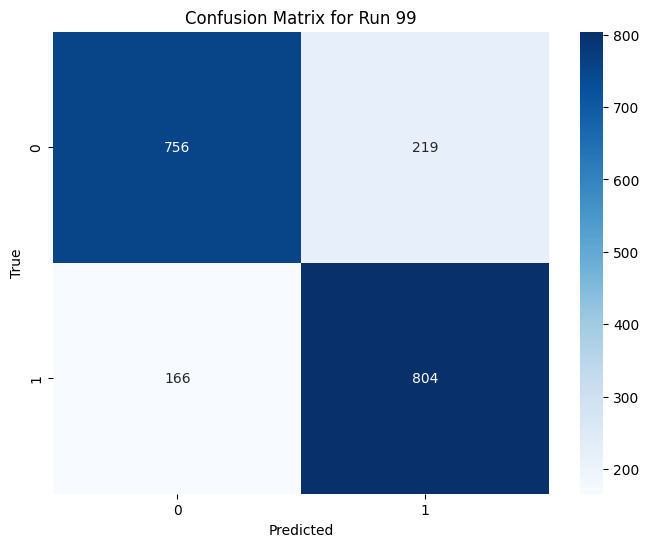

Run 100: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7478 - loss: 0.2906 - val_accuracy: 0.7979 - val_loss: 0.0780
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8056 - loss: 0.2299 - val_accuracy: 0.8072 - val_loss: 0.0740
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8231 - loss: 0.2207 - val_accuracy: 0.8149 - val_loss: 0.0723
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8215 - loss: 0.2192 - val_accuracy: 0.8262 - val_loss: 0.0711
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8391 - loss: 0.2063 - val_accuracy: 0.8190 - val_loss: 0.0722
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8367 - loss: 0.2058 - val_accuracy: 0.8283 - val_loss: 0.0694
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8437 

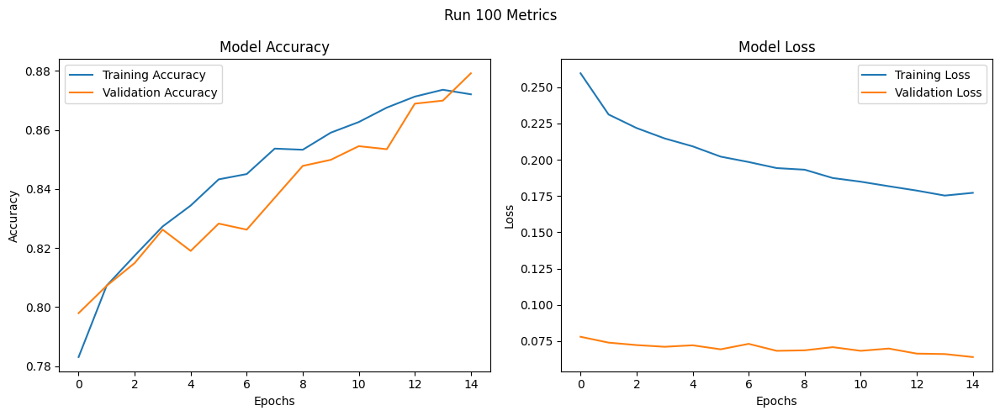

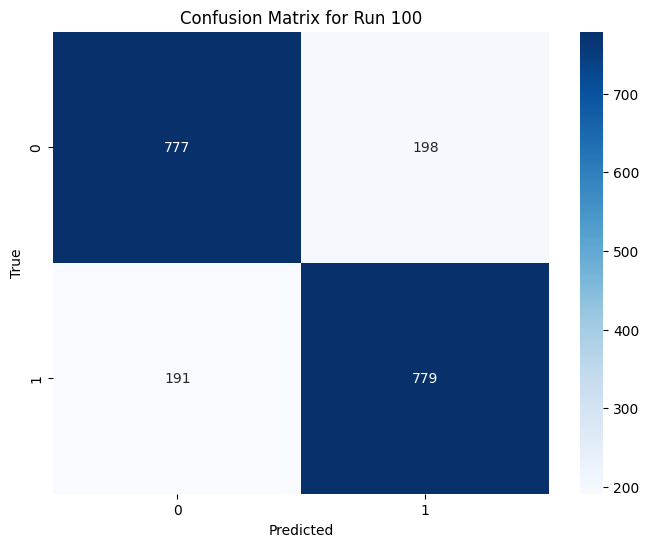

Run 101: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7361 - loss: 0.2928 - val_accuracy: 0.7959 - val_loss: 0.0761
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8043 - loss: 0.2339 - val_accuracy: 0.8072 - val_loss: 0.0744
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8111 - loss: 0.2241 - val_accuracy: 0.8118 - val_loss: 0.0751
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8304 - loss: 0.2116 - val_accuracy: 0.8201 - val_loss: 0.0716
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8370 - loss: 0.2090 - val_accuracy: 0.8252 - val_loss: 0.0733
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8353 - loss: 0.2108 - val_accuracy: 0.8324 - val_loss: 0.0730
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8490

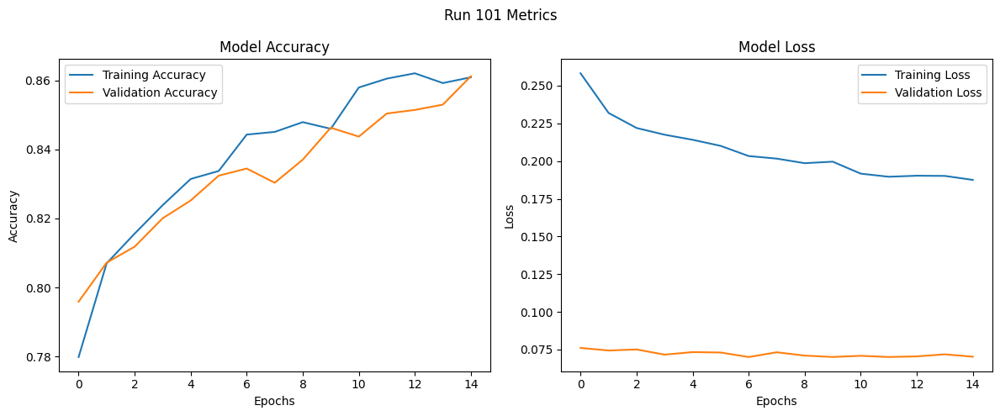

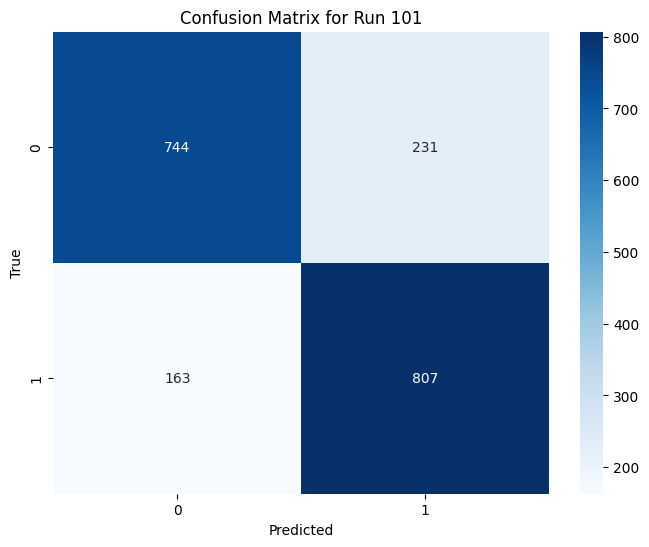

Run 102: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.7578 - loss: 0.2849 - val_accuracy: 0.7769 - val_loss: 0.0821
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7915 - loss: 0.2429 - val_accuracy: 0.8031 - val_loss: 0.0753
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8248 - loss: 0.2205 - val_accuracy: 0.8098 - val_loss: 0.0754
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8300 - loss: 0.2181 - val_accuracy: 0.7943 - val_loss: 0.0792
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8270 - loss: 0.2240 - val_accuracy: 0.8324 - val_loss: 0.0728
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8393 - loss: 0.2065 - val_accuracy: 0.8154 - val_loss: 0.0741
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8418 -

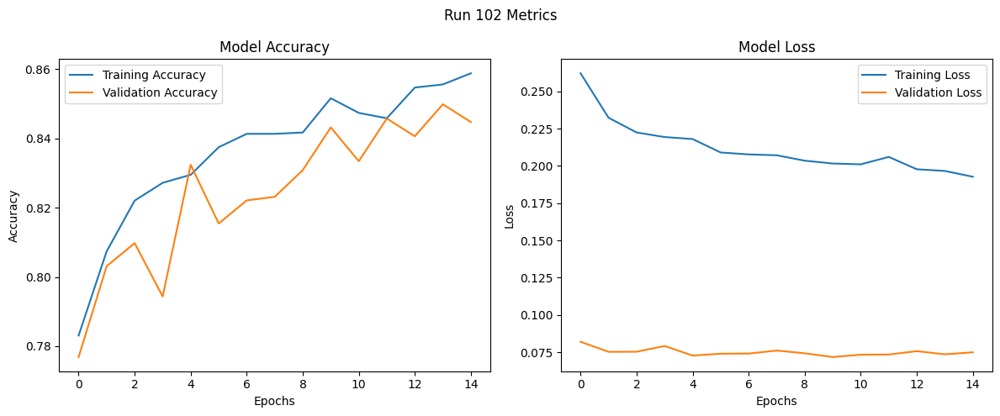

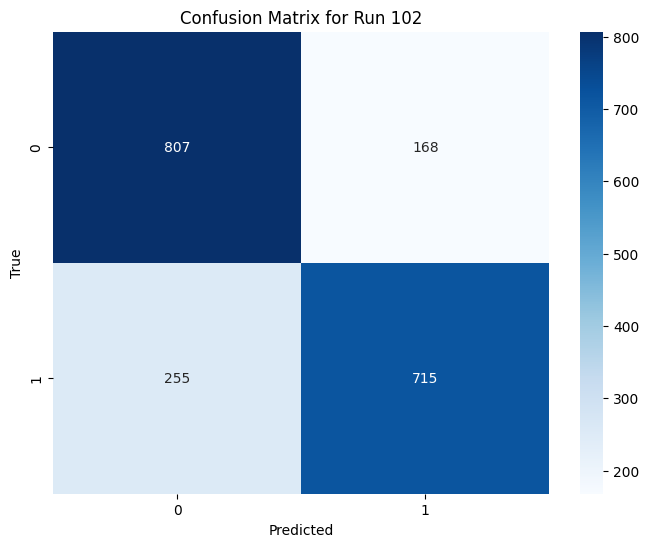

Run 103: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7261 - loss: 0.2103 - val_accuracy: 0.7733 - val_loss: 0.0824
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8009 - loss: 0.1700 - val_accuracy: 0.8067 - val_loss: 0.0731
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8182 - loss: 0.1614 - val_accuracy: 0.8072 - val_loss: 0.0706
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8226 - loss: 0.1551 - val_accuracy: 0.8175 - val_loss: 0.0713
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8323 - loss: 0.1491 - val_accuracy: 0.8159 - val_loss: 0.0707
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8448 - loss: 0.1408 - val_accuracy: 0.8293 - val_loss: 0.0674
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8393

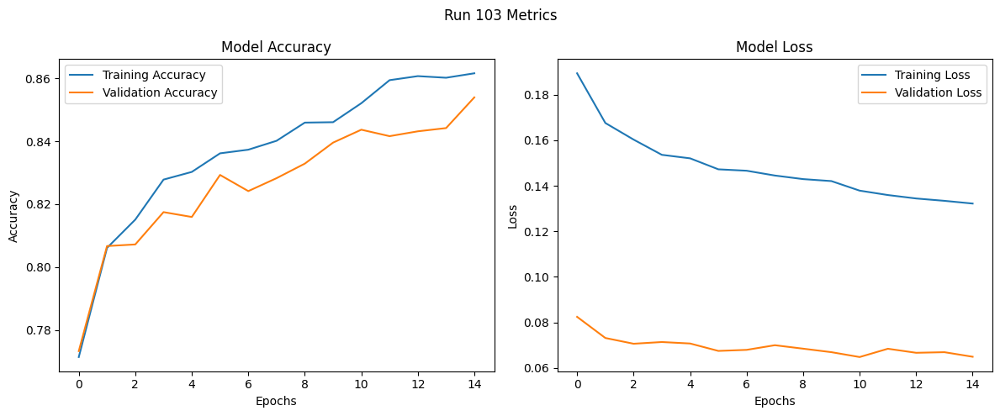

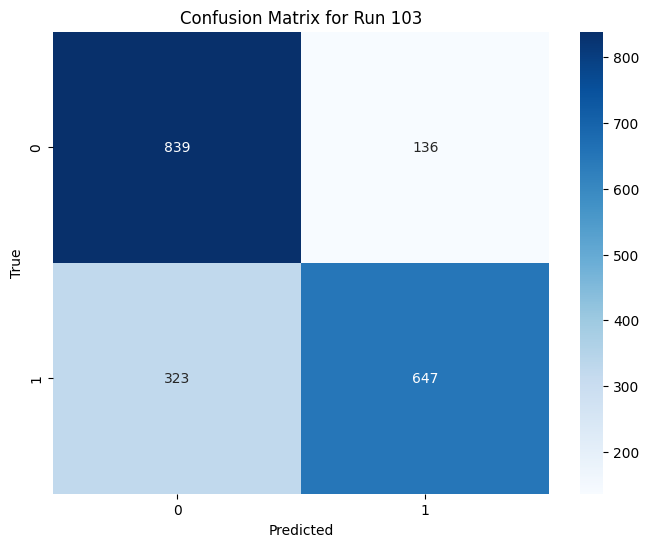

Run 104: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.7496 - loss: 0.2059 - val_accuracy: 0.7877 - val_loss: 0.0785
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8015 - loss: 0.1669 - val_accuracy: 0.8072 - val_loss: 0.0737
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8076 - loss: 0.1672 - val_accuracy: 0.7959 - val_loss: 0.0763
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8217 - loss: 0.1568 - val_accuracy: 0.8190 - val_loss: 0.0709
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8260 - loss: 0.1559 - val_accuracy: 0.8216 - val_loss: 0.0706
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8323 - loss: 0.1505 - val_accuracy: 0.8170 - val_loss: 0.0713
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.841

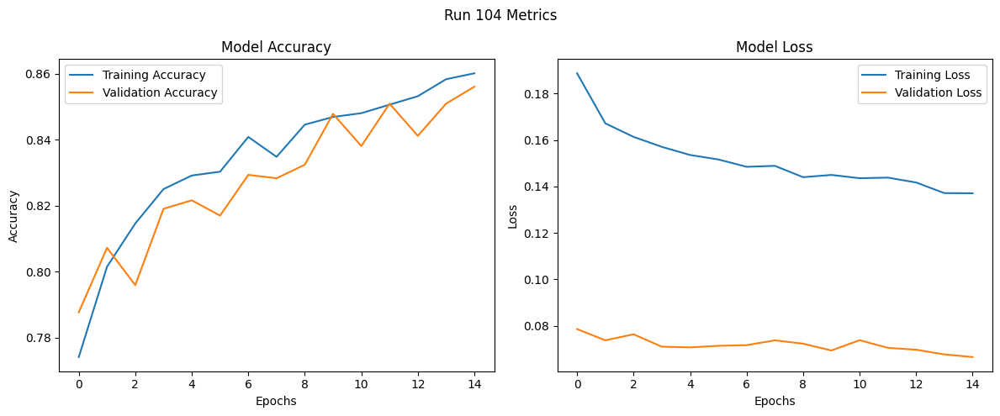

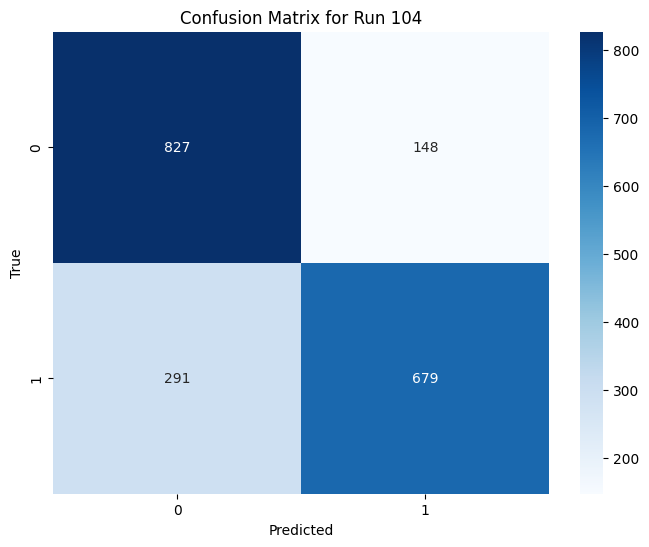

Run 105: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7577 - loss: 0.1998 - val_accuracy: 0.7815 - val_loss: 0.0824
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8065 - loss: 0.1680 - val_accuracy: 0.8057 - val_loss: 0.0723
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8086 - loss: 0.1630 - val_accuracy: 0.7995 - val_loss: 0.0761
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8264 - loss: 0.1553 - val_accuracy: 0.8165 - val_loss: 0.0737
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8364 - loss: 0.1508 - val_accuracy: 0.8123 - val_loss: 0.0768
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8250 - loss: 0.1561 - val_accuracy: 0.8221 - val_loss: 0.0715
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8262 

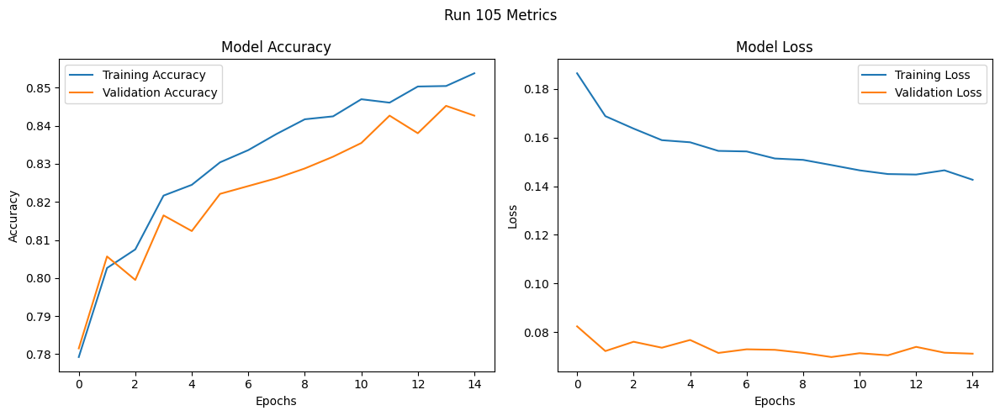

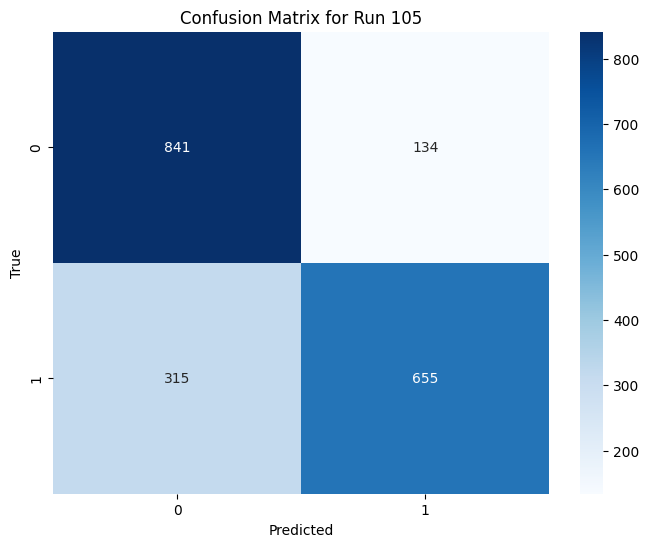

Run 106: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7615 - loss: 0.2841 - val_accuracy: 0.7990 - val_loss: 0.0768
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8057 - loss: 0.2365 - val_accuracy: 0.7979 - val_loss: 0.0766
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8189 - loss: 0.2231 - val_accuracy: 0.8175 - val_loss: 0.0710
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8273 - loss: 0.2189 - val_accuracy: 0.8180 - val_loss: 0.0709
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8326 - loss: 0.2093 - val_accuracy: 0.8278 - val_loss: 0.0701
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8328 - loss: 0.2107 - val_accuracy: 0.8386 - val_loss: 0.0685
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8415

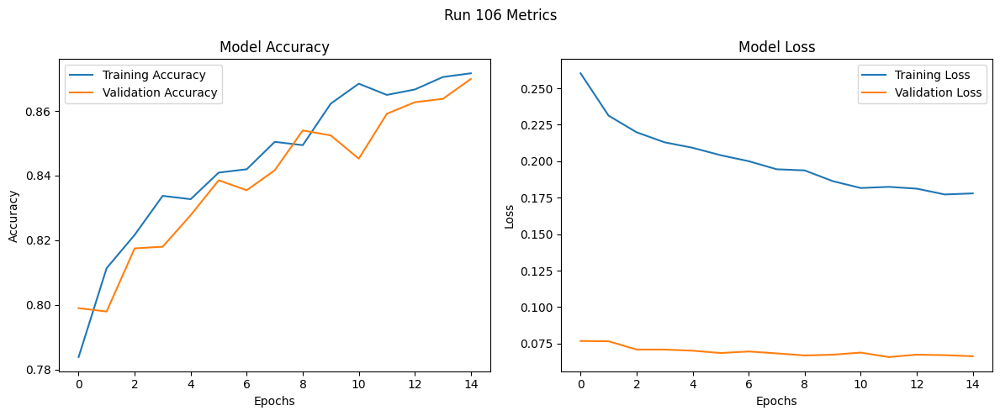

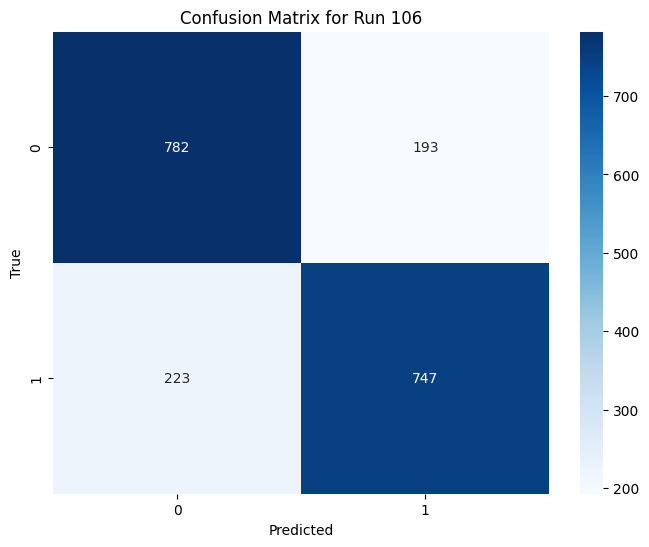

Run 107: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7450 - loss: 0.2927 - val_accuracy: 0.7938 - val_loss: 0.0783
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8160 - loss: 0.2319 - val_accuracy: 0.7913 - val_loss: 0.0767
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8173 - loss: 0.2224 - val_accuracy: 0.8154 - val_loss: 0.0719
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8269 - loss: 0.2107 - val_accuracy: 0.8170 - val_loss: 0.0727
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8349 - loss: 0.2129 - val_accuracy: 0.8190 - val_loss: 0.0730
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8342 - loss: 0.2123 - val_accuracy: 0.8021 - val_loss: 0.0765
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.839

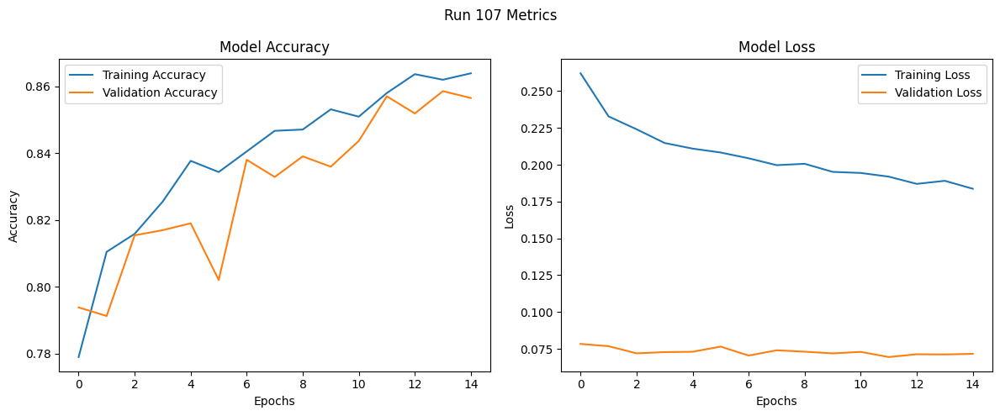

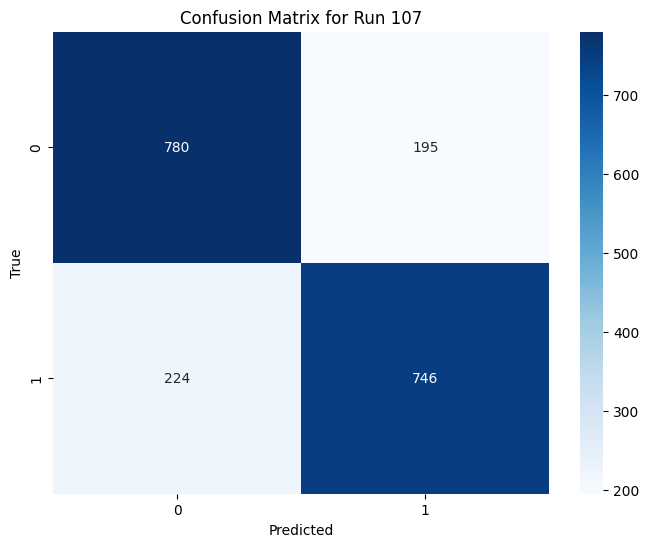

Run 108: L2: 0.0001, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7530 - loss: 0.2805 - val_accuracy: 0.8000 - val_loss: 0.0750
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8073 - loss: 0.2363 - val_accuracy: 0.7943 - val_loss: 0.0761
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8146 - loss: 0.2269 - val_accuracy: 0.8159 - val_loss: 0.0735
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8207 - loss: 0.2205 - val_accuracy: 0.8288 - val_loss: 0.0739
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8378 - loss: 0.2096 - val_accuracy: 0.8190 - val_loss: 0.0754
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8539 - loss: 0.2009 - val_accuracy: 0.8308 - val_loss: 0.0767
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8251 

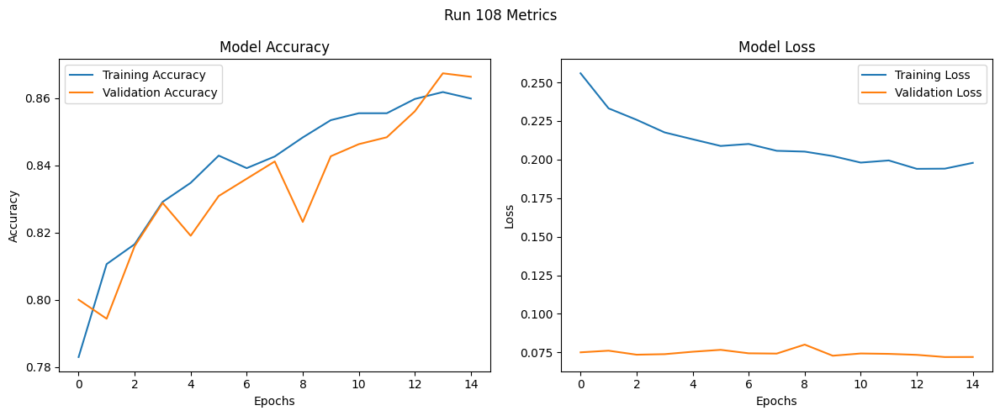

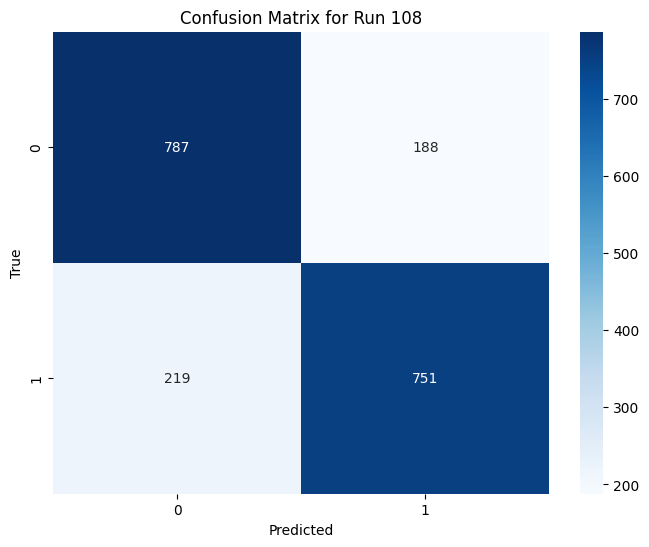

Run 109: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7518 - loss: 1.2047 - val_accuracy: 0.7784 - val_loss: 0.4573
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.7987 - loss: 1.0602 - val_accuracy: 0.8010 - val_loss: 0.4366
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8140 - loss: 1.0028 - val_accuracy: 0.8077 - val_loss: 0.4171
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8276 - loss: 0.9472 - val_accuracy: 0.8257 - val_loss: 0.4077
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8343 - loss: 0.9118 - val_accuracy: 0.8473 - val_loss: 0.3828
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8446 - loss: 0.8851 - val_accuracy: 0.8602 - val_loss: 0.3691
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step 

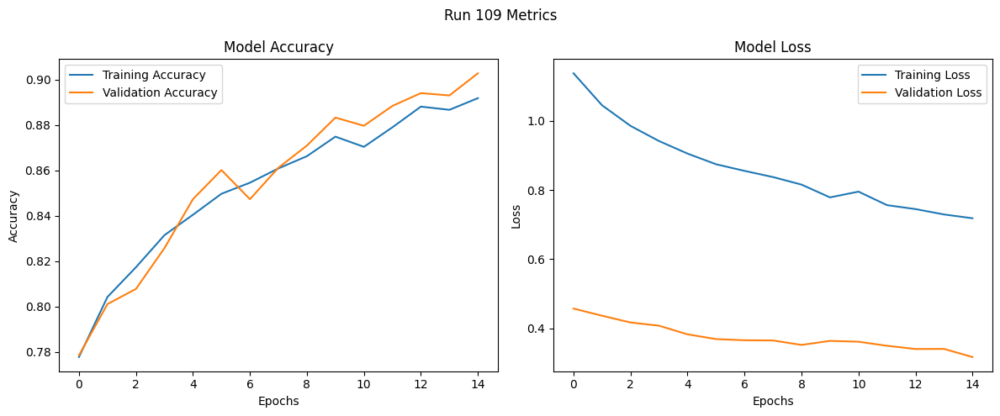

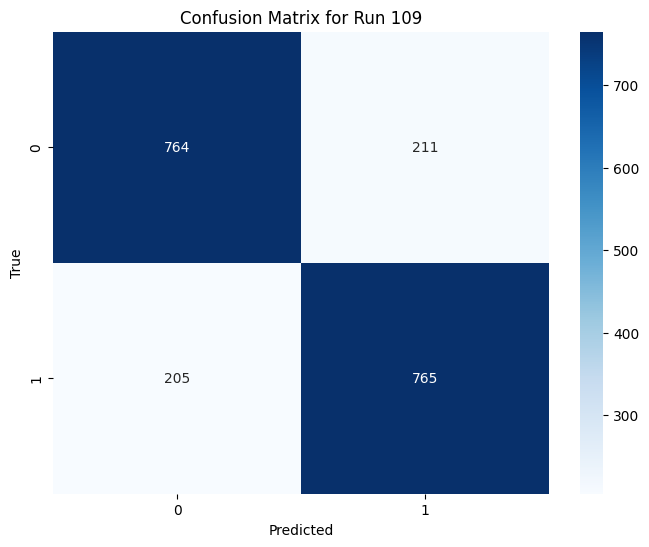

Run 110: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7545 - loss: 1.2263 - val_accuracy: 0.7933 - val_loss: 0.4585
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7918 - loss: 1.0571 - val_accuracy: 0.8036 - val_loss: 0.4393
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8199 - loss: 0.9958 - val_accuracy: 0.7933 - val_loss: 0.4599
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8226 - loss: 0.9755 - val_accuracy: 0.8185 - val_loss: 0.4316
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8281 - loss: 0.9368 - val_accuracy: 0.8329 - val_loss: 0.4066
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8427 - loss: 0.9187 - val_accuracy: 0.8267 - val_loss: 0.4028
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step 

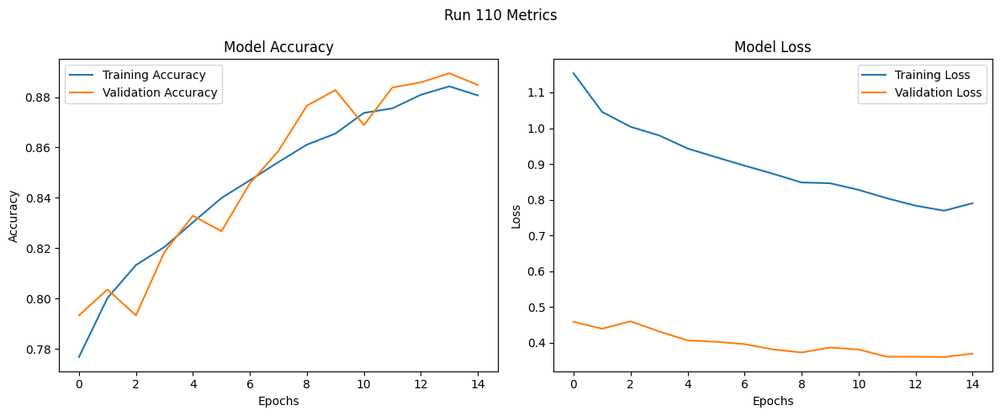

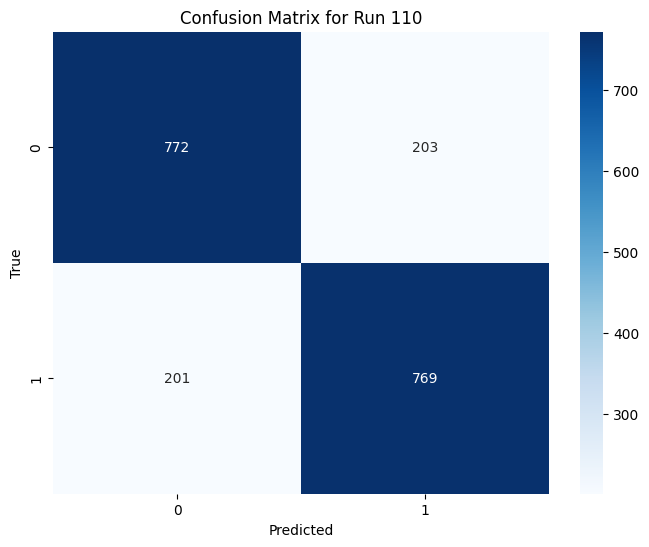

Run 111: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - accuracy: 0.7427 - loss: 1.2658 - val_accuracy: 0.7830 - val_loss: 0.4682
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.8027 - loss: 1.0703 - val_accuracy: 0.8062 - val_loss: 0.4429
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8016 - loss: 1.0305 - val_accuracy: 0.7877 - val_loss: 0.4716
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8063 - loss: 1.0022 - val_accuracy: 0.8149 - val_loss: 0.4203
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8265 - loss: 0.9591 - val_accuracy: 0.8237 - val_loss: 0.4307
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8422 - loss: 0.9377 - val_accuracy: 0.8221 - val_loss: 0.4421
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - 

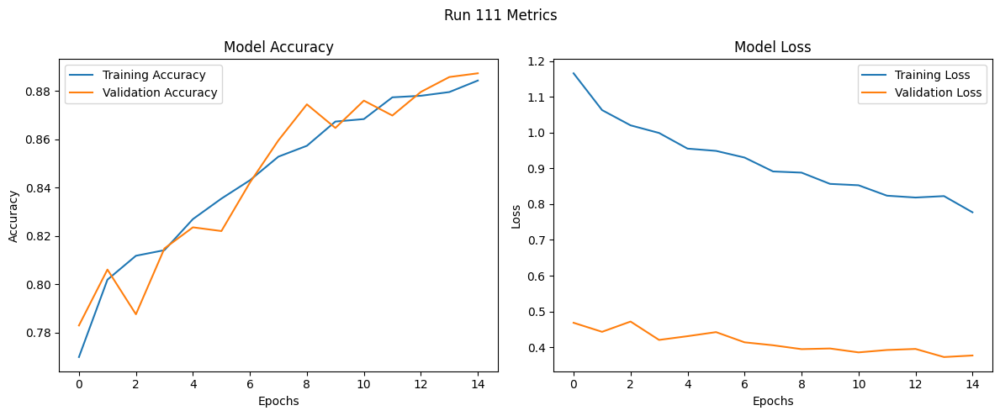

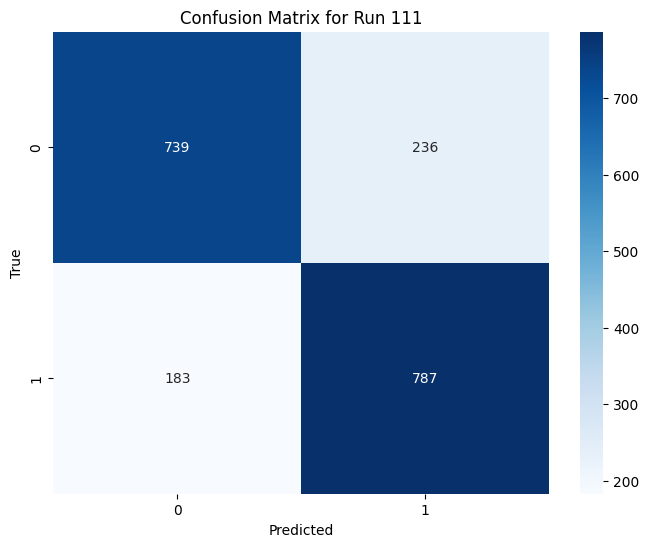

Run 112: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 5s 13ms/step - accuracy: 0.7638 - loss: 1.7071 - val_accuracy: 0.7748 - val_loss: 0.4872
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8084 - loss: 1.4752 - val_accuracy: 0.8113 - val_loss: 0.4246
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8136 - loss: 1.4126 - val_accuracy: 0.8123 - val_loss: 0.4330
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8320 - loss: 1.3170 - val_accuracy: 0.8180 - val_loss: 0.4197
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8441 - loss: 1.2377 - val_accuracy: 0.8062 - val_loss: 0.4189
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8430 - loss: 1.2308 - val_accuracy: 0.8334 - val_loss: 0.4007
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step -

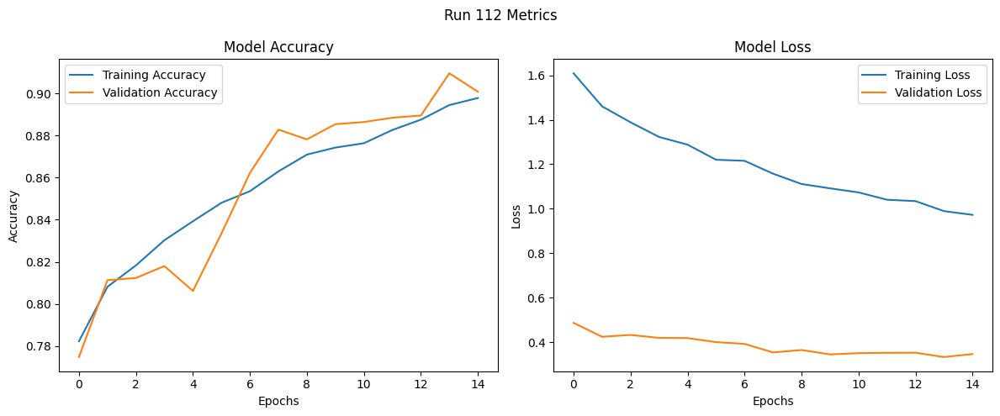

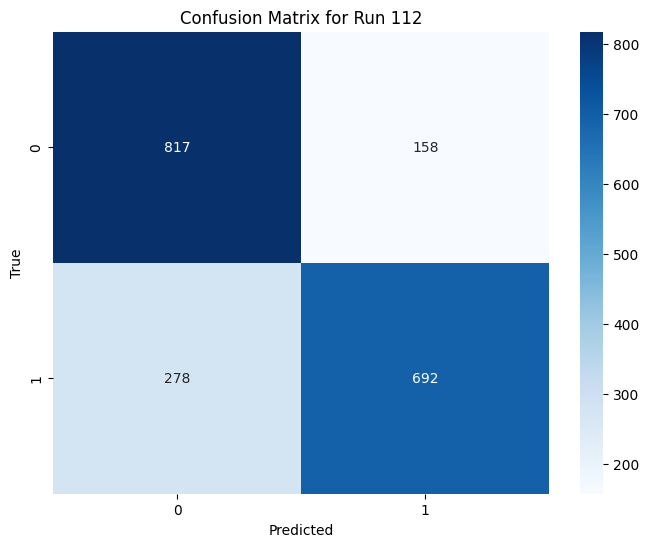

Run 113: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step - accuracy: 0.7547 - loss: 1.7763 - val_accuracy: 0.8051 - val_loss: 0.4487
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.8024 - loss: 1.4932 - val_accuracy: 0.7964 - val_loss: 0.4372
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8220 - loss: 1.3878 - val_accuracy: 0.7969 - val_loss: 0.4609
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8273 - loss: 1.3667 - val_accuracy: 0.8324 - val_loss: 0.4110
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8333 - loss: 1.3007 - val_accuracy: 0.8473 - val_loss: 0.4072
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8506 - loss: 1.2461 - val_accuracy: 0.8504 - val_loss: 0.3950
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step

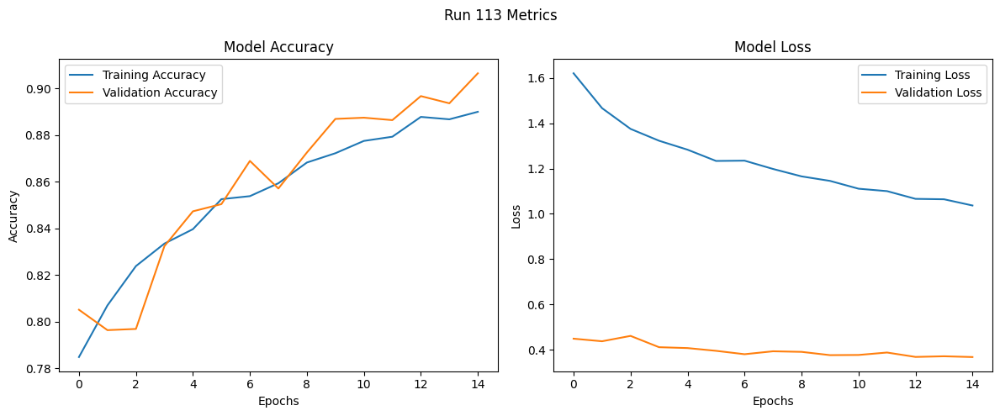

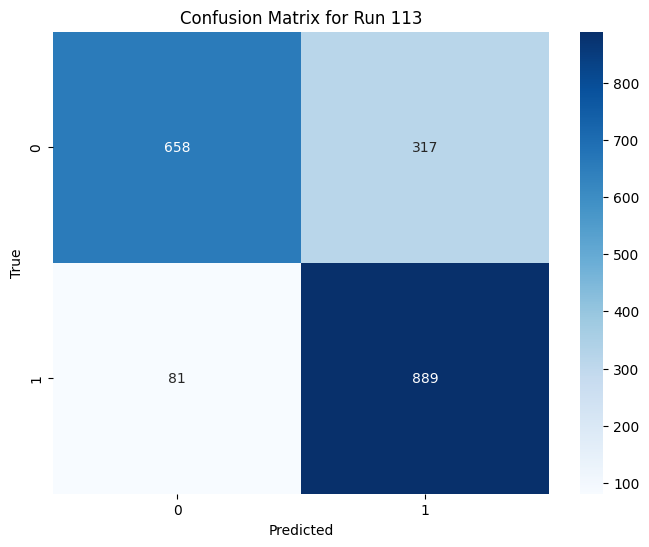

Run 114: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7522 - loss: 1.7439 - val_accuracy: 0.8031 - val_loss: 0.4662
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8022 - loss: 1.4973 - val_accuracy: 0.7722 - val_loss: 0.4636
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8095 - loss: 1.4654 - val_accuracy: 0.8123 - val_loss: 0.4499
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8228 - loss: 1.3690 - val_accuracy: 0.8144 - val_loss: 0.4450
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8260 - loss: 1.3729 - val_accuracy: 0.8386 - val_loss: 0.4299
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8421 - loss: 1.2861 - val_accuracy: 0.8447 - val_loss: 0.4119
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step 

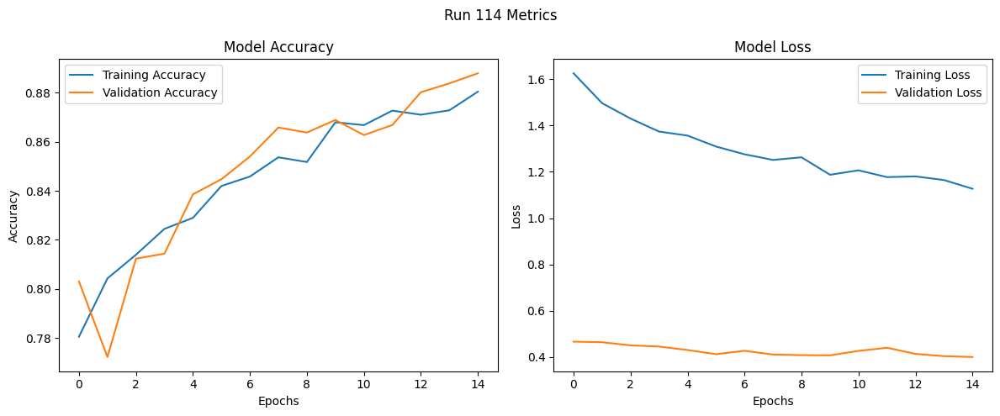

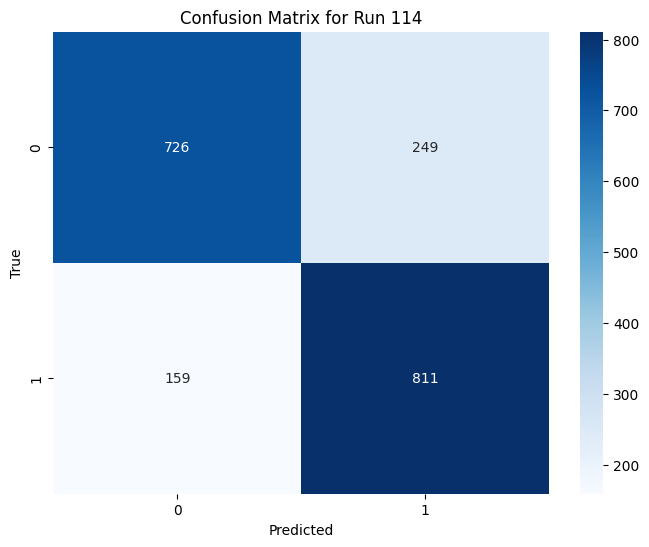

Run 115: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 5s 13ms/step - accuracy: 0.7498 - loss: 1.2238 - val_accuracy: 0.7964 - val_loss: 0.4519
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.8056 - loss: 1.0585 - val_accuracy: 0.7738 - val_loss: 0.4760
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.8113 - loss: 0.9889 - val_accuracy: 0.8103 - val_loss: 0.4206
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8256 - loss: 0.9634 - val_accuracy: 0.8154 - val_loss: 0.4150
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8220 - loss: 0.9524 - val_accuracy: 0.8339 - val_loss: 0.3905
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8441 - loss: 0.8891 - val_accuracy: 0.8406 - val_loss: 0.3869
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/ste

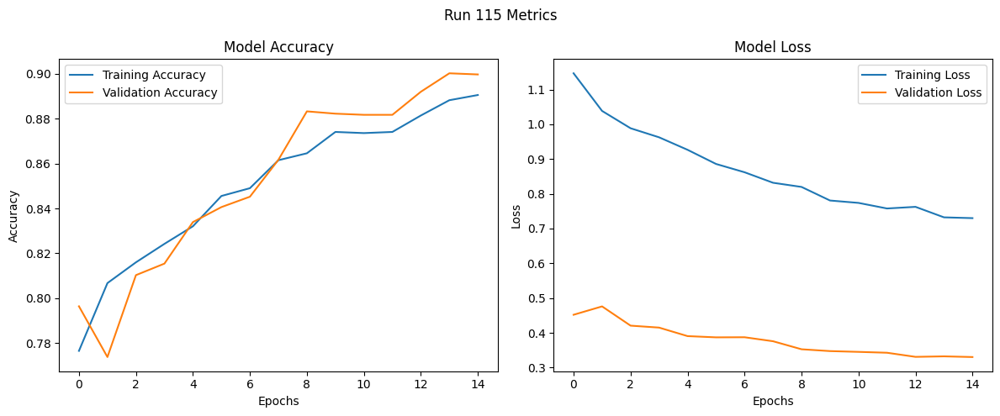

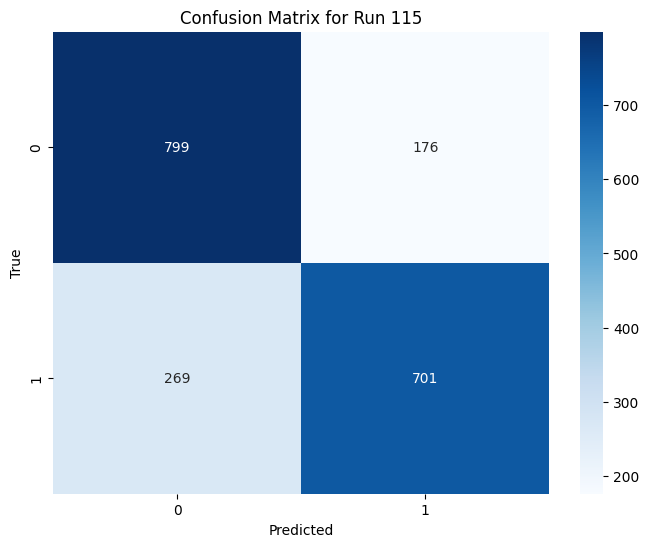

Run 116: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - accuracy: 0.7522 - loss: 1.1972 - val_accuracy: 0.7979 - val_loss: 0.4523
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.8057 - loss: 1.0603 - val_accuracy: 0.7979 - val_loss: 0.4514
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8081 - loss: 1.0119 - val_accuracy: 0.7990 - val_loss: 0.4375
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8247 - loss: 0.9648 - val_accuracy: 0.8108 - val_loss: 0.4178
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8237 - loss: 0.9471 - val_accuracy: 0.8314 - val_loss: 0.4061
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8471 - loss: 0.8827 - val_accuracy: 0.8437 - val_loss: 0.3956
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step

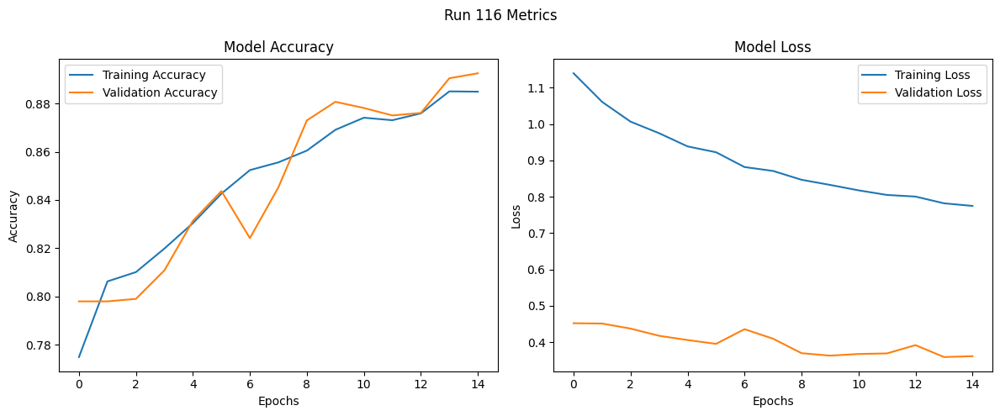

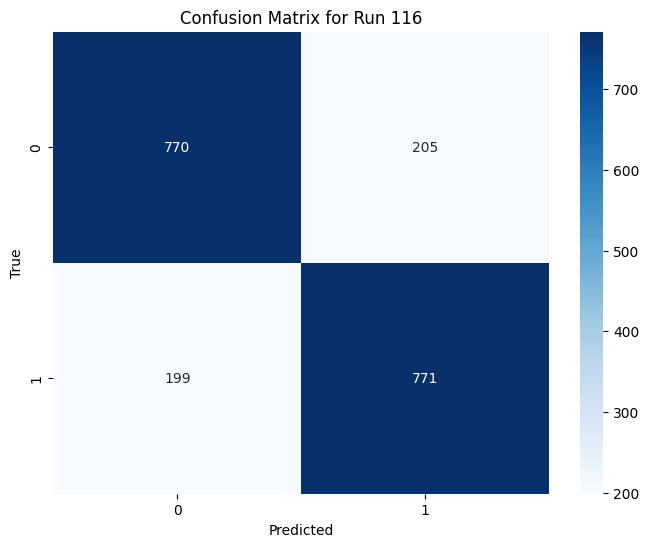

Run 117: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step - accuracy: 0.7509 - loss: 1.2463 - val_accuracy: 0.7794 - val_loss: 0.4639
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.8011 - loss: 1.0616 - val_accuracy: 0.8108 - val_loss: 0.4451
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8154 - loss: 1.0126 - val_accuracy: 0.7943 - val_loss: 0.4522
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8154 - loss: 1.0034 - val_accuracy: 0.8308 - val_loss: 0.4226
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8334 - loss: 0.9242 - val_accuracy: 0.8216 - val_loss: 0.4342
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8363 - loss: 0.9469 - val_accuracy: 0.8504 - val_loss: 0.4081
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step

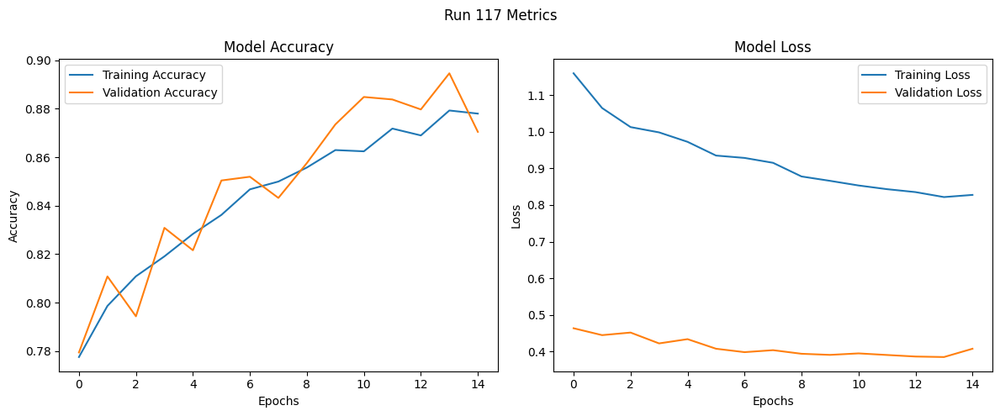

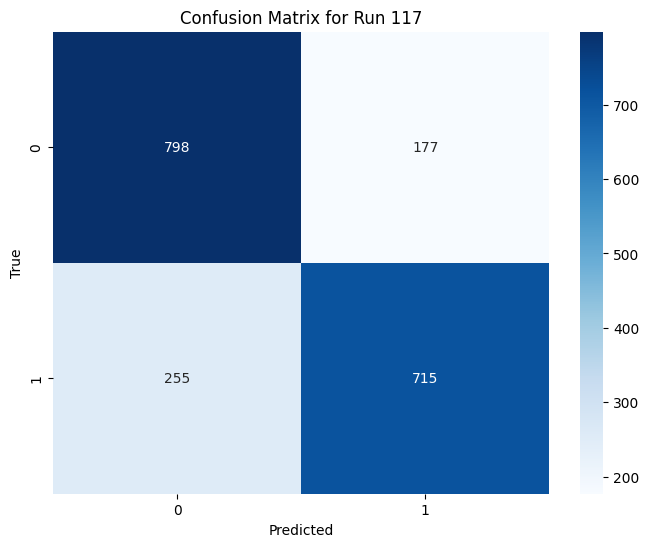

Run 118: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7563 - loss: 1.7026 - val_accuracy: 0.8082 - val_loss: 0.4462
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8093 - loss: 1.4641 - val_accuracy: 0.7882 - val_loss: 0.4705
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8184 - loss: 1.3995 - val_accuracy: 0.8103 - val_loss: 0.4336
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8258 - loss: 1.3400 - val_accuracy: 0.8149 - val_loss: 0.4233
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8394 - loss: 1.2693 - val_accuracy: 0.8406 - val_loss: 0.3916
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8589 - loss: 1.2069 - val_accuracy: 0.8411 - val_loss: 0.3890
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step

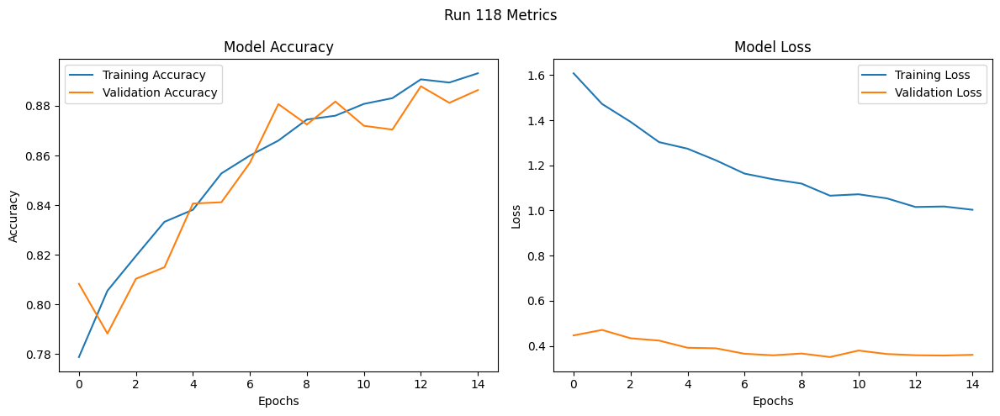

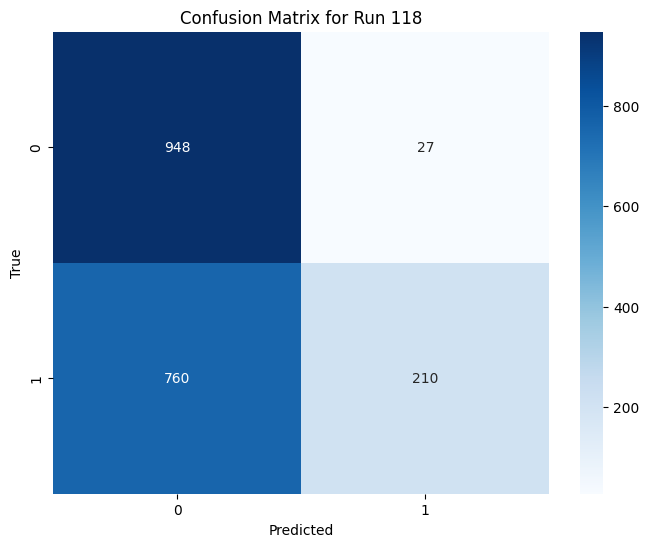

Run 119: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7684 - loss: 1.6982 - val_accuracy: 0.7943 - val_loss: 0.4724
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8019 - loss: 1.4590 - val_accuracy: 0.8026 - val_loss: 0.4419
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8183 - loss: 1.4075 - val_accuracy: 0.8272 - val_loss: 0.4296
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8340 - loss: 1.3331 - val_accuracy: 0.8175 - val_loss: 0.4431
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8323 - loss: 1.3030 - val_accuracy: 0.8293 - val_loss: 0.4224
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8478 - loss: 1.2553 - val_accuracy: 0.8581 - val_loss: 0.3983
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step

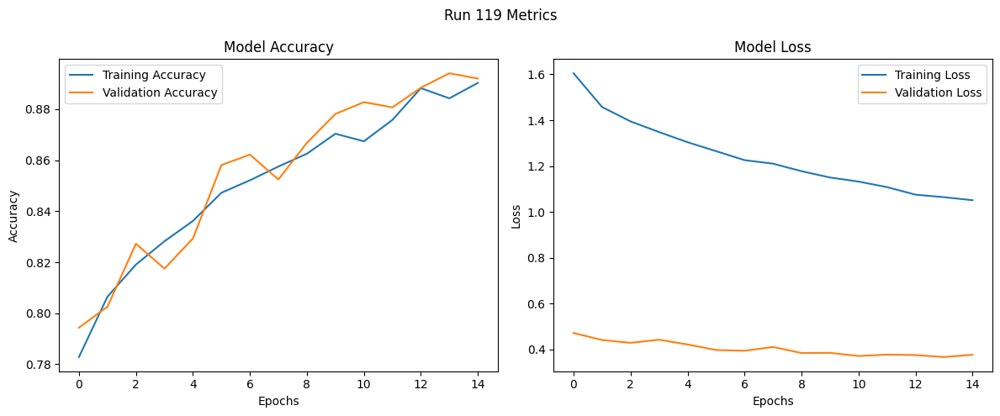

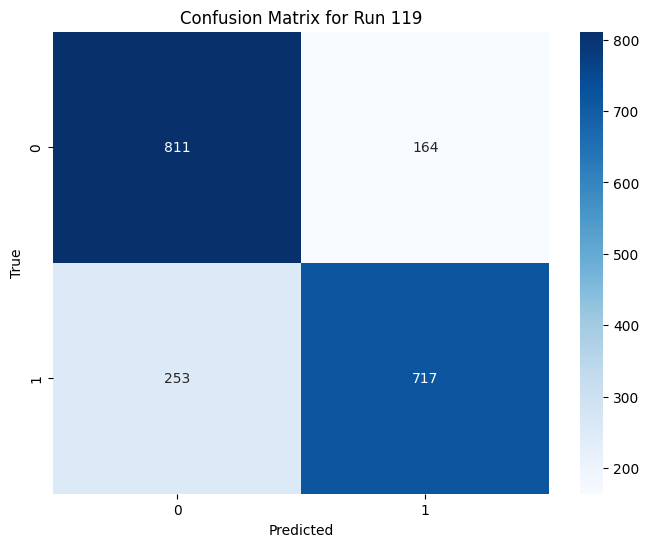

Run 120: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 5s 15ms/step - accuracy: 0.7421 - loss: 1.7517 - val_accuracy: 0.7779 - val_loss: 0.4757
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8037 - loss: 1.4837 - val_accuracy: 0.8057 - val_loss: 0.4375
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8198 - loss: 1.3895 - val_accuracy: 0.7969 - val_loss: 0.4646
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8163 - loss: 1.4278 - val_accuracy: 0.8231 - val_loss: 0.4269
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8258 - loss: 1.3578 - val_accuracy: 0.8015 - val_loss: 0.4710
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8309 - loss: 1.3618 - val_accuracy: 0.8324 - val_loss: 0.4350
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step -

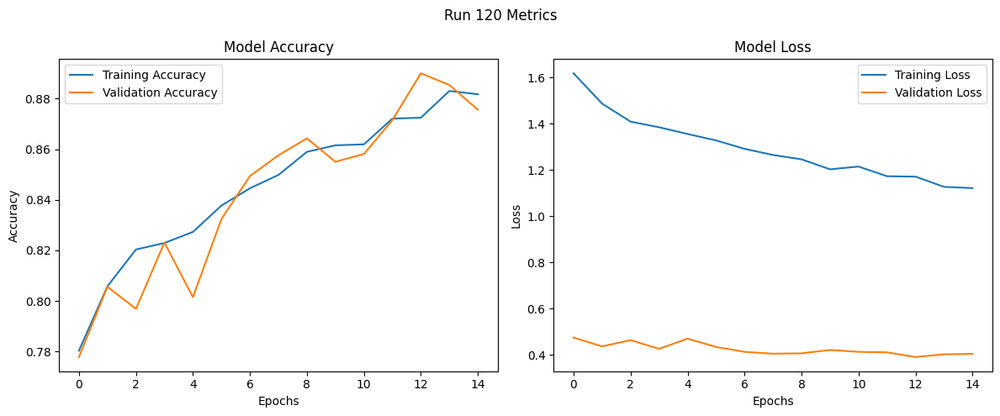

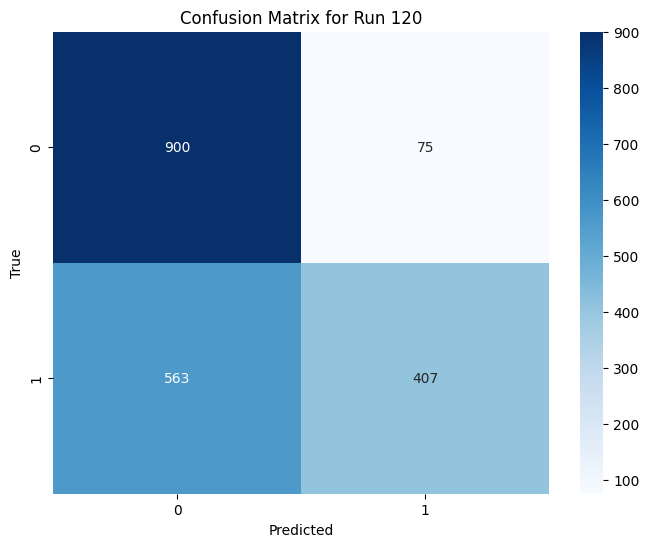

Run 121: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7499 - loss: 0.4277 - val_accuracy: 0.8015 - val_loss: 0.1581
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8061 - loss: 0.3515 - val_accuracy: 0.8026 - val_loss: 0.1551
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8217 - loss: 0.3337 - val_accuracy: 0.7712 - val_loss: 0.1666
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8318 - loss: 0.3178 - val_accuracy: 0.8093 - val_loss: 0.1514
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8329 - loss: 0.3121 - val_accuracy: 0.8221 - val_loss: 0.1470
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8455 - loss: 0.3031 - val_accuracy: 0.8386 - val_loss: 0.1419
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - acc

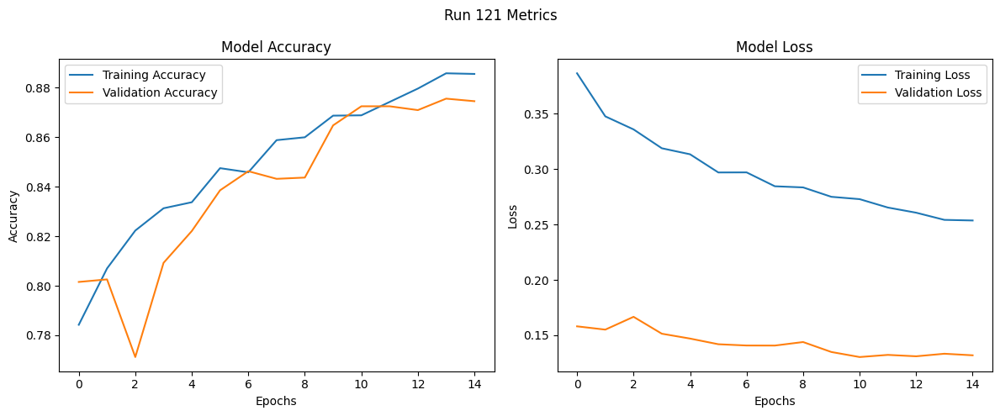

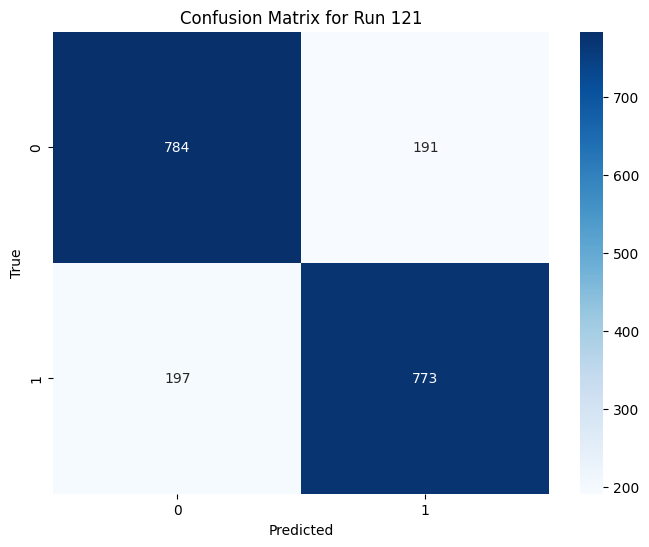

Run 122: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7527 - loss: 0.4207 - val_accuracy: 0.7851 - val_loss: 0.1681
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8070 - loss: 0.3536 - val_accuracy: 0.7892 - val_loss: 0.1611
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8046 - loss: 0.3463 - val_accuracy: 0.8057 - val_loss: 0.1534
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8314 - loss: 0.3170 - val_accuracy: 0.8093 - val_loss: 0.1514
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8362 - loss: 0.3108 - val_accuracy: 0.8391 - val_loss: 0.1430
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8293 - loss: 0.3207 - val_accuracy: 0.8154 - val_loss: 0.1558
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accu

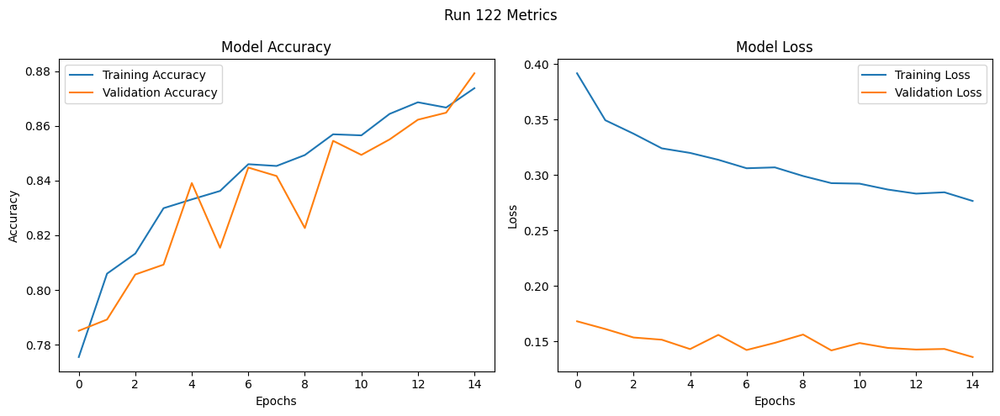

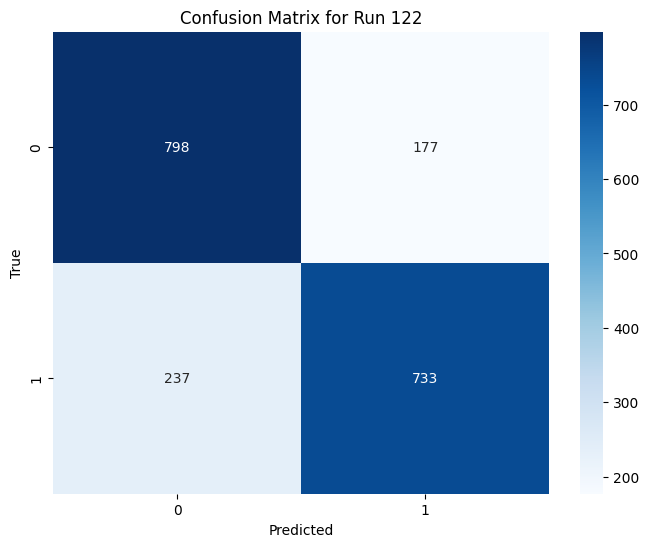

Run 123: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - accuracy: 0.7532 - loss: 0.4217 - val_accuracy: 0.7974 - val_loss: 0.1582
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8092 - loss: 0.3586 - val_accuracy: 0.8144 - val_loss: 0.1516
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8106 - loss: 0.3442 - val_accuracy: 0.8072 - val_loss: 0.1571
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8298 - loss: 0.3235 - val_accuracy: 0.8031 - val_loss: 0.1615
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8206 - loss: 0.3372 - val_accuracy: 0.8242 - val_loss: 0.1506
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8445 - loss: 0.3158 - val_accuracy: 0.8319 - val_loss: 0.1469
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accura

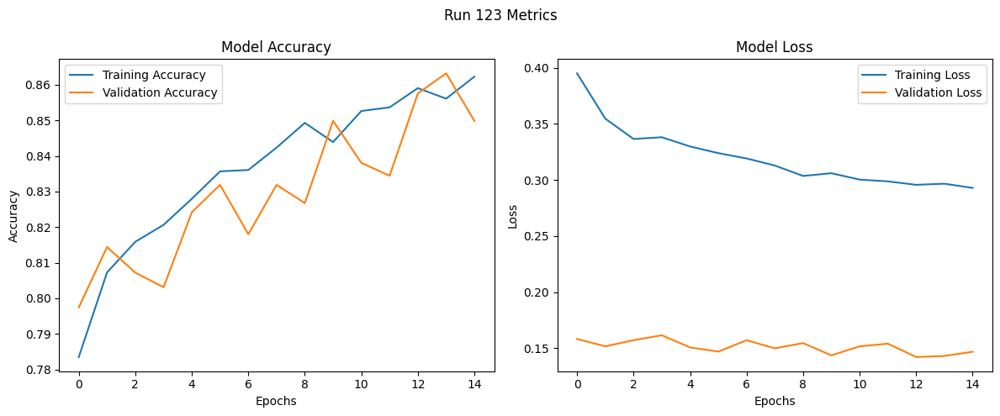

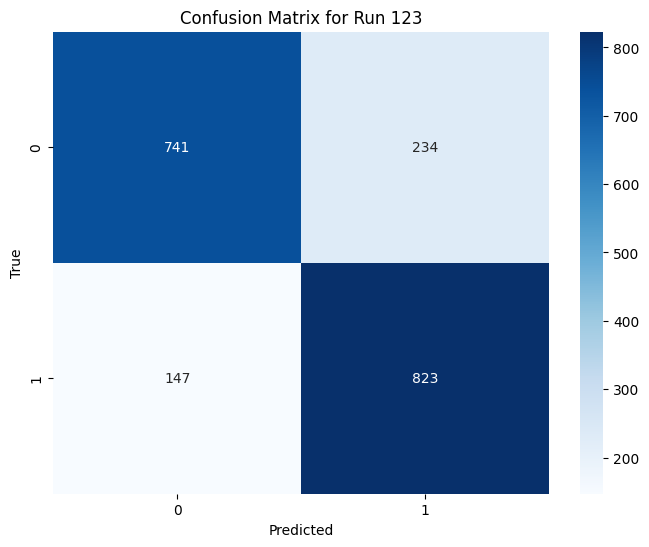

Run 124: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7472 - loss: 0.5931 - val_accuracy: 0.8031 - val_loss: 0.1589
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.8135 - loss: 0.4882 - val_accuracy: 0.8067 - val_loss: 0.1547
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8184 - loss: 0.4670 - val_accuracy: 0.8190 - val_loss: 0.1476
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8382 - loss: 0.4330 - val_accuracy: 0.8201 - val_loss: 0.1479
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8373 - loss: 0.4311 - val_accuracy: 0.8262 - val_loss: 0.1500
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8455 - loss: 0.4095 - val_accuracy: 0.8329 - val_loss: 0.1487
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accur

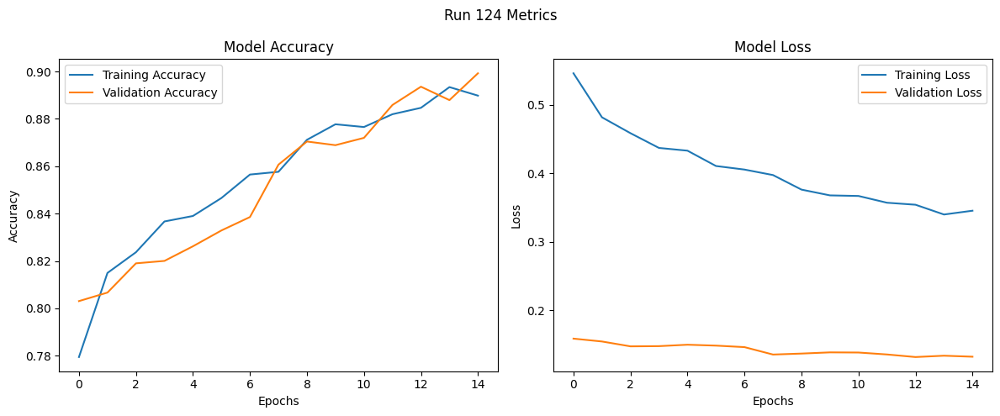

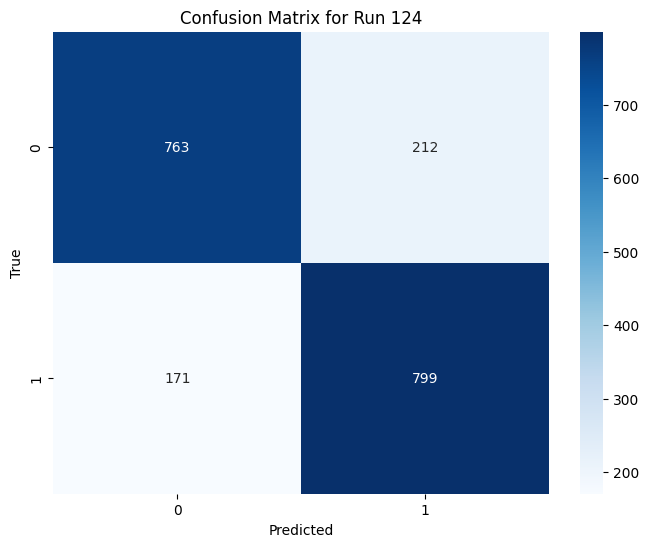

Run 125: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7612 - loss: 0.5897 - val_accuracy: 0.7969 - val_loss: 0.1583
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8100 - loss: 0.4900 - val_accuracy: 0.7969 - val_loss: 0.1597
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8270 - loss: 0.4587 - val_accuracy: 0.8226 - val_loss: 0.1500
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8370 - loss: 0.4485 - val_accuracy: 0.8380 - val_loss: 0.1470
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8398 - loss: 0.4310 - val_accuracy: 0.8360 - val_loss: 0.1504
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8426 - loss: 0.4462 - val_accuracy: 0.8483 - val_loss: 0.1476
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accu

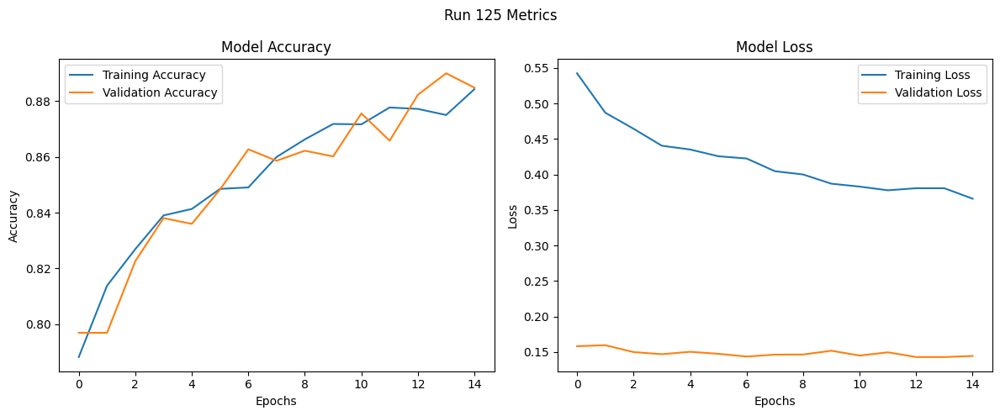

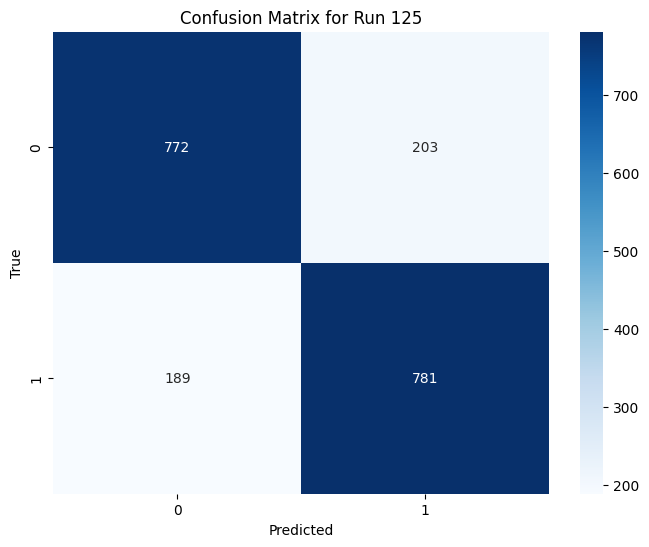

Run 126: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7433 - loss: 0.6087 - val_accuracy: 0.8000 - val_loss: 0.1615
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8130 - loss: 0.4945 - val_accuracy: 0.7990 - val_loss: 0.1593
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8197 - loss: 0.4658 - val_accuracy: 0.8077 - val_loss: 0.1568
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8229 - loss: 0.4657 - val_accuracy: 0.8288 - val_loss: 0.1558
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8345 - loss: 0.4491 - val_accuracy: 0.8123 - val_loss: 0.1634
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8429 - loss: 0.4389 - val_accuracy: 0.8087 - val_loss: 0.1689
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accura

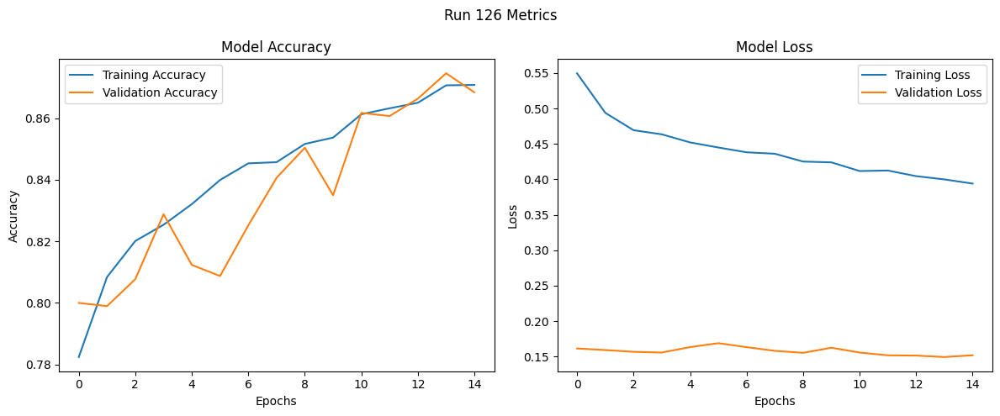

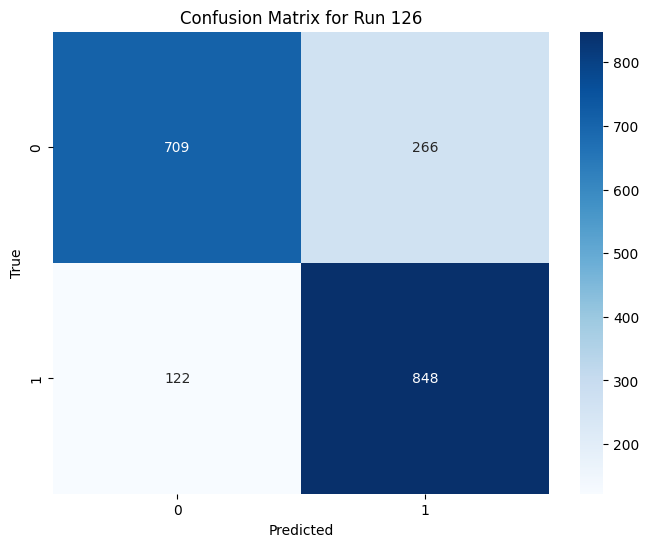

Run 127: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7548 - loss: 0.4170 - val_accuracy: 0.7990 - val_loss: 0.1584
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8064 - loss: 0.3634 - val_accuracy: 0.8108 - val_loss: 0.1516
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8241 - loss: 0.3319 - val_accuracy: 0.8062 - val_loss: 0.1593
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8375 - loss: 0.3114 - val_accuracy: 0.8185 - val_loss: 0.1445
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8379 - loss: 0.3102 - val_accuracy: 0.8206 - val_loss: 0.1459
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8493 - loss: 0.2974 - val_accuracy: 0.8406 - val_loss: 0.1411
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accur

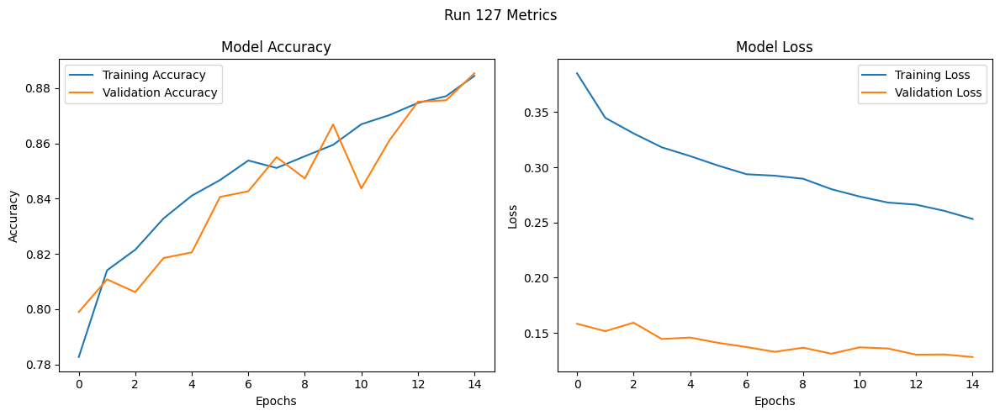

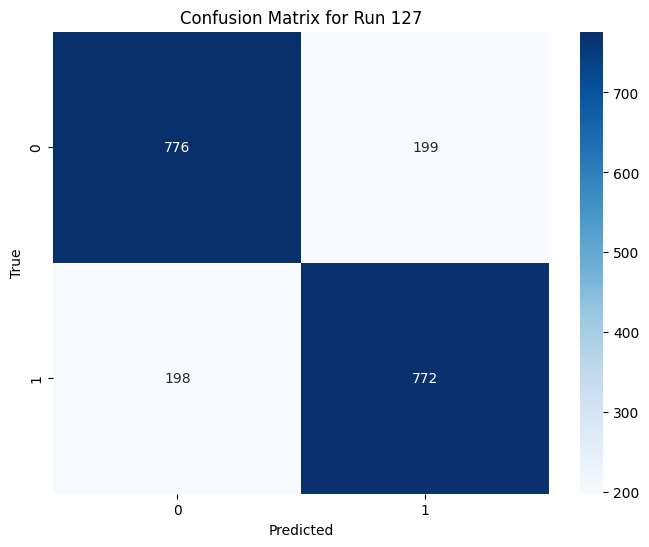

Run 128: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7438 - loss: 0.4308 - val_accuracy: 0.7861 - val_loss: 0.1626
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8076 - loss: 0.3506 - val_accuracy: 0.8026 - val_loss: 0.1579
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8141 - loss: 0.3360 - val_accuracy: 0.8108 - val_loss: 0.1485
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8276 - loss: 0.3233 - val_accuracy: 0.8134 - val_loss: 0.1539
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8328 - loss: 0.3121 - val_accuracy: 0.8350 - val_loss: 0.1452
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8435 - loss: 0.3020 - val_accuracy: 0.8170 - val_loss: 0.1537
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - acc

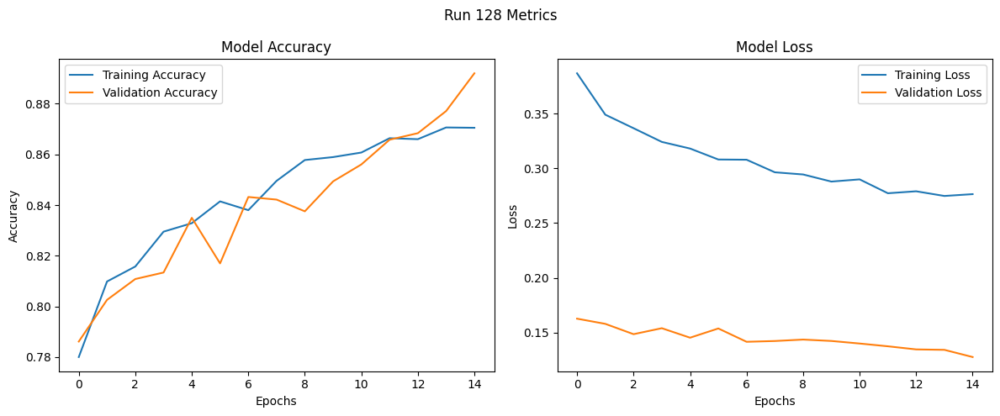

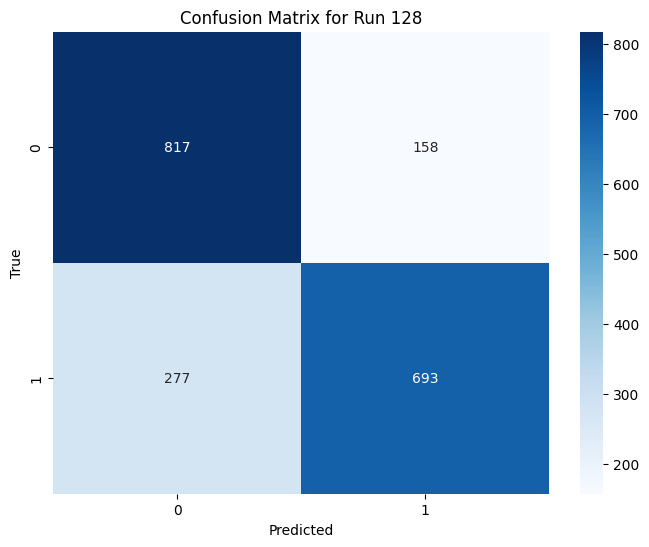

Run 129: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7639 - loss: 0.4250 - val_accuracy: 0.7969 - val_loss: 0.1602
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8015 - loss: 0.3579 - val_accuracy: 0.7990 - val_loss: 0.1598
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8221 - loss: 0.3403 - val_accuracy: 0.8123 - val_loss: 0.1525
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8280 - loss: 0.3269 - val_accuracy: 0.8154 - val_loss: 0.1551
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8353 - loss: 0.3251 - val_accuracy: 0.8298 - val_loss: 0.1504
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8309 - loss: 0.3353 - val_accuracy: 0.8170 - val_loss: 0.1548
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accur

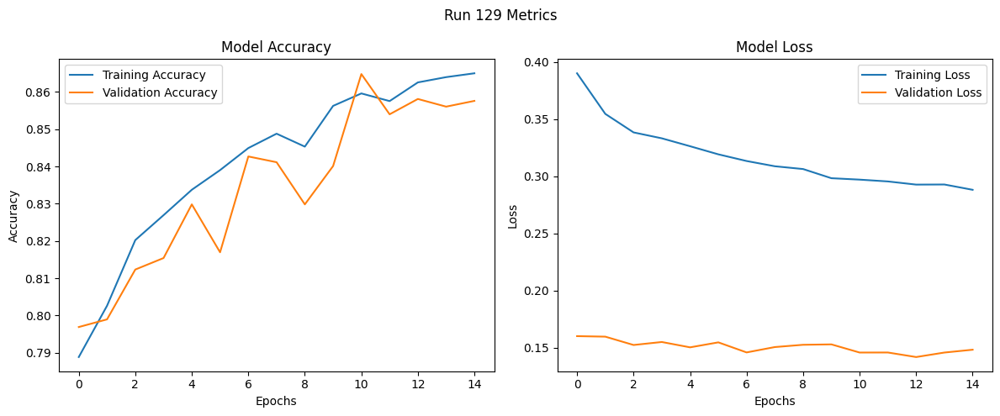

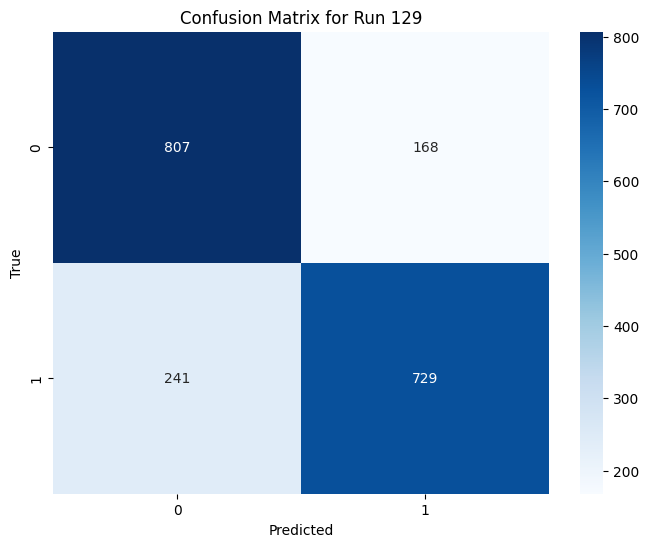

Run 130: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7499 - loss: 0.5906 - val_accuracy: 0.7964 - val_loss: 0.1609
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8033 - loss: 0.5017 - val_accuracy: 0.8031 - val_loss: 0.1550
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8245 - loss: 0.4653 - val_accuracy: 0.8175 - val_loss: 0.1468
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8279 - loss: 0.4510 - val_accuracy: 0.8226 - val_loss: 0.1458
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8448 - loss: 0.4247 - val_accuracy: 0.8303 - val_loss: 0.1421
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8467 - loss: 0.4115 - val_accuracy: 0.8226 - val_loss: 0.1530
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accur

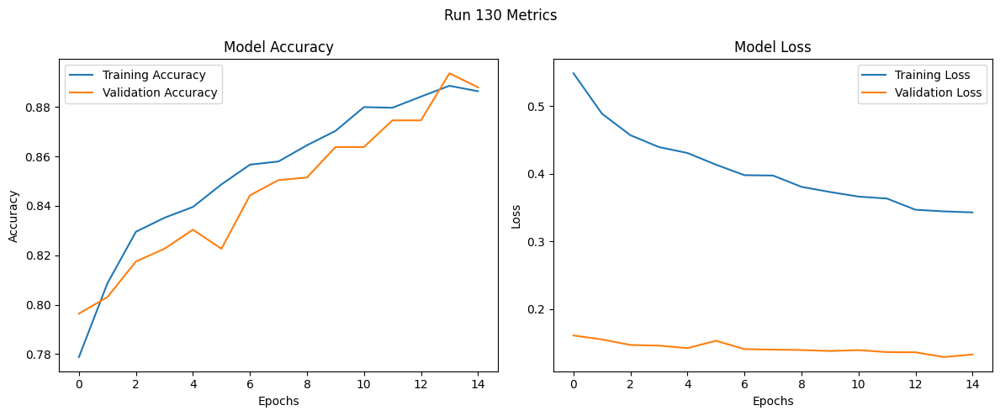

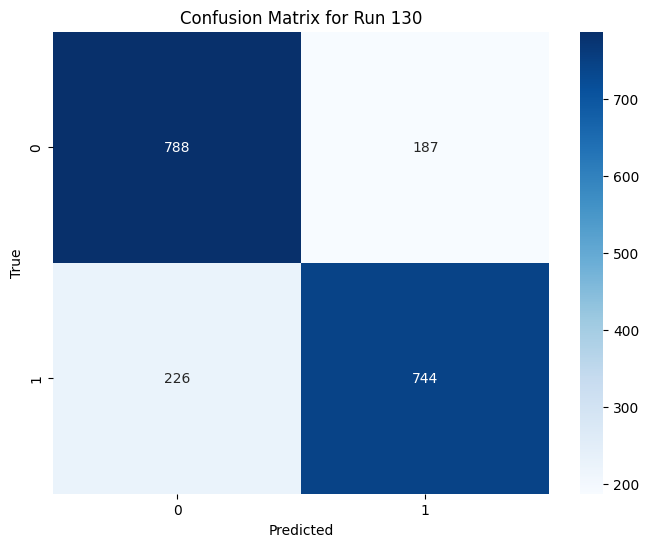

Run 131: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7498 - loss: 0.5953 - val_accuracy: 0.8103 - val_loss: 0.1550
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8074 - loss: 0.4891 - val_accuracy: 0.7877 - val_loss: 0.1646
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8096 - loss: 0.4827 - val_accuracy: 0.8252 - val_loss: 0.1524
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8360 - loss: 0.4442 - val_accuracy: 0.8195 - val_loss: 0.1495
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8443 - loss: 0.4263 - val_accuracy: 0.8201 - val_loss: 0.1552
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8475 - loss: 0.4230 - val_accuracy: 0.8324 - val_loss: 0.1528
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - acc

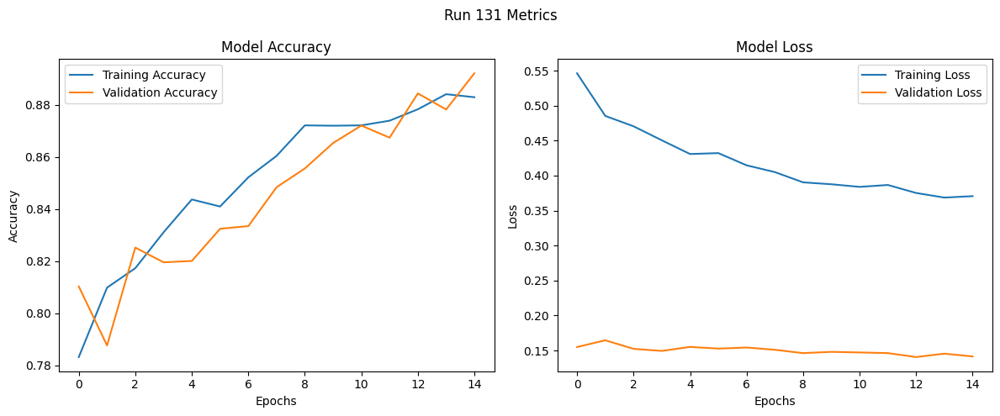

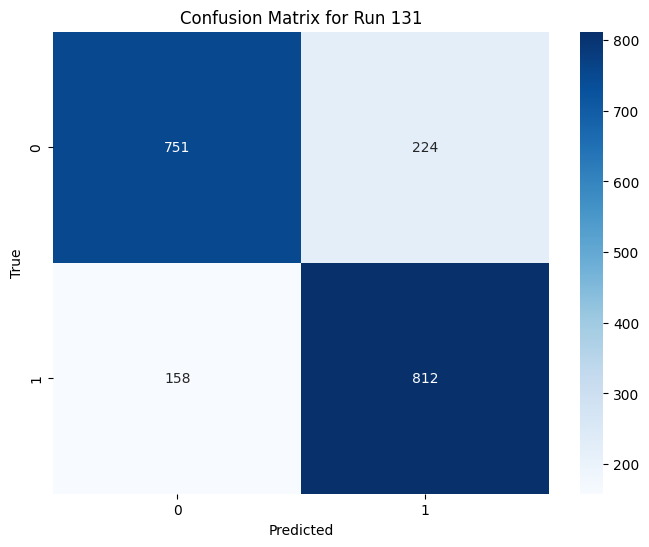

Run 132: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7595 - loss: 0.5899 - val_accuracy: 0.8026 - val_loss: 0.1616
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8101 - loss: 0.4918 - val_accuracy: 0.8108 - val_loss: 0.1573
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8206 - loss: 0.4668 - val_accuracy: 0.8139 - val_loss: 0.1603
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8381 - loss: 0.4531 - val_accuracy: 0.8288 - val_loss: 0.1539
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8342 - loss: 0.4522 - val_accuracy: 0.8391 - val_loss: 0.1552
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8504 - loss: 0.4288 - val_accuracy: 0.8416 - val_loss: 0.1552
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accura

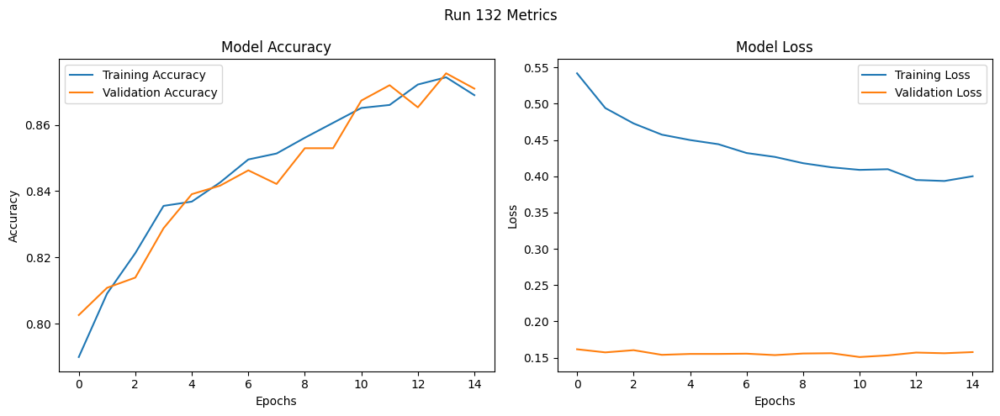

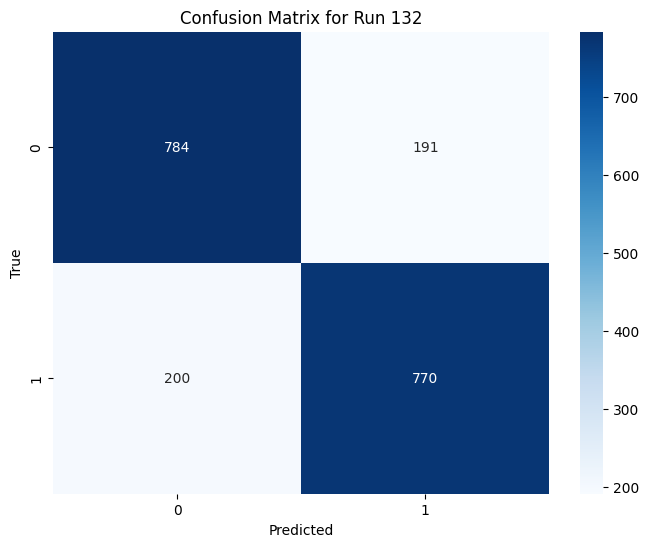

Run 133: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7520 - loss: 0.2055 - val_accuracy: 0.7897 - val_loss: 0.0808
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8014 - loss: 0.1708 - val_accuracy: 0.8026 - val_loss: 0.0756
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8200 - loss: 0.1569 - val_accuracy: 0.8170 - val_loss: 0.0730
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8339 - loss: 0.1520 - val_accuracy: 0.8231 - val_loss: 0.0723
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8433 - loss: 0.1462 - val_accuracy: 0.8180 - val_loss: 0.0726
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8439 - loss: 0.1458 - val_accuracy: 0.8272 - val_loss: 0.0709
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.844

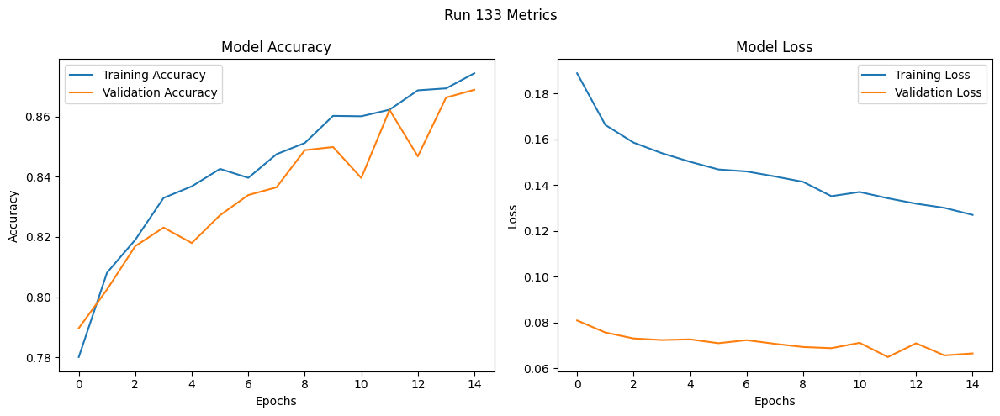

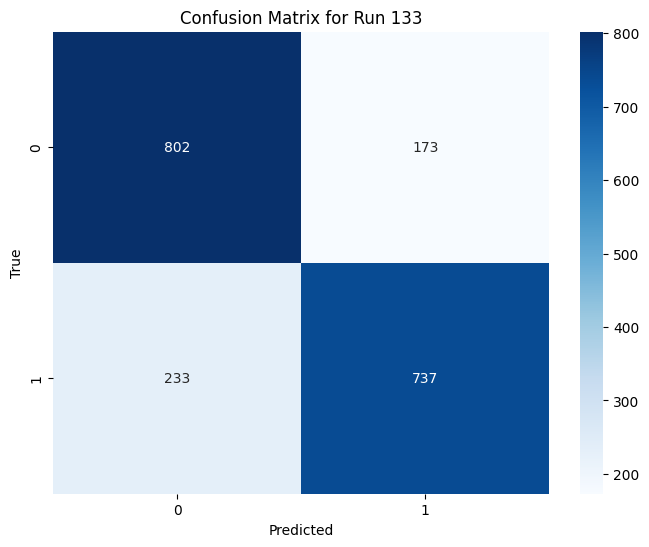

Run 134: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7580 - loss: 0.2046 - val_accuracy: 0.8041 - val_loss: 0.0763
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7984 - loss: 0.1701 - val_accuracy: 0.8051 - val_loss: 0.0761
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8211 - loss: 0.1583 - val_accuracy: 0.8036 - val_loss: 0.0747
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8224 - loss: 0.1564 - val_accuracy: 0.7974 - val_loss: 0.0770
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8325 - loss: 0.1523 - val_accuracy: 0.8216 - val_loss: 0.0718
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8322 - loss: 0.1494 - val_accuracy: 0.8103 - val_loss: 0.0736
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.837

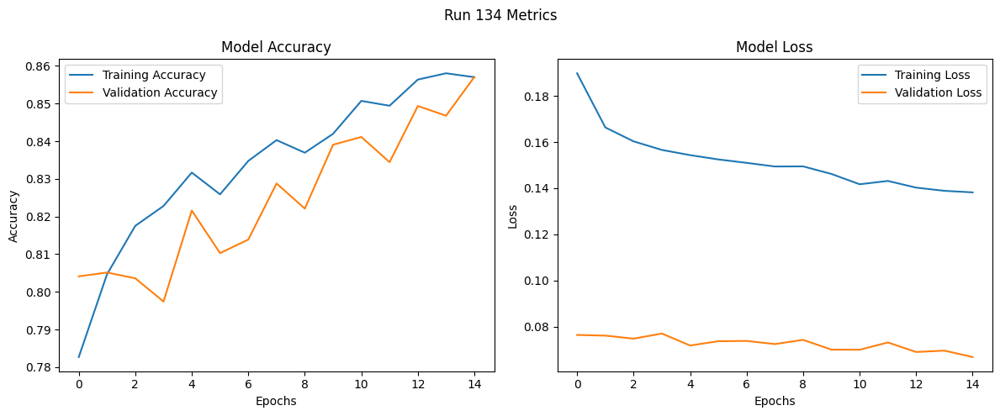

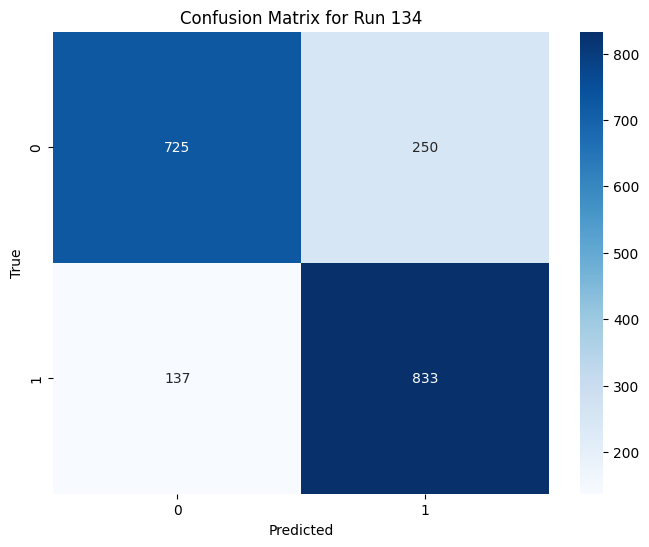

Run 135: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7492 - loss: 0.2058 - val_accuracy: 0.7907 - val_loss: 0.0789
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7993 - loss: 0.1692 - val_accuracy: 0.8118 - val_loss: 0.0757
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8176 - loss: 0.1628 - val_accuracy: 0.7861 - val_loss: 0.0807
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8155 - loss: 0.1593 - val_accuracy: 0.8129 - val_loss: 0.0735
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8210 - loss: 0.1601 - val_accuracy: 0.8190 - val_loss: 0.0744
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8374 - loss: 0.1542 - val_accuracy: 0.8267 - val_loss: 0.0762
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8298 

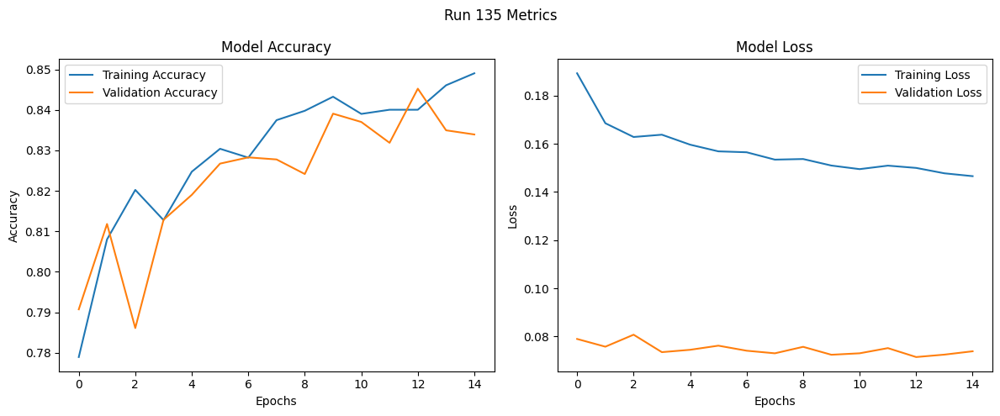

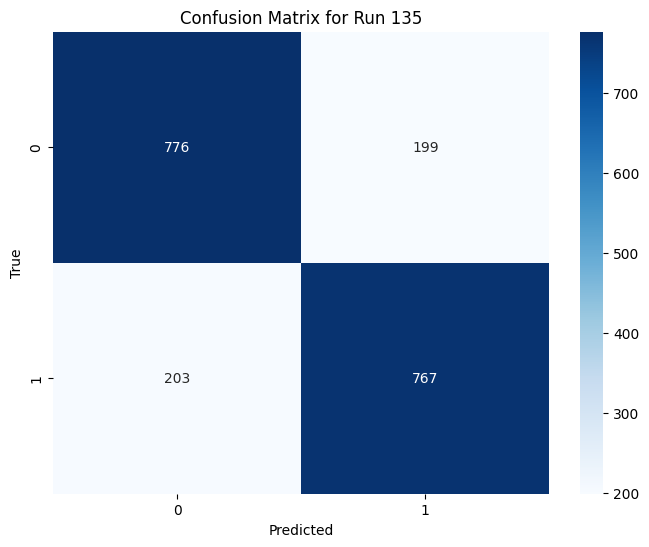

Run 136: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7652 - loss: 0.2796 - val_accuracy: 0.8067 - val_loss: 0.0794
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8114 - loss: 0.2369 - val_accuracy: 0.8041 - val_loss: 0.0782
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8182 - loss: 0.2251 - val_accuracy: 0.8226 - val_loss: 0.0733
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8344 - loss: 0.2124 - val_accuracy: 0.8262 - val_loss: 0.0743
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8450 - loss: 0.2052 - val_accuracy: 0.8339 - val_loss: 0.0734
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8530 - loss: 0.1965 - val_accuracy: 0.8303 - val_loss: 0.0742
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.851

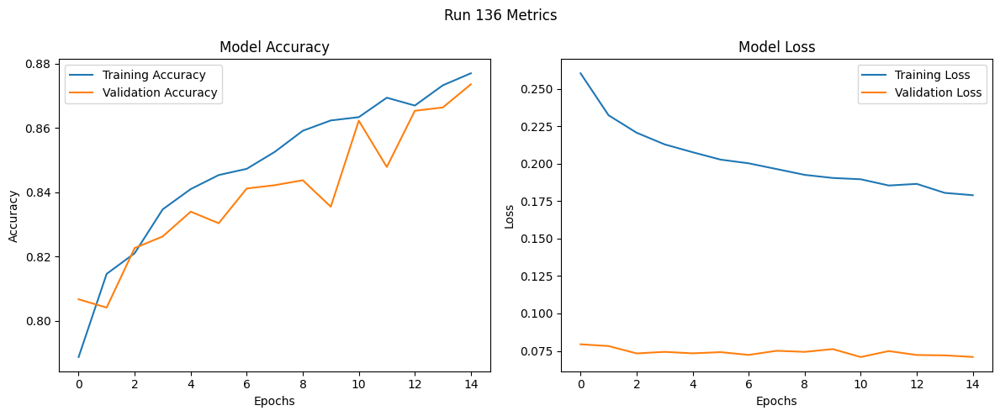

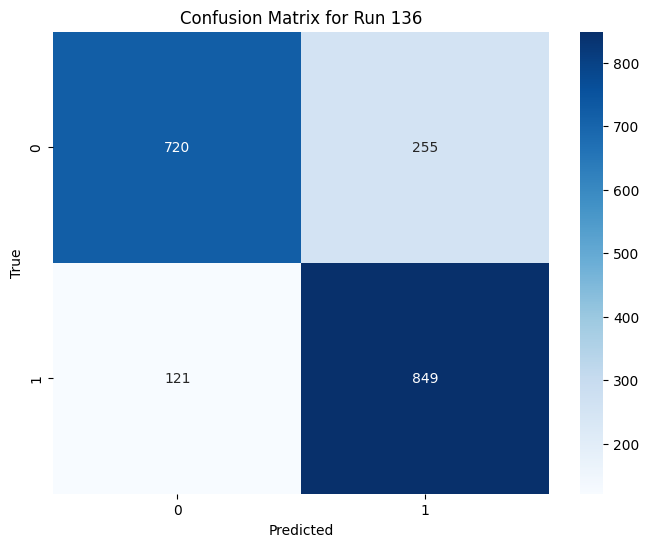

Run 137: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7675 - loss: 0.2854 - val_accuracy: 0.7954 - val_loss: 0.0806
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8034 - loss: 0.2417 - val_accuracy: 0.8093 - val_loss: 0.0765
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8100 - loss: 0.2353 - val_accuracy: 0.8015 - val_loss: 0.0781
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8224 - loss: 0.2198 - val_accuracy: 0.8288 - val_loss: 0.0749
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8305 - loss: 0.2190 - val_accuracy: 0.8242 - val_loss: 0.0764
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8398 - loss: 0.2076 - val_accuracy: 0.8257 - val_loss: 0.0751
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.83

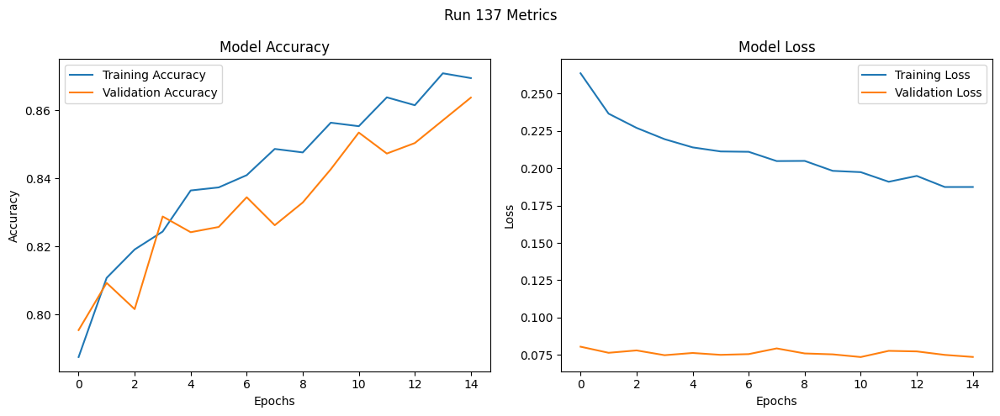

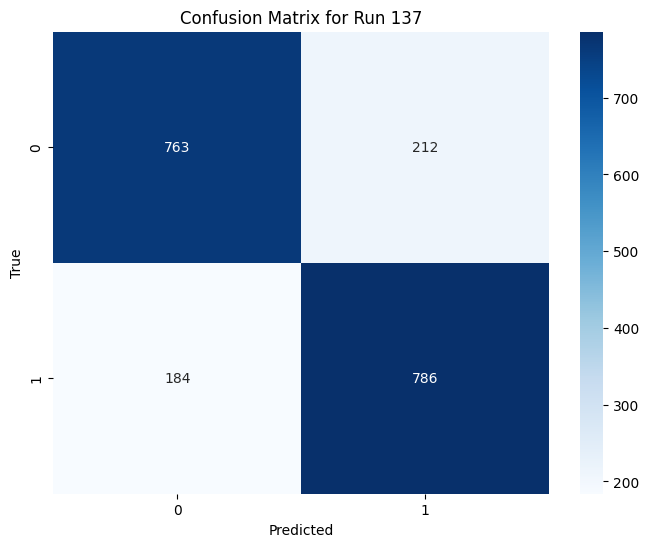

Run 138: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7740 - loss: 0.2778 - val_accuracy: 0.7918 - val_loss: 0.0815
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8046 - loss: 0.2374 - val_accuracy: 0.7692 - val_loss: 0.0864
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8133 - loss: 0.2303 - val_accuracy: 0.8159 - val_loss: 0.0768
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8282 - loss: 0.2195 - val_accuracy: 0.7902 - val_loss: 0.0822
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8344 - loss: 0.2165 - val_accuracy: 0.8252 - val_loss: 0.0780
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8402 - loss: 0.2116 - val_accuracy: 0.8278 - val_loss: 0.0773
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8457

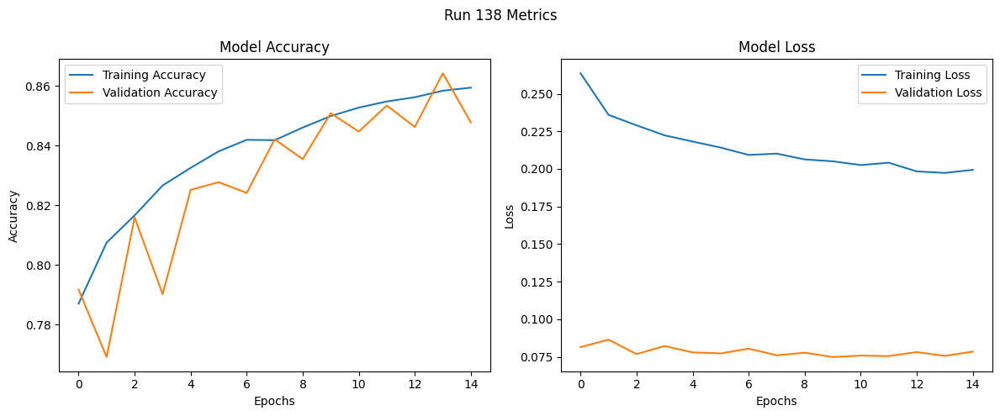

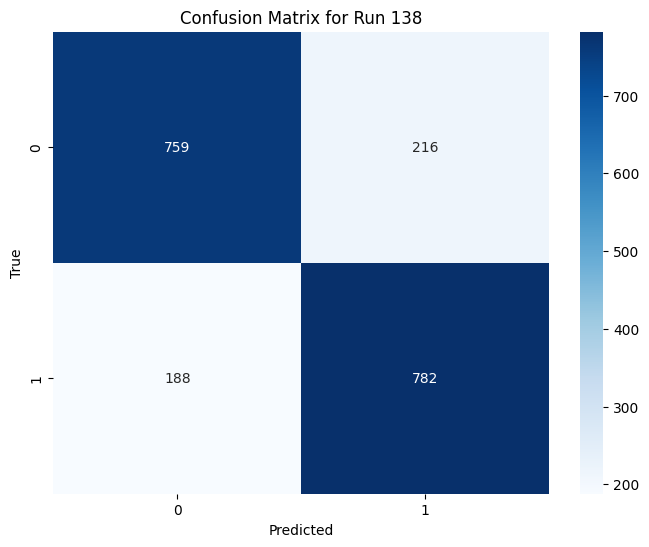

Run 139: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7610 - loss: 0.2056 - val_accuracy: 0.7959 - val_loss: 0.0791
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8109 - loss: 0.1664 - val_accuracy: 0.8093 - val_loss: 0.0726
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8059 - loss: 0.1655 - val_accuracy: 0.8118 - val_loss: 0.0757
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8373 - loss: 0.1503 - val_accuracy: 0.8134 - val_loss: 0.0742
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8341 - loss: 0.1525 - val_accuracy: 0.8216 - val_loss: 0.0720
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8376 - loss: 0.1486 - val_accuracy: 0.8324 - val_loss: 0.0695
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.836

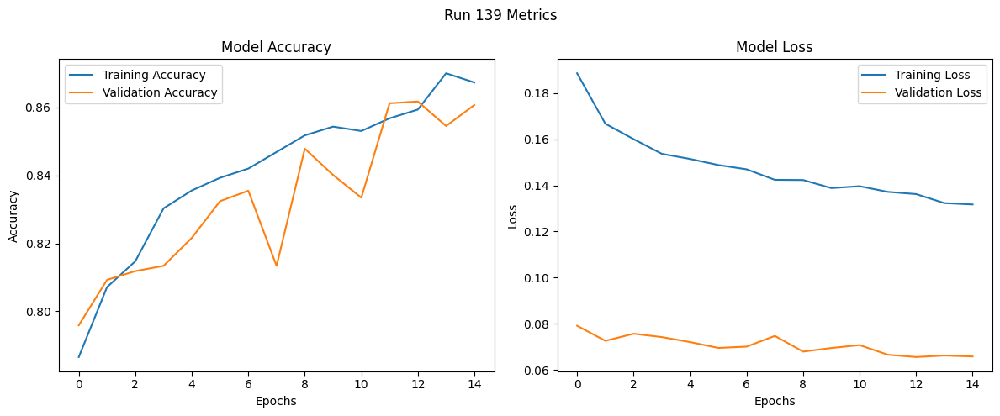

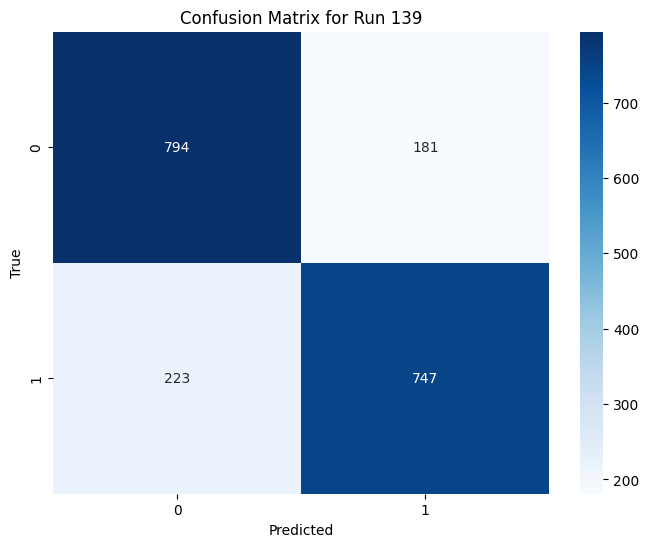

Run 140: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7555 - loss: 0.2098 - val_accuracy: 0.8000 - val_loss: 0.0770
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8084 - loss: 0.1666 - val_accuracy: 0.8021 - val_loss: 0.0755
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8129 - loss: 0.1618 - val_accuracy: 0.7887 - val_loss: 0.0819
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8227 - loss: 0.1589 - val_accuracy: 0.8175 - val_loss: 0.0734
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8291 - loss: 0.1550 - val_accuracy: 0.8231 - val_loss: 0.0739
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8414 - loss: 0.1489 - val_accuracy: 0.8123 - val_loss: 0.0756
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.83

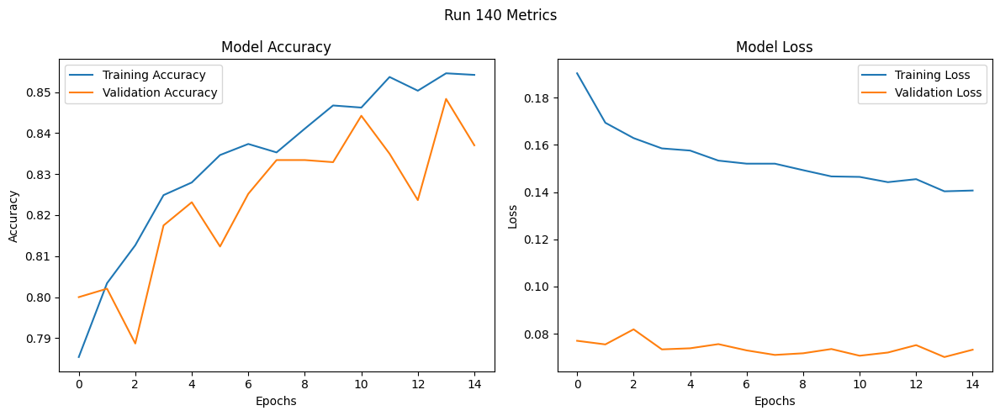

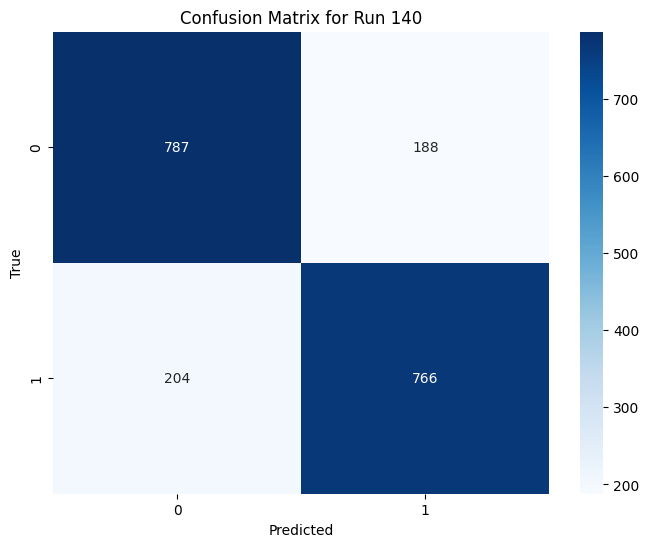

Run 141: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7547 - loss: 0.2091 - val_accuracy: 0.7943 - val_loss: 0.0804
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8068 - loss: 0.1687 - val_accuracy: 0.7820 - val_loss: 0.0780
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8139 - loss: 0.1646 - val_accuracy: 0.8031 - val_loss: 0.0758
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8190 - loss: 0.1638 - val_accuracy: 0.7748 - val_loss: 0.0869
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8143 - loss: 0.1635 - val_accuracy: 0.8057 - val_loss: 0.0778
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8248 - loss: 0.1575 - val_accuracy: 0.8257 - val_loss: 0.0741
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8295

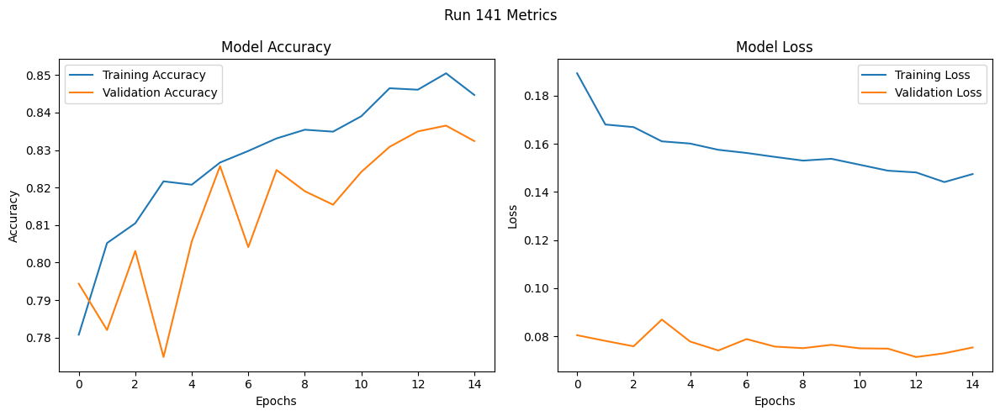

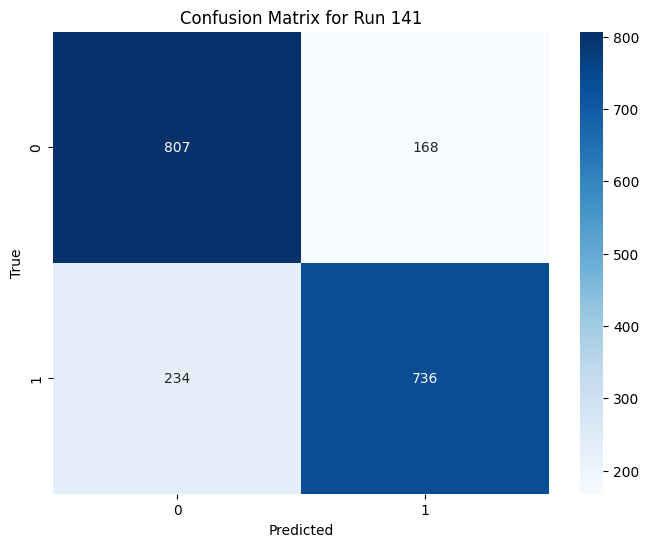

Run 142: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7648 - loss: 0.2874 - val_accuracy: 0.8051 - val_loss: 0.0802
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8026 - loss: 0.2388 - val_accuracy: 0.8098 - val_loss: 0.0758
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8275 - loss: 0.2234 - val_accuracy: 0.8221 - val_loss: 0.0725
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8225 - loss: 0.2196 - val_accuracy: 0.8231 - val_loss: 0.0736
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8423 - loss: 0.2040 - val_accuracy: 0.8252 - val_loss: 0.0732
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8351 - loss: 0.2039 - val_accuracy: 0.8350 - val_loss: 0.0708
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.849

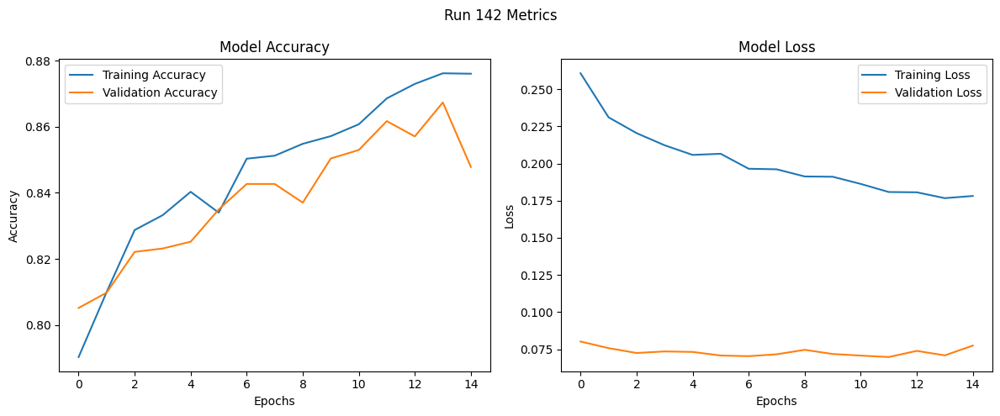

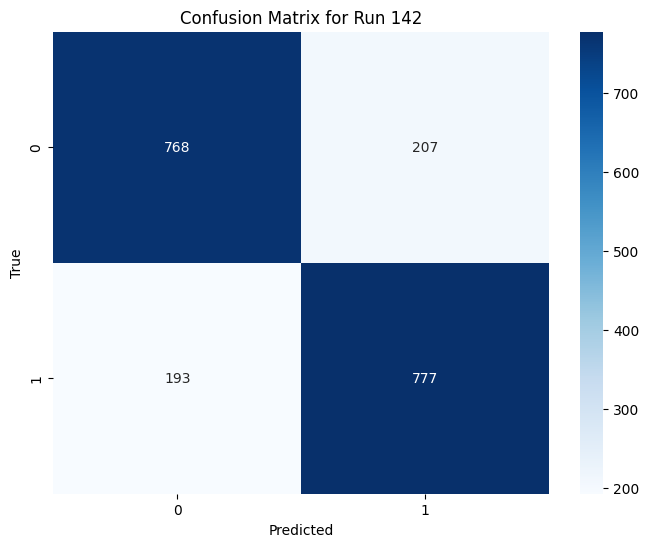

Run 143: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step - accuracy: 0.7586 - loss: 0.2842 - val_accuracy: 0.7990 - val_loss: 0.0793
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.8074 - loss: 0.2318 - val_accuracy: 0.8093 - val_loss: 0.0776
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8241 - loss: 0.2203 - val_accuracy: 0.8108 - val_loss: 0.0752
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8178 - loss: 0.2239 - val_accuracy: 0.8201 - val_loss: 0.0769
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8365 - loss: 0.2091 - val_accuracy: 0.8319 - val_loss: 0.0735
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8453 - loss: 0.2041 - val_accuracy: 0.8278 - val_loss: 0.0745
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8

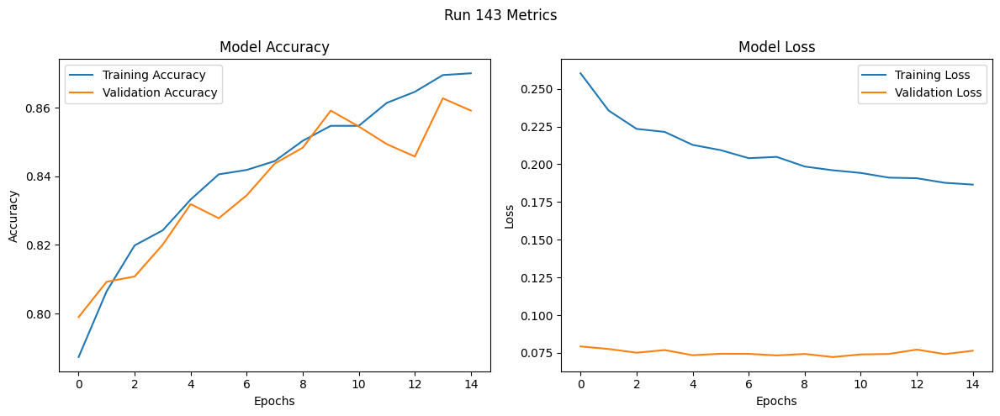

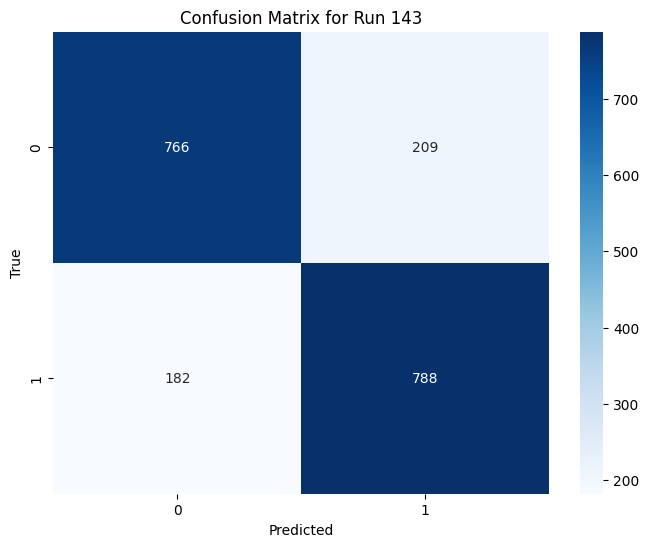

Run 144: L2: 0.0001, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7607 - loss: 0.2850 - val_accuracy: 0.7995 - val_loss: 0.0808
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8065 - loss: 0.2382 - val_accuracy: 0.8031 - val_loss: 0.0773
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8065 - loss: 0.2340 - val_accuracy: 0.7933 - val_loss: 0.0795
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8198 - loss: 0.2226 - val_accuracy: 0.8195 - val_loss: 0.0774
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8331 - loss: 0.2169 - val_accuracy: 0.8098 - val_loss: 0.0794
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8330 - loss: 0.2196 - val_accuracy: 0.8247 - val_loss: 0.0765
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.839

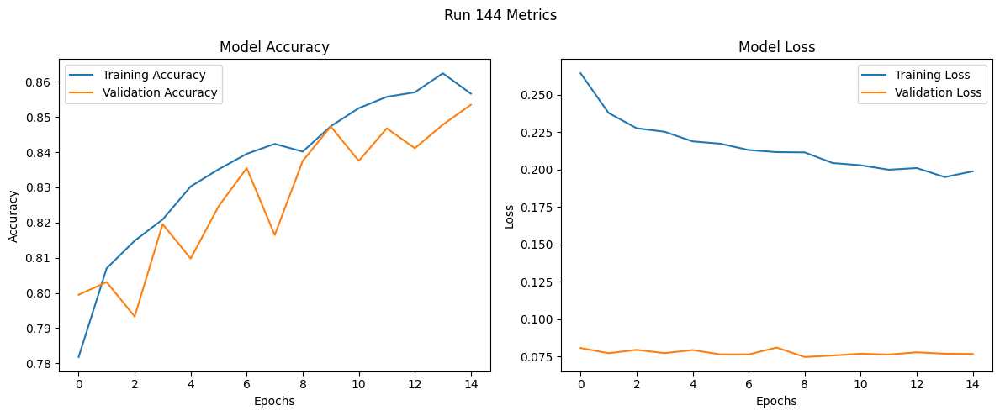

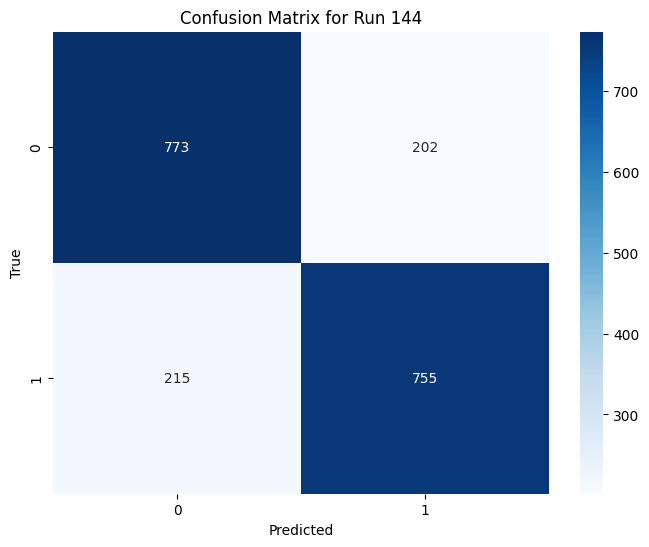

Run 145: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7343 - loss: 1.2509 - val_accuracy: 0.7794 - val_loss: 0.4788
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7944 - loss: 1.0738 - val_accuracy: 0.7964 - val_loss: 0.4438
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8137 - loss: 1.0420 - val_accuracy: 0.8067 - val_loss: 0.4169
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8134 - loss: 0.9923 - val_accuracy: 0.8129 - val_loss: 0.4086
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8199 - loss: 0.9595 - val_accuracy: 0.8324 - val_loss: 0.3796
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8332 - loss: 0.9111 - val_accuracy: 0.8195 - val_loss: 0.3944
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - a

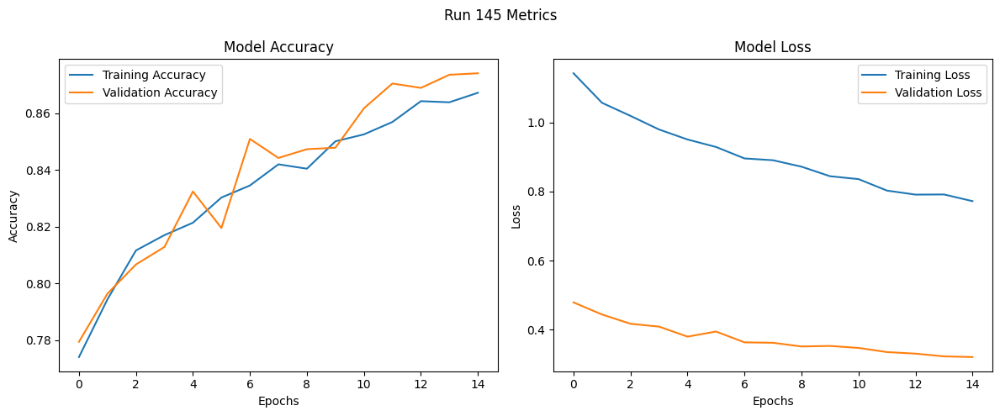

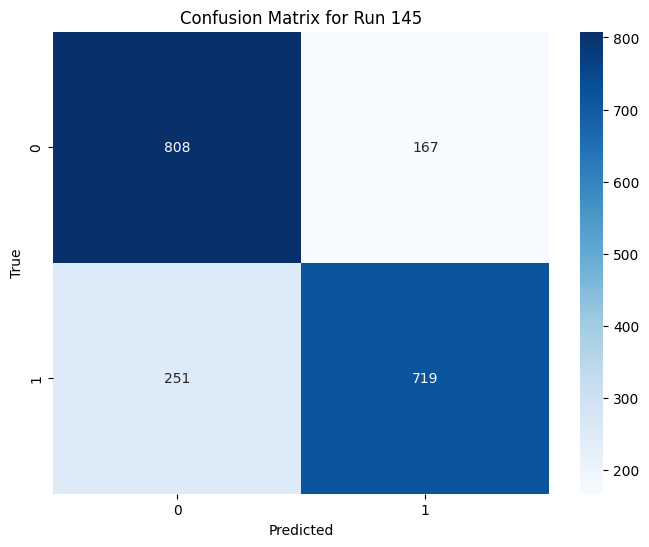

Run 146: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.7352 - loss: 1.2409 - val_accuracy: 0.7954 - val_loss: 0.4370
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8091 - loss: 1.0411 - val_accuracy: 0.7995 - val_loss: 0.4317
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8078 - loss: 1.0359 - val_accuracy: 0.8113 - val_loss: 0.4095
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8187 - loss: 0.9797 - val_accuracy: 0.8252 - val_loss: 0.3867
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8292 - loss: 0.9511 - val_accuracy: 0.8149 - val_loss: 0.3918
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8321 - loss: 0.9451 - val_accuracy: 0.8247 - val_loss: 0.3917
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - 

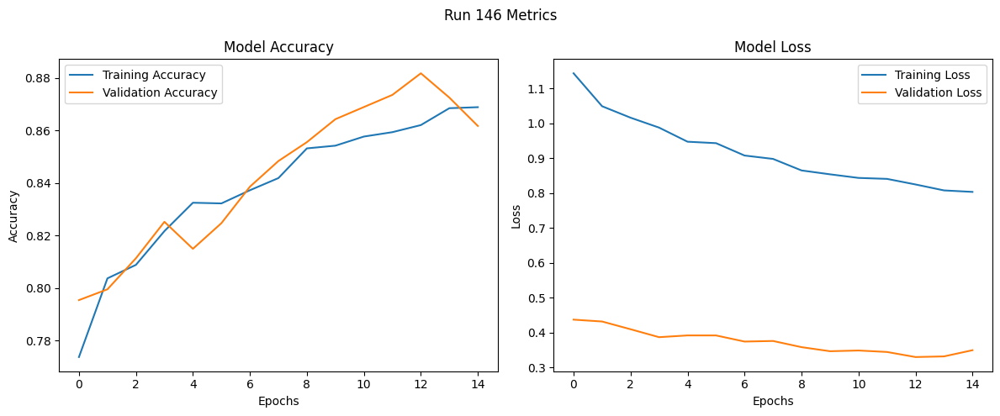

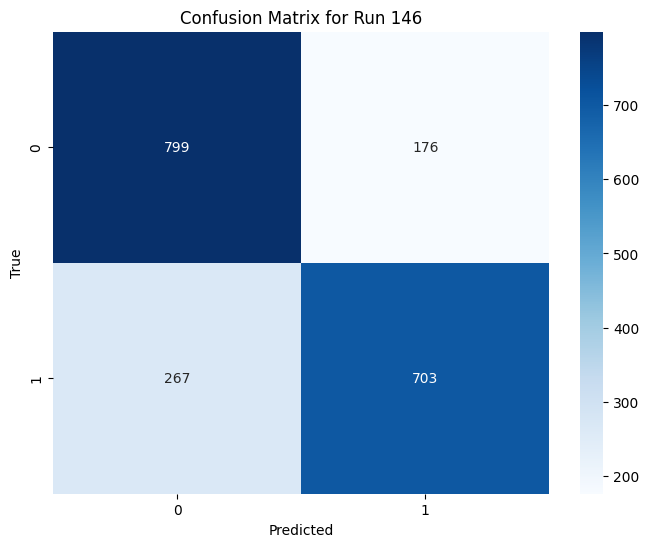

Run 147: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7263 - loss: 1.2605 - val_accuracy: 0.7943 - val_loss: 0.4388
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7930 - loss: 1.0808 - val_accuracy: 0.7959 - val_loss: 0.4444
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8009 - loss: 1.0292 - val_accuracy: 0.8087 - val_loss: 0.4156
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8133 - loss: 1.0036 - val_accuracy: 0.8144 - val_loss: 0.4111
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8225 - loss: 0.9613 - val_accuracy: 0.8195 - val_loss: 0.4050
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8258 - loss: 0.9606 - val_accuracy: 0.8231 - val_loss: 0.3896
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - ac

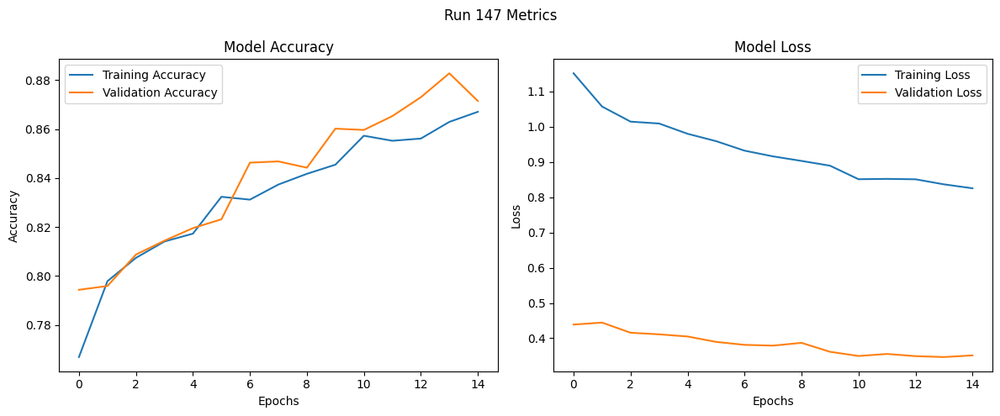

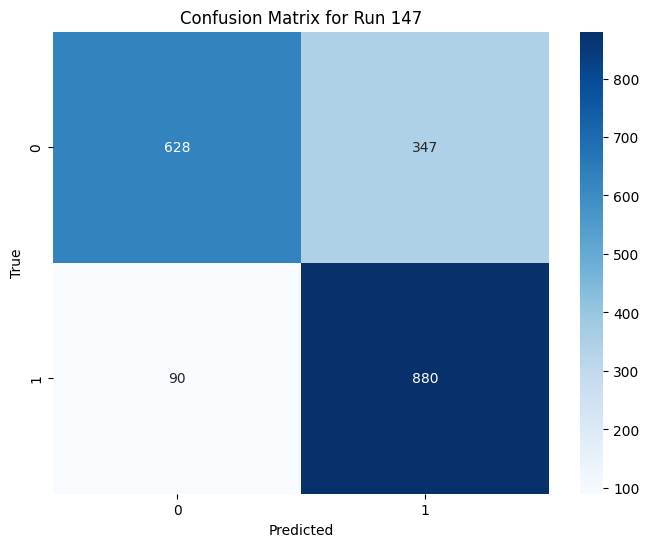

Run 148: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7416 - loss: 1.7987 - val_accuracy: 0.7969 - val_loss: 0.4406
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8024 - loss: 1.4867 - val_accuracy: 0.8134 - val_loss: 0.4174
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8031 - loss: 1.4675 - val_accuracy: 0.8175 - val_loss: 0.4039
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8178 - loss: 1.3930 - val_accuracy: 0.8123 - val_loss: 0.3996
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8357 - loss: 1.2910 - val_accuracy: 0.8298 - val_loss: 0.3660
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8385 - loss: 1.2685 - val_accuracy: 0.8344 - val_loss: 0.3694
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - a

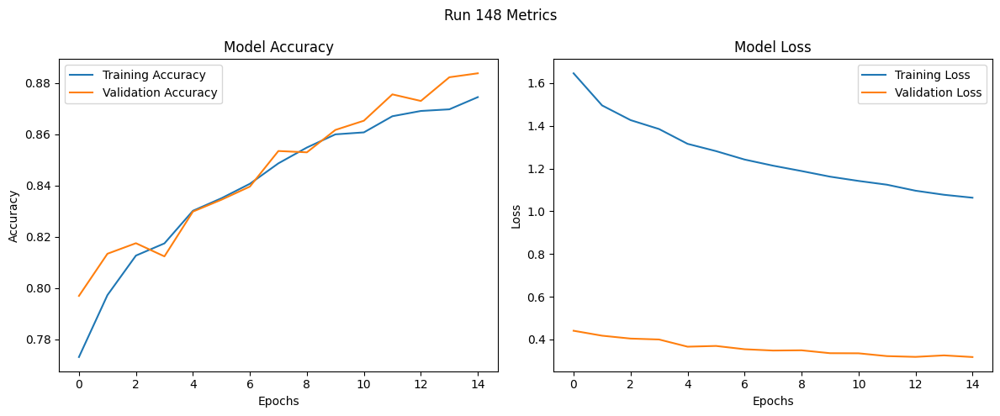

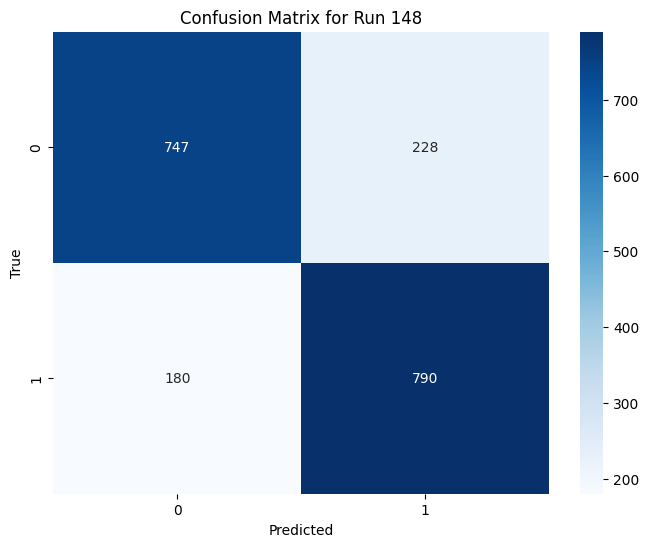

Run 149: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 12s 9ms/step - accuracy: 0.7510 - loss: 1.7452 - val_accuracy: 0.7676 - val_loss: 0.4834
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7907 - loss: 1.5458 - val_accuracy: 0.8087 - val_loss: 0.4222
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8059 - loss: 1.4749 - val_accuracy: 0.8159 - val_loss: 0.4054
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8074 - loss: 1.4063 - val_accuracy: 0.8195 - val_loss: 0.4046
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8185 - loss: 1.3490 - val_accuracy: 0.8139 - val_loss: 0.4045
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8239 - loss: 1.3446 - val_accuracy: 0.8339 - val_loss: 0.3774
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step -

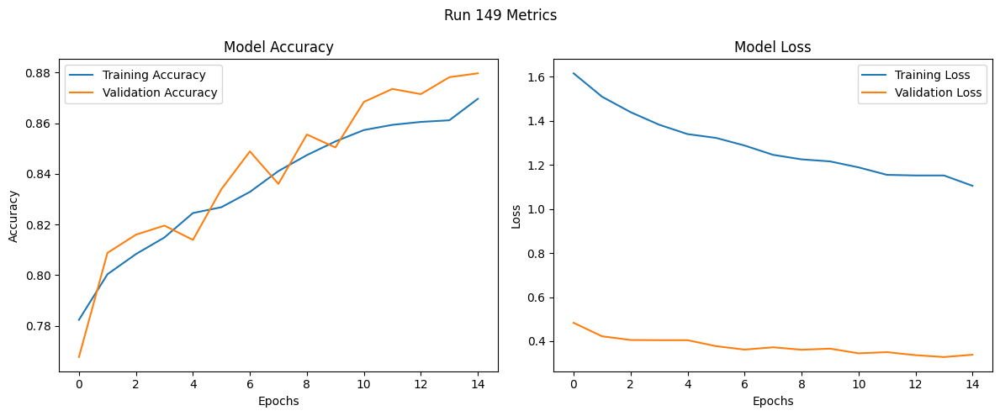

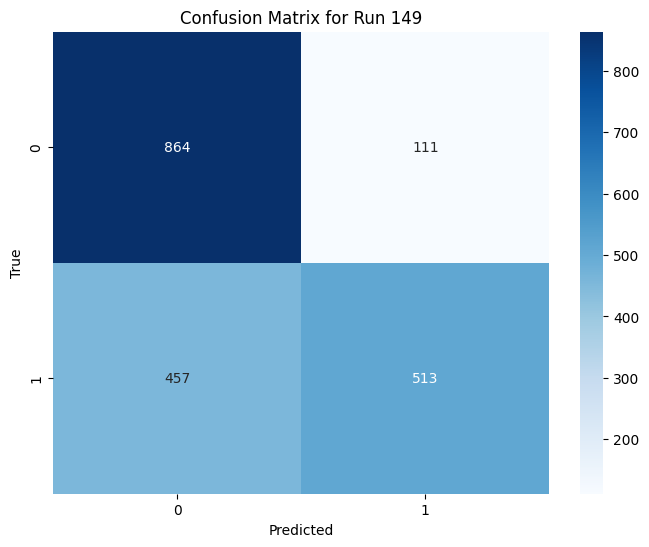

Run 150: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7430 - loss: 1.7551 - val_accuracy: 0.8000 - val_loss: 0.4300
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8059 - loss: 1.4575 - val_accuracy: 0.7974 - val_loss: 0.4348
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8122 - loss: 1.4521 - val_accuracy: 0.8149 - val_loss: 0.4180
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8239 - loss: 1.3830 - val_accuracy: 0.8154 - val_loss: 0.4171
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8320 - loss: 1.3424 - val_accuracy: 0.8278 - val_loss: 0.3875
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8333 - loss: 1.3047 - val_accuracy: 0.8339 - val_loss: 0.3958
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - ac

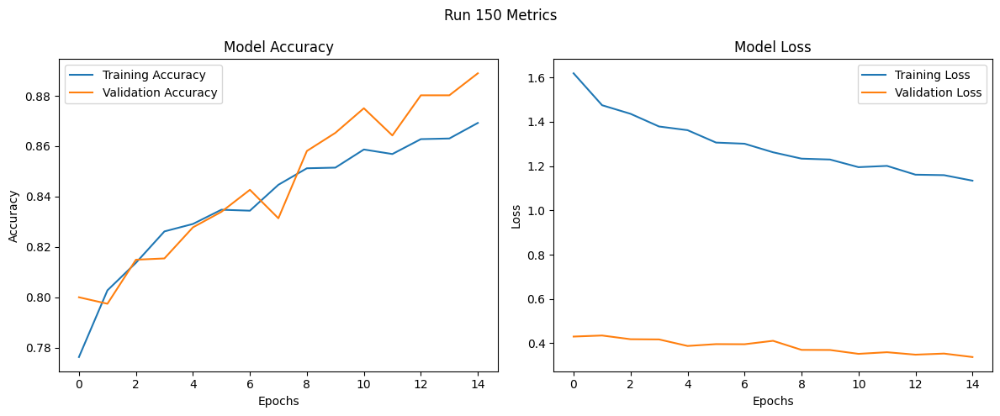

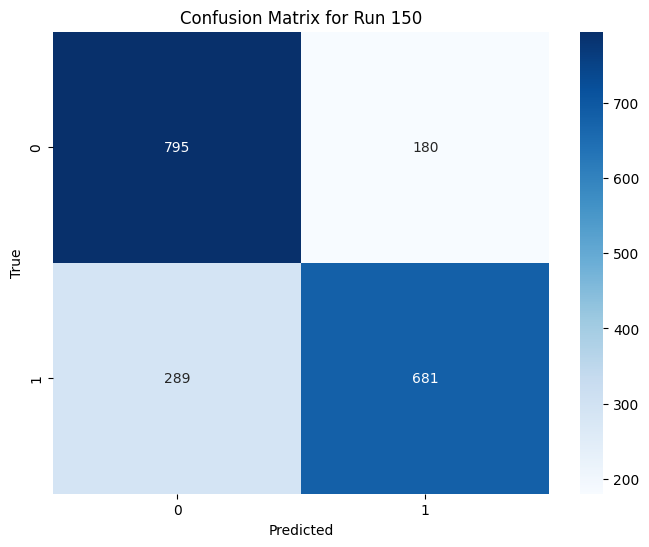

Run 151: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7265 - loss: 1.2717 - val_accuracy: 0.7820 - val_loss: 0.4684
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8010 - loss: 1.0732 - val_accuracy: 0.8021 - val_loss: 0.4269
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8081 - loss: 1.0189 - val_accuracy: 0.7928 - val_loss: 0.4297
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8087 - loss: 0.9844 - val_accuracy: 0.7995 - val_loss: 0.4133
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8173 - loss: 0.9501 - val_accuracy: 0.7882 - val_loss: 0.4323
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8162 - loss: 0.9540 - val_accuracy: 0.8350 - val_loss: 0.3746
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - 

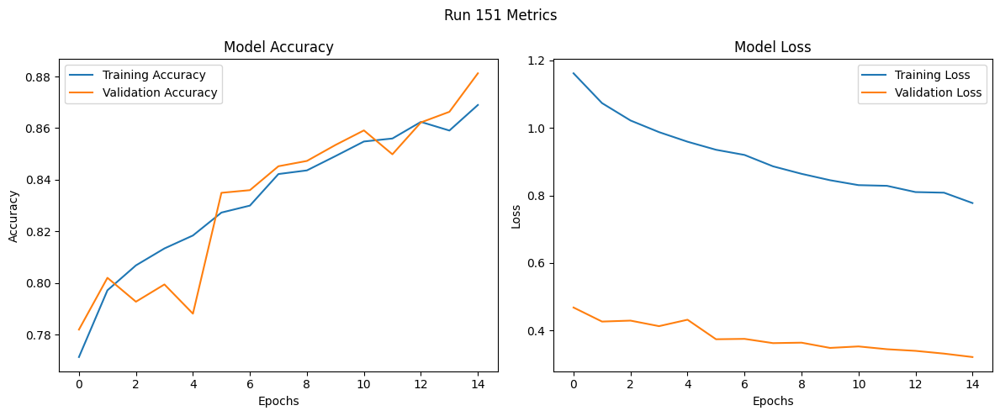

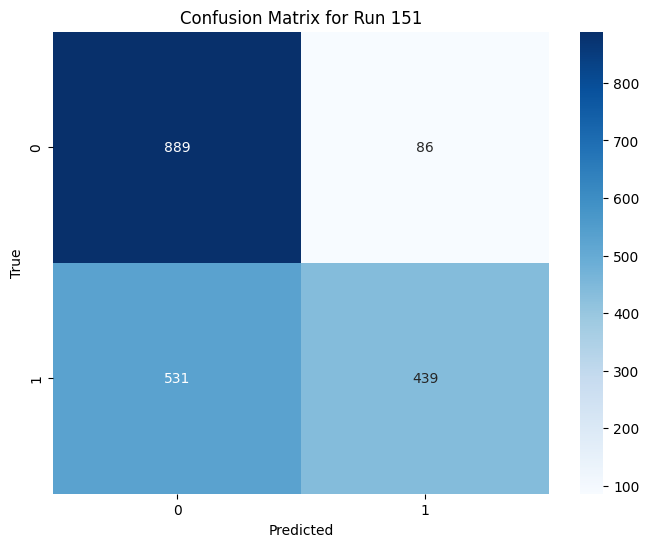

Run 152: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7287 - loss: 1.2728 - val_accuracy: 0.7702 - val_loss: 0.4642
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7954 - loss: 1.0589 - val_accuracy: 0.8046 - val_loss: 0.4256
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8111 - loss: 1.0218 - val_accuracy: 0.7851 - val_loss: 0.4387
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8198 - loss: 0.9595 - val_accuracy: 0.8216 - val_loss: 0.4097
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8190 - loss: 0.9706 - val_accuracy: 0.8278 - val_loss: 0.3854
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8313 - loss: 0.9201 - val_accuracy: 0.8231 - val_loss: 0.3959
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step -

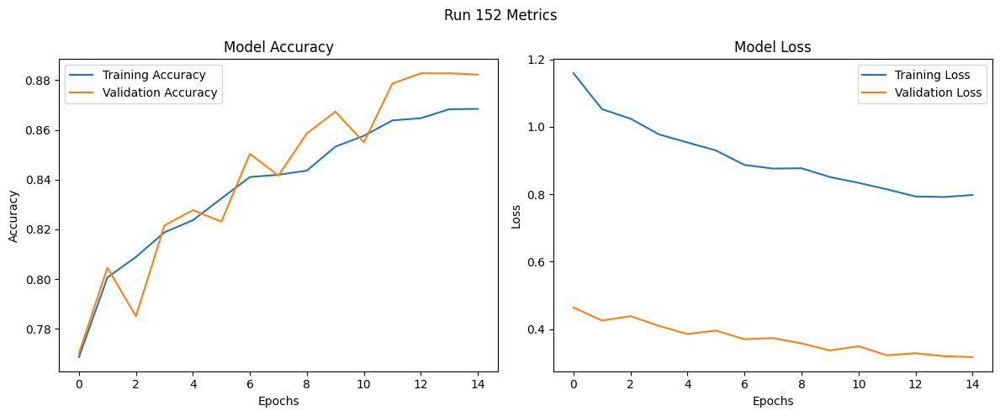

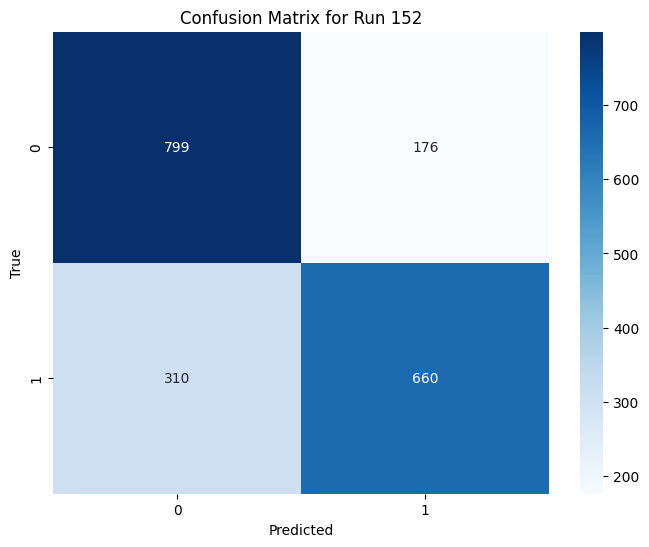

Run 153: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.7400 - loss: 1.2372 - val_accuracy: 0.7979 - val_loss: 0.4644
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7881 - loss: 1.0843 - val_accuracy: 0.8072 - val_loss: 0.4258
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8077 - loss: 1.0186 - val_accuracy: 0.8041 - val_loss: 0.4406
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8161 - loss: 0.9944 - val_accuracy: 0.8247 - val_loss: 0.4078
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8252 - loss: 0.9596 - val_accuracy: 0.8319 - val_loss: 0.3966
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8247 - loss: 0.9695 - val_accuracy: 0.8303 - val_loss: 0.3862
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - a

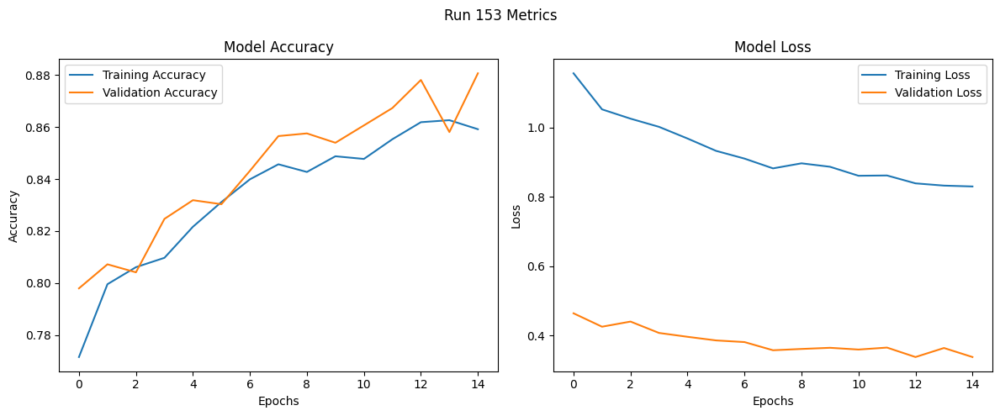

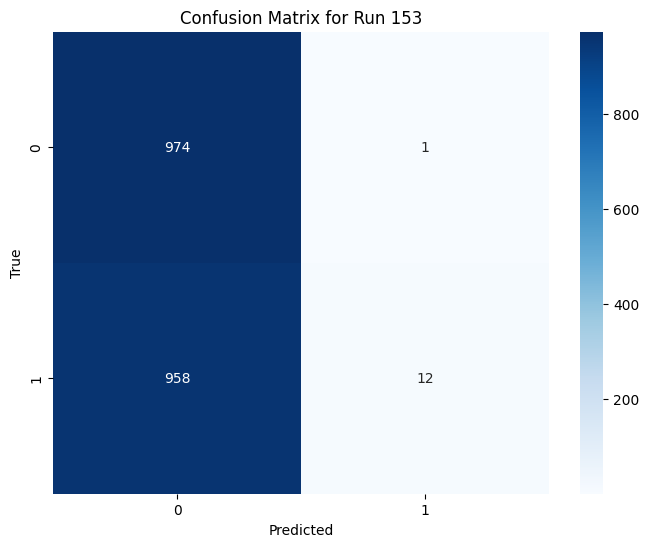

Run 154: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7340 - loss: 1.7645 - val_accuracy: 0.7907 - val_loss: 0.4418
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7942 - loss: 1.5134 - val_accuracy: 0.8015 - val_loss: 0.4266
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8090 - loss: 1.3972 - val_accuracy: 0.8170 - val_loss: 0.4137
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8187 - loss: 1.3818 - val_accuracy: 0.8129 - val_loss: 0.3978
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8251 - loss: 1.3451 - val_accuracy: 0.8267 - val_loss: 0.3881
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8447 - loss: 1.2633 - val_accuracy: 0.8247 - val_loss: 0.3782
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - 

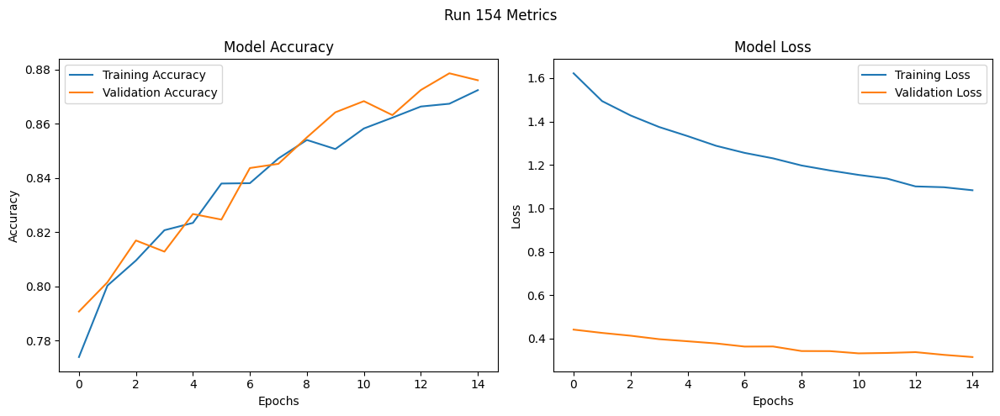

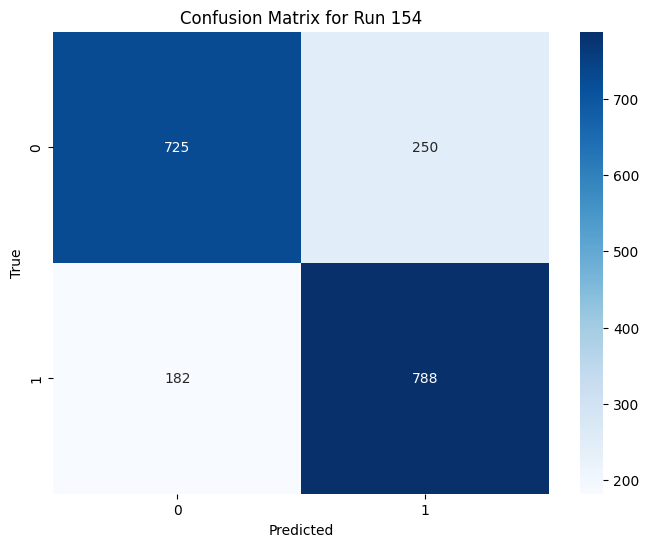

Run 155: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7327 - loss: 1.7621 - val_accuracy: 0.8000 - val_loss: 0.4359
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8070 - loss: 1.4649 - val_accuracy: 0.7990 - val_loss: 0.4232
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8090 - loss: 1.4252 - val_accuracy: 0.8139 - val_loss: 0.4121
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8215 - loss: 1.3715 - val_accuracy: 0.8046 - val_loss: 0.4084
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8154 - loss: 1.3793 - val_accuracy: 0.8278 - val_loss: 0.3967
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8288 - loss: 1.3097 - val_accuracy: 0.8293 - val_loss: 0.3808
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step -

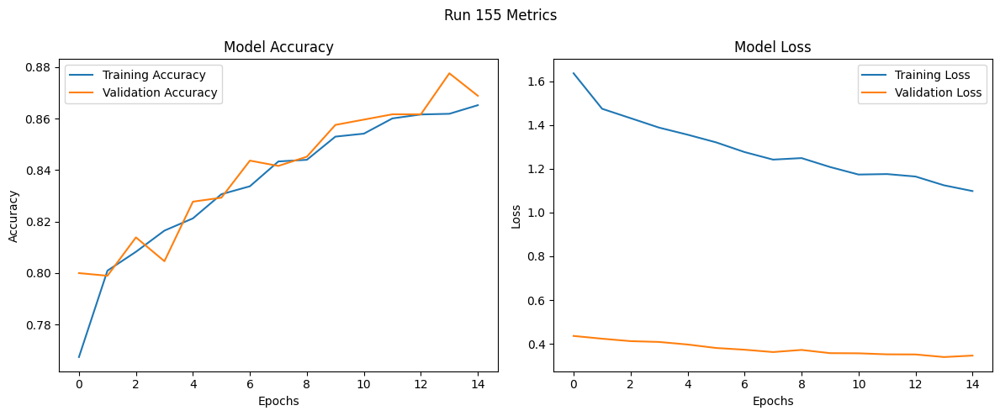

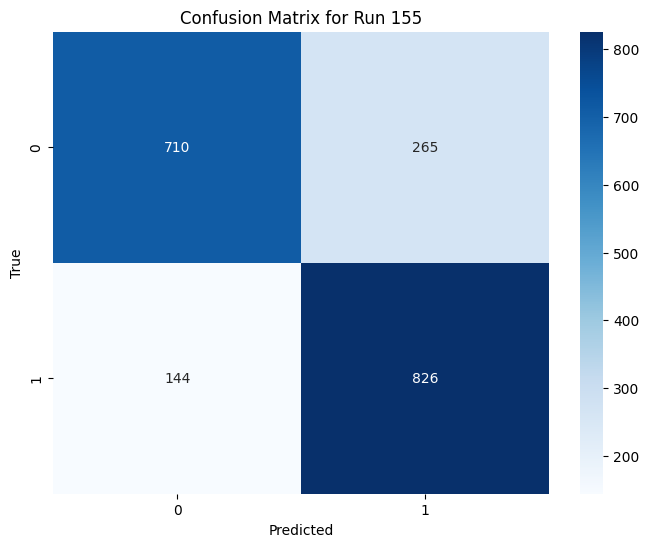

Run 156: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7692 - loss: 1.6750 - val_accuracy: 0.7861 - val_loss: 0.4431
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7988 - loss: 1.5284 - val_accuracy: 0.8139 - val_loss: 0.4287
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8033 - loss: 1.4865 - val_accuracy: 0.8046 - val_loss: 0.4301
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8135 - loss: 1.4484 - val_accuracy: 0.8190 - val_loss: 0.4105
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8351 - loss: 1.3399 - val_accuracy: 0.8144 - val_loss: 0.4142
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8322 - loss: 1.3193 - val_accuracy: 0.8416 - val_loss: 0.3761
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - a

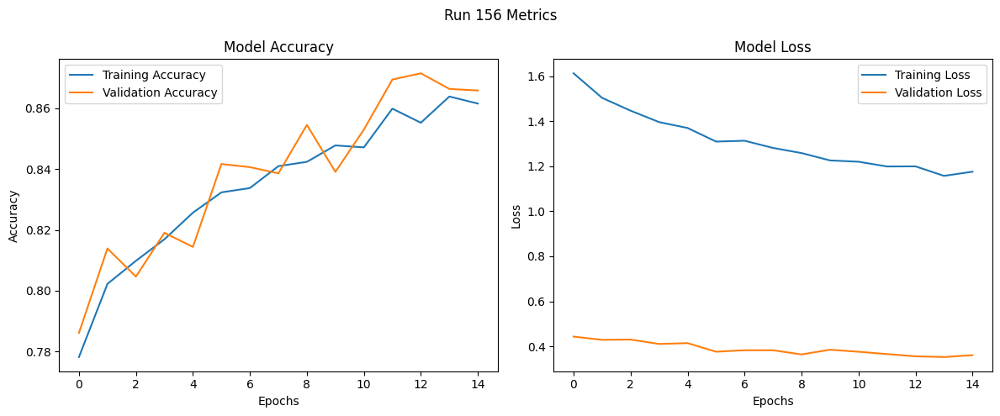

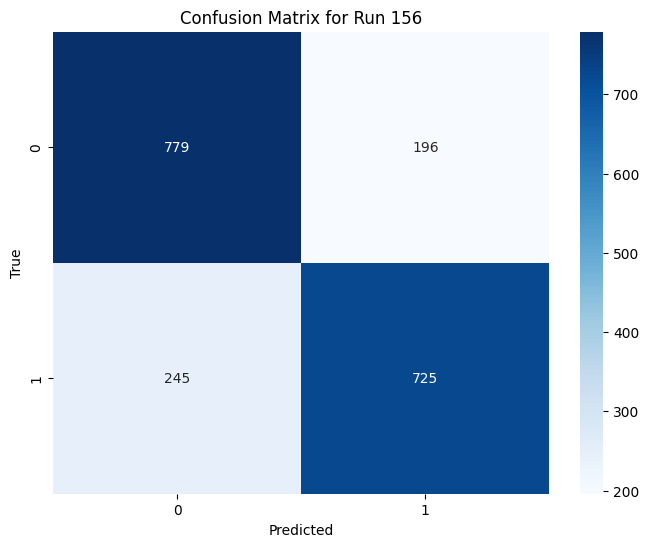

Run 157: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7211 - loss: 0.4360 - val_accuracy: 0.7923 - val_loss: 0.1529
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8038 - loss: 0.3526 - val_accuracy: 0.8046 - val_loss: 0.1449
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8160 - loss: 0.3340 - val_accuracy: 0.8149 - val_loss: 0.1420
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8309 - loss: 0.3090 - val_accuracy: 0.8206 - val_loss: 0.1359
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8324 - loss: 0.3089 - val_accuracy: 0.8237 - val_loss: 0.1355
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8291 - loss: 0.3110 - val_accuracy: 0.8221 - val_loss: 0.1382
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accurac

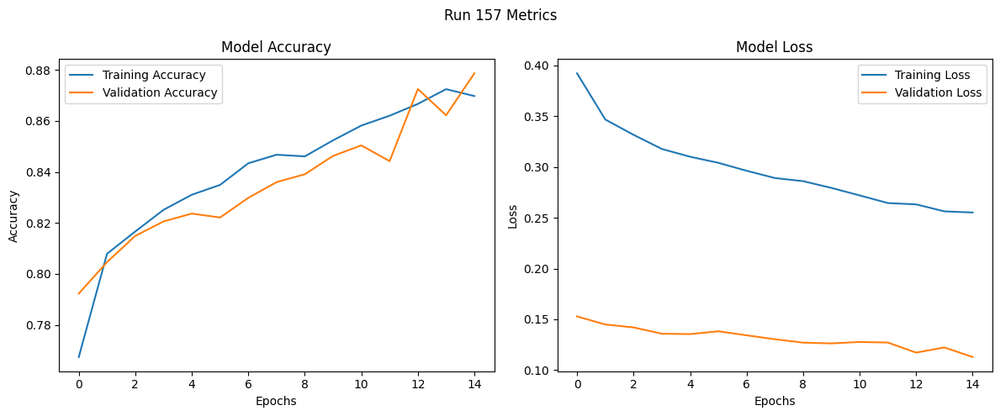

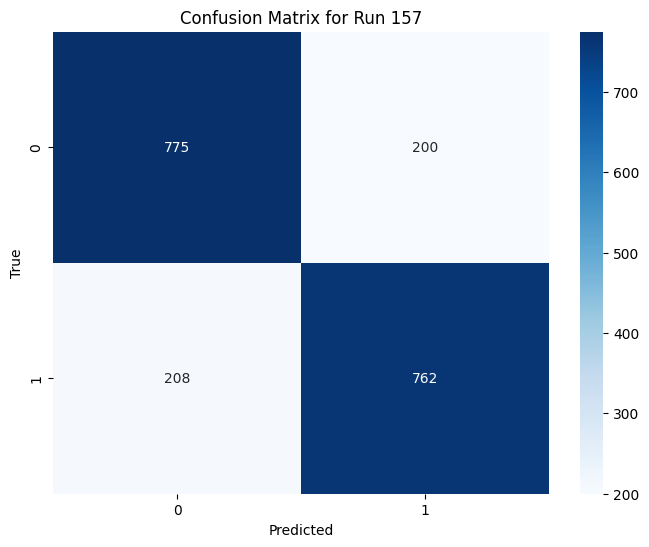

Run 158: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.7469 - loss: 0.4226 - val_accuracy: 0.7820 - val_loss: 0.1560
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7971 - loss: 0.3482 - val_accuracy: 0.7979 - val_loss: 0.1498
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8075 - loss: 0.3402 - val_accuracy: 0.8046 - val_loss: 0.1450
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8229 - loss: 0.3170 - val_accuracy: 0.8272 - val_loss: 0.1392
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8287 - loss: 0.3216 - val_accuracy: 0.8303 - val_loss: 0.1370
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8489 - loss: 0.2962 - val_accuracy: 0.8165 - val_loss: 0.1485
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accura

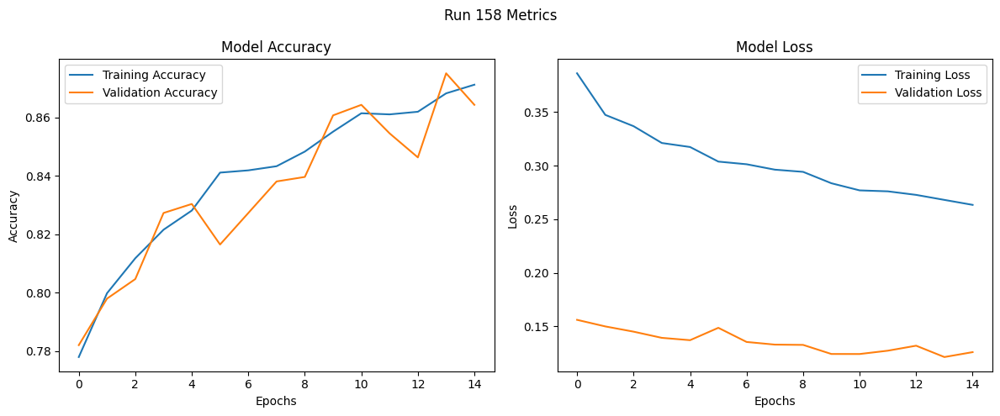

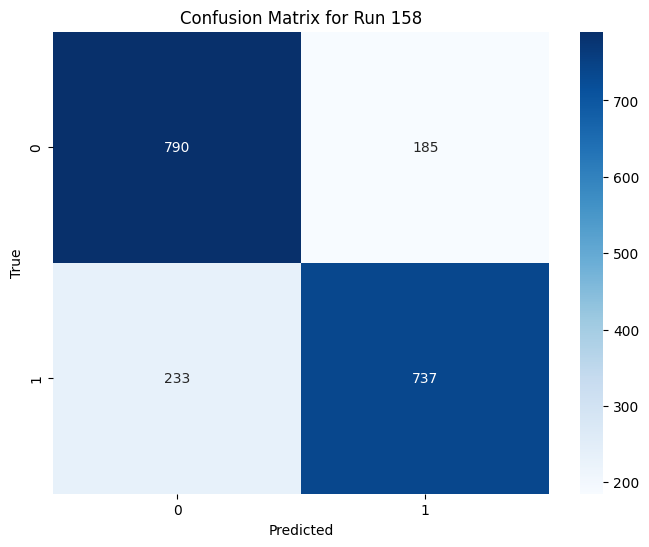

Run 159: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7600 - loss: 0.4203 - val_accuracy: 0.7938 - val_loss: 0.1495
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8044 - loss: 0.3560 - val_accuracy: 0.8051 - val_loss: 0.1470
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8229 - loss: 0.3257 - val_accuracy: 0.8108 - val_loss: 0.1462
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8136 - loss: 0.3367 - val_accuracy: 0.8226 - val_loss: 0.1398
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8309 - loss: 0.3181 - val_accuracy: 0.8206 - val_loss: 0.1428
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8408 - loss: 0.3032 - val_accuracy: 0.8339 - val_loss: 0.1331
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy

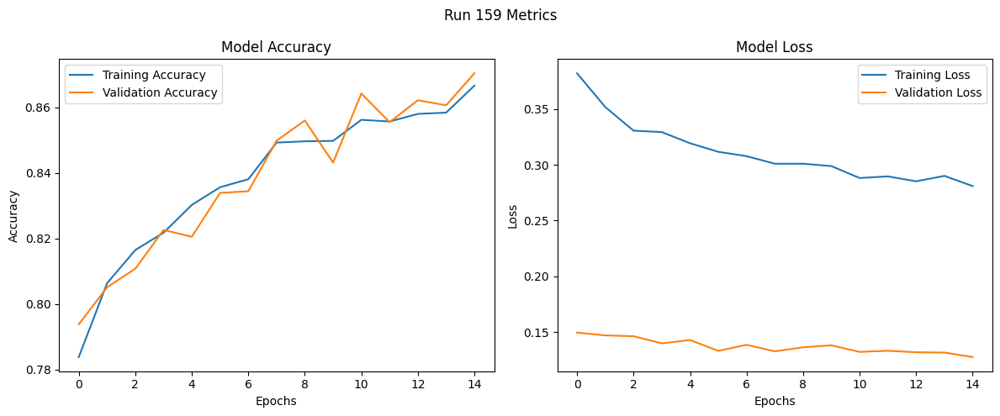

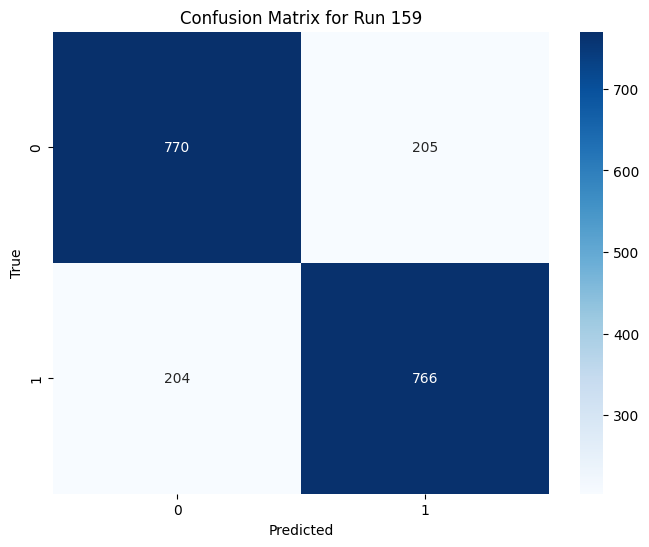

Run 160: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7445 - loss: 0.6114 - val_accuracy: 0.8010 - val_loss: 0.1466
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8027 - loss: 0.5000 - val_accuracy: 0.8072 - val_loss: 0.1453
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8120 - loss: 0.4711 - val_accuracy: 0.8190 - val_loss: 0.1389
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8276 - loss: 0.4570 - val_accuracy: 0.8231 - val_loss: 0.1351
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8368 - loss: 0.4312 - val_accuracy: 0.8257 - val_loss: 0.1351
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8341 - loss: 0.4253 - val_accuracy: 0.8293 - val_loss: 0.1364
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accurac

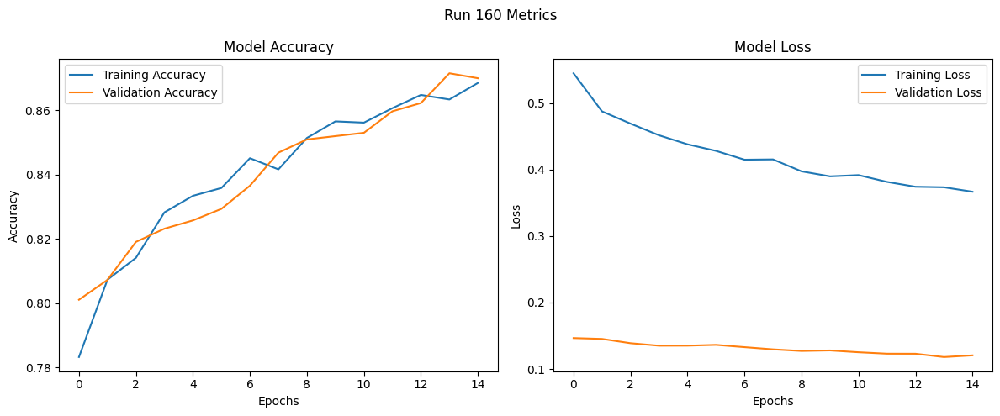

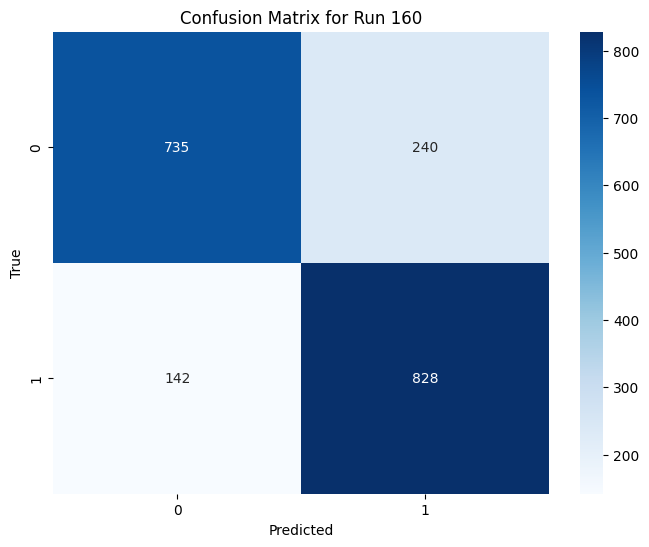

Run 161: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7482 - loss: 0.5922 - val_accuracy: 0.8000 - val_loss: 0.1514
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8085 - loss: 0.4847 - val_accuracy: 0.8159 - val_loss: 0.1423
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8121 - loss: 0.4742 - val_accuracy: 0.8087 - val_loss: 0.1402
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8232 - loss: 0.4589 - val_accuracy: 0.8072 - val_loss: 0.1466
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8358 - loss: 0.4335 - val_accuracy: 0.8180 - val_loss: 0.1403
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8354 - loss: 0.4354 - val_accuracy: 0.8396 - val_loss: 0.1329
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accura

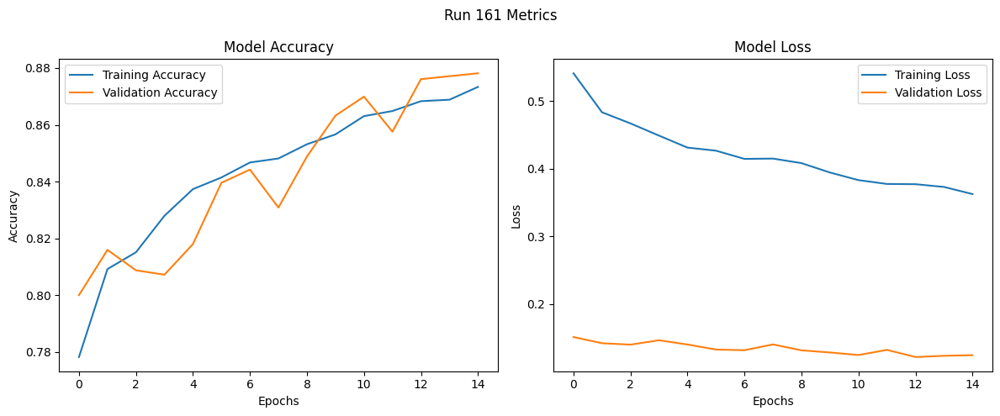

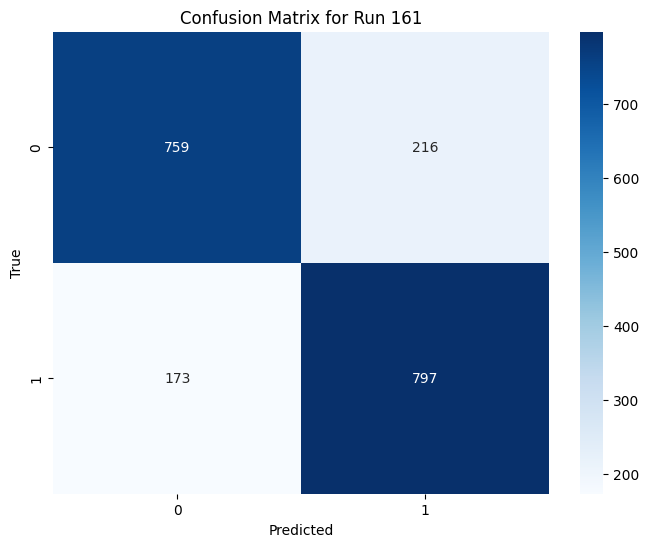

Run 162: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7698 - loss: 0.5691 - val_accuracy: 0.8051 - val_loss: 0.1469
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8055 - loss: 0.4853 - val_accuracy: 0.8129 - val_loss: 0.1449
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8180 - loss: 0.4736 - val_accuracy: 0.8247 - val_loss: 0.1420
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8277 - loss: 0.4471 - val_accuracy: 0.8211 - val_loss: 0.1427
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8258 - loss: 0.4566 - val_accuracy: 0.8221 - val_loss: 0.1430
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8333 - loss: 0.4418 - val_accuracy: 0.8303 - val_loss: 0.1387
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy

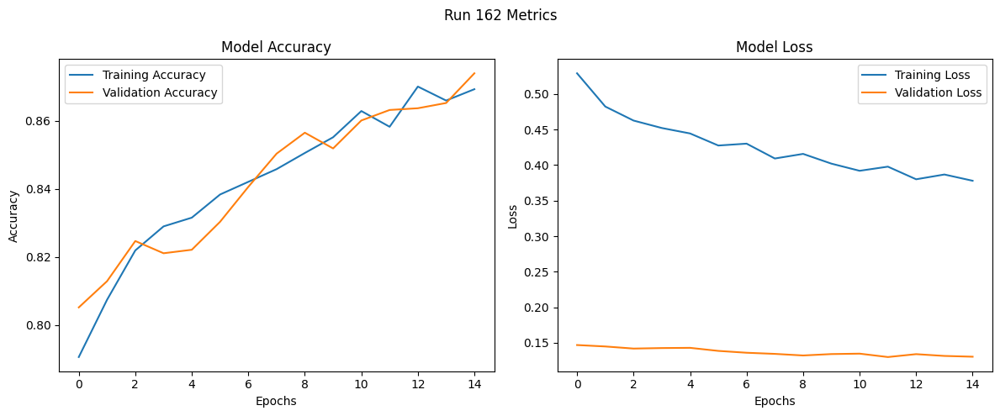

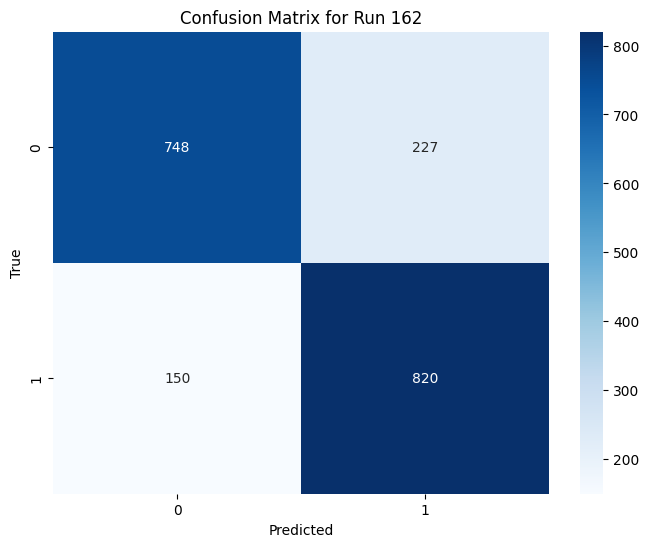

Run 163: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.7493 - loss: 0.4263 - val_accuracy: 0.7964 - val_loss: 0.1503
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7968 - loss: 0.3542 - val_accuracy: 0.8051 - val_loss: 0.1450
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8127 - loss: 0.3307 - val_accuracy: 0.8082 - val_loss: 0.1417
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8286 - loss: 0.3174 - val_accuracy: 0.8154 - val_loss: 0.1432
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8313 - loss: 0.3122 - val_accuracy: 0.8303 - val_loss: 0.1326
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8394 - loss: 0.2940 - val_accuracy: 0.8242 - val_loss: 0.1333
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accura

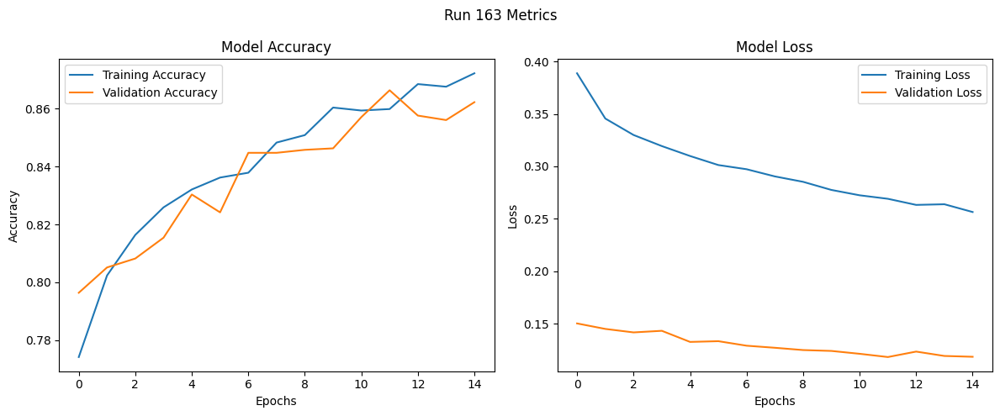

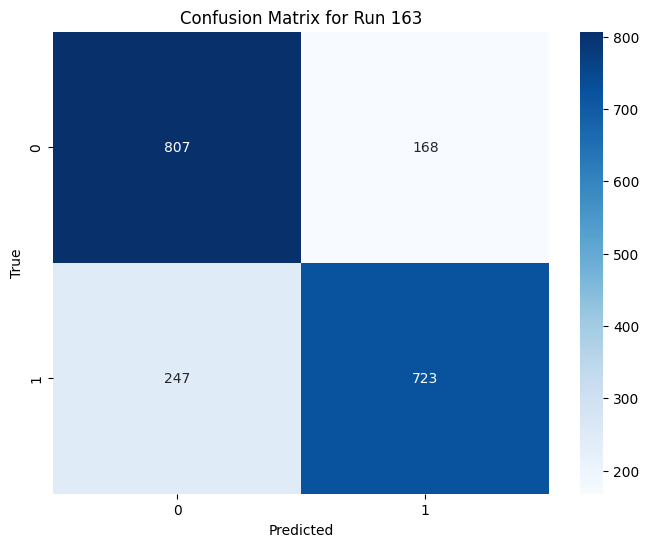

Run 164: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7469 - loss: 0.4281 - val_accuracy: 0.7943 - val_loss: 0.1532
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7978 - loss: 0.3576 - val_accuracy: 0.7990 - val_loss: 0.1470
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8233 - loss: 0.3290 - val_accuracy: 0.8082 - val_loss: 0.1431
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8275 - loss: 0.3181 - val_accuracy: 0.8036 - val_loss: 0.1442
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8269 - loss: 0.3163 - val_accuracy: 0.8175 - val_loss: 0.1386
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8335 - loss: 0.3065 - val_accuracy: 0.8144 - val_loss: 0.1417
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accur

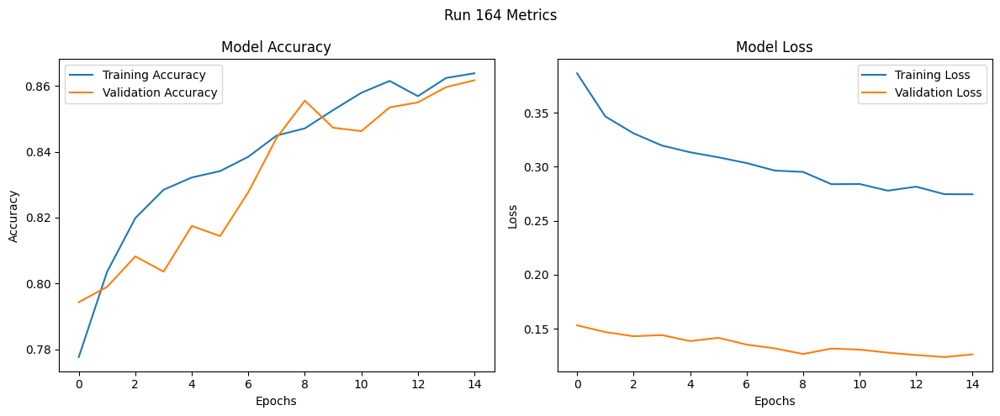

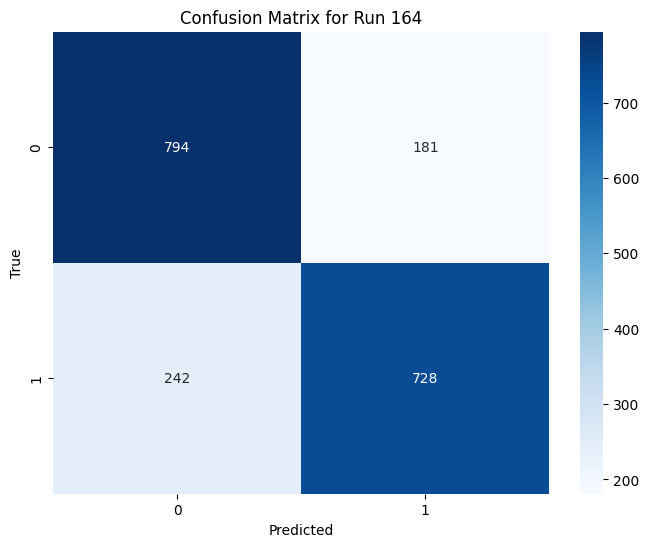

Run 165: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7470 - loss: 0.4182 - val_accuracy: 0.7774 - val_loss: 0.1632
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7925 - loss: 0.3568 - val_accuracy: 0.7851 - val_loss: 0.1592
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8127 - loss: 0.3412 - val_accuracy: 0.8057 - val_loss: 0.1473
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8209 - loss: 0.3297 - val_accuracy: 0.8118 - val_loss: 0.1510
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8341 - loss: 0.3167 - val_accuracy: 0.8267 - val_loss: 0.1411
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8333 - loss: 0.3166 - val_accuracy: 0.8216 - val_loss: 0.1405
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accurac

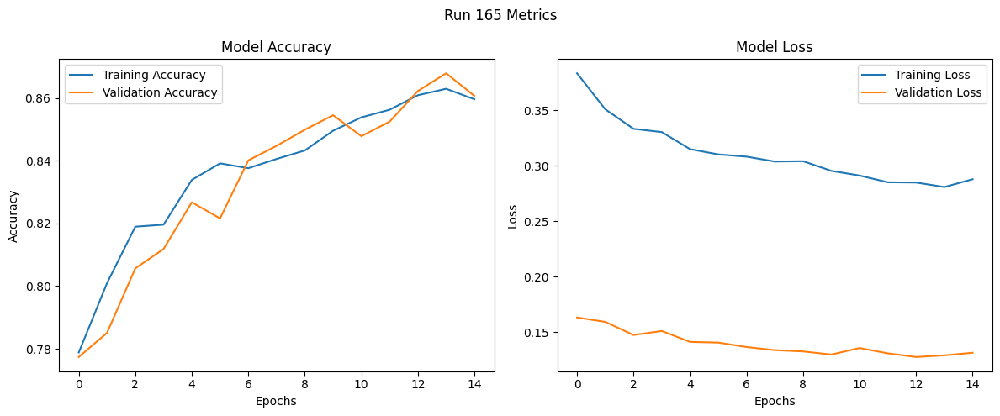

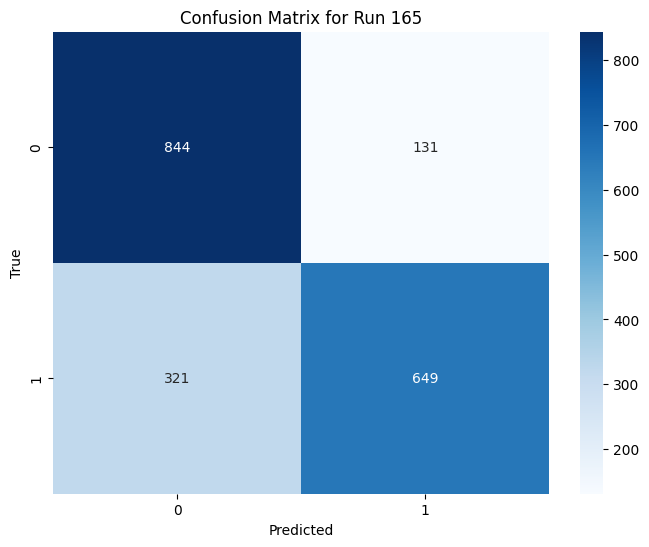

Run 166: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7310 - loss: 0.6109 - val_accuracy: 0.7959 - val_loss: 0.1491
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7980 - loss: 0.4998 - val_accuracy: 0.7985 - val_loss: 0.1472
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8162 - loss: 0.4650 - val_accuracy: 0.8129 - val_loss: 0.1399
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8173 - loss: 0.4632 - val_accuracy: 0.8221 - val_loss: 0.1393
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8374 - loss: 0.4319 - val_accuracy: 0.8082 - val_loss: 0.1466
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8377 - loss: 0.4273 - val_accuracy: 0.8344 - val_loss: 0.1311
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accura

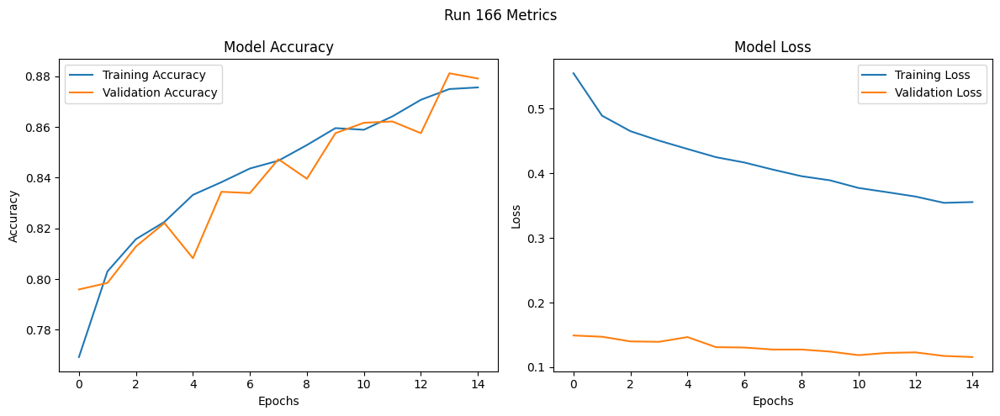

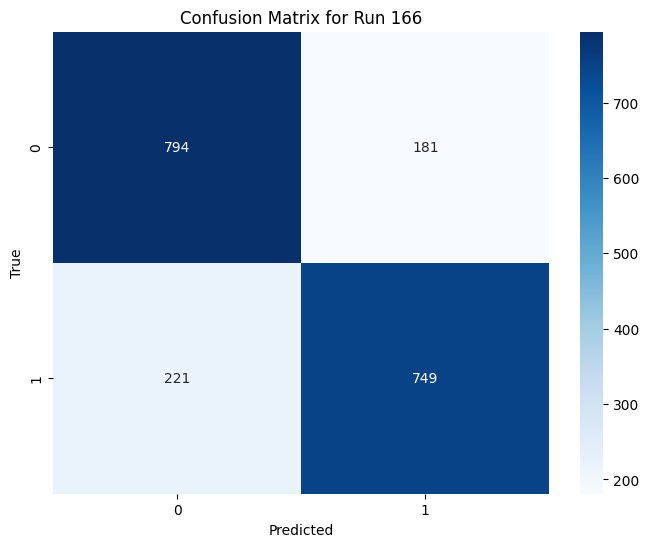

Run 167: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.7471 - loss: 0.5987 - val_accuracy: 0.7902 - val_loss: 0.1493
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8129 - loss: 0.4769 - val_accuracy: 0.8098 - val_loss: 0.1457
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8186 - loss: 0.4659 - val_accuracy: 0.7995 - val_loss: 0.1450
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8239 - loss: 0.4458 - val_accuracy: 0.8267 - val_loss: 0.1354
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8323 - loss: 0.4325 - val_accuracy: 0.8170 - val_loss: 0.1440
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8368 - loss: 0.4181 - val_accuracy: 0.8355 - val_loss: 0.1383
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accur

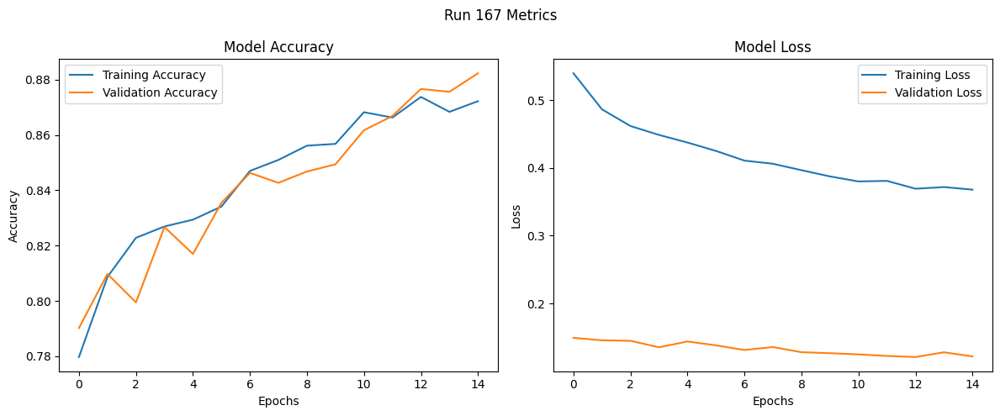

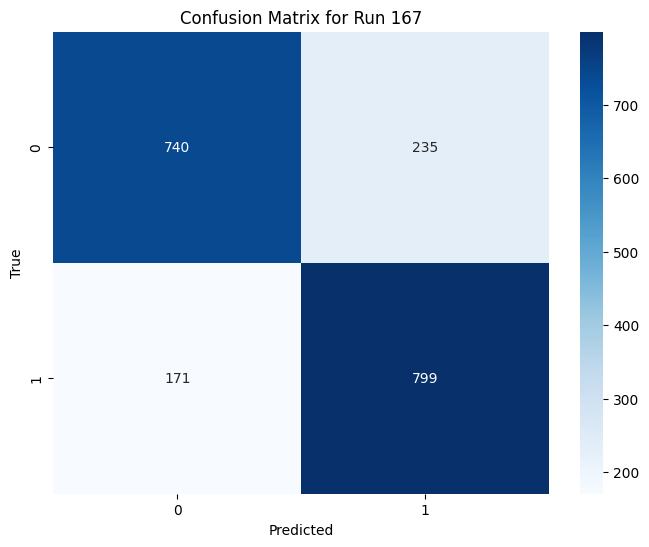

Run 168: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7653 - loss: 0.5787 - val_accuracy: 0.7928 - val_loss: 0.1501
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7977 - loss: 0.4920 - val_accuracy: 0.8057 - val_loss: 0.1454
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8222 - loss: 0.4551 - val_accuracy: 0.8190 - val_loss: 0.1414
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8228 - loss: 0.4666 - val_accuracy: 0.8252 - val_loss: 0.1378
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8311 - loss: 0.4408 - val_accuracy: 0.8406 - val_loss: 0.1373
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8353 - loss: 0.4348 - val_accuracy: 0.8262 - val_loss: 0.1423
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accurac

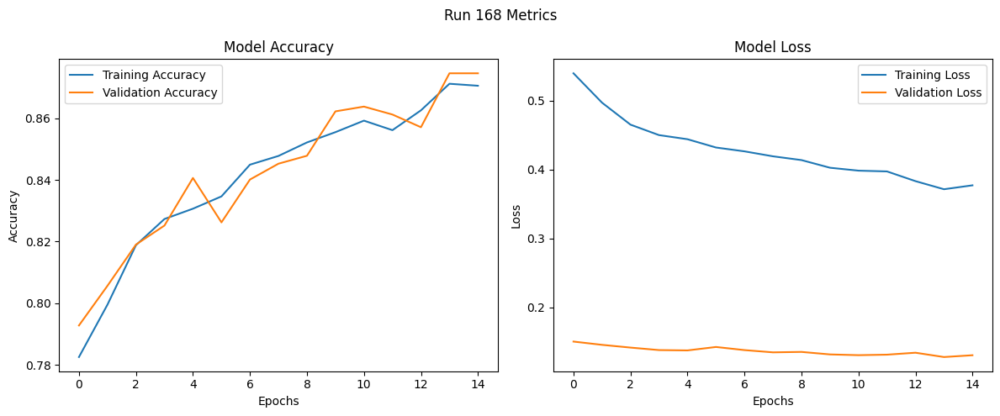

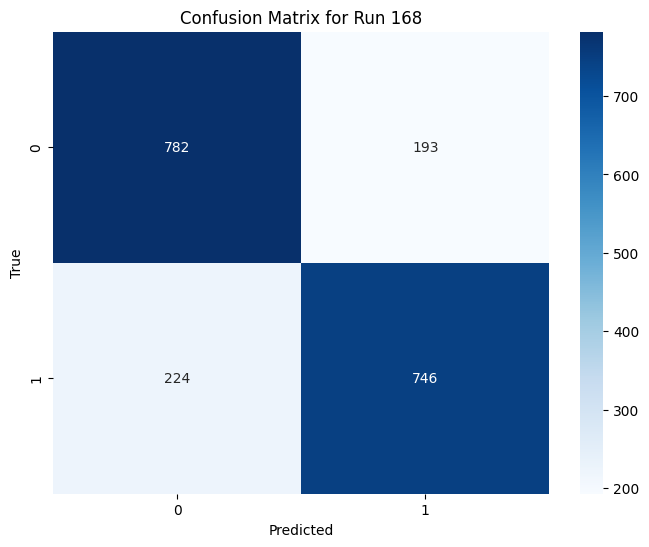

Run 169: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7307 - loss: 0.2090 - val_accuracy: 0.7990 - val_loss: 0.0729
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8040 - loss: 0.1658 - val_accuracy: 0.8087 - val_loss: 0.0703
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8221 - loss: 0.1521 - val_accuracy: 0.8062 - val_loss: 0.0705
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8166 - loss: 0.1537 - val_accuracy: 0.8134 - val_loss: 0.0678
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8293 - loss: 0.1522 - val_accuracy: 0.7995 - val_loss: 0.0720
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8330 - loss: 0.1486 - val_accuracy: 0.8206 - val_loss: 0.0677
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8418 

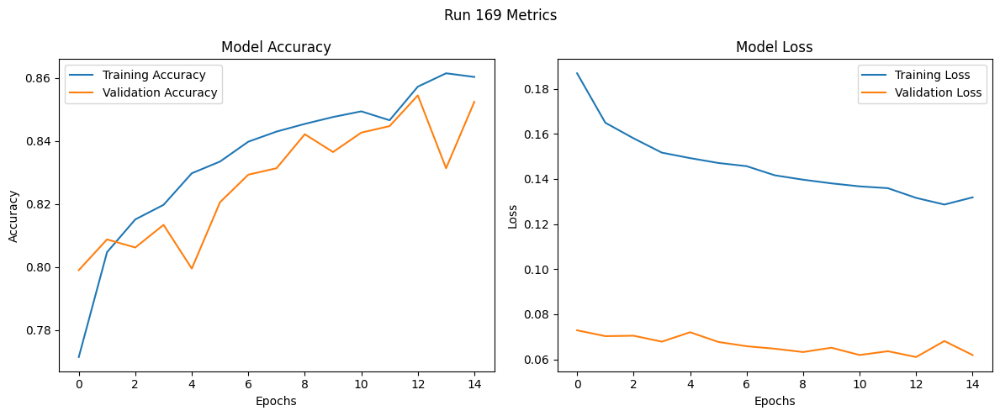

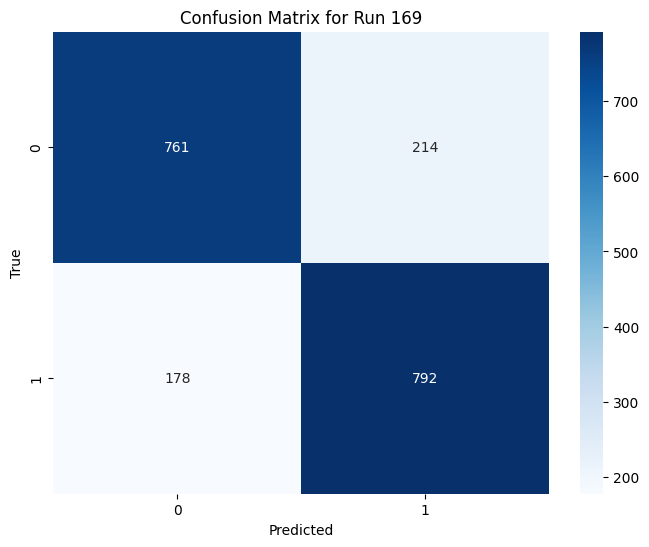

Run 170: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7326 - loss: 0.2041 - val_accuracy: 0.7923 - val_loss: 0.0754
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7932 - loss: 0.1701 - val_accuracy: 0.7866 - val_loss: 0.0730
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8107 - loss: 0.1591 - val_accuracy: 0.8036 - val_loss: 0.0682
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8132 - loss: 0.1559 - val_accuracy: 0.8021 - val_loss: 0.0724
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8221 - loss: 0.1563 - val_accuracy: 0.7949 - val_loss: 0.0735
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8170 - loss: 0.1527 - val_accuracy: 0.8139 - val_loss: 0.0706
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8331

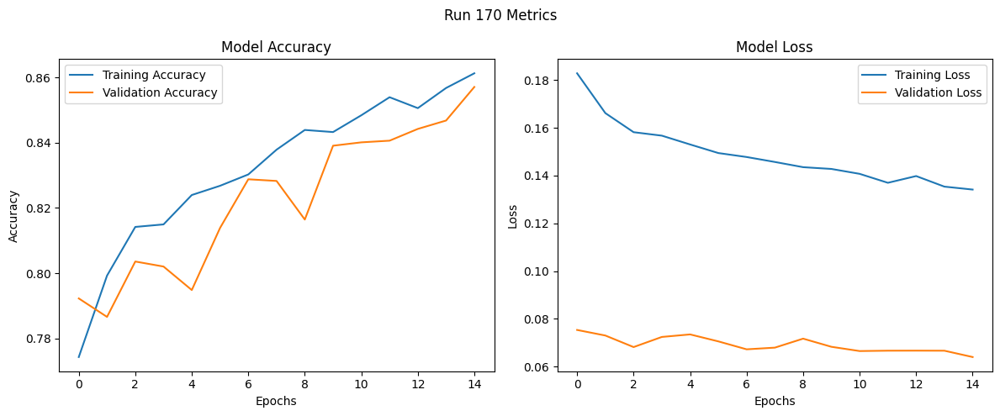

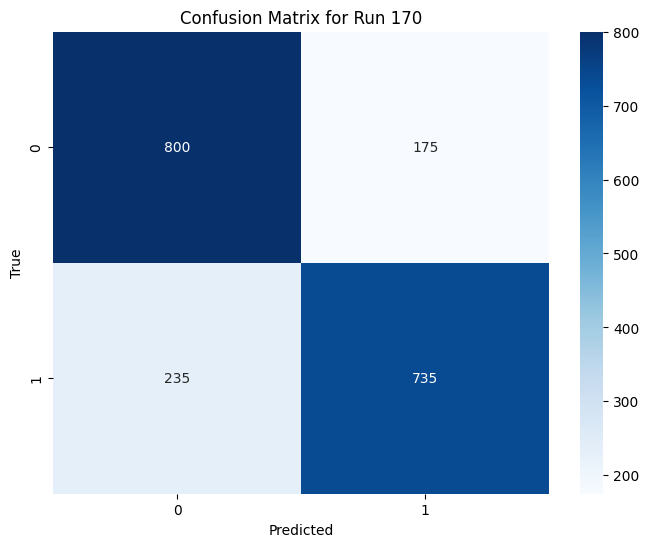

Run 171: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7383 - loss: 0.2034 - val_accuracy: 0.8010 - val_loss: 0.0718
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7948 - loss: 0.1719 - val_accuracy: 0.8108 - val_loss: 0.0706
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8161 - loss: 0.1587 - val_accuracy: 0.8072 - val_loss: 0.0719
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8226 - loss: 0.1563 - val_accuracy: 0.8211 - val_loss: 0.0707
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8349 - loss: 0.1476 - val_accuracy: 0.8170 - val_loss: 0.0707
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8313 - loss: 0.1523 - val_accuracy: 0.8314 - val_loss: 0.0672
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8398 -

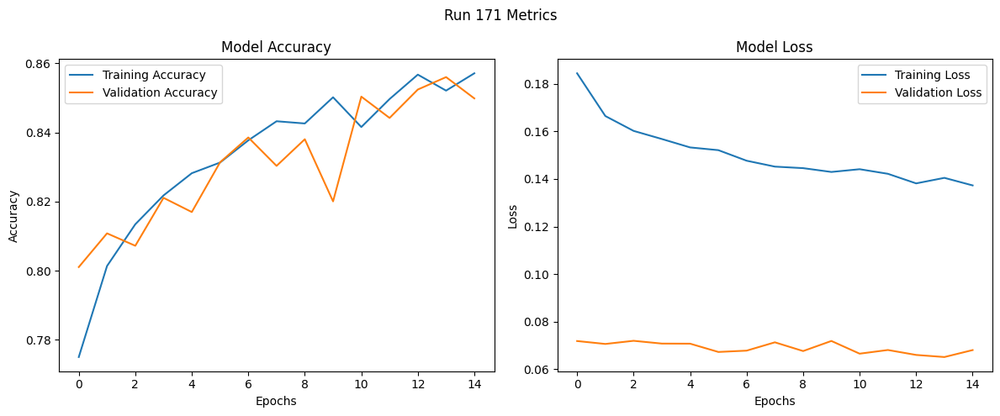

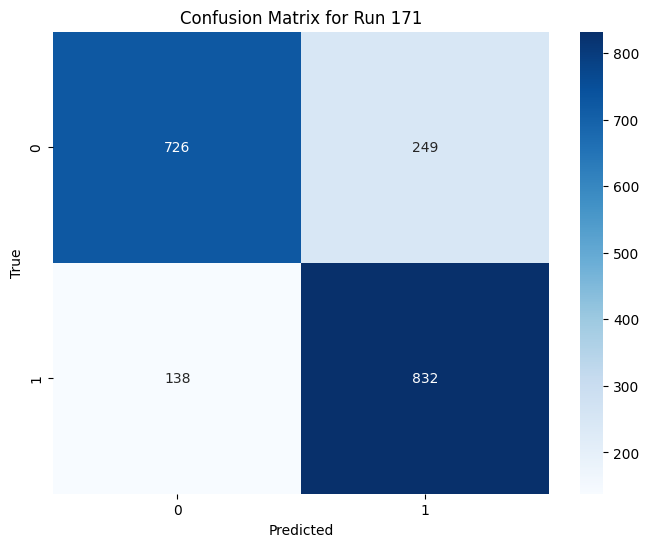

Run 172: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7647 - loss: 0.2824 - val_accuracy: 0.8031 - val_loss: 0.0717
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8037 - loss: 0.2327 - val_accuracy: 0.8123 - val_loss: 0.0690
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8149 - loss: 0.2203 - val_accuracy: 0.8036 - val_loss: 0.0701
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8223 - loss: 0.2171 - val_accuracy: 0.8170 - val_loss: 0.0678
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8349 - loss: 0.2043 - val_accuracy: 0.8272 - val_loss: 0.0659
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8379 - loss: 0.2027 - val_accuracy: 0.8355 - val_loss: 0.0647
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8409 

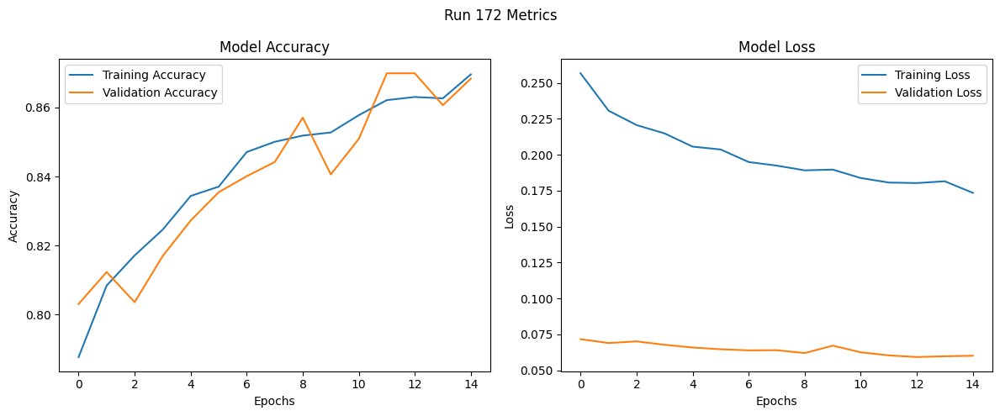

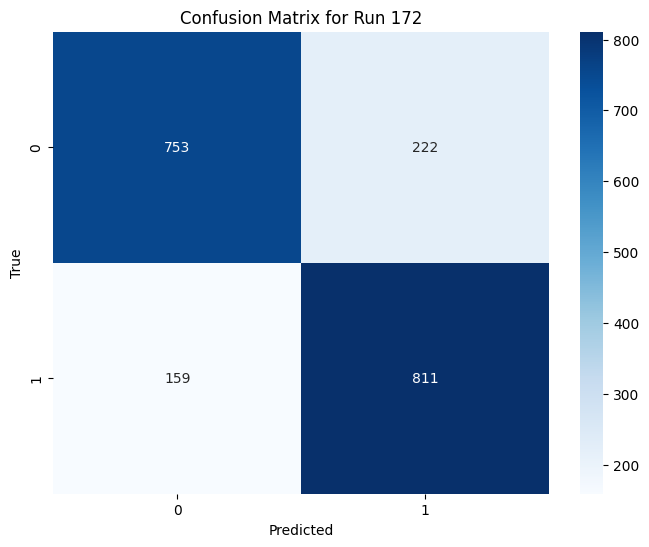

Run 173: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.7415 - loss: 0.2858 - val_accuracy: 0.8021 - val_loss: 0.0729
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8019 - loss: 0.2376 - val_accuracy: 0.7830 - val_loss: 0.0751
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8162 - loss: 0.2241 - val_accuracy: 0.8267 - val_loss: 0.0686
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8318 - loss: 0.2126 - val_accuracy: 0.8180 - val_loss: 0.0694
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8322 - loss: 0.2087 - val_accuracy: 0.8113 - val_loss: 0.0723
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8393 - loss: 0.2020 - val_accuracy: 0.8170 - val_loss: 0.0703
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8489

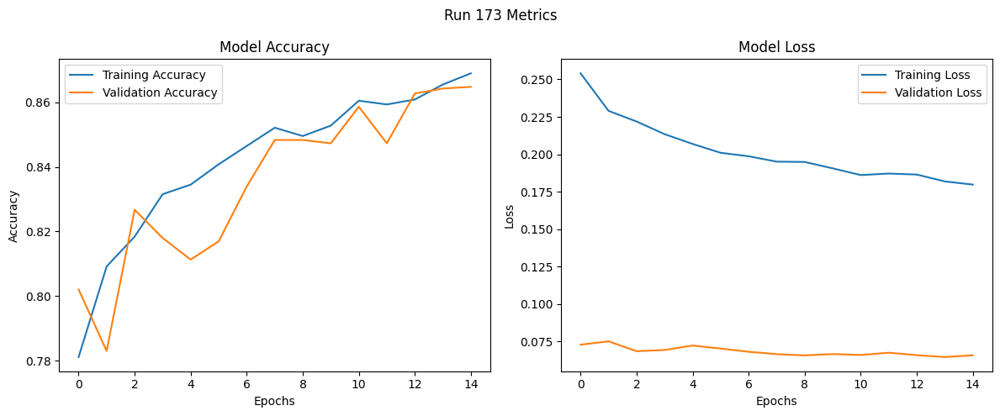

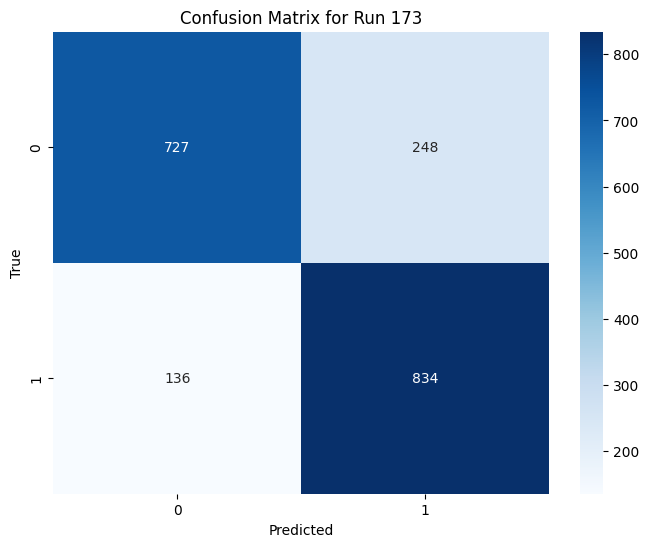

Run 174: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.7594 - loss: 0.2757 - val_accuracy: 0.7985 - val_loss: 0.0722
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8077 - loss: 0.2260 - val_accuracy: 0.8108 - val_loss: 0.0718
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8225 - loss: 0.2213 - val_accuracy: 0.8062 - val_loss: 0.0739
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8253 - loss: 0.2175 - val_accuracy: 0.8154 - val_loss: 0.0743
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8260 - loss: 0.2166 - val_accuracy: 0.8257 - val_loss: 0.0685
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8327 - loss: 0.2065 - val_accuracy: 0.8144 - val_loss: 0.0724
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8284 -

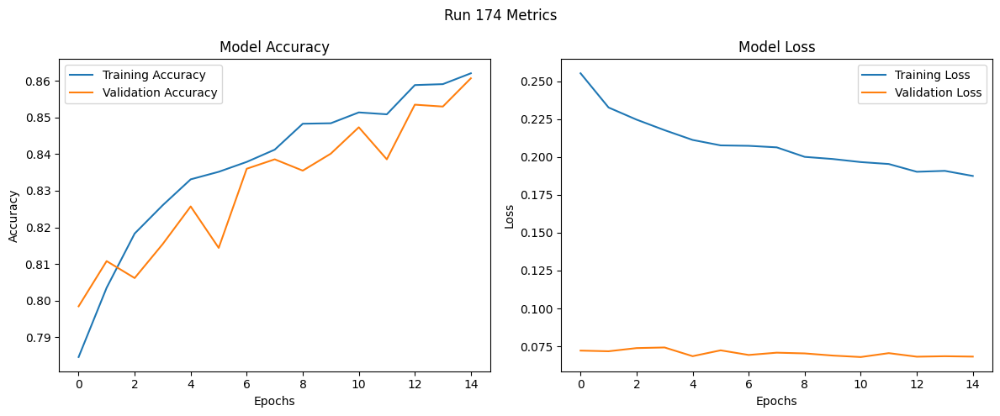

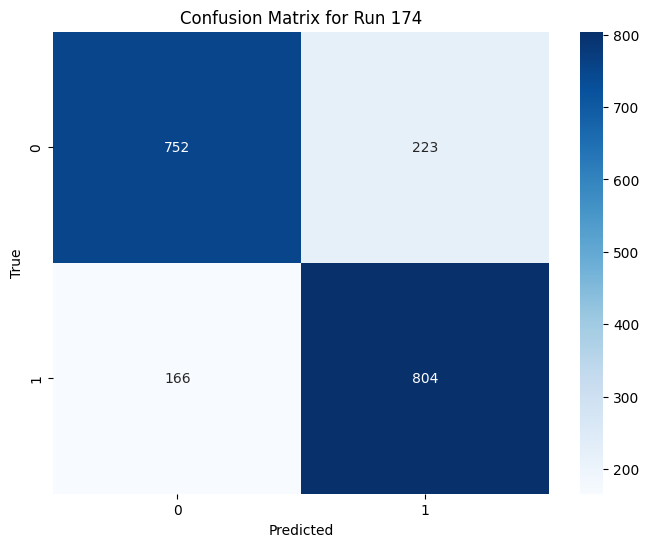

Run 175: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7382 - loss: 0.2090 - val_accuracy: 0.7923 - val_loss: 0.0739
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7987 - loss: 0.1685 - val_accuracy: 0.8026 - val_loss: 0.0703
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8091 - loss: 0.1601 - val_accuracy: 0.7918 - val_loss: 0.0718
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8211 - loss: 0.1524 - val_accuracy: 0.8015 - val_loss: 0.0732
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8261 - loss: 0.1510 - val_accuracy: 0.8211 - val_loss: 0.0662
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8331 - loss: 0.1494 - val_accuracy: 0.8231 - val_loss: 0.0666
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8405

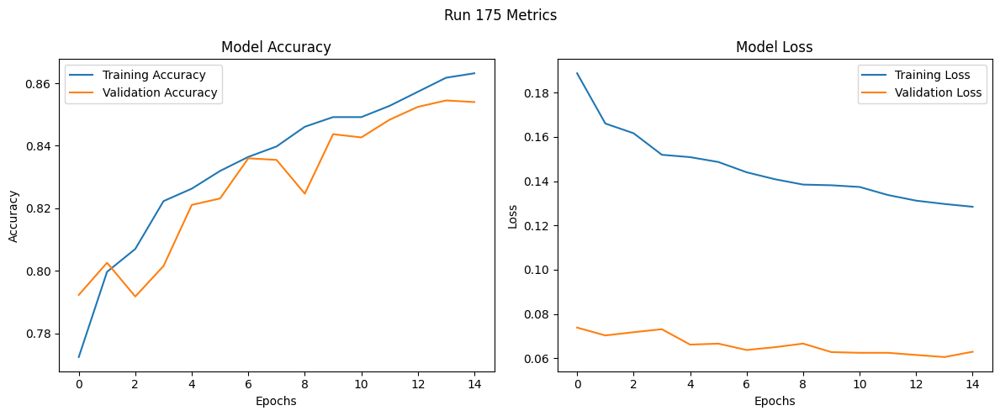

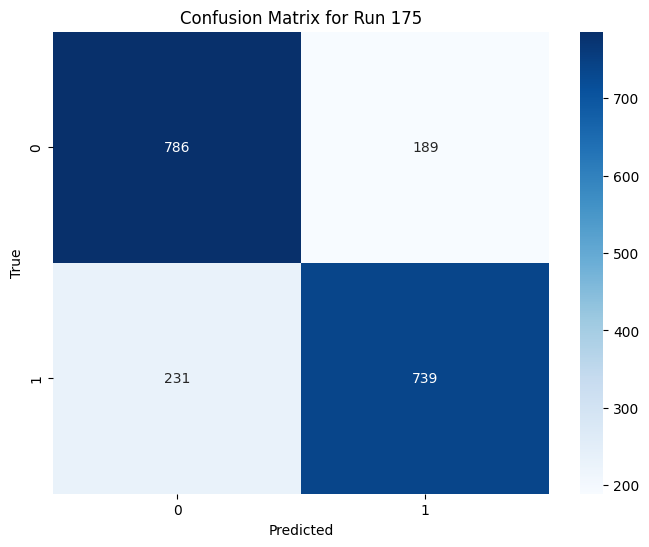

Run 176: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7186 - loss: 0.2100 - val_accuracy: 0.7969 - val_loss: 0.0737
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8050 - loss: 0.1626 - val_accuracy: 0.8062 - val_loss: 0.0711
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8161 - loss: 0.1585 - val_accuracy: 0.7866 - val_loss: 0.0762
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8137 - loss: 0.1573 - val_accuracy: 0.8108 - val_loss: 0.0691
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8218 - loss: 0.1530 - val_accuracy: 0.8180 - val_loss: 0.0681
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8359 - loss: 0.1459 - val_accuracy: 0.8129 - val_loss: 0.0702
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.828

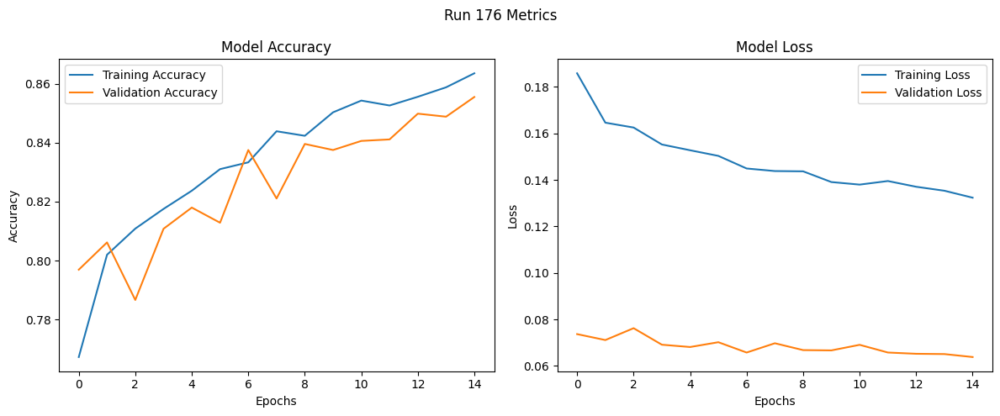

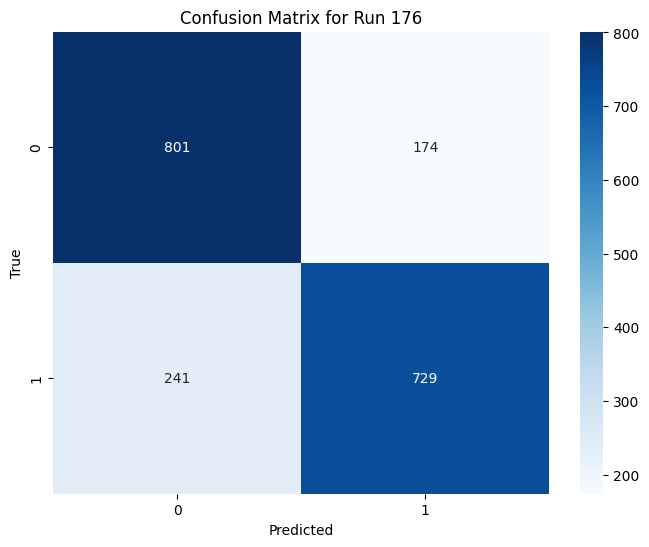

Run 177: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7595 - loss: 0.1982 - val_accuracy: 0.7897 - val_loss: 0.0736
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8047 - loss: 0.1659 - val_accuracy: 0.7897 - val_loss: 0.0752
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8010 - loss: 0.1661 - val_accuracy: 0.8129 - val_loss: 0.0704
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8295 - loss: 0.1534 - val_accuracy: 0.8221 - val_loss: 0.0696
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8256 - loss: 0.1552 - val_accuracy: 0.8185 - val_loss: 0.0707
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8351 - loss: 0.1488 - val_accuracy: 0.8154 - val_loss: 0.0704
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8439 

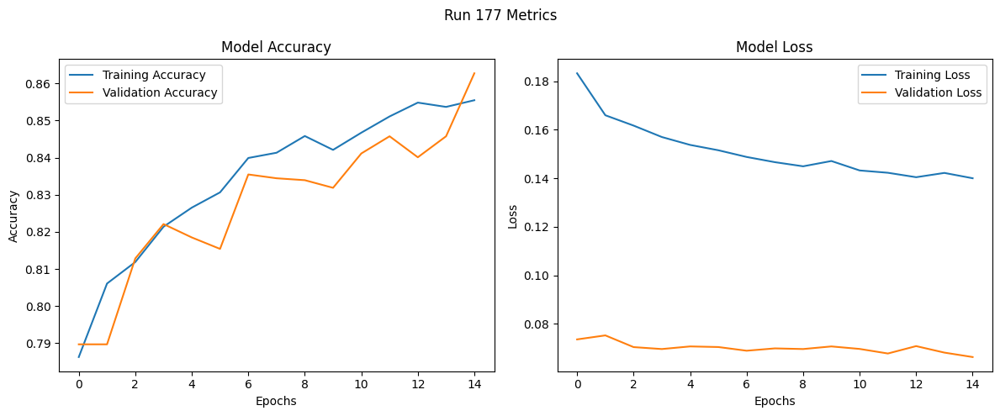

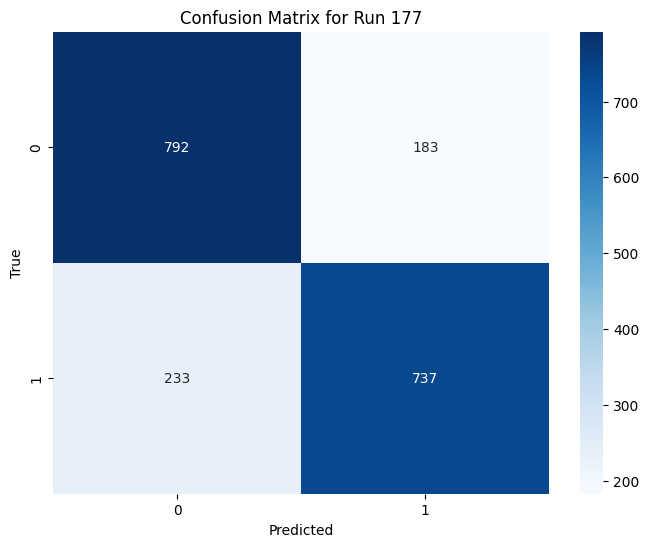

Run 178: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.7673 - loss: 0.2808 - val_accuracy: 0.8026 - val_loss: 0.0717
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8056 - loss: 0.2362 - val_accuracy: 0.8067 - val_loss: 0.0695
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8163 - loss: 0.2215 - val_accuracy: 0.8031 - val_loss: 0.0715
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8218 - loss: 0.2141 - val_accuracy: 0.8108 - val_loss: 0.0700
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8358 - loss: 0.2030 - val_accuracy: 0.8237 - val_loss: 0.0663
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8433 - loss: 0.1973 - val_accuracy: 0.8303 - val_loss: 0.0649
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8481

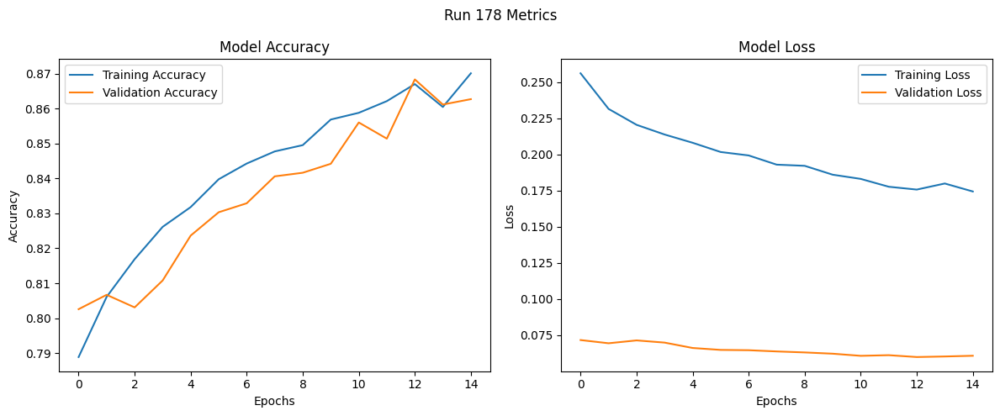

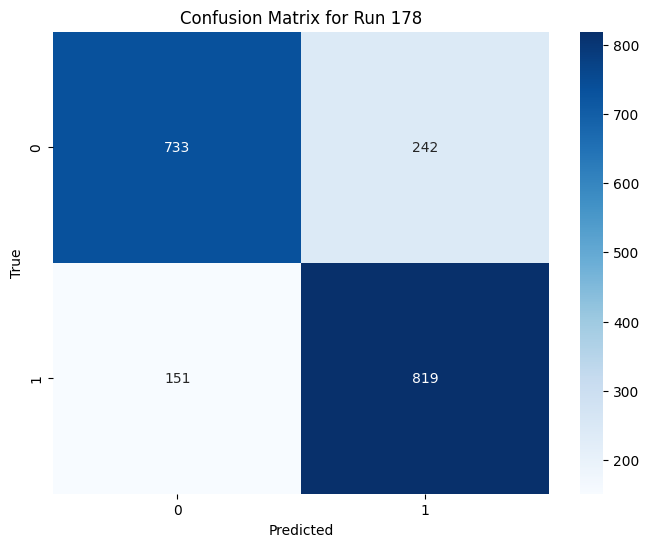

Run 179: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7575 - loss: 0.2803 - val_accuracy: 0.8015 - val_loss: 0.0711
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8135 - loss: 0.2208 - val_accuracy: 0.7799 - val_loss: 0.0774
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8128 - loss: 0.2218 - val_accuracy: 0.8062 - val_loss: 0.0719
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8235 - loss: 0.2169 - val_accuracy: 0.8247 - val_loss: 0.0682
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8342 - loss: 0.2042 - val_accuracy: 0.8293 - val_loss: 0.0676
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8394 - loss: 0.2037 - val_accuracy: 0.8329 - val_loss: 0.0678
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.843

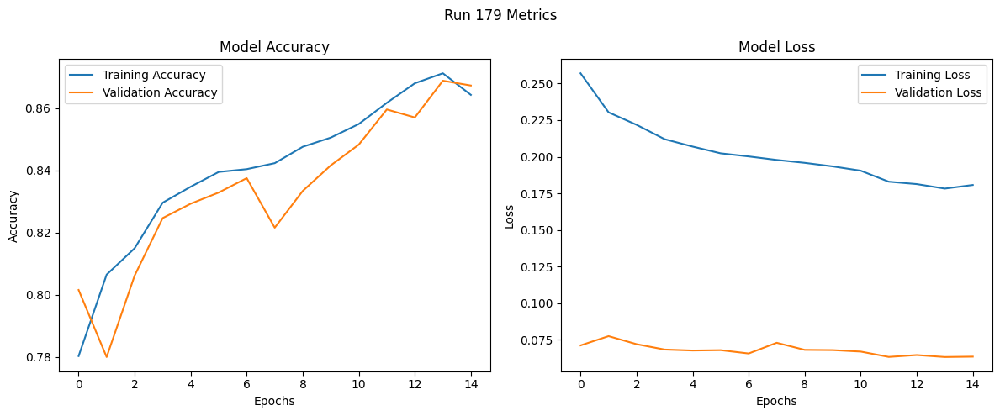

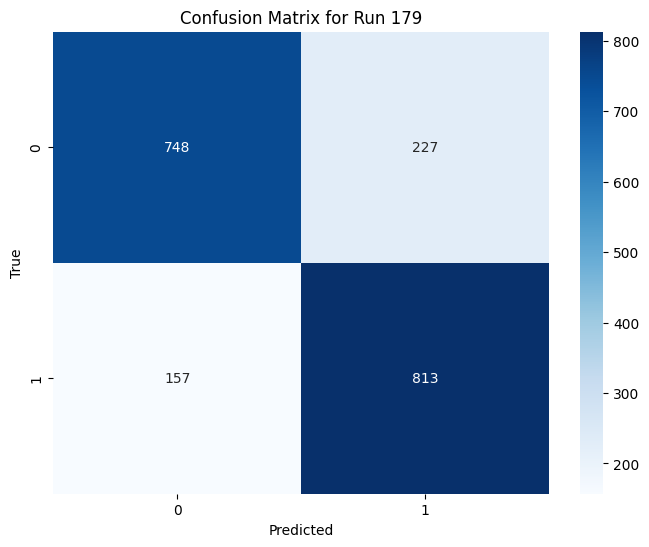

Run 180: L2: 5e-05, Dropout: 0.25, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7607 - loss: 0.2750 - val_accuracy: 0.7995 - val_loss: 0.0746
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8070 - loss: 0.2356 - val_accuracy: 0.8144 - val_loss: 0.0698
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8189 - loss: 0.2237 - val_accuracy: 0.8195 - val_loss: 0.0693
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8332 - loss: 0.2134 - val_accuracy: 0.8154 - val_loss: 0.0700
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8241 - loss: 0.2192 - val_accuracy: 0.8154 - val_loss: 0.0716
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8326 - loss: 0.2101 - val_accuracy: 0.8139 - val_loss: 0.0724
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8371 

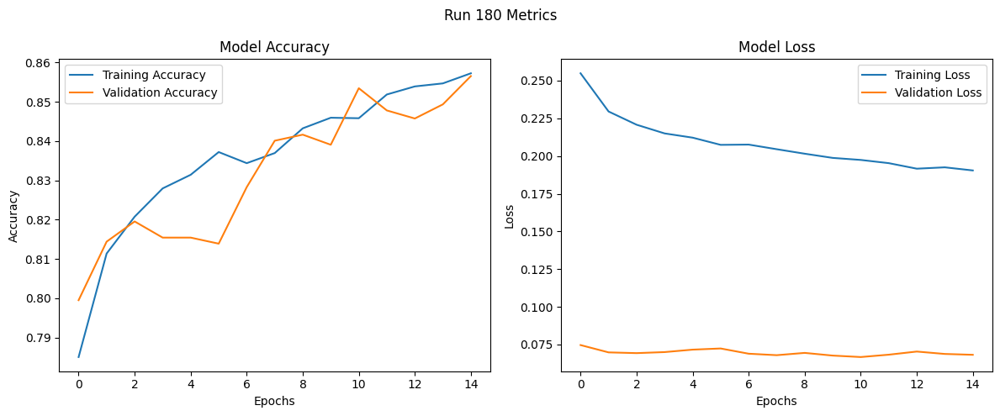

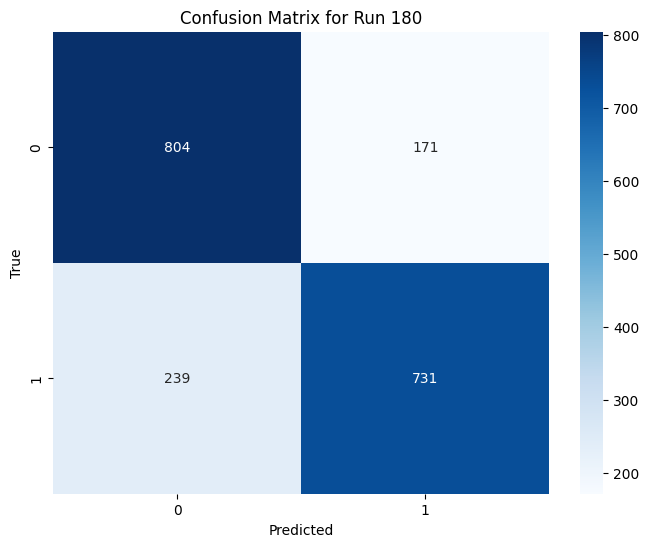

Run 181: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step - accuracy: 0.7450 - loss: 1.2257 - val_accuracy: 0.7815 - val_loss: 0.4536
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7989 - loss: 1.0439 - val_accuracy: 0.7969 - val_loss: 0.4309
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8063 - loss: 0.9978 - val_accuracy: 0.8041 - val_loss: 0.4143
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8131 - loss: 0.9625 - val_accuracy: 0.8021 - val_loss: 0.4306
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8307 - loss: 0.9224 - val_accuracy: 0.8216 - val_loss: 0.4058
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8414 - loss: 0.8908 - val_accuracy: 0.8375 - val_loss: 0.3887
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step -

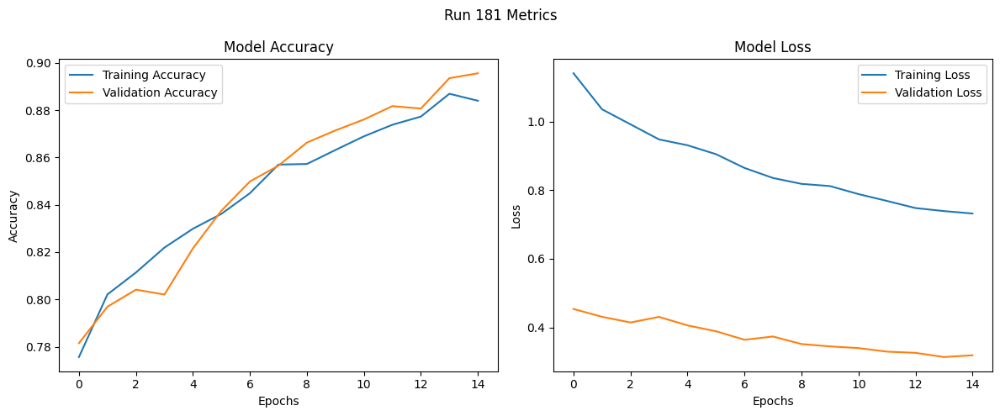

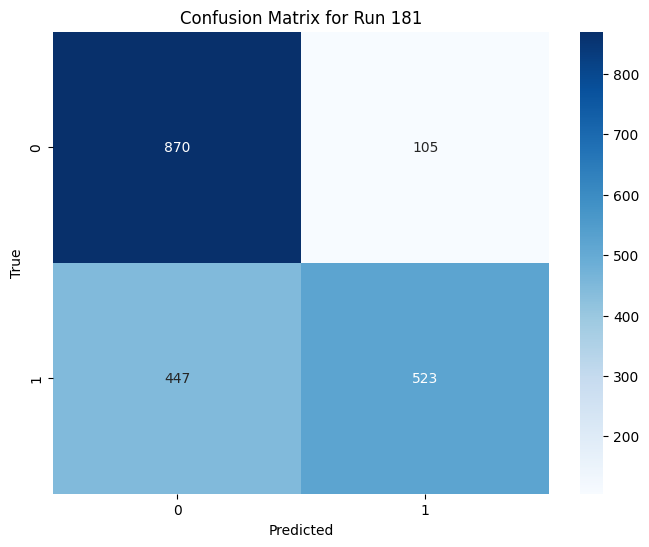

Run 182: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7478 - loss: 1.2214 - val_accuracy: 0.7799 - val_loss: 0.4664
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7951 - loss: 1.0414 - val_accuracy: 0.7686 - val_loss: 0.4720
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7988 - loss: 1.0025 - val_accuracy: 0.8103 - val_loss: 0.4159
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8227 - loss: 0.9718 - val_accuracy: 0.8257 - val_loss: 0.4018
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8215 - loss: 0.9386 - val_accuracy: 0.8201 - val_loss: 0.4033
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8350 - loss: 0.8955 - val_accuracy: 0.8499 - val_loss: 0.3889
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step -

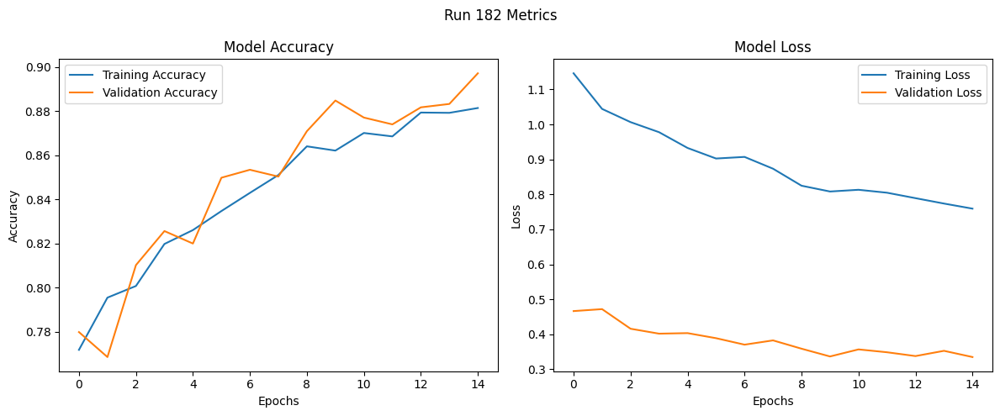

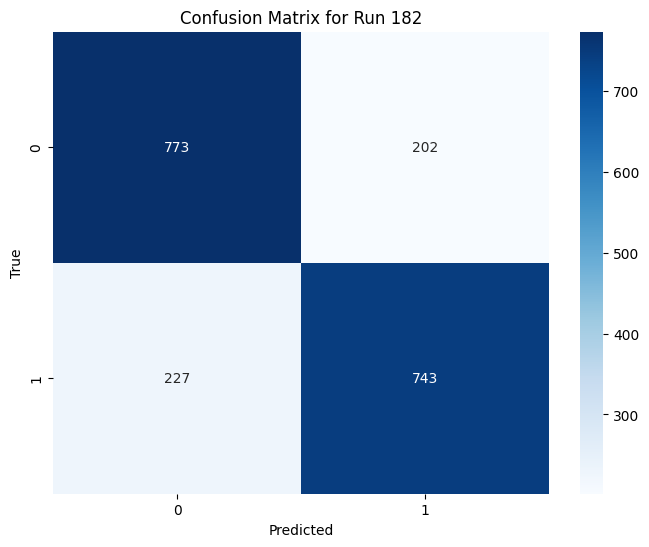

Run 183: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7467 - loss: 1.2479 - val_accuracy: 0.7692 - val_loss: 0.4826
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7956 - loss: 1.0748 - val_accuracy: 0.8021 - val_loss: 0.4401
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8134 - loss: 1.0072 - val_accuracy: 0.7887 - val_loss: 0.4410
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8170 - loss: 1.0039 - val_accuracy: 0.8144 - val_loss: 0.4310
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8193 - loss: 0.9821 - val_accuracy: 0.8005 - val_loss: 0.4395
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8267 - loss: 0.9758 - val_accuracy: 0.8231 - val_loss: 0.4113
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - 

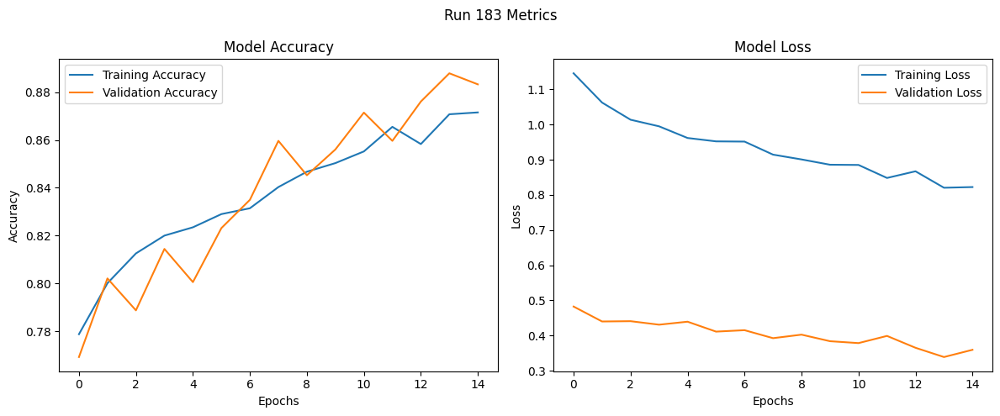

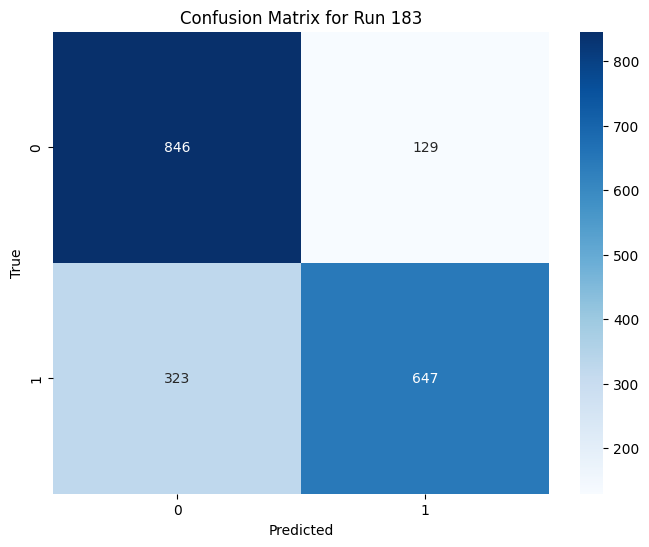

Run 184: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7651 - loss: 1.7058 - val_accuracy: 0.8005 - val_loss: 0.4425
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8127 - loss: 1.4471 - val_accuracy: 0.8175 - val_loss: 0.4268
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8136 - loss: 1.3930 - val_accuracy: 0.8154 - val_loss: 0.4026
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8279 - loss: 1.3177 - val_accuracy: 0.7995 - val_loss: 0.4228
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8351 - loss: 1.2930 - val_accuracy: 0.8334 - val_loss: 0.3876
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8529 - loss: 1.2086 - val_accuracy: 0.8545 - val_loss: 0.3683
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - 

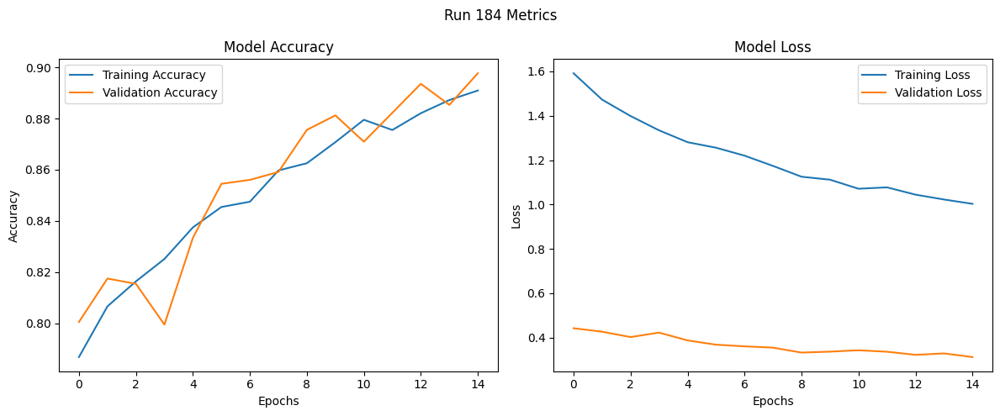

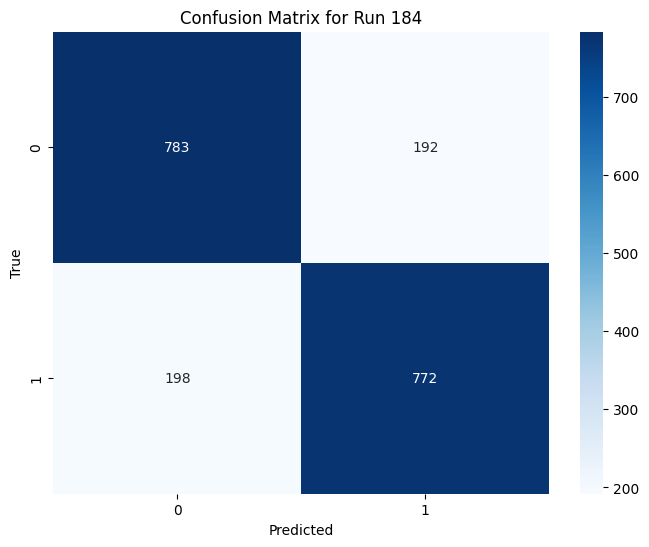

Run 185: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7384 - loss: 1.7859 - val_accuracy: 0.7969 - val_loss: 0.4382
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8047 - loss: 1.4609 - val_accuracy: 0.8149 - val_loss: 0.4155
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8208 - loss: 1.3825 - val_accuracy: 0.8129 - val_loss: 0.4257
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8139 - loss: 1.4016 - val_accuracy: 0.8159 - val_loss: 0.3942
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8424 - loss: 1.2470 - val_accuracy: 0.8257 - val_loss: 0.4148
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8402 - loss: 1.2799 - val_accuracy: 0.8550 - val_loss: 0.3648
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step -

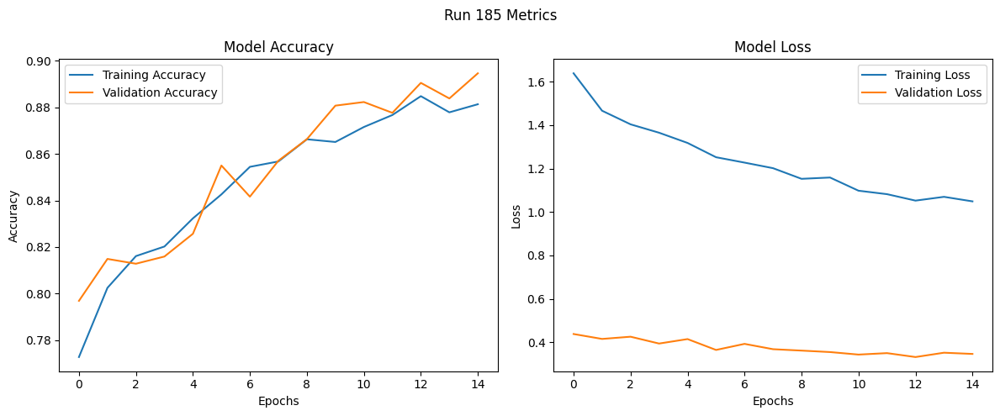

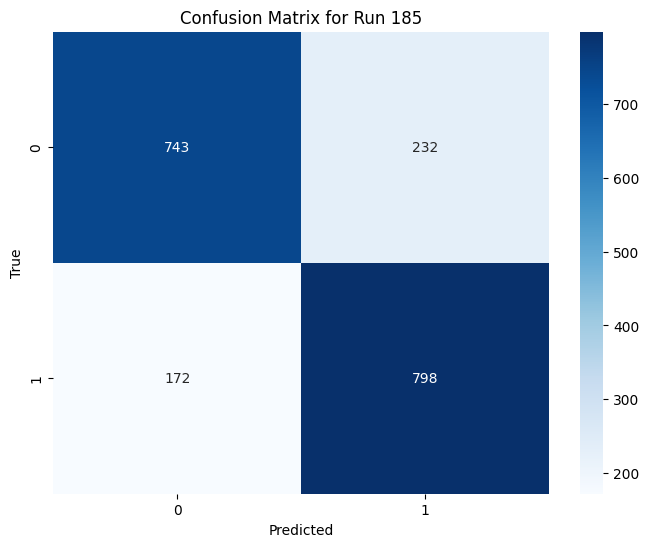

Run 186: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7543 - loss: 1.7053 - val_accuracy: 0.7979 - val_loss: 0.4452
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8044 - loss: 1.4793 - val_accuracy: 0.8021 - val_loss: 0.4350
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8125 - loss: 1.4376 - val_accuracy: 0.8211 - val_loss: 0.4201
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8081 - loss: 1.4386 - val_accuracy: 0.8082 - val_loss: 0.4324
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8179 - loss: 1.3738 - val_accuracy: 0.8242 - val_loss: 0.4155
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8405 - loss: 1.3326 - val_accuracy: 0.8221 - val_loss: 0.4270
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - 

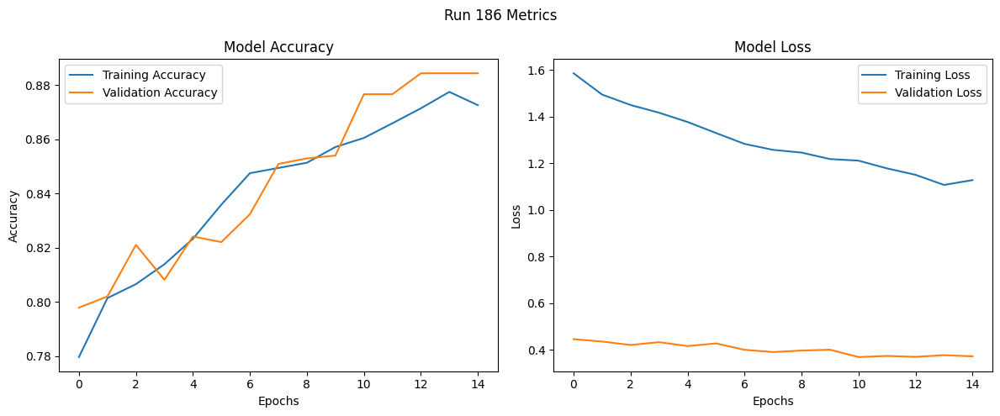

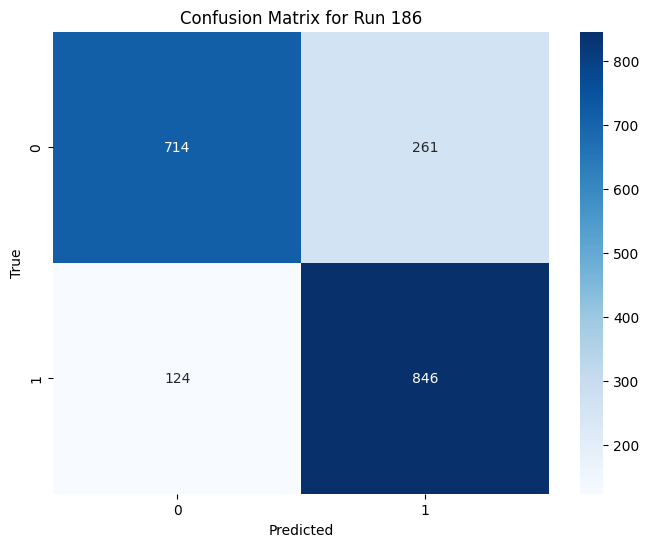

Run 187: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7501 - loss: 1.2076 - val_accuracy: 0.7835 - val_loss: 0.4657
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8062 - loss: 1.0117 - val_accuracy: 0.8087 - val_loss: 0.4287
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8155 - loss: 0.9907 - val_accuracy: 0.8165 - val_loss: 0.4130
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8263 - loss: 0.9338 - val_accuracy: 0.8278 - val_loss: 0.4039
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8325 - loss: 0.9066 - val_accuracy: 0.8365 - val_loss: 0.3698
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8439 - loss: 0.8563 - val_accuracy: 0.8380 - val_loss: 0.3782
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step -

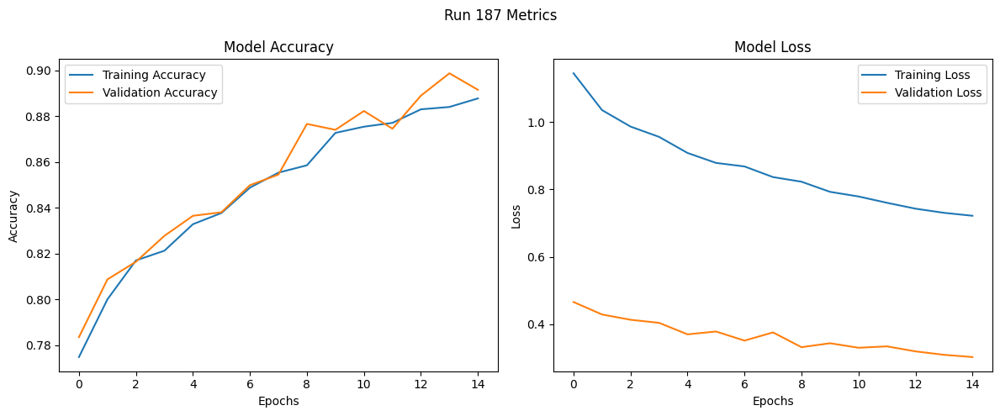

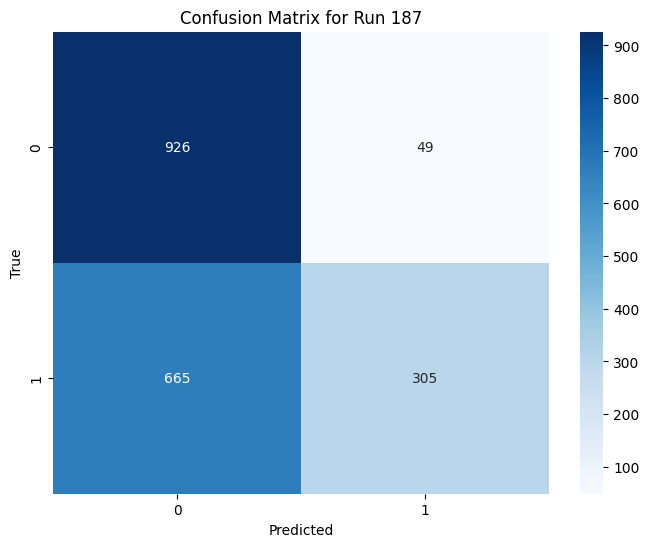

Run 188: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7390 - loss: 1.2232 - val_accuracy: 0.8041 - val_loss: 0.4469
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8069 - loss: 1.0572 - val_accuracy: 0.7995 - val_loss: 0.4362
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8229 - loss: 1.0049 - val_accuracy: 0.8159 - val_loss: 0.4207
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8266 - loss: 0.9665 - val_accuracy: 0.8355 - val_loss: 0.3934
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8330 - loss: 0.9273 - val_accuracy: 0.8247 - val_loss: 0.3965
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8417 - loss: 0.8971 - val_accuracy: 0.8416 - val_loss: 0.3792
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step

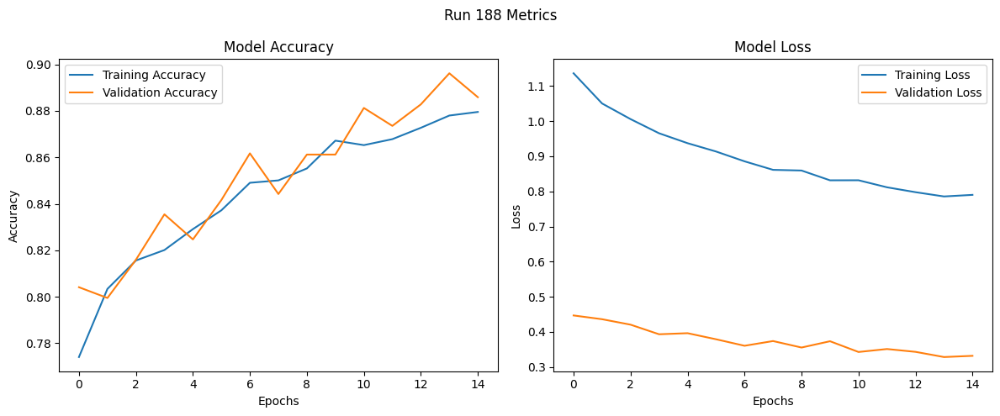

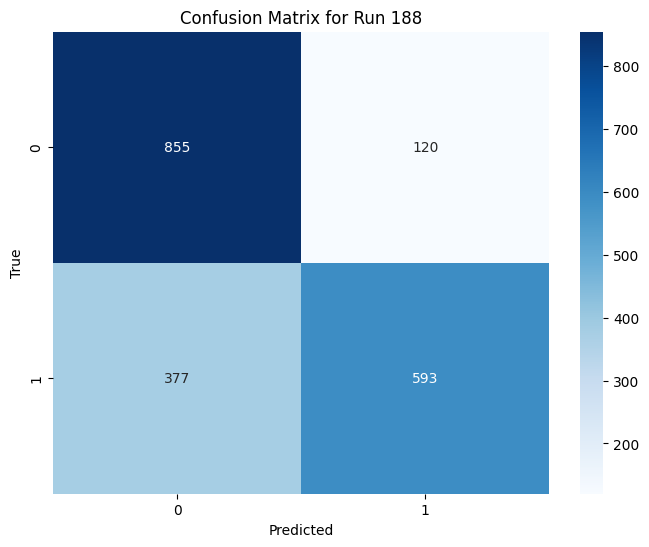

Run 189: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7500 - loss: 1.2592 - val_accuracy: 0.7990 - val_loss: 0.4488
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8044 - loss: 1.0521 - val_accuracy: 0.8093 - val_loss: 0.4284
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8119 - loss: 1.0215 - val_accuracy: 0.8134 - val_loss: 0.4173
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8194 - loss: 1.0059 - val_accuracy: 0.8139 - val_loss: 0.4311
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8234 - loss: 1.0014 - val_accuracy: 0.8293 - val_loss: 0.4152
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8281 - loss: 0.9566 - val_accuracy: 0.8308 - val_loss: 0.4019
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step -

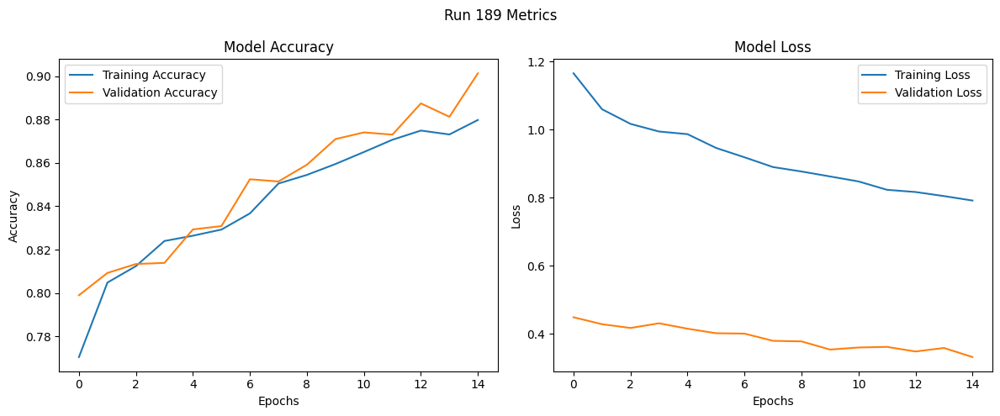

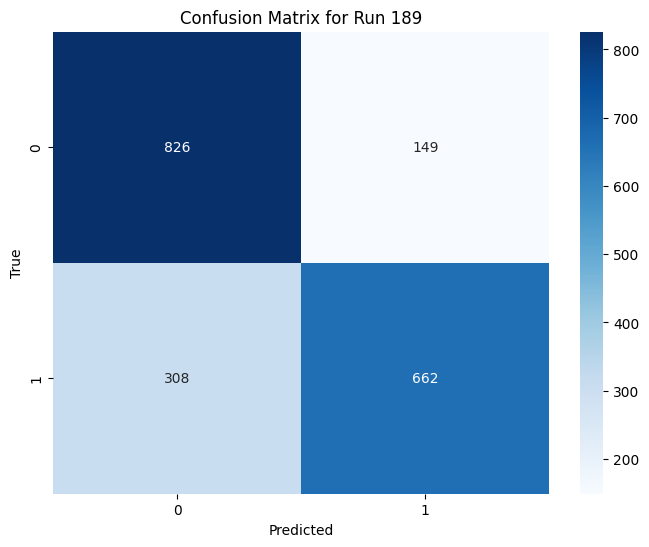

Run 190: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7676 - loss: 1.6879 - val_accuracy: 0.7959 - val_loss: 0.4305
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8064 - loss: 1.4422 - val_accuracy: 0.7882 - val_loss: 0.4360
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8197 - loss: 1.3954 - val_accuracy: 0.8170 - val_loss: 0.3926
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8227 - loss: 1.3207 - val_accuracy: 0.8221 - val_loss: 0.3987
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8373 - loss: 1.2514 - val_accuracy: 0.8380 - val_loss: 0.3773
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8518 - loss: 1.2039 - val_accuracy: 0.8540 - val_loss: 0.3632
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step -

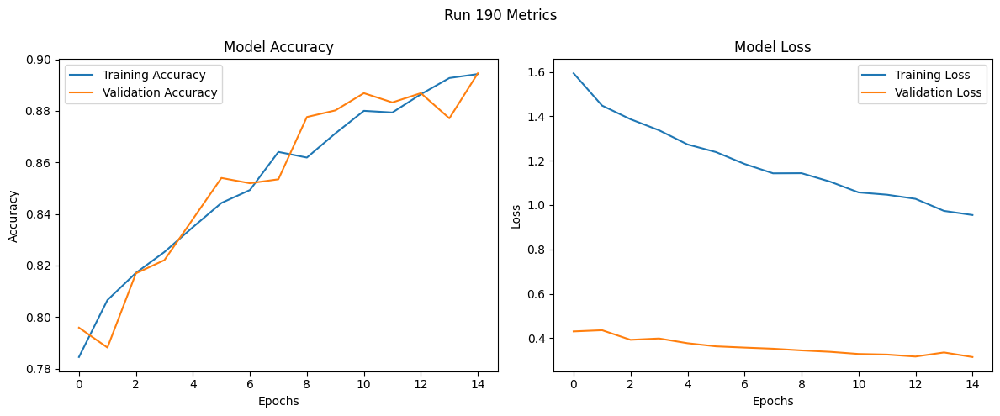

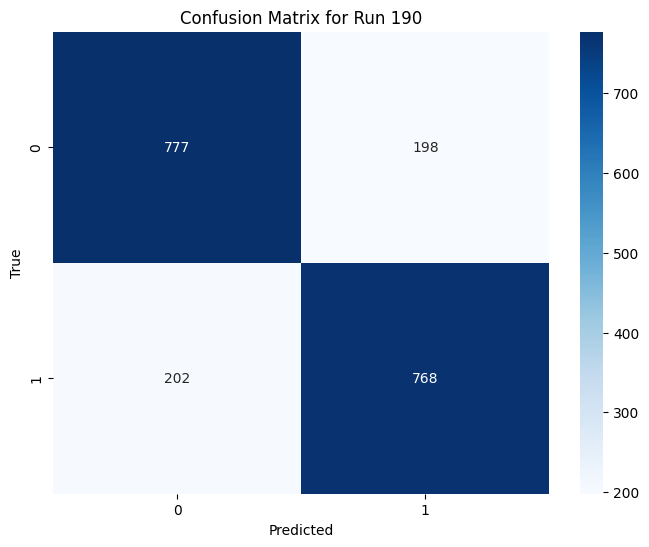

Run 191: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step - accuracy: 0.7554 - loss: 1.7170 - val_accuracy: 0.8072 - val_loss: 0.4386
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8038 - loss: 1.4770 - val_accuracy: 0.8134 - val_loss: 0.4186
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8115 - loss: 1.4573 - val_accuracy: 0.8118 - val_loss: 0.4378
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8293 - loss: 1.3190 - val_accuracy: 0.8165 - val_loss: 0.4084
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8229 - loss: 1.3394 - val_accuracy: 0.8165 - val_loss: 0.4069
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8274 - loss: 1.3026 - val_accuracy: 0.8185 - val_loss: 0.4136
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step

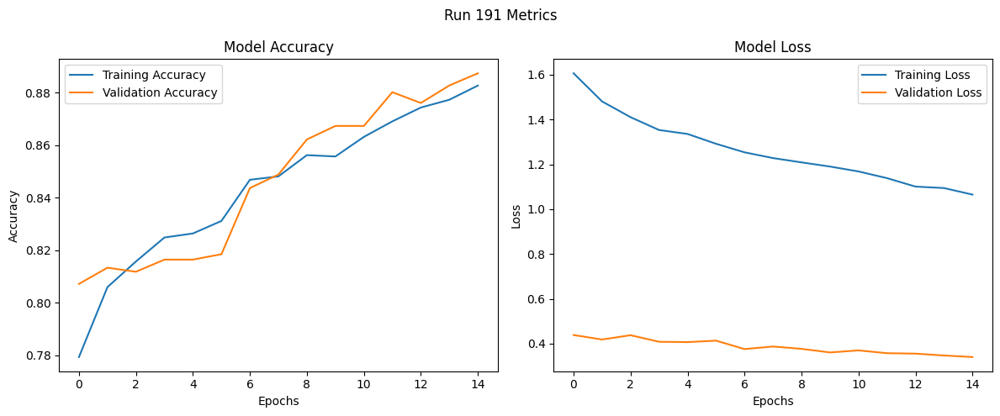

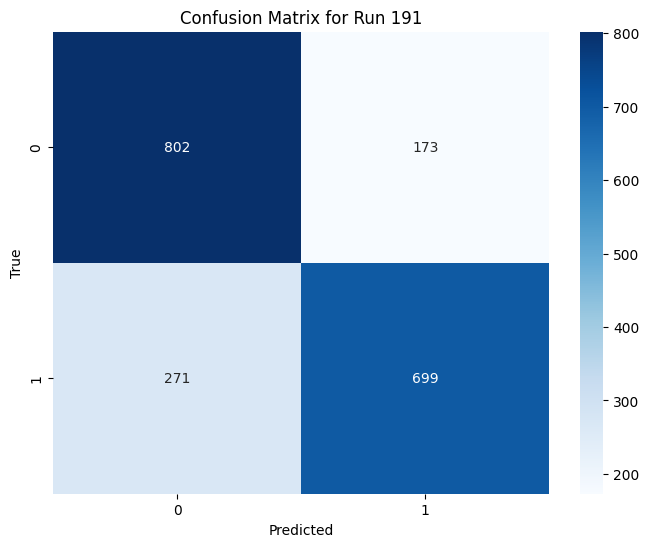

Run 192: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7540 - loss: 1.7484 - val_accuracy: 0.7985 - val_loss: 0.4462
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7989 - loss: 1.5196 - val_accuracy: 0.8000 - val_loss: 0.4605
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8042 - loss: 1.4829 - val_accuracy: 0.7979 - val_loss: 0.4312
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8179 - loss: 1.3647 - val_accuracy: 0.7969 - val_loss: 0.4461
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8259 - loss: 1.3845 - val_accuracy: 0.8247 - val_loss: 0.4098
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8318 - loss: 1.3022 - val_accuracy: 0.8339 - val_loss: 0.4052
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step -

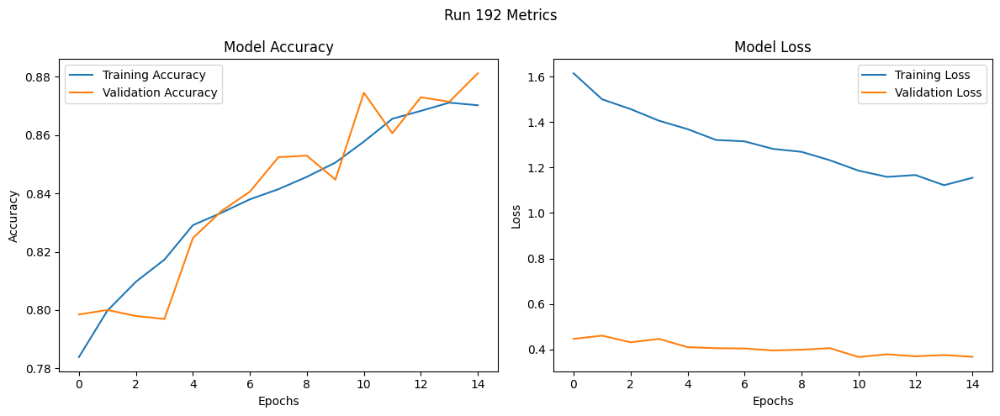

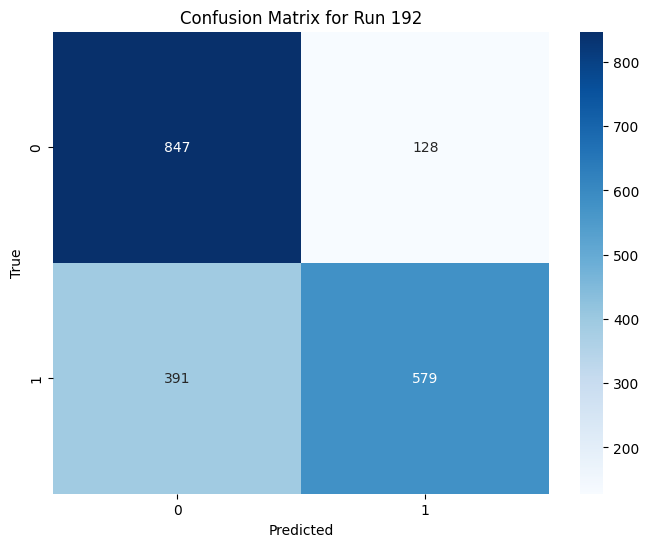

Run 193: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7469 - loss: 0.4201 - val_accuracy: 0.7913 - val_loss: 0.1564
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8144 - loss: 0.3398 - val_accuracy: 0.8026 - val_loss: 0.1491
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8196 - loss: 0.3327 - val_accuracy: 0.8201 - val_loss: 0.1417
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8336 - loss: 0.3144 - val_accuracy: 0.7877 - val_loss: 0.1595
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8343 - loss: 0.3081 - val_accuracy: 0.8334 - val_loss: 0.1345
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8458 - loss: 0.2947 - val_accuracy: 0.8293 - val_loss: 0.1362
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accura

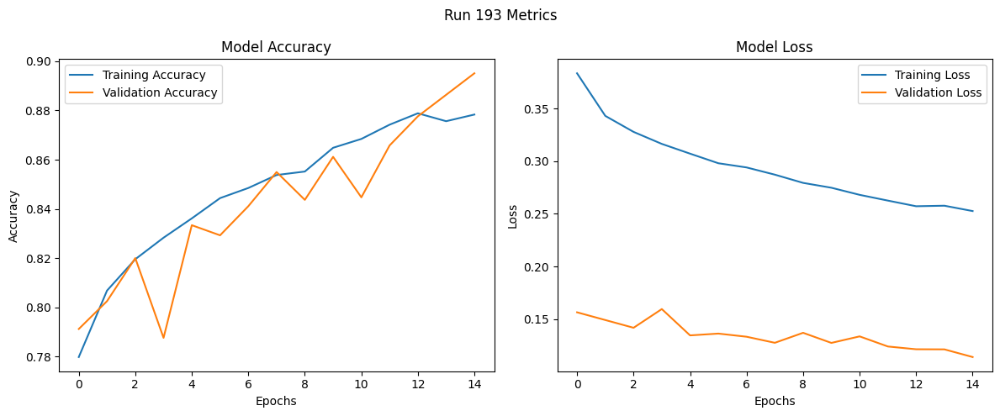

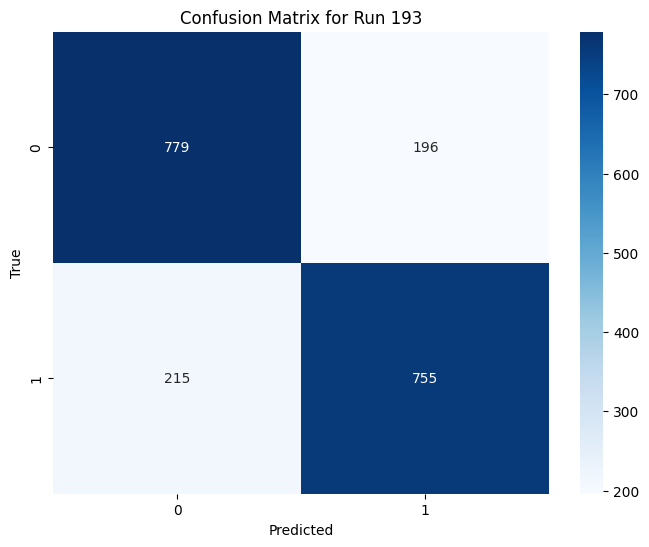

Run 194: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 13s 10ms/step - accuracy: 0.7523 - loss: 0.4166 - val_accuracy: 0.7789 - val_loss: 0.1650
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8044 - loss: 0.3490 - val_accuracy: 0.8149 - val_loss: 0.1455
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8263 - loss: 0.3285 - val_accuracy: 0.8154 - val_loss: 0.1443
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8235 - loss: 0.3260 - val_accuracy: 0.8103 - val_loss: 0.1510
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8379 - loss: 0.3193 - val_accuracy: 0.8165 - val_loss: 0.1441
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8400 - loss: 0.3090 - val_accuracy: 0.8201 - val_loss: 0.1497
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - acc

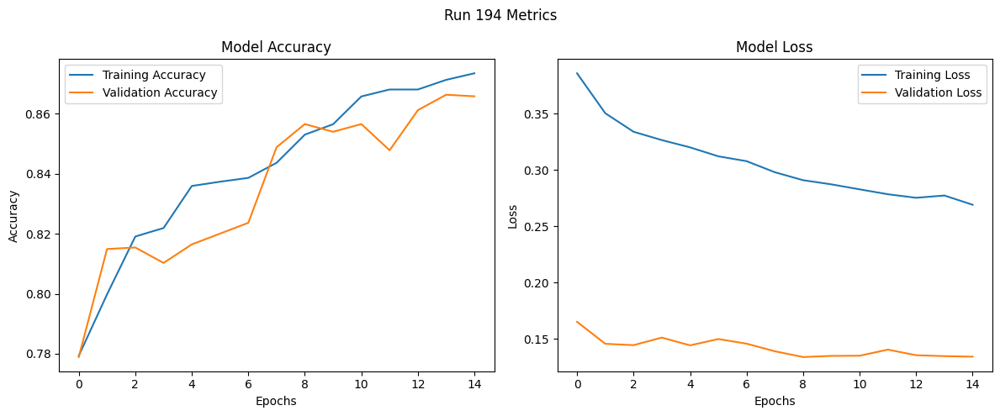

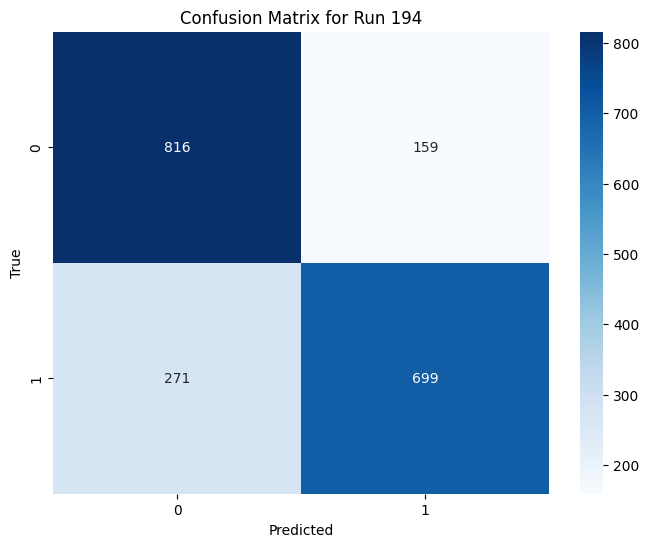

Run 195: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 5s 13ms/step - accuracy: 0.7602 - loss: 0.4138 - val_accuracy: 0.7861 - val_loss: 0.1631
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.7916 - loss: 0.3679 - val_accuracy: 0.8072 - val_loss: 0.1501
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8180 - loss: 0.3389 - val_accuracy: 0.8201 - val_loss: 0.1480
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8308 - loss: 0.3199 - val_accuracy: 0.8170 - val_loss: 0.1483
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8350 - loss: 0.3129 - val_accuracy: 0.8391 - val_loss: 0.1440
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8471 - loss: 0.3119 - val_accuracy: 0.8113 - val_loss: 0.1565
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accura

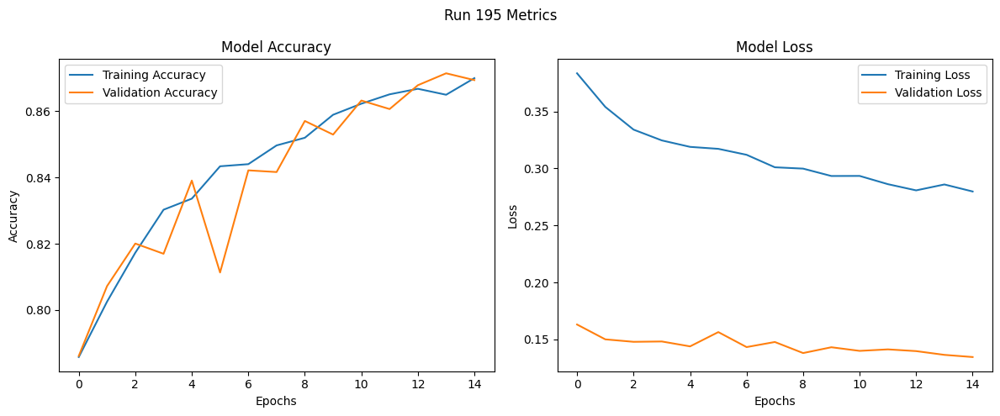

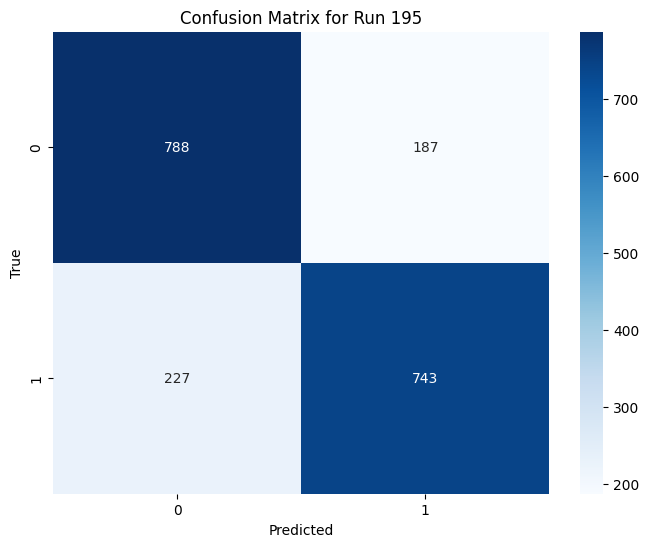

Run 196: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7618 - loss: 0.5816 - val_accuracy: 0.8015 - val_loss: 0.1530
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8111 - loss: 0.4802 - val_accuracy: 0.8062 - val_loss: 0.1487
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8277 - loss: 0.4472 - val_accuracy: 0.8211 - val_loss: 0.1400
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8230 - loss: 0.4579 - val_accuracy: 0.8226 - val_loss: 0.1424
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8414 - loss: 0.4271 - val_accuracy: 0.8324 - val_loss: 0.1395
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8500 - loss: 0.4031 - val_accuracy: 0.8442 - val_loss: 0.1372
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - acc

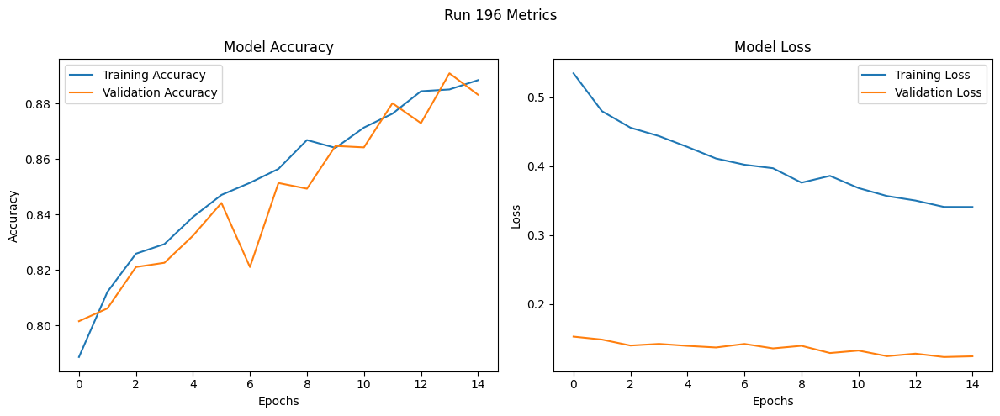

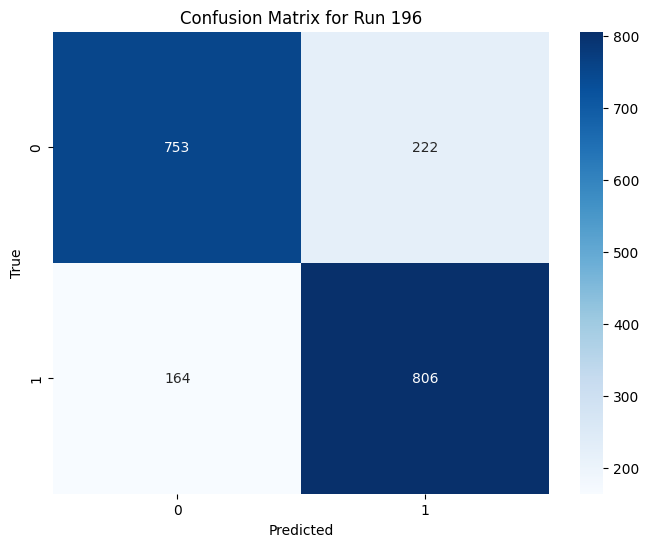

Run 197: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step - accuracy: 0.7569 - loss: 0.5789 - val_accuracy: 0.8000 - val_loss: 0.1518
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.8019 - loss: 0.4940 - val_accuracy: 0.8062 - val_loss: 0.1502
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8300 - loss: 0.4512 - val_accuracy: 0.8123 - val_loss: 0.1485
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8289 - loss: 0.4401 - val_accuracy: 0.8293 - val_loss: 0.1423
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8340 - loss: 0.4297 - val_accuracy: 0.8283 - val_loss: 0.1451
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8381 - loss: 0.4268 - val_accuracy: 0.8396 - val_loss: 0.1421
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - ac

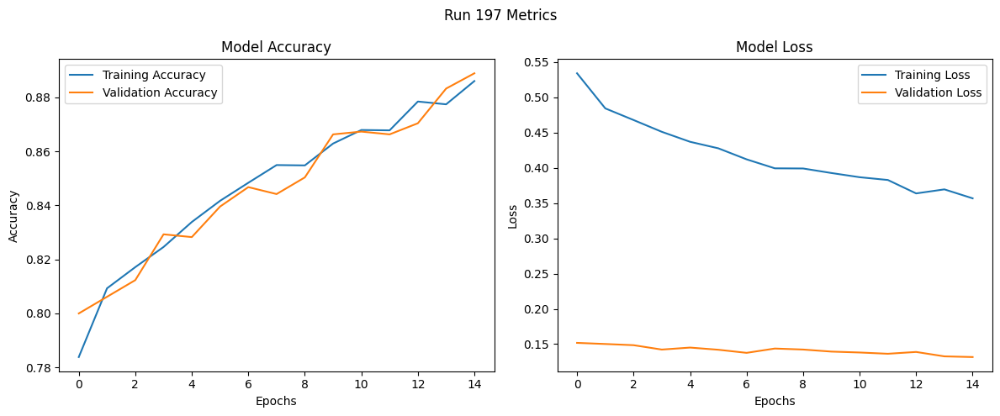

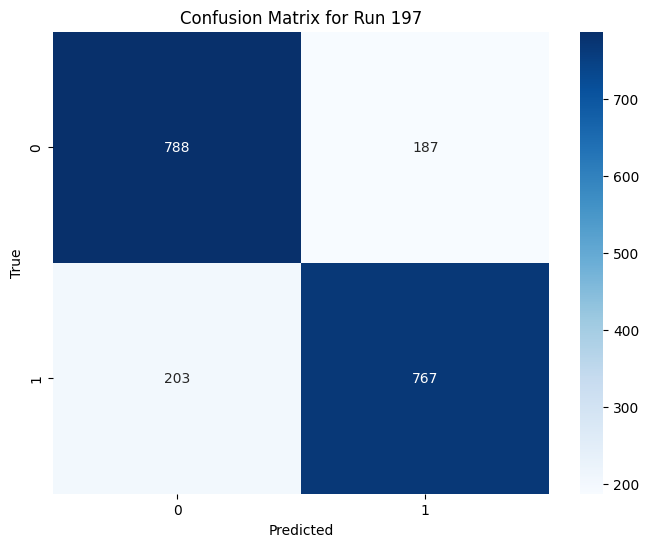

Run 198: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - accuracy: 0.7348 - loss: 0.6014 - val_accuracy: 0.7979 - val_loss: 0.1545
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8157 - loss: 0.4763 - val_accuracy: 0.8087 - val_loss: 0.1480
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8158 - loss: 0.4696 - val_accuracy: 0.8129 - val_loss: 0.1501
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8260 - loss: 0.4491 - val_accuracy: 0.8247 - val_loss: 0.1499
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8408 - loss: 0.4461 - val_accuracy: 0.8370 - val_loss: 0.1428
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8375 - loss: 0.4309 - val_accuracy: 0.8185 - val_loss: 0.1537
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accura

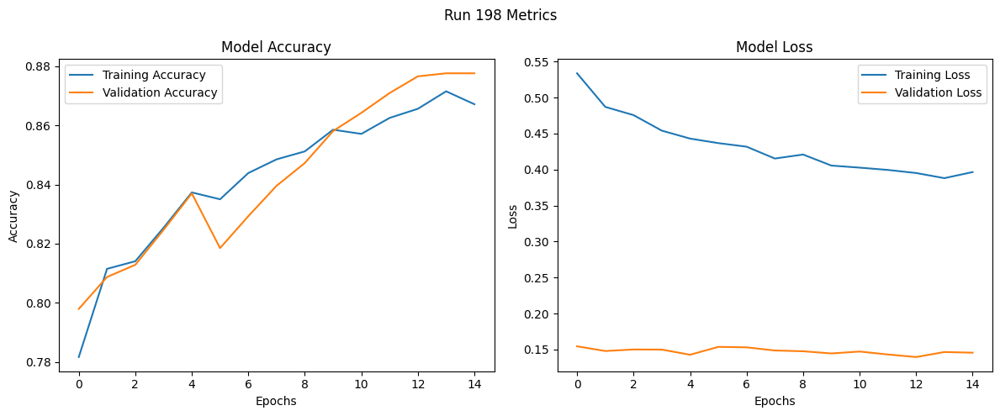

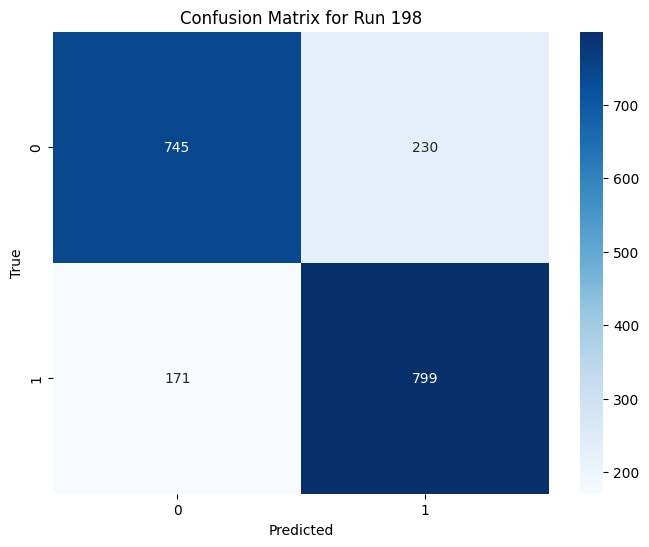

Run 199: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7527 - loss: 0.4137 - val_accuracy: 0.7599 - val_loss: 0.1687
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.8063 - loss: 0.3439 - val_accuracy: 0.8077 - val_loss: 0.1493
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8149 - loss: 0.3397 - val_accuracy: 0.8272 - val_loss: 0.1386
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8272 - loss: 0.3216 - val_accuracy: 0.8103 - val_loss: 0.1487
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8364 - loss: 0.3110 - val_accuracy: 0.8154 - val_loss: 0.1471
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8489 - loss: 0.2971 - val_accuracy: 0.8365 - val_loss: 0.1344
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - acc

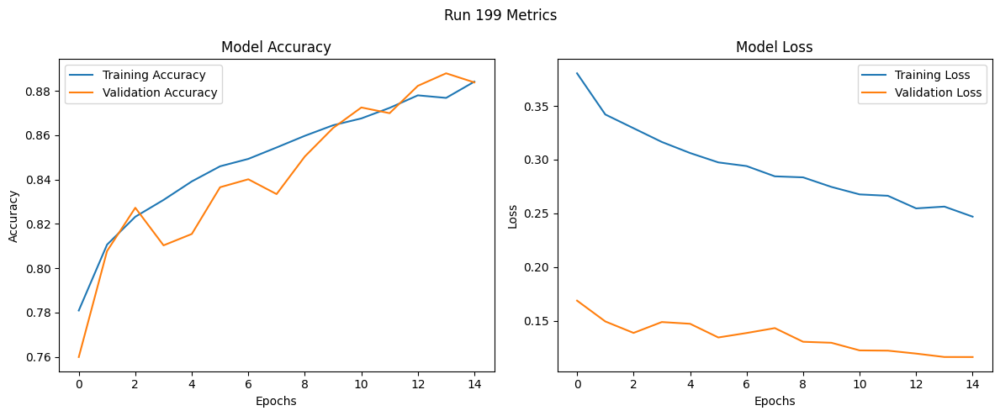

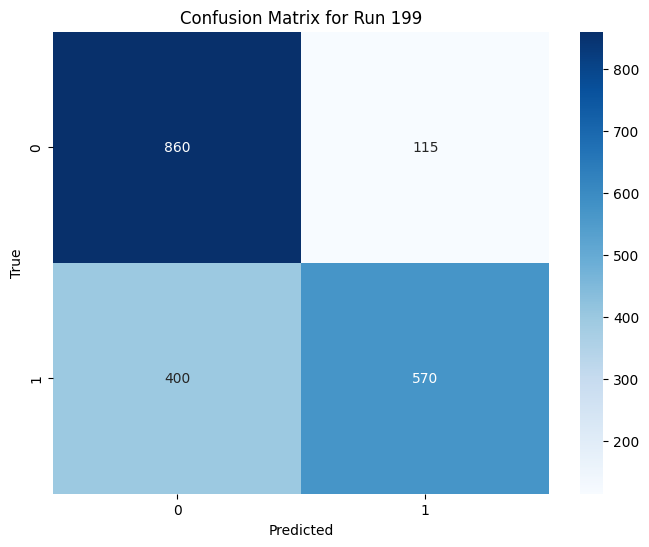

Run 200: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7525 - loss: 0.4226 - val_accuracy: 0.7974 - val_loss: 0.1539
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8068 - loss: 0.3512 - val_accuracy: 0.7995 - val_loss: 0.1537
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8233 - loss: 0.3272 - val_accuracy: 0.8087 - val_loss: 0.1509
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8252 - loss: 0.3216 - val_accuracy: 0.8180 - val_loss: 0.1526
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8324 - loss: 0.3122 - val_accuracy: 0.8267 - val_loss: 0.1482
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8429 - loss: 0.3050 - val_accuracy: 0.8355 - val_loss: 0.1414
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - acc

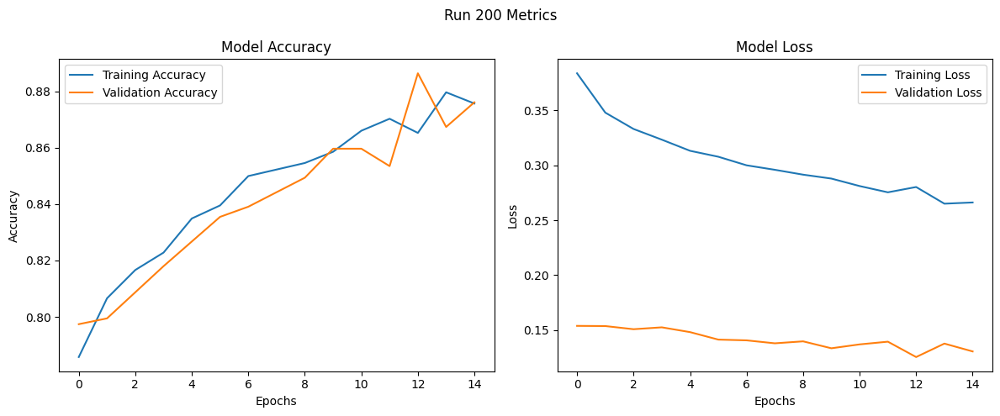

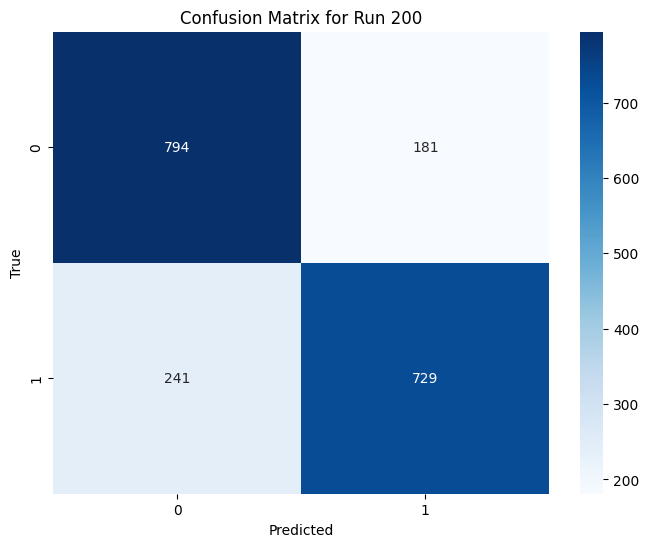

Run 201: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7571 - loss: 0.4142 - val_accuracy: 0.8015 - val_loss: 0.1516
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7958 - loss: 0.3603 - val_accuracy: 0.7820 - val_loss: 0.1681
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8197 - loss: 0.3365 - val_accuracy: 0.7913 - val_loss: 0.1571
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8256 - loss: 0.3218 - val_accuracy: 0.8329 - val_loss: 0.1444
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8409 - loss: 0.3122 - val_accuracy: 0.8139 - val_loss: 0.1577
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8425 - loss: 0.3069 - val_accuracy: 0.8406 - val_loss: 0.1441
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accur

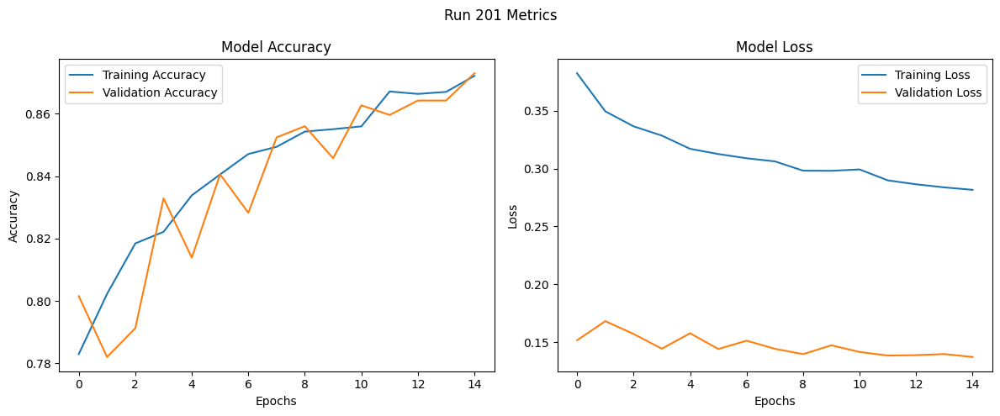

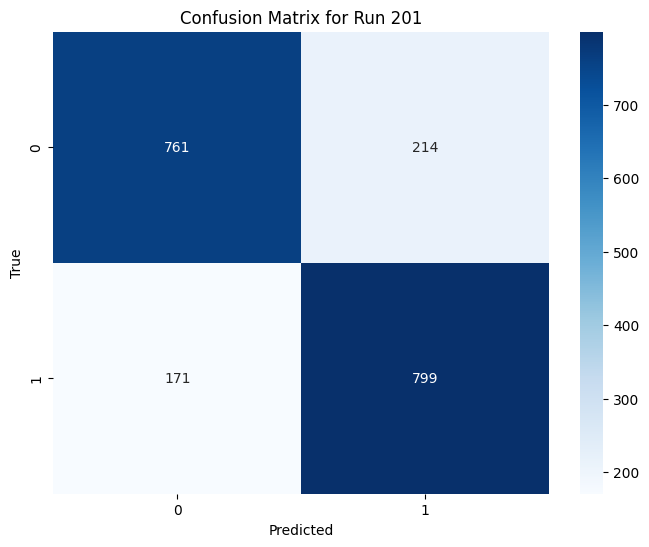

Run 202: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7523 - loss: 0.5913 - val_accuracy: 0.7743 - val_loss: 0.1631
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.8038 - loss: 0.4928 - val_accuracy: 0.7954 - val_loss: 0.1534
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8177 - loss: 0.4747 - val_accuracy: 0.8098 - val_loss: 0.1445
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8291 - loss: 0.4381 - val_accuracy: 0.8350 - val_loss: 0.1362
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8391 - loss: 0.4366 - val_accuracy: 0.8344 - val_loss: 0.1341
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8492 - loss: 0.4055 - val_accuracy: 0.8437 - val_loss: 0.1387
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - acc

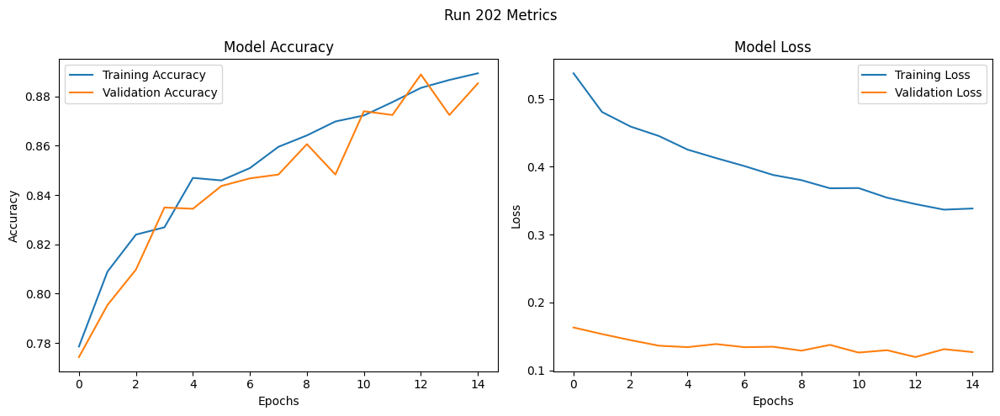

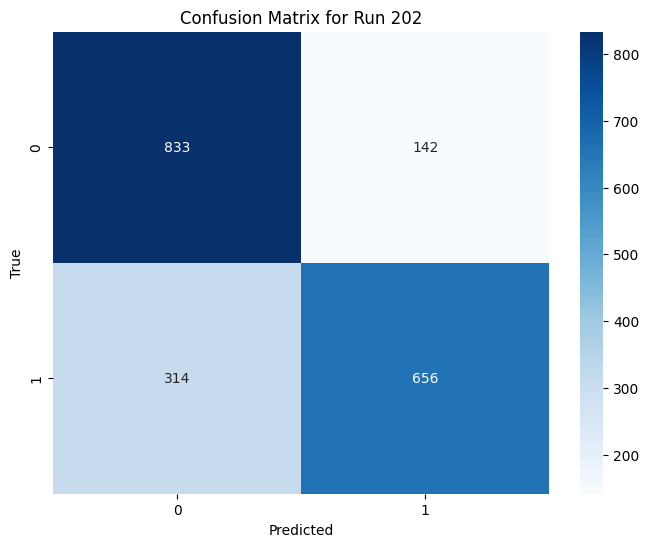

Run 203: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7616 - loss: 0.5838 - val_accuracy: 0.7897 - val_loss: 0.1574
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8010 - loss: 0.4941 - val_accuracy: 0.7990 - val_loss: 0.1509
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8198 - loss: 0.4655 - val_accuracy: 0.7990 - val_loss: 0.1517
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8218 - loss: 0.4683 - val_accuracy: 0.8206 - val_loss: 0.1417
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8320 - loss: 0.4387 - val_accuracy: 0.8339 - val_loss: 0.1394
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8411 - loss: 0.4314 - val_accuracy: 0.8494 - val_loss: 0.1413
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - ac

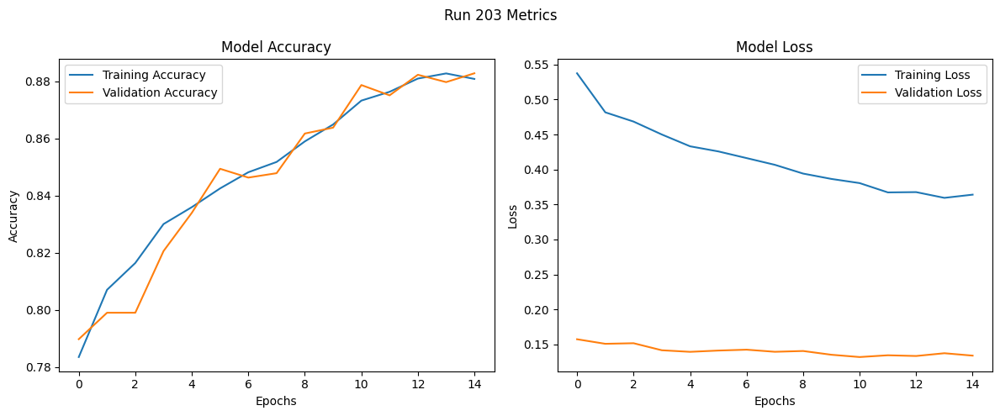

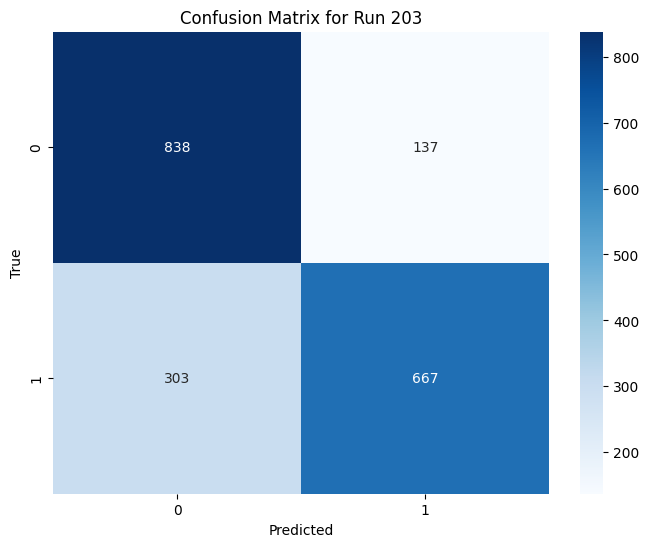

Run 204: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - accuracy: 0.7515 - loss: 0.5961 - val_accuracy: 0.7949 - val_loss: 0.1529
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8092 - loss: 0.4939 - val_accuracy: 0.8098 - val_loss: 0.1522
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8238 - loss: 0.4711 - val_accuracy: 0.8108 - val_loss: 0.1533
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8352 - loss: 0.4450 - val_accuracy: 0.8375 - val_loss: 0.1441
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8316 - loss: 0.4513 - val_accuracy: 0.8365 - val_loss: 0.1476
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8458 - loss: 0.4285 - val_accuracy: 0.8566 - val_loss: 0.1441
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accur

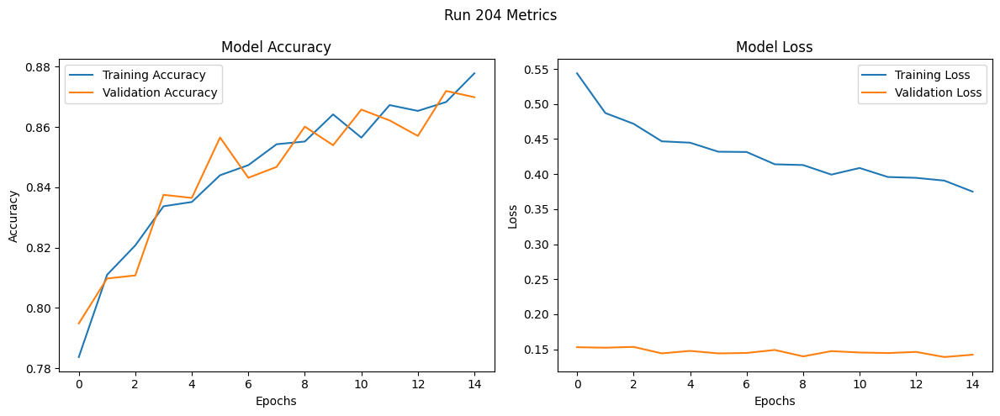

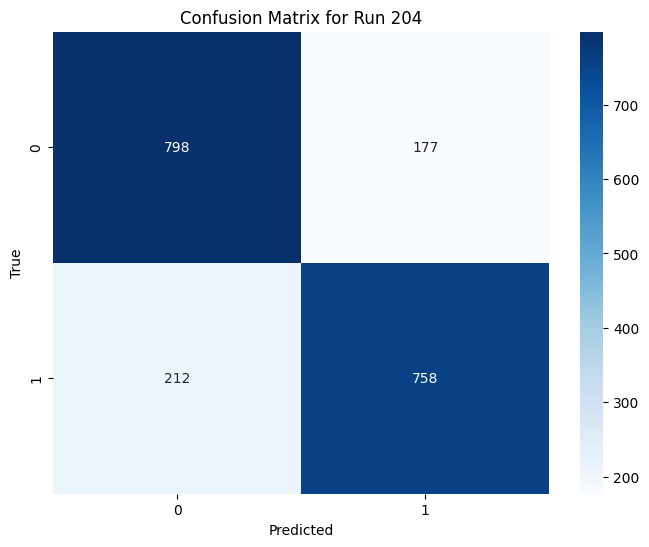

Run 205: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 5s 13ms/step - accuracy: 0.7510 - loss: 0.2011 - val_accuracy: 0.8041 - val_loss: 0.0747
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8044 - loss: 0.1667 - val_accuracy: 0.8072 - val_loss: 0.0712
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8253 - loss: 0.1518 - val_accuracy: 0.8021 - val_loss: 0.0725
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8204 - loss: 0.1557 - val_accuracy: 0.7933 - val_loss: 0.0774
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8323 - loss: 0.1489 - val_accuracy: 0.8123 - val_loss: 0.0695
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8402 - loss: 0.1422 - val_accuracy: 0.8344 - val_loss: 0.0688
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.846

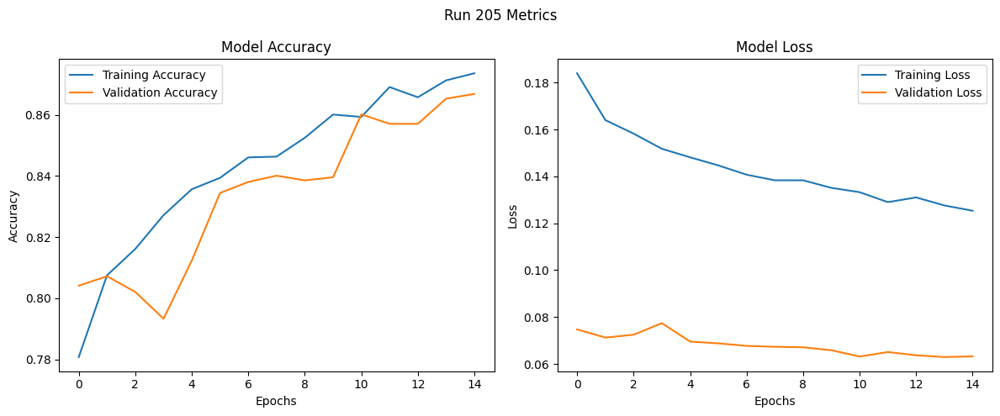

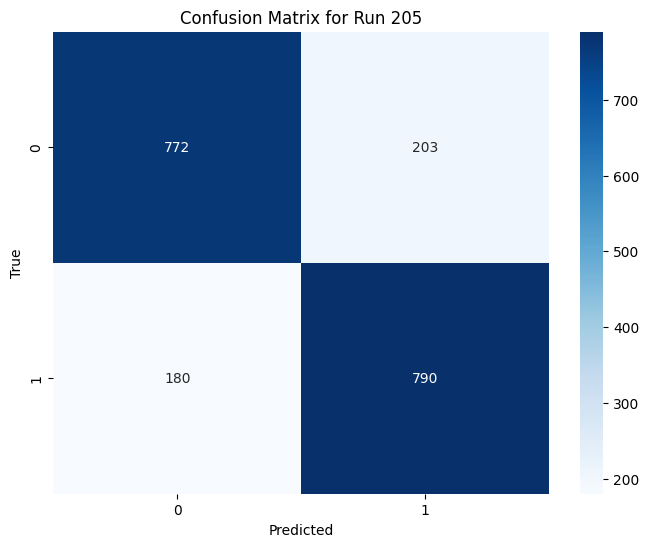

Run 206: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7625 - loss: 0.2019 - val_accuracy: 0.8000 - val_loss: 0.0755
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8034 - loss: 0.1668 - val_accuracy: 0.7851 - val_loss: 0.0775
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8125 - loss: 0.1607 - val_accuracy: 0.8134 - val_loss: 0.0698
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8263 - loss: 0.1558 - val_accuracy: 0.8118 - val_loss: 0.0717
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8326 - loss: 0.1495 - val_accuracy: 0.8283 - val_loss: 0.0705
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8384 - loss: 0.1482 - val_accuracy: 0.8360 - val_loss: 0.0701
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8

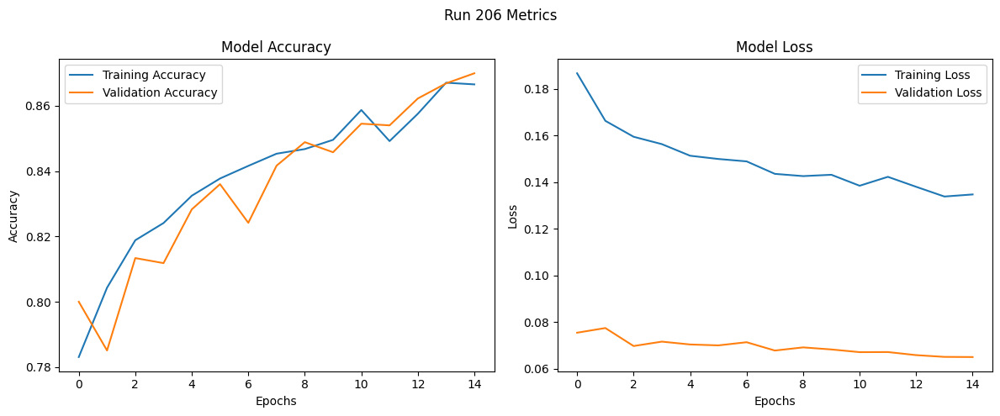

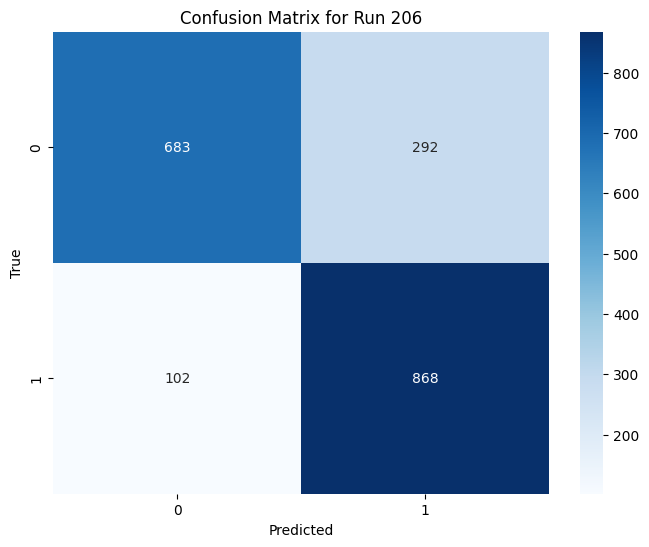

Run 207: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7593 - loss: 0.2051 - val_accuracy: 0.7871 - val_loss: 0.0765
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.7988 - loss: 0.1703 - val_accuracy: 0.8005 - val_loss: 0.0746
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8166 - loss: 0.1648 - val_accuracy: 0.8180 - val_loss: 0.0713
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8117 - loss: 0.1598 - val_accuracy: 0.8144 - val_loss: 0.0719
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8271 - loss: 0.1525 - val_accuracy: 0.8278 - val_loss: 0.0719
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8335 - loss: 0.1516 - val_accuracy: 0.8195 - val_loss: 0.0756
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8321

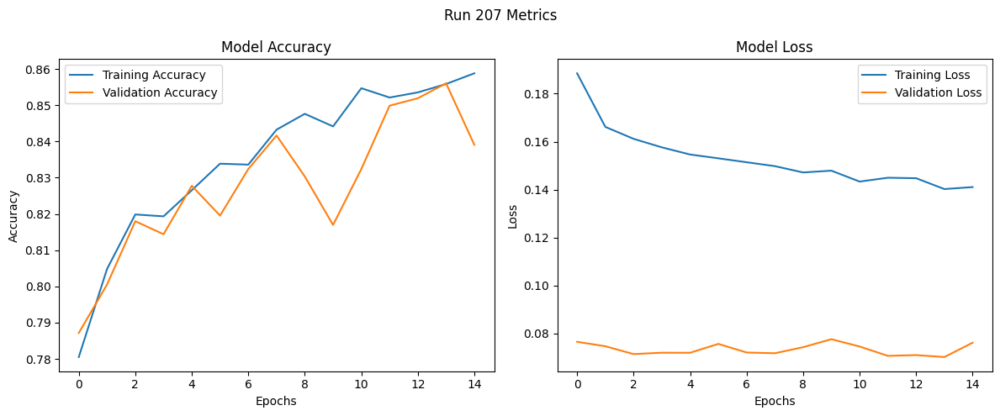

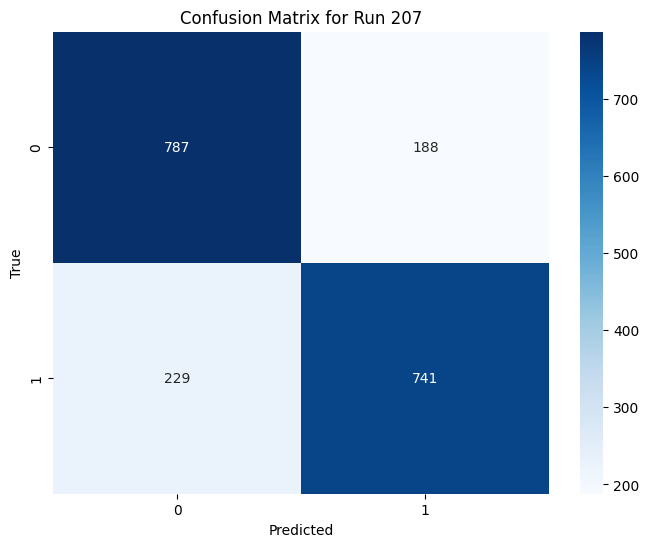

Run 208: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7515 - loss: 0.2799 - val_accuracy: 0.7964 - val_loss: 0.0745
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8024 - loss: 0.2315 - val_accuracy: 0.7769 - val_loss: 0.0781
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8141 - loss: 0.2224 - val_accuracy: 0.8190 - val_loss: 0.0701
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8362 - loss: 0.2036 - val_accuracy: 0.8252 - val_loss: 0.0698
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8487 - loss: 0.1976 - val_accuracy: 0.8375 - val_loss: 0.0687
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8420 - loss: 0.1967 - val_accuracy: 0.8293 - val_loss: 0.0690
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.843

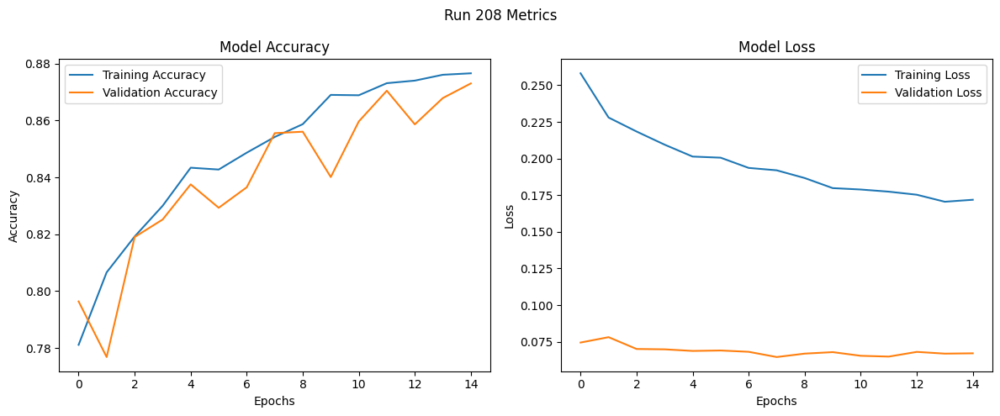

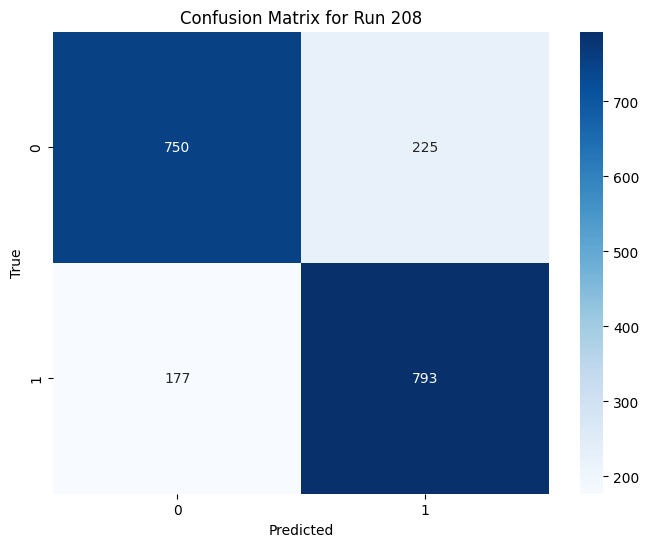

Run 209: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step - accuracy: 0.7573 - loss: 0.2824 - val_accuracy: 0.8031 - val_loss: 0.0764
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8061 - loss: 0.2395 - val_accuracy: 0.7835 - val_loss: 0.0774
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8164 - loss: 0.2262 - val_accuracy: 0.8175 - val_loss: 0.0716
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8159 - loss: 0.2234 - val_accuracy: 0.8185 - val_loss: 0.0724
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8271 - loss: 0.2181 - val_accuracy: 0.8216 - val_loss: 0.0730
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8429 - loss: 0.2053 - val_accuracy: 0.8422 - val_loss: 0.0711
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.85

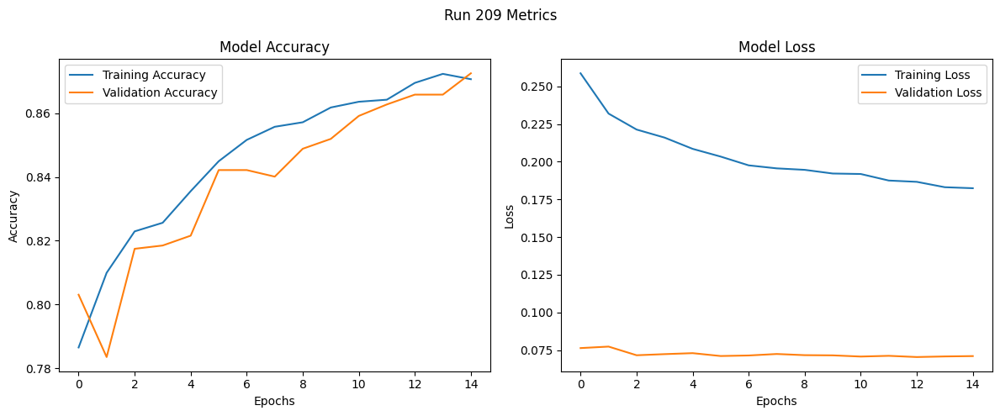

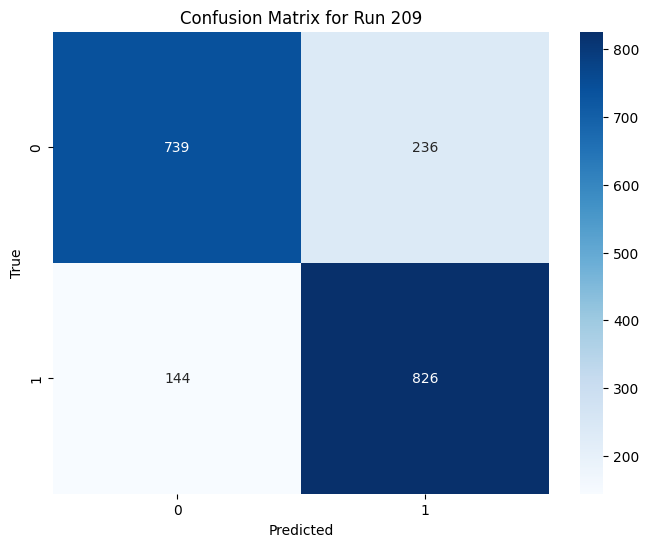

Run 210: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7532 - loss: 0.2835 - val_accuracy: 0.8067 - val_loss: 0.0759
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.8132 - loss: 0.2226 - val_accuracy: 0.8051 - val_loss: 0.0754
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8169 - loss: 0.2203 - val_accuracy: 0.8201 - val_loss: 0.0745
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8250 - loss: 0.2226 - val_accuracy: 0.8129 - val_loss: 0.0776
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8272 - loss: 0.2153 - val_accuracy: 0.8293 - val_loss: 0.0765
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8330 - loss: 0.2197 - val_accuracy: 0.8334 - val_loss: 0.0776
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8467

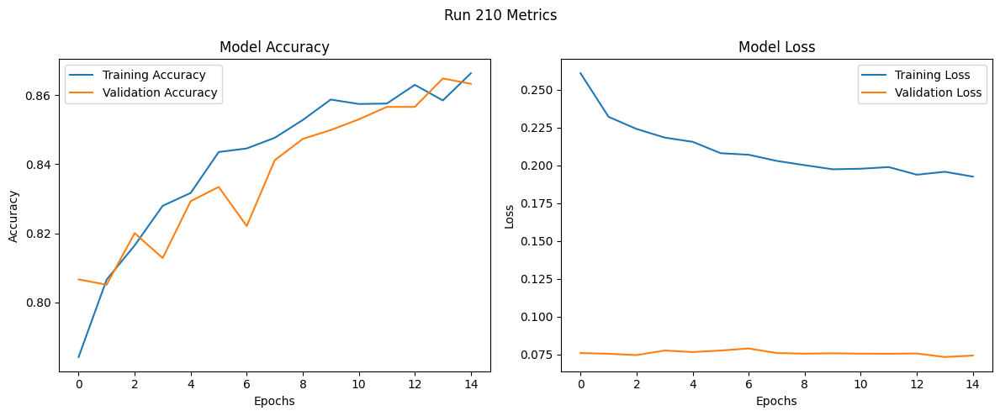

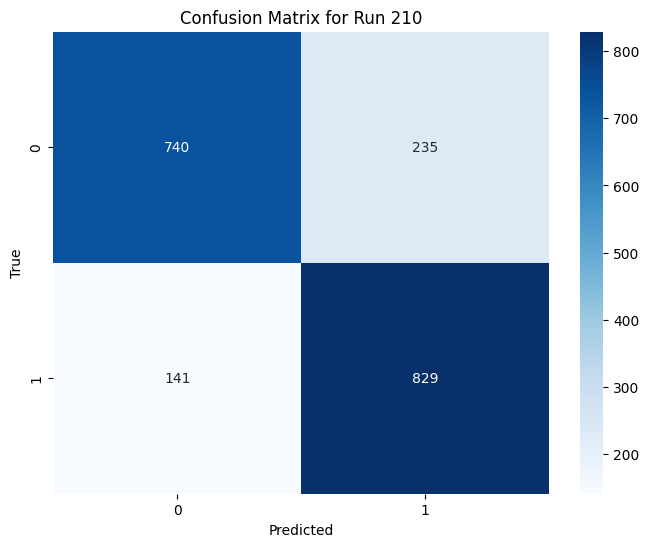

Run 211: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7539 - loss: 0.2008 - val_accuracy: 0.7995 - val_loss: 0.0742
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8025 - loss: 0.1707 - val_accuracy: 0.8098 - val_loss: 0.0712
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8037 - loss: 0.1621 - val_accuracy: 0.8005 - val_loss: 0.0753
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8179 - loss: 0.1587 - val_accuracy: 0.8154 - val_loss: 0.0705
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8251 - loss: 0.1508 - val_accuracy: 0.8267 - val_loss: 0.0677
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8344 - loss: 0.1466 - val_accuracy: 0.8201 - val_loss: 0.0713
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8

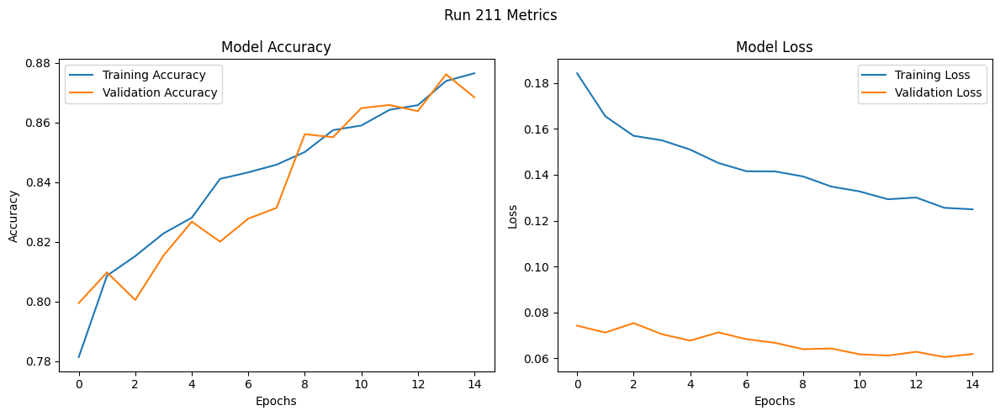

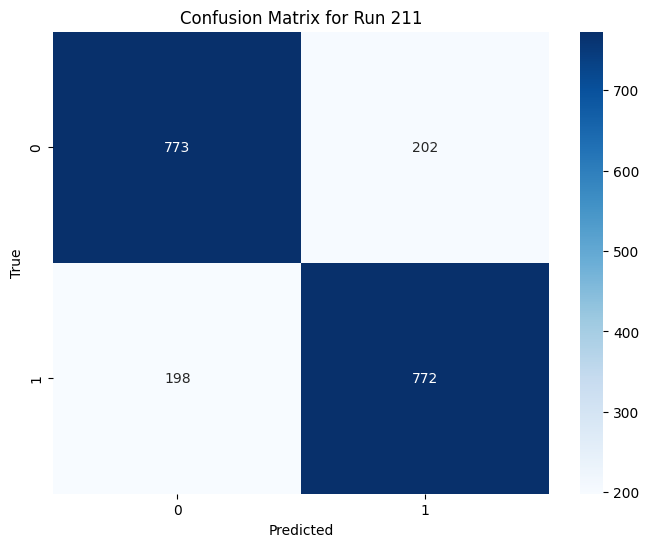

Run 212: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7422 - loss: 0.2060 - val_accuracy: 0.8015 - val_loss: 0.0742
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8057 - loss: 0.1661 - val_accuracy: 0.7990 - val_loss: 0.0730
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8193 - loss: 0.1592 - val_accuracy: 0.8072 - val_loss: 0.0715
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8218 - loss: 0.1544 - val_accuracy: 0.8108 - val_loss: 0.0705
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8319 - loss: 0.1493 - val_accuracy: 0.8144 - val_loss: 0.0723
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8333 - loss: 0.1461 - val_accuracy: 0.7979 - val_loss: 0.0787
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8

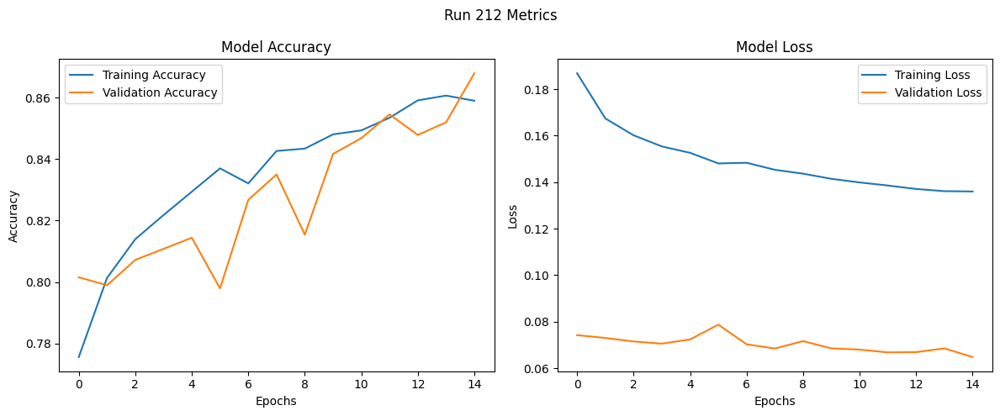

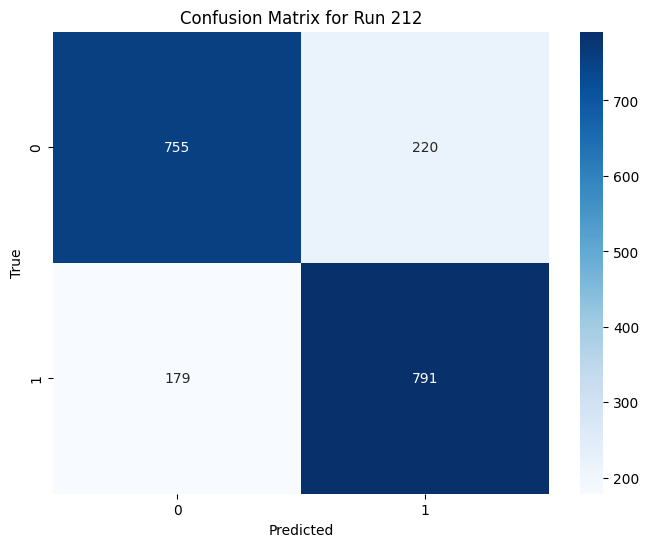

Run 213: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7509 - loss: 0.2018 - val_accuracy: 0.7969 - val_loss: 0.0757
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8032 - loss: 0.1700 - val_accuracy: 0.8129 - val_loss: 0.0725
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7990 - loss: 0.1665 - val_accuracy: 0.7959 - val_loss: 0.0768
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8129 - loss: 0.1667 - val_accuracy: 0.8159 - val_loss: 0.0740
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8233 - loss: 0.1579 - val_accuracy: 0.8206 - val_loss: 0.0719
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8304 - loss: 0.1564 - val_accuracy: 0.8144 - val_loss: 0.0735
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.827

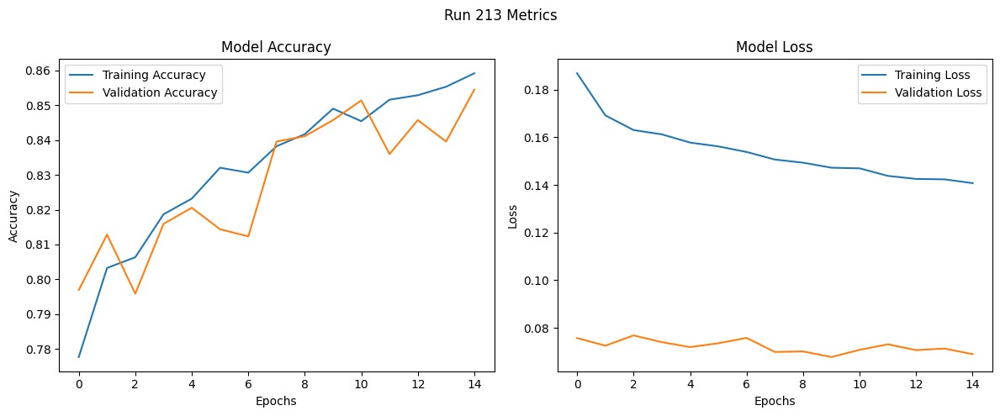

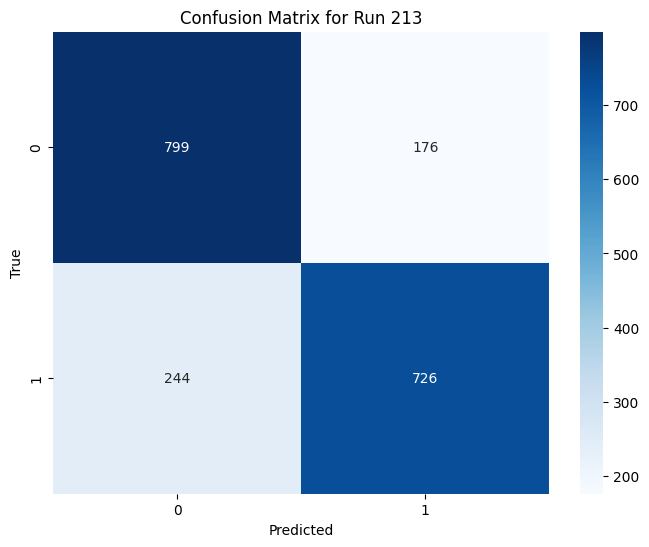

Run 214: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7619 - loss: 0.2787 - val_accuracy: 0.7995 - val_loss: 0.0746
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7998 - loss: 0.2359 - val_accuracy: 0.7943 - val_loss: 0.0759
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8123 - loss: 0.2258 - val_accuracy: 0.8129 - val_loss: 0.0705
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8272 - loss: 0.2124 - val_accuracy: 0.8226 - val_loss: 0.0696
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8294 - loss: 0.2084 - val_accuracy: 0.8308 - val_loss: 0.0691
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8488 - loss: 0.1938 - val_accuracy: 0.8195 - val_loss: 0.0727
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.84

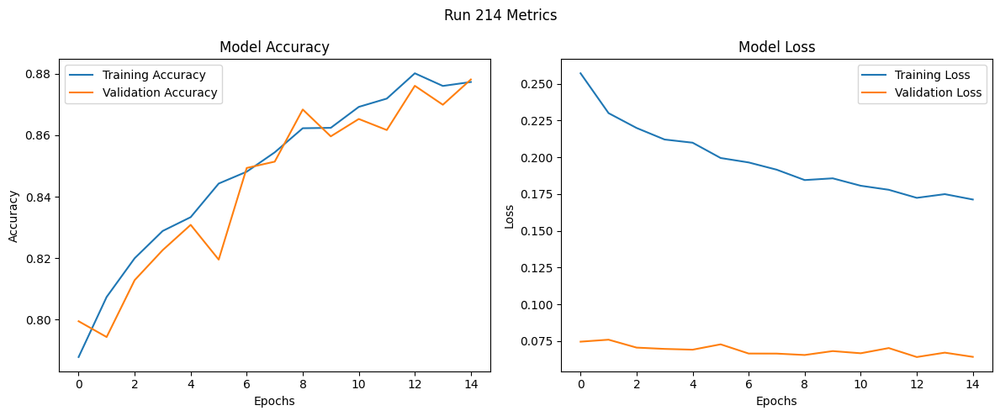

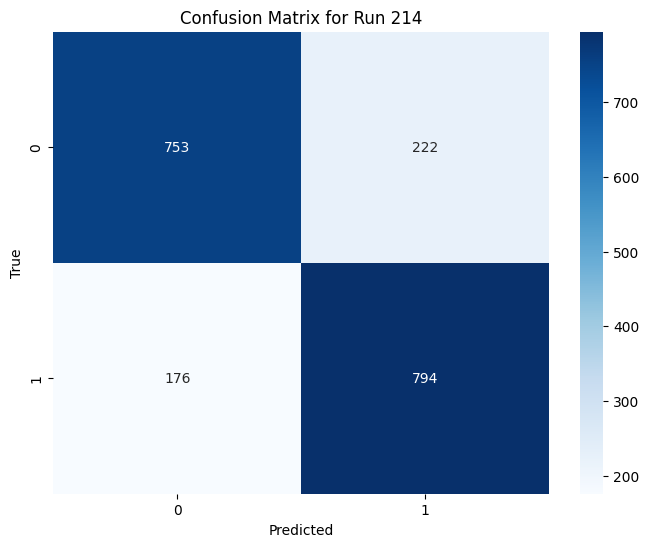

Run 215: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7629 - loss: 0.2802 - val_accuracy: 0.7913 - val_loss: 0.0777
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8150 - loss: 0.2284 - val_accuracy: 0.7943 - val_loss: 0.0770
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8111 - loss: 0.2281 - val_accuracy: 0.8237 - val_loss: 0.0728
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8177 - loss: 0.2264 - val_accuracy: 0.8329 - val_loss: 0.0710
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8261 - loss: 0.2186 - val_accuracy: 0.8206 - val_loss: 0.0745
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8430 - loss: 0.2040 - val_accuracy: 0.8247 - val_loss: 0.0720
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8

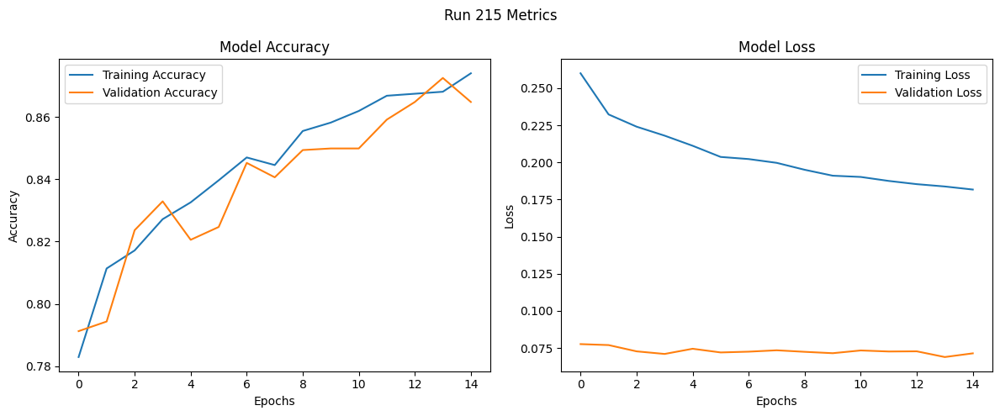

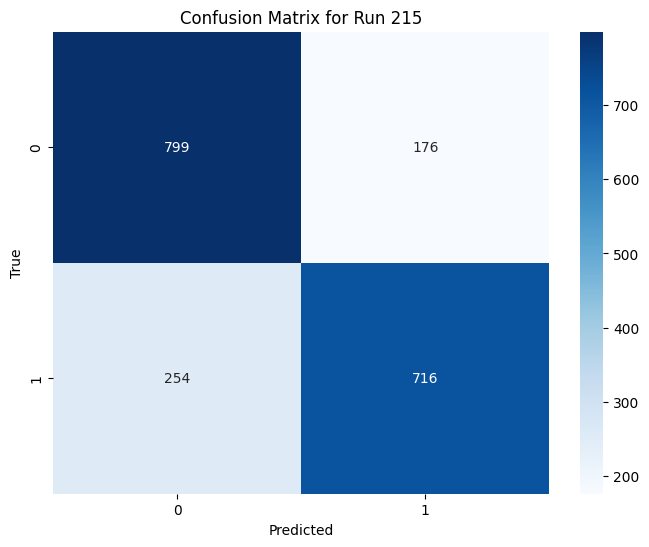

Run 216: L2: 5e-05, Dropout: 0.25, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7521 - loss: 0.2866 - val_accuracy: 0.7959 - val_loss: 0.0761
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8047 - loss: 0.2367 - val_accuracy: 0.8072 - val_loss: 0.0749
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8135 - loss: 0.2292 - val_accuracy: 0.8082 - val_loss: 0.0763
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8279 - loss: 0.2156 - val_accuracy: 0.8175 - val_loss: 0.0747
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8245 - loss: 0.2213 - val_accuracy: 0.8082 - val_loss: 0.0780
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8395 - loss: 0.2113 - val_accuracy: 0.8226 - val_loss: 0.0754
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.834

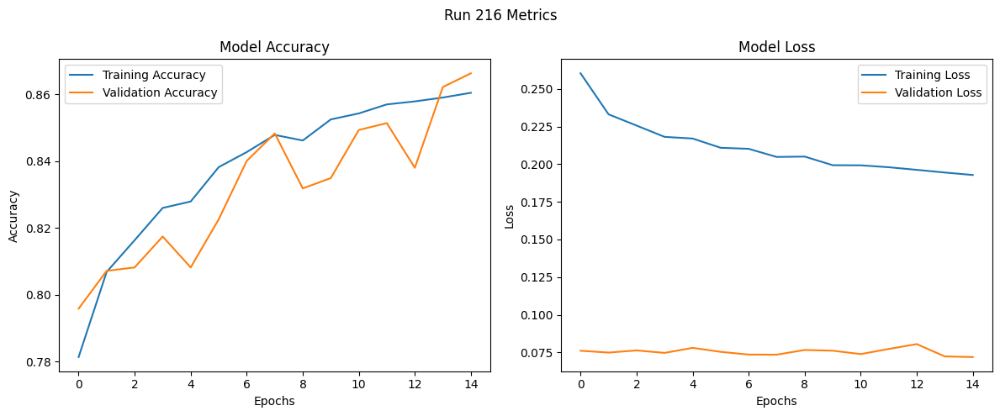

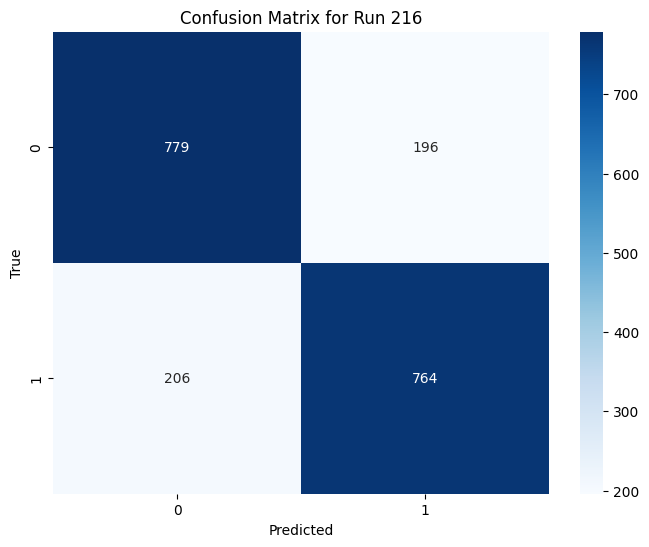

Run 217: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7303 - loss: 1.2503 - val_accuracy: 0.7928 - val_loss: 0.4519
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8018 - loss: 1.0396 - val_accuracy: 0.8087 - val_loss: 0.4293
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8250 - loss: 0.9714 - val_accuracy: 0.8031 - val_loss: 0.4342
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8255 - loss: 0.9496 - val_accuracy: 0.8278 - val_loss: 0.3795
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8327 - loss: 0.9127 - val_accuracy: 0.8293 - val_loss: 0.3828
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8363 - loss: 0.9134 - val_accuracy: 0.8308 - val_loss: 0.3799
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - ac

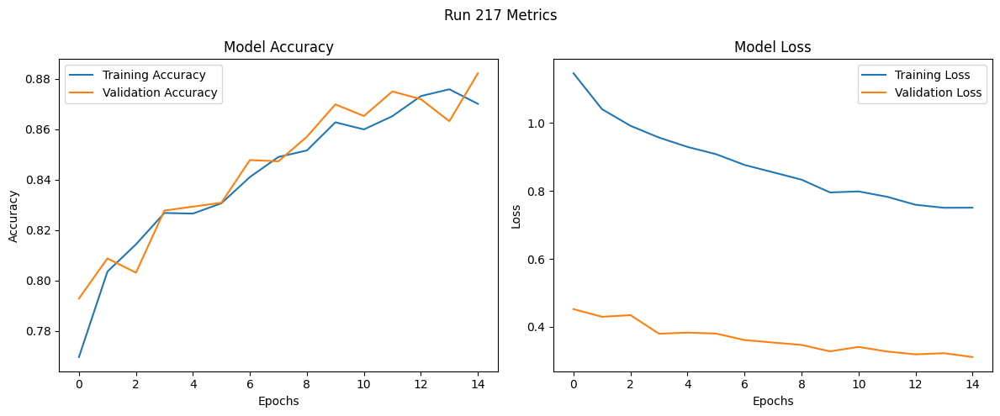

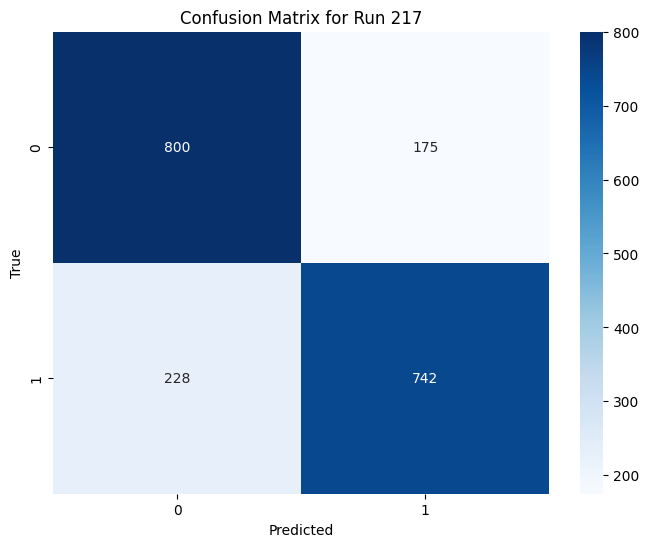

Run 218: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7506 - loss: 1.2353 - val_accuracy: 0.7882 - val_loss: 0.4454
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8020 - loss: 1.0445 - val_accuracy: 0.7609 - val_loss: 0.4586
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8085 - loss: 1.0072 - val_accuracy: 0.8154 - val_loss: 0.4047
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8158 - loss: 0.9643 - val_accuracy: 0.8226 - val_loss: 0.3942
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8216 - loss: 0.9524 - val_accuracy: 0.8314 - val_loss: 0.3941
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8249 - loss: 0.9381 - val_accuracy: 0.8339 - val_loss: 0.3758
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - a

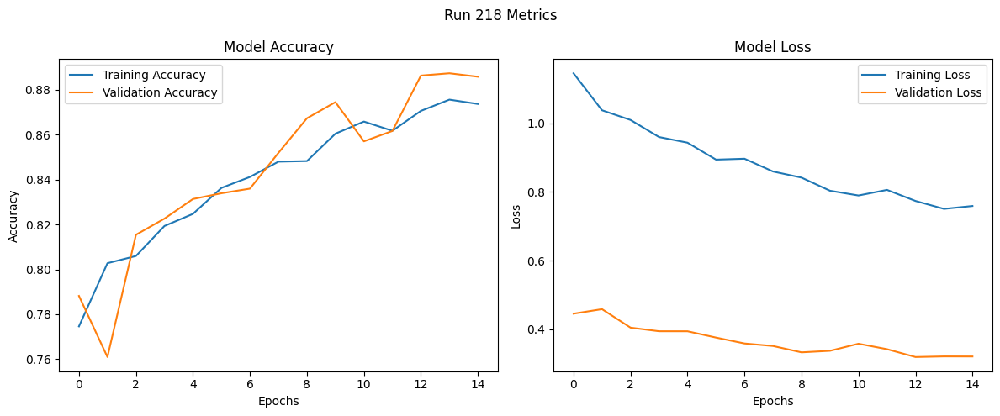

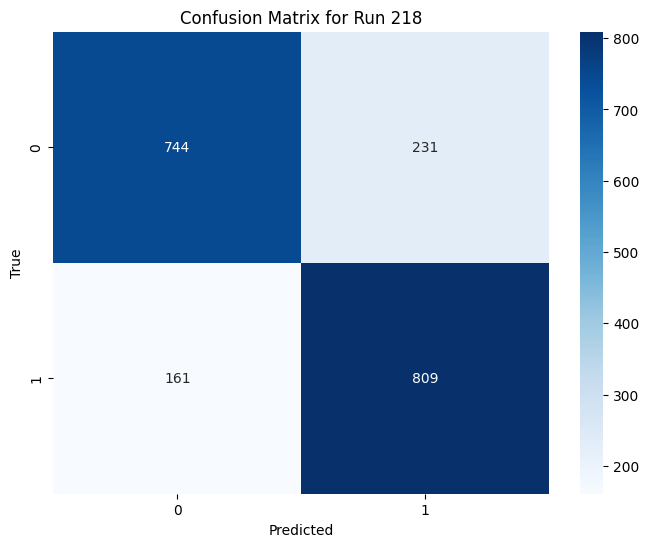

Run 219: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7474 - loss: 1.2385 - val_accuracy: 0.7851 - val_loss: 0.4483
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7993 - loss: 1.0581 - val_accuracy: 0.7928 - val_loss: 0.4494
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8023 - loss: 1.0353 - val_accuracy: 0.8221 - val_loss: 0.4108
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8218 - loss: 0.9869 - val_accuracy: 0.8211 - val_loss: 0.4045
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8229 - loss: 0.9479 - val_accuracy: 0.8350 - val_loss: 0.4003
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8394 - loss: 0.9125 - val_accuracy: 0.8432 - val_loss: 0.3757
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - acc

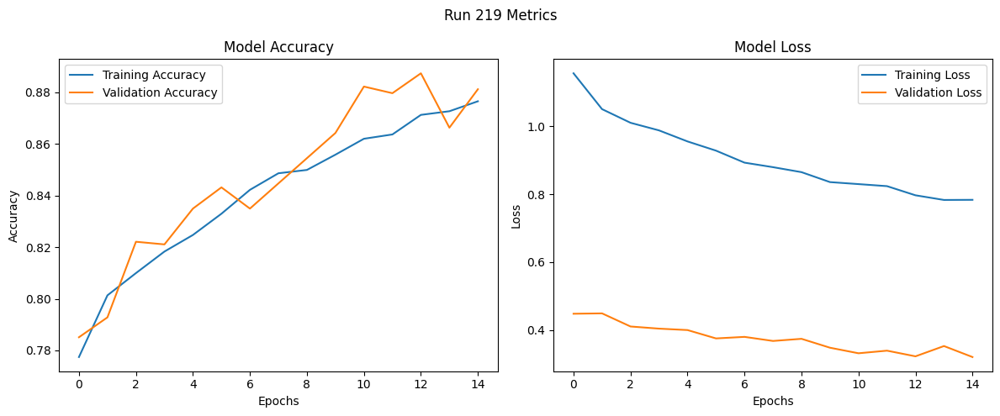

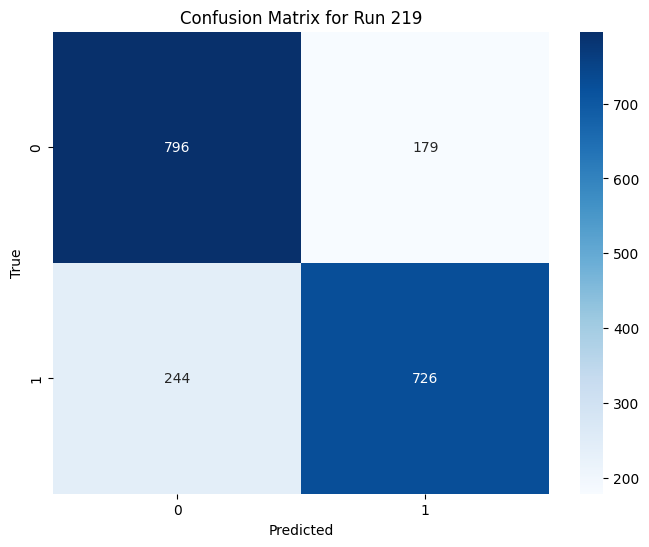

Run 220: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7423 - loss: 1.7413 - val_accuracy: 0.8010 - val_loss: 0.4344
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8075 - loss: 1.4543 - val_accuracy: 0.8134 - val_loss: 0.4126
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8126 - loss: 1.4300 - val_accuracy: 0.8190 - val_loss: 0.3931
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8305 - loss: 1.3288 - val_accuracy: 0.8231 - val_loss: 0.3859
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8344 - loss: 1.2709 - val_accuracy: 0.8298 - val_loss: 0.3721
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8382 - loss: 1.2381 - val_accuracy: 0.8406 - val_loss: 0.3636
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - ac

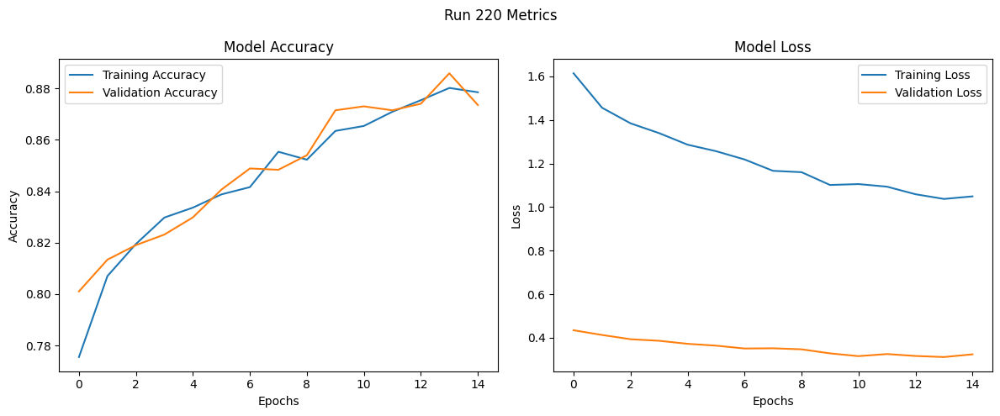

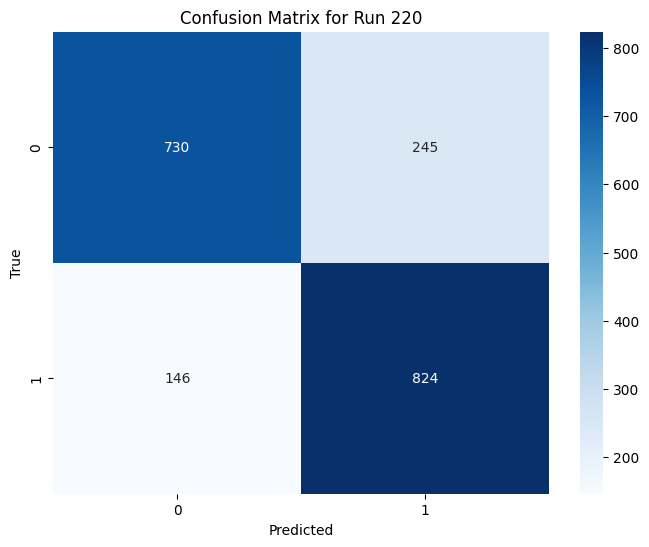

Run 221: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7441 - loss: 1.7592 - val_accuracy: 0.7871 - val_loss: 0.4516
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8047 - loss: 1.4679 - val_accuracy: 0.7974 - val_loss: 0.4237
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8213 - loss: 1.4149 - val_accuracy: 0.8206 - val_loss: 0.4099
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8170 - loss: 1.4147 - val_accuracy: 0.8252 - val_loss: 0.3907
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8316 - loss: 1.3156 - val_accuracy: 0.8123 - val_loss: 0.4165
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8261 - loss: 1.3058 - val_accuracy: 0.8360 - val_loss: 0.3771
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - a

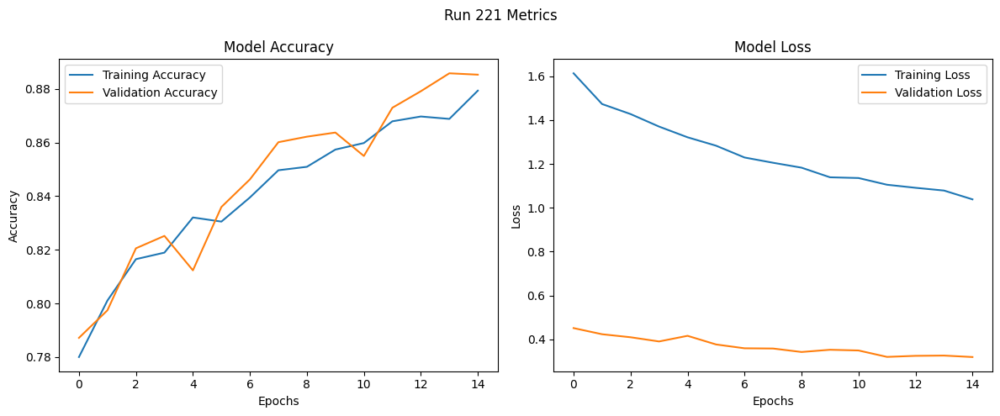

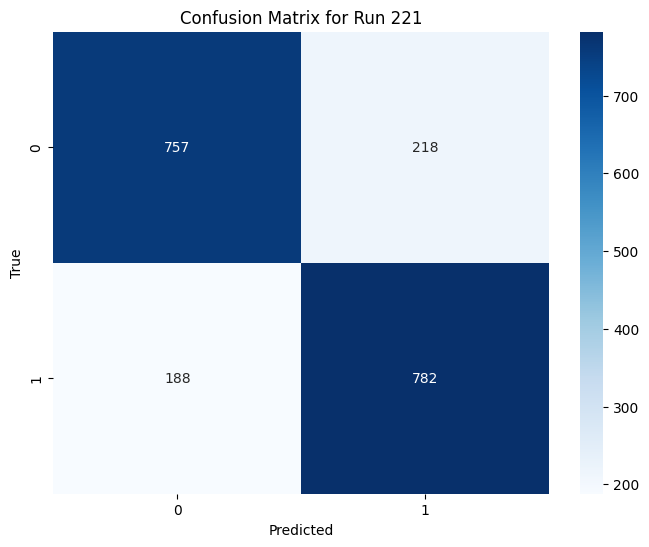

Run 222: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7472 - loss: 1.7228 - val_accuracy: 0.7928 - val_loss: 0.4405
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7954 - loss: 1.4725 - val_accuracy: 0.8093 - val_loss: 0.4242
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8146 - loss: 1.4009 - val_accuracy: 0.8123 - val_loss: 0.4084
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8216 - loss: 1.3743 - val_accuracy: 0.8139 - val_loss: 0.4022
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8320 - loss: 1.2918 - val_accuracy: 0.8339 - val_loss: 0.3752
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8428 - loss: 1.2785 - val_accuracy: 0.8452 - val_loss: 0.3718
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - acc

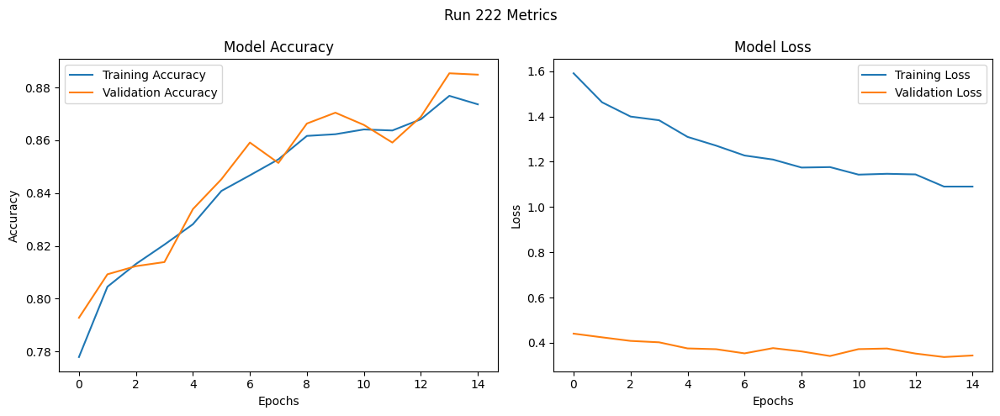

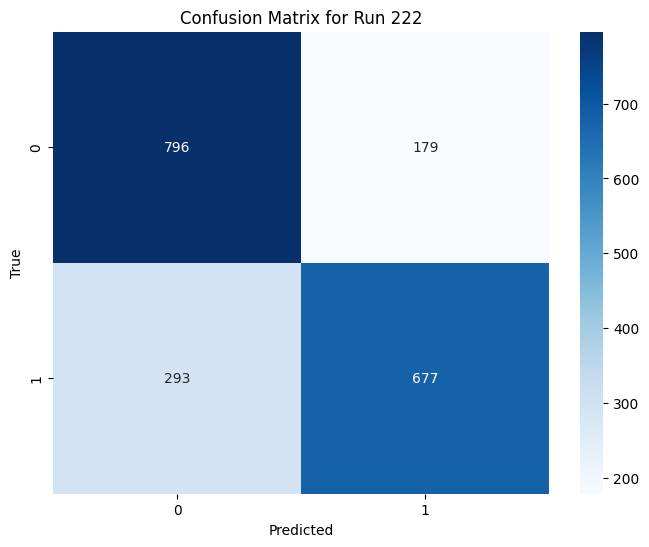

Run 223: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7437 - loss: 1.2296 - val_accuracy: 0.8015 - val_loss: 0.4405
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7986 - loss: 1.0484 - val_accuracy: 0.7902 - val_loss: 0.4400
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8018 - loss: 1.0317 - val_accuracy: 0.8077 - val_loss: 0.4122
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8160 - loss: 0.9753 - val_accuracy: 0.8308 - val_loss: 0.3860
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8304 - loss: 0.9275 - val_accuracy: 0.8159 - val_loss: 0.3941
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8338 - loss: 0.9077 - val_accuracy: 0.8308 - val_loss: 0.3687
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - a

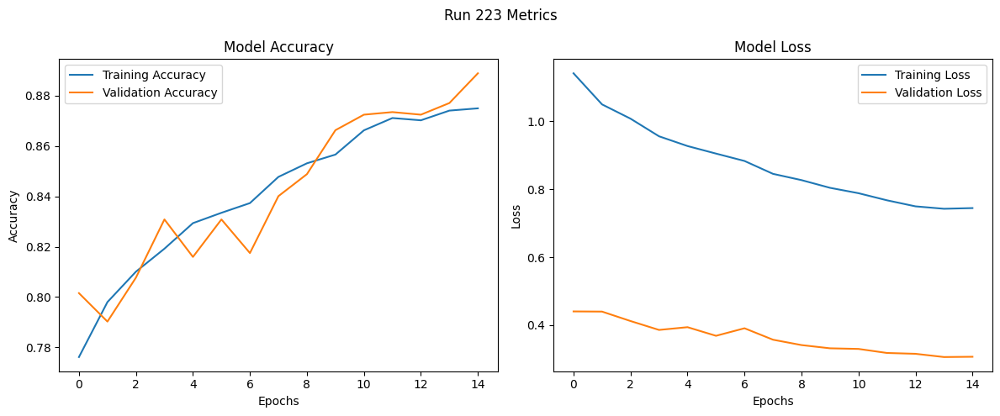

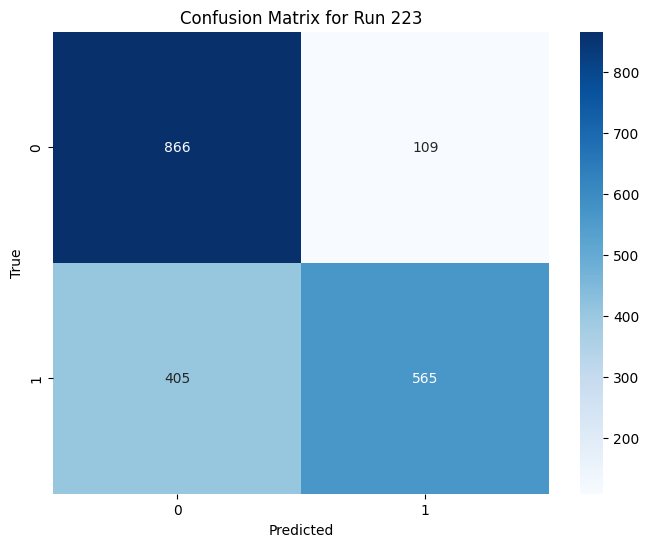

Run 224: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7418 - loss: 1.2339 - val_accuracy: 0.7969 - val_loss: 0.4410
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7991 - loss: 1.0593 - val_accuracy: 0.7907 - val_loss: 0.4258
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8070 - loss: 1.0068 - val_accuracy: 0.8098 - val_loss: 0.4085
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8245 - loss: 0.9630 - val_accuracy: 0.8231 - val_loss: 0.4014
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8268 - loss: 0.9480 - val_accuracy: 0.8057 - val_loss: 0.4205
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8307 - loss: 0.9156 - val_accuracy: 0.8319 - val_loss: 0.3769
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - 

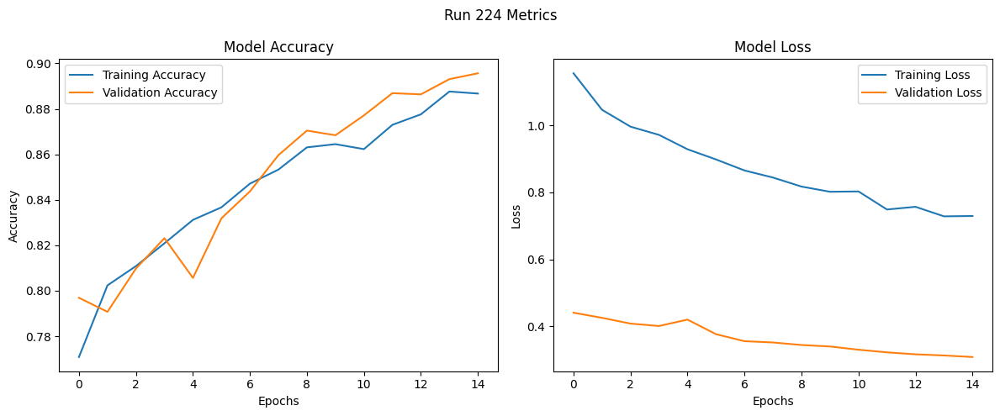

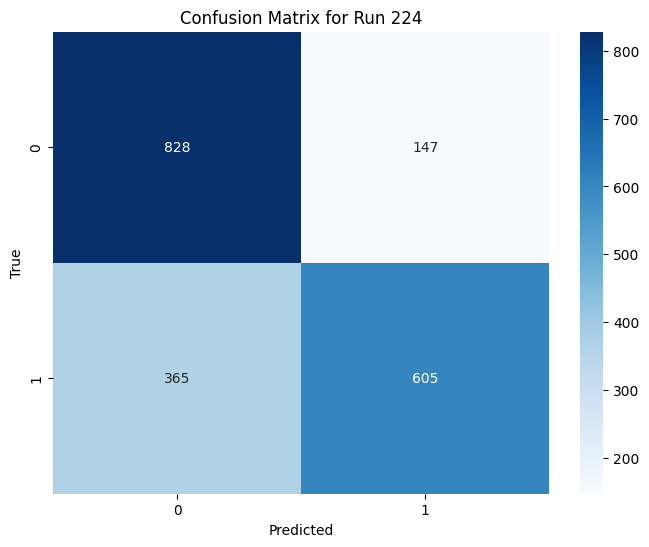

Run 225: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7590 - loss: 1.1996 - val_accuracy: 0.7805 - val_loss: 0.4626
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7965 - loss: 1.0701 - val_accuracy: 0.7933 - val_loss: 0.4266
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8156 - loss: 0.9939 - val_accuracy: 0.8149 - val_loss: 0.4120
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8048 - loss: 1.0209 - val_accuracy: 0.8247 - val_loss: 0.3980
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8282 - loss: 0.9382 - val_accuracy: 0.8334 - val_loss: 0.3829
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8347 - loss: 0.9005 - val_accuracy: 0.8350 - val_loss: 0.3740
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - ac

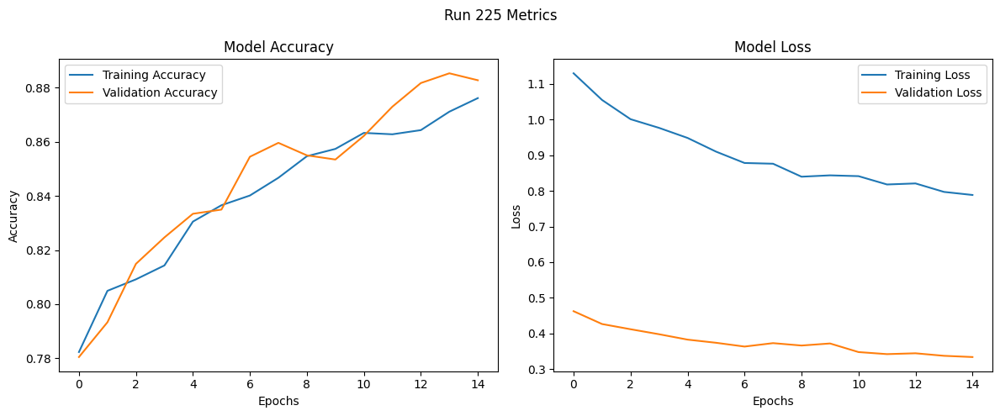

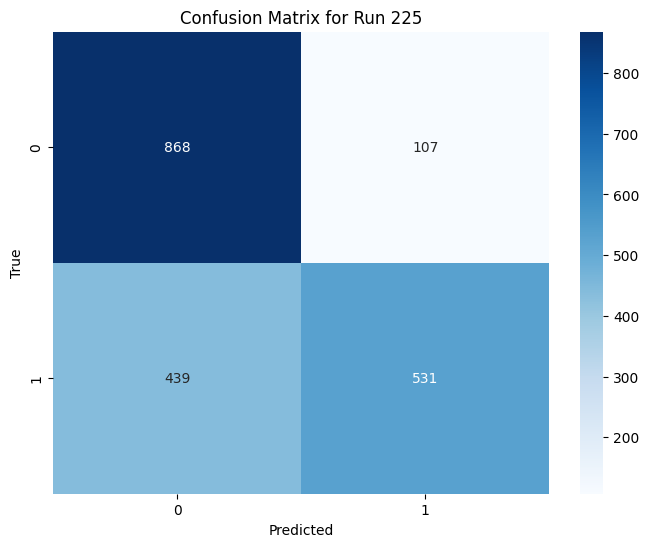

Run 226: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.7535 - loss: 1.7534 - val_accuracy: 0.7789 - val_loss: 0.4530
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8016 - loss: 1.4801 - val_accuracy: 0.8098 - val_loss: 0.4228
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8163 - loss: 1.4133 - val_accuracy: 0.8206 - val_loss: 0.4186
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8276 - loss: 1.3865 - val_accuracy: 0.8144 - val_loss: 0.4108
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8222 - loss: 1.3468 - val_accuracy: 0.8396 - val_loss: 0.3816
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8378 - loss: 1.2700 - val_accuracy: 0.8231 - val_loss: 0.3854
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - a

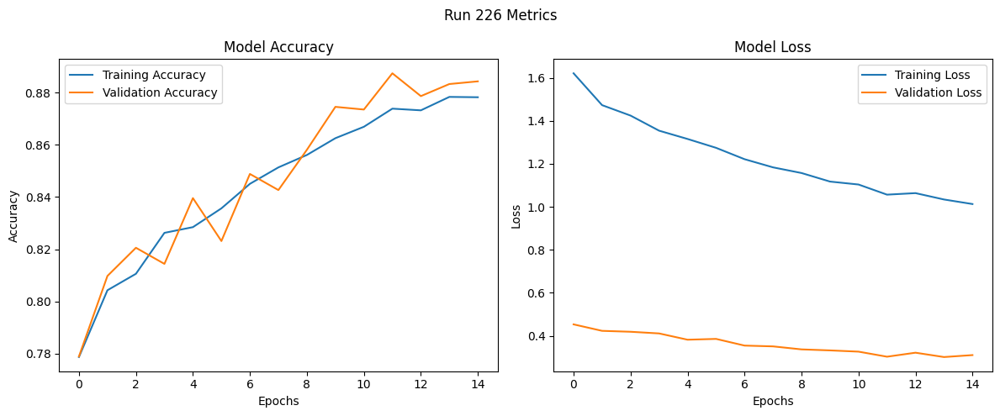

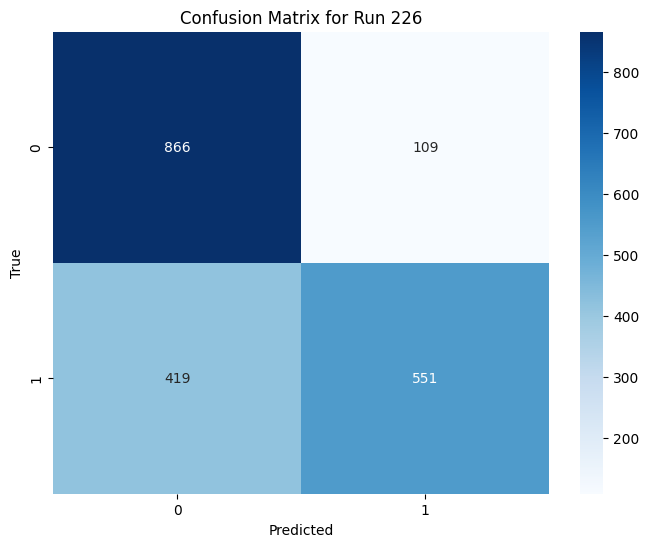

Run 227: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7543 - loss: 1.7283 - val_accuracy: 0.8026 - val_loss: 0.4307
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8047 - loss: 1.4934 - val_accuracy: 0.7779 - val_loss: 0.4502
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8112 - loss: 1.4111 - val_accuracy: 0.8129 - val_loss: 0.4113
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8249 - loss: 1.3105 - val_accuracy: 0.8298 - val_loss: 0.4072
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8256 - loss: 1.3608 - val_accuracy: 0.7949 - val_loss: 0.4215
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8360 - loss: 1.2748 - val_accuracy: 0.8499 - val_loss: 0.3611
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - 

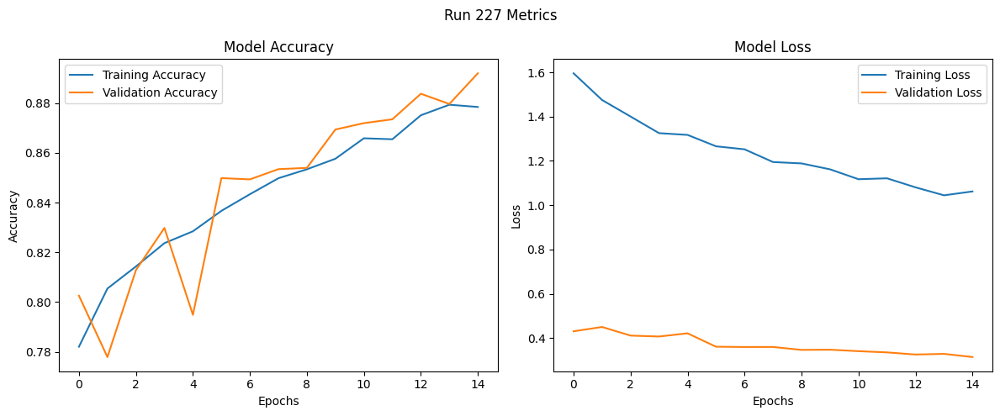

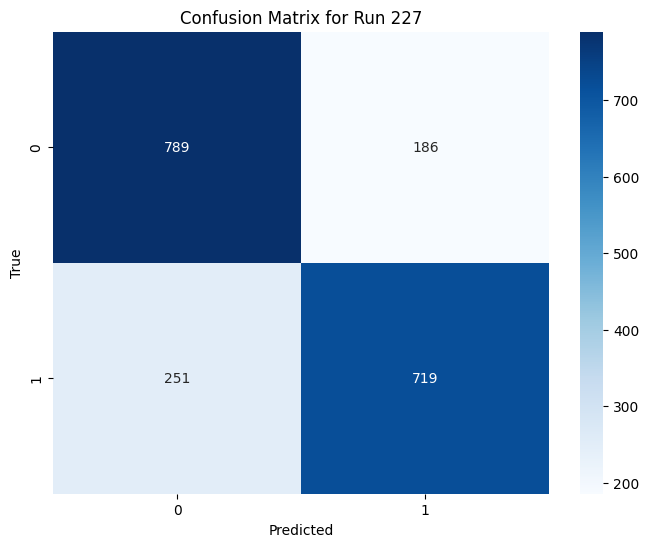

Run 228: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7528 - loss: 1.7304 - val_accuracy: 0.7979 - val_loss: 0.4432
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8151 - loss: 1.4395 - val_accuracy: 0.8108 - val_loss: 0.4224
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8157 - loss: 1.4016 - val_accuracy: 0.7866 - val_loss: 0.4365
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8104 - loss: 1.4260 - val_accuracy: 0.8329 - val_loss: 0.4016
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8286 - loss: 1.3272 - val_accuracy: 0.8252 - val_loss: 0.3959
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8378 - loss: 1.3148 - val_accuracy: 0.8427 - val_loss: 0.3739
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - ac

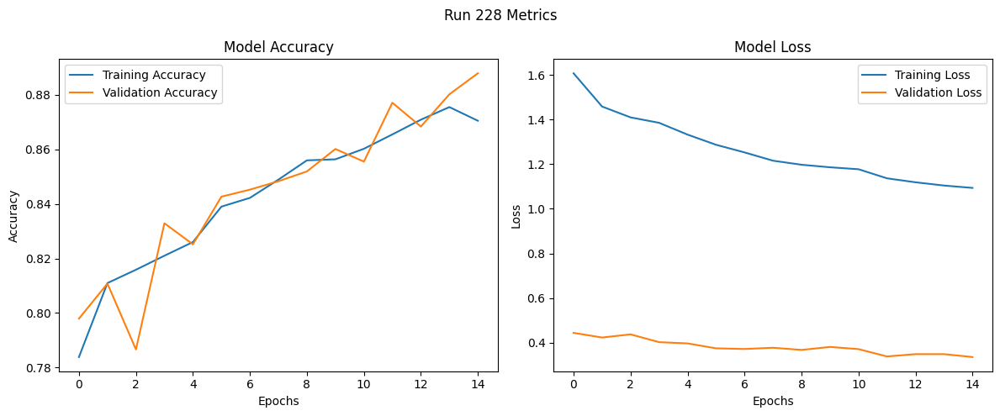

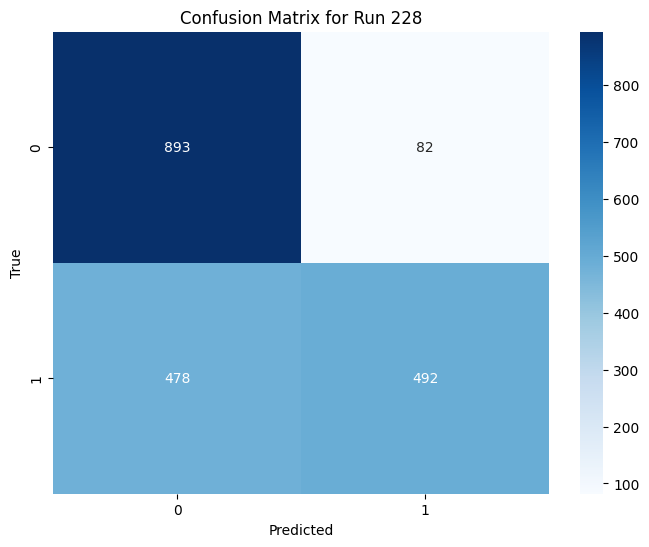

Run 229: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7475 - loss: 0.4236 - val_accuracy: 0.8123 - val_loss: 0.1445
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8124 - loss: 0.3458 - val_accuracy: 0.7990 - val_loss: 0.1487
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8224 - loss: 0.3221 - val_accuracy: 0.8015 - val_loss: 0.1491
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8259 - loss: 0.3177 - val_accuracy: 0.8144 - val_loss: 0.1409
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8385 - loss: 0.3054 - val_accuracy: 0.8365 - val_loss: 0.1312
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8398 - loss: 0.3017 - val_accuracy: 0.8391 - val_loss: 0.1305
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy

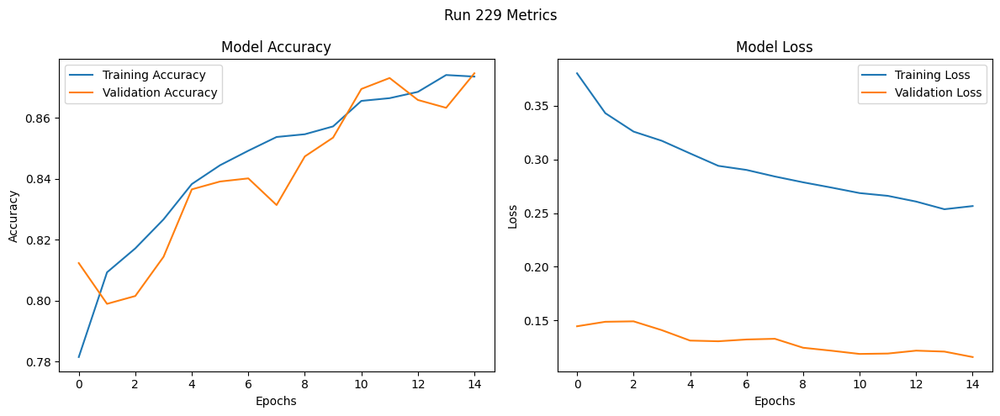

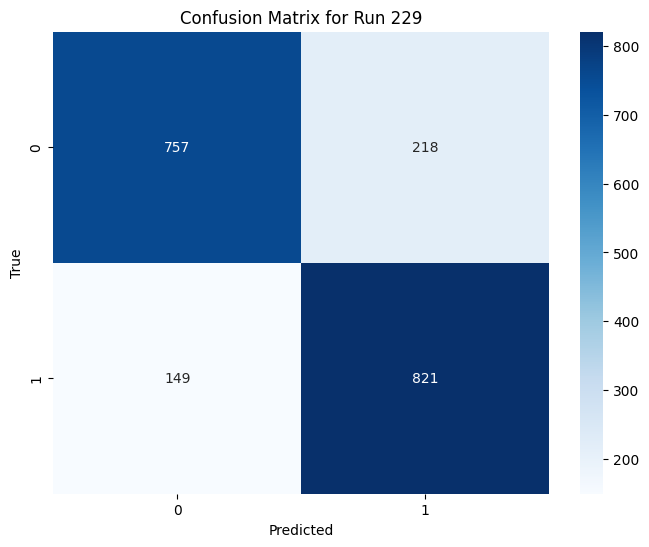

Run 230: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7579 - loss: 0.4091 - val_accuracy: 0.8031 - val_loss: 0.1484
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8032 - loss: 0.3485 - val_accuracy: 0.8139 - val_loss: 0.1426
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8112 - loss: 0.3320 - val_accuracy: 0.8098 - val_loss: 0.1469
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8230 - loss: 0.3193 - val_accuracy: 0.8129 - val_loss: 0.1372
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8378 - loss: 0.3031 - val_accuracy: 0.8334 - val_loss: 0.1322
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8361 - loss: 0.3105 - val_accuracy: 0.8278 - val_loss: 0.1354
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accurac

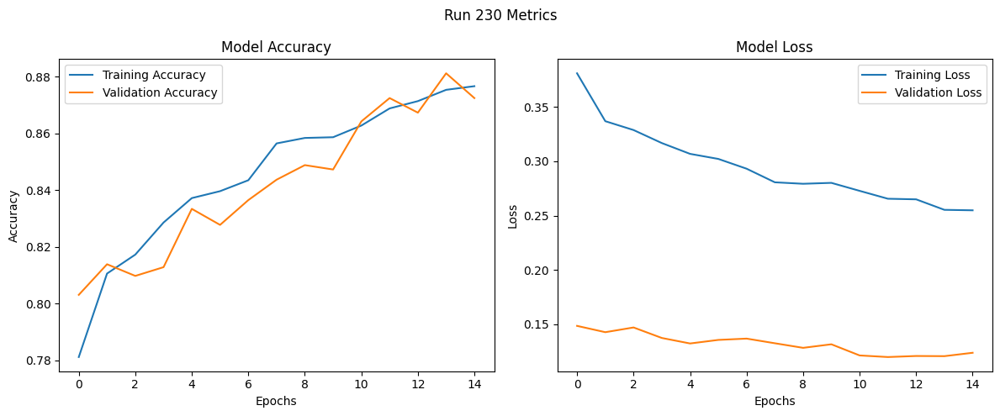

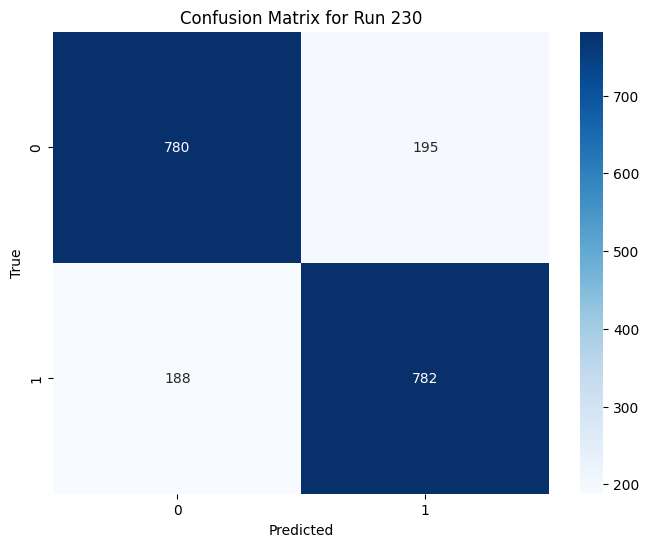

Run 231: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7449 - loss: 0.4162 - val_accuracy: 0.8098 - val_loss: 0.1456
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8059 - loss: 0.3506 - val_accuracy: 0.8046 - val_loss: 0.1451
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8162 - loss: 0.3293 - val_accuracy: 0.8190 - val_loss: 0.1404
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8302 - loss: 0.3182 - val_accuracy: 0.8288 - val_loss: 0.1340
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8292 - loss: 0.3184 - val_accuracy: 0.8298 - val_loss: 0.1360
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8426 - loss: 0.3052 - val_accuracy: 0.8195 - val_loss: 0.1411
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy:

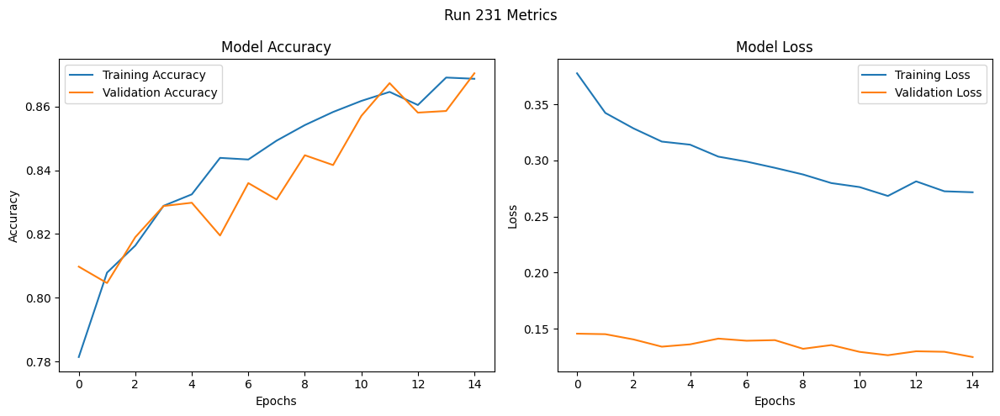

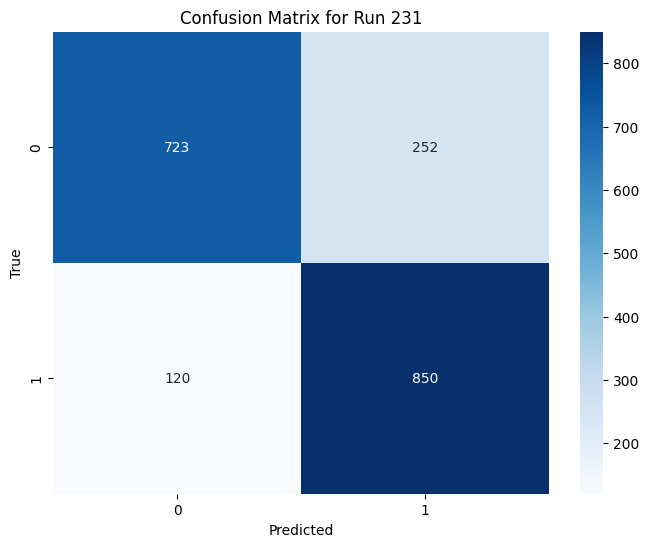

Run 232: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7495 - loss: 0.6009 - val_accuracy: 0.7974 - val_loss: 0.1479
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8093 - loss: 0.4832 - val_accuracy: 0.7959 - val_loss: 0.1480
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8144 - loss: 0.4648 - val_accuracy: 0.8036 - val_loss: 0.1442
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8248 - loss: 0.4424 - val_accuracy: 0.8154 - val_loss: 0.1403
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8324 - loss: 0.4369 - val_accuracy: 0.8226 - val_loss: 0.1340
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8377 - loss: 0.4139 - val_accuracy: 0.8422 - val_loss: 0.1296
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy

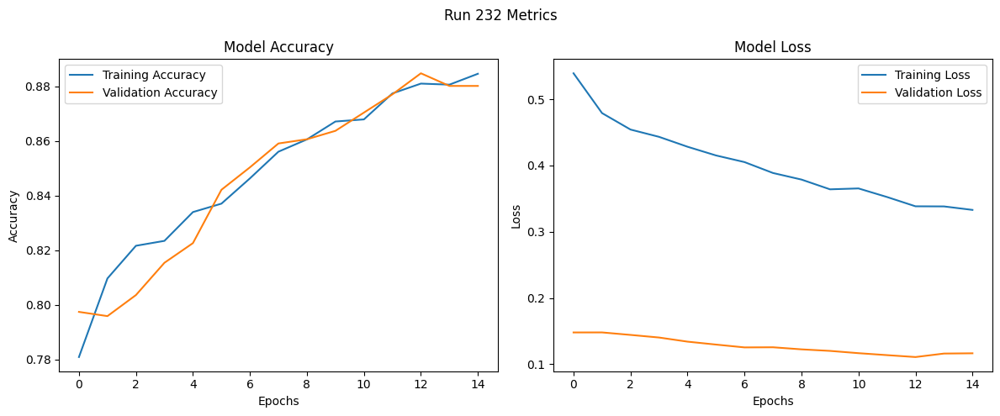

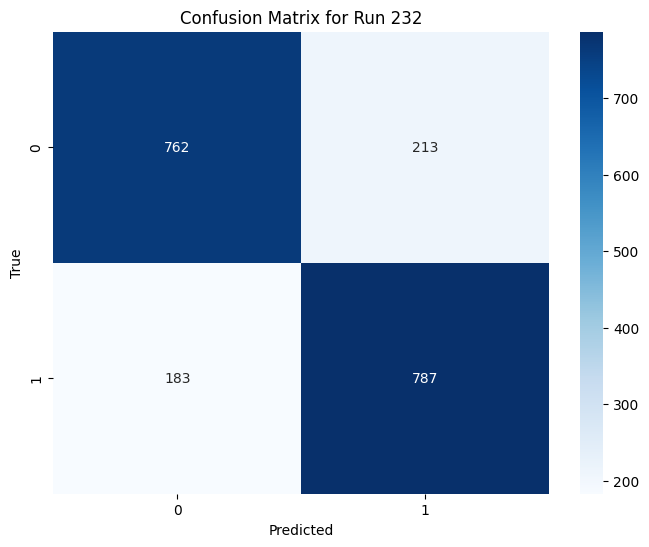

Run 233: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7522 - loss: 0.5941 - val_accuracy: 0.7923 - val_loss: 0.1509
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8000 - loss: 0.4795 - val_accuracy: 0.8134 - val_loss: 0.1447
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8222 - loss: 0.4668 - val_accuracy: 0.8267 - val_loss: 0.1370
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8344 - loss: 0.4276 - val_accuracy: 0.8252 - val_loss: 0.1391
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8393 - loss: 0.4280 - val_accuracy: 0.8422 - val_loss: 0.1311
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8478 - loss: 0.4011 - val_accuracy: 0.8396 - val_loss: 0.1322
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accurac

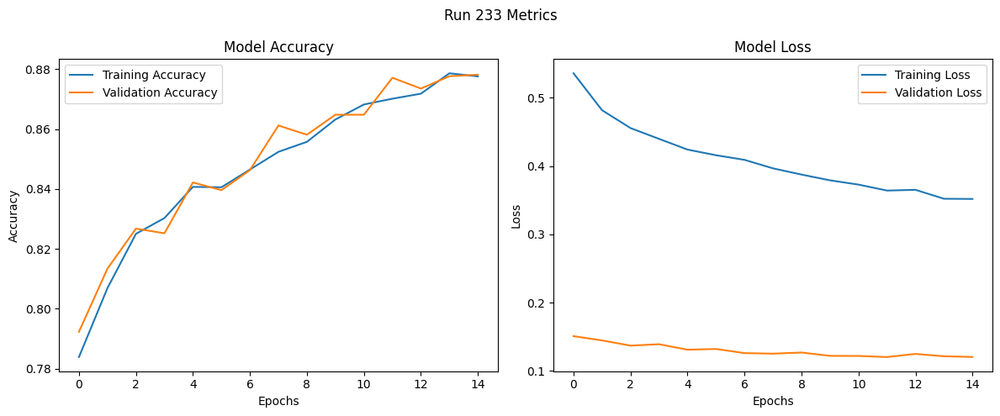

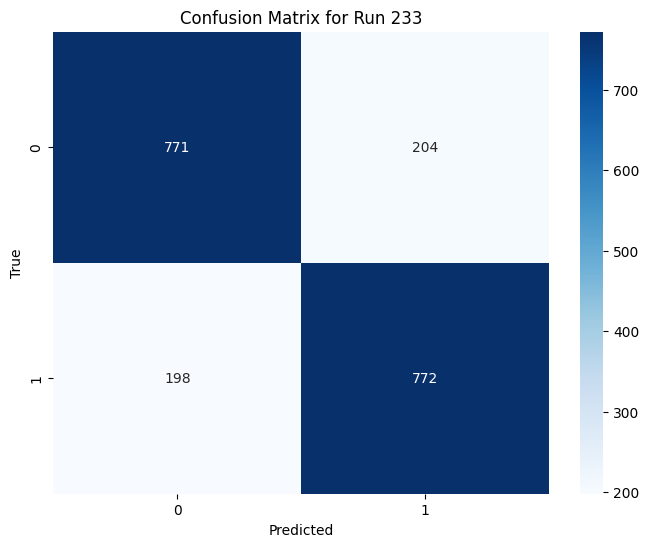

Run 234: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7467 - loss: 0.5909 - val_accuracy: 0.7995 - val_loss: 0.1491
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7986 - loss: 0.5018 - val_accuracy: 0.8113 - val_loss: 0.1445
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8170 - loss: 0.4656 - val_accuracy: 0.8211 - val_loss: 0.1431
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8302 - loss: 0.4428 - val_accuracy: 0.8283 - val_loss: 0.1387
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8330 - loss: 0.4373 - val_accuracy: 0.8267 - val_loss: 0.1357
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8417 - loss: 0.4152 - val_accuracy: 0.8360 - val_loss: 0.1312
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy:

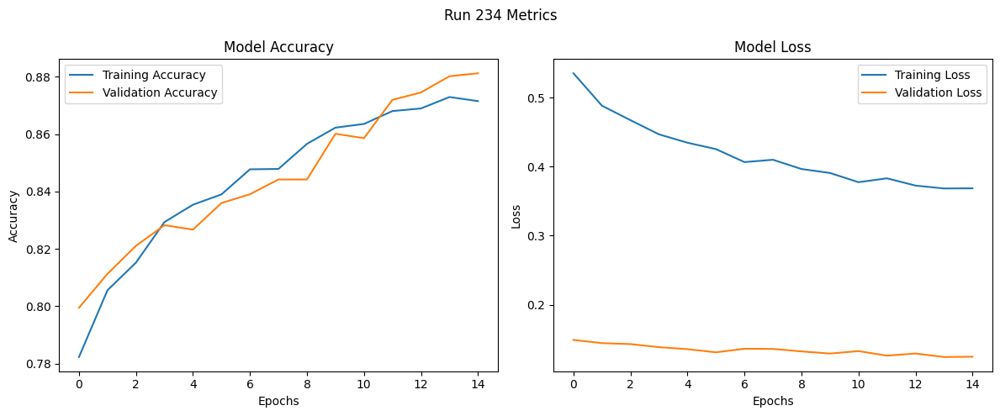

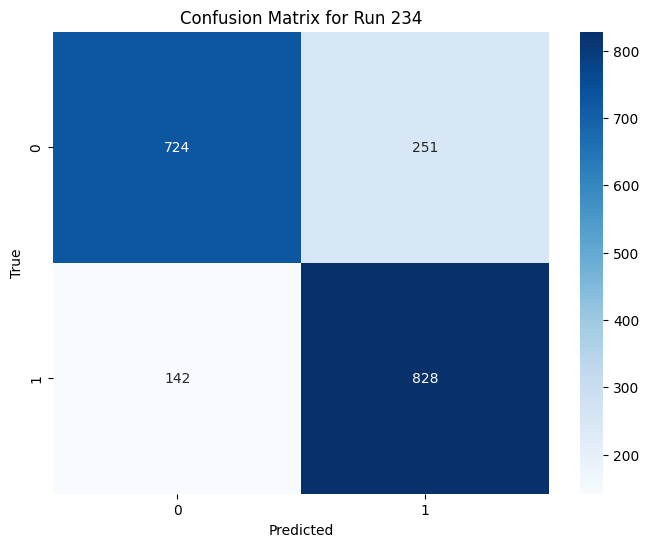

Run 235: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7486 - loss: 0.4298 - val_accuracy: 0.7784 - val_loss: 0.1604
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8073 - loss: 0.3478 - val_accuracy: 0.7897 - val_loss: 0.1534
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8150 - loss: 0.3278 - val_accuracy: 0.8082 - val_loss: 0.1401
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8241 - loss: 0.3206 - val_accuracy: 0.8154 - val_loss: 0.1373
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8396 - loss: 0.2995 - val_accuracy: 0.8386 - val_loss: 0.1307
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8422 - loss: 0.2898 - val_accuracy: 0.8319 - val_loss: 0.1335
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accurac

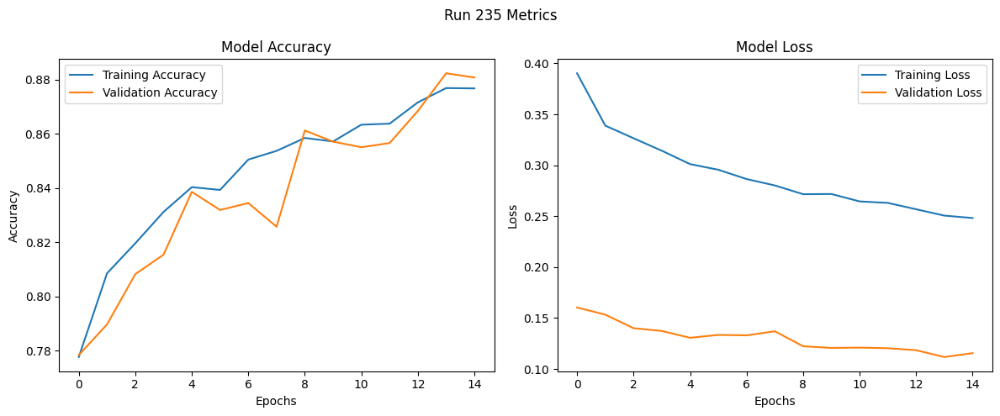

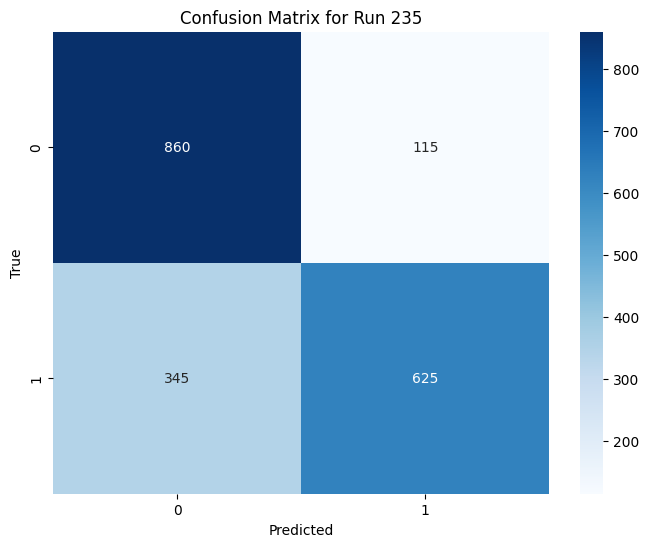

Run 236: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7389 - loss: 0.4117 - val_accuracy: 0.7902 - val_loss: 0.1511
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7990 - loss: 0.3502 - val_accuracy: 0.8072 - val_loss: 0.1425
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8204 - loss: 0.3252 - val_accuracy: 0.8062 - val_loss: 0.1402
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8309 - loss: 0.3139 - val_accuracy: 0.8267 - val_loss: 0.1350
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8329 - loss: 0.3114 - val_accuracy: 0.8180 - val_loss: 0.1399
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8396 - loss: 0.3014 - val_accuracy: 0.8087 - val_loss: 0.1465
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accura

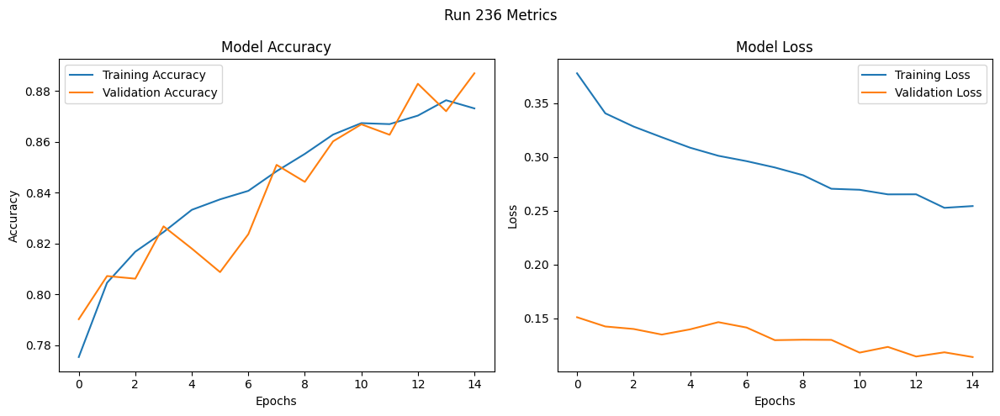

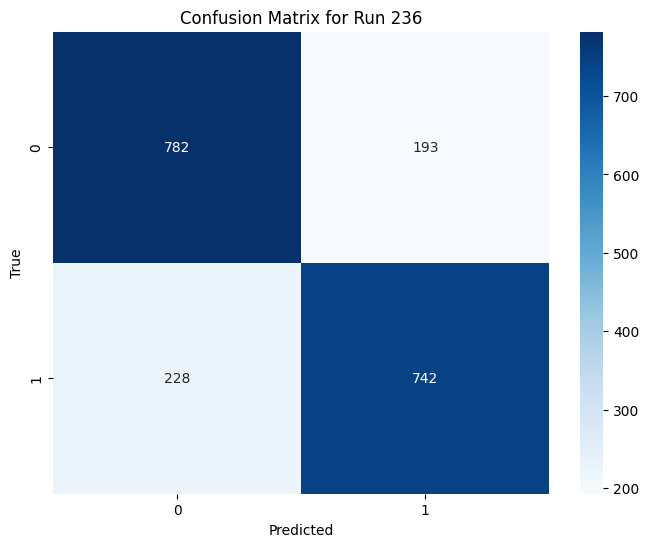

Run 237: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7444 - loss: 0.4280 - val_accuracy: 0.7959 - val_loss: 0.1513
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8055 - loss: 0.3490 - val_accuracy: 0.8051 - val_loss: 0.1485
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8183 - loss: 0.3221 - val_accuracy: 0.8072 - val_loss: 0.1492
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8250 - loss: 0.3250 - val_accuracy: 0.8206 - val_loss: 0.1423
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8320 - loss: 0.3186 - val_accuracy: 0.8272 - val_loss: 0.1421
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8352 - loss: 0.3112 - val_accuracy: 0.8396 - val_loss: 0.1361
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy

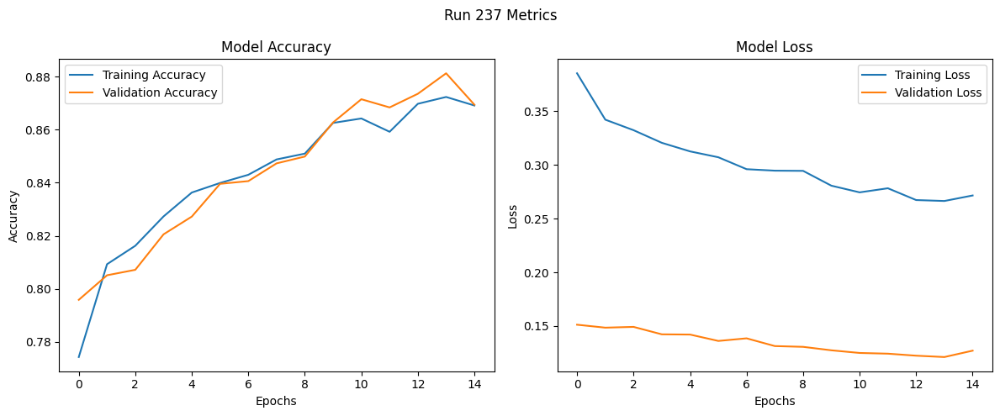

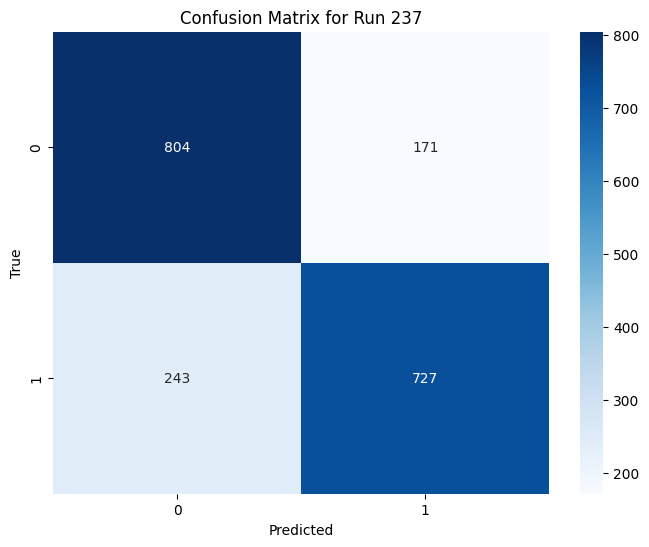

Run 238: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7501 - loss: 0.6049 - val_accuracy: 0.8015 - val_loss: 0.1476
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8095 - loss: 0.4881 - val_accuracy: 0.7964 - val_loss: 0.1493
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8286 - loss: 0.4518 - val_accuracy: 0.8144 - val_loss: 0.1394
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8303 - loss: 0.4429 - val_accuracy: 0.8226 - val_loss: 0.1353
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8347 - loss: 0.4348 - val_accuracy: 0.8288 - val_loss: 0.1367
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8433 - loss: 0.4091 - val_accuracy: 0.8458 - val_loss: 0.1284
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accurac

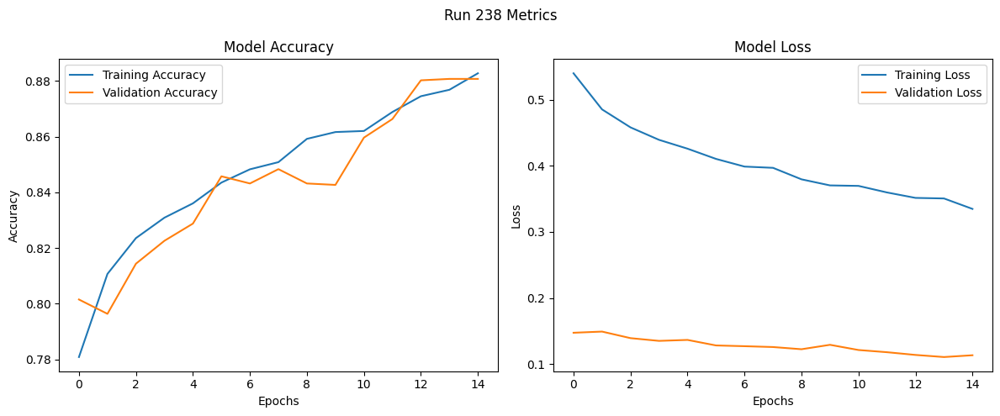

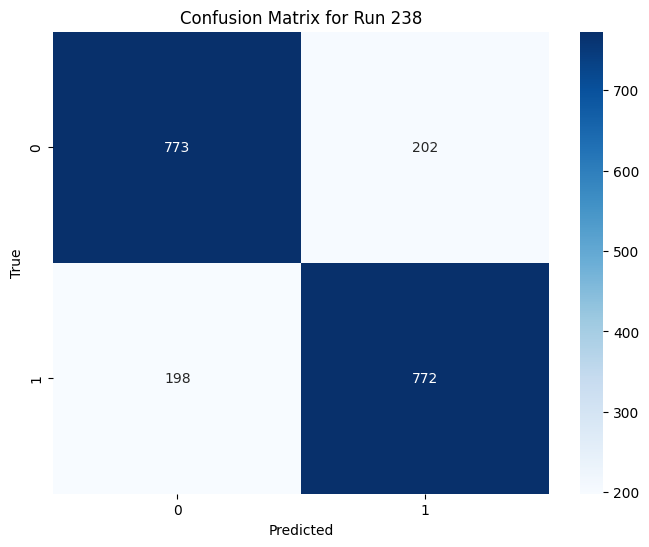

Run 239: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.7585 - loss: 0.5735 - val_accuracy: 0.7979 - val_loss: 0.1481
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8004 - loss: 0.4935 - val_accuracy: 0.8113 - val_loss: 0.1403
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8179 - loss: 0.4598 - val_accuracy: 0.8041 - val_loss: 0.1454
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8369 - loss: 0.4337 - val_accuracy: 0.8267 - val_loss: 0.1388
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8356 - loss: 0.4336 - val_accuracy: 0.8247 - val_loss: 0.1372
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8356 - loss: 0.4260 - val_accuracy: 0.8355 - val_loss: 0.1341
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accura

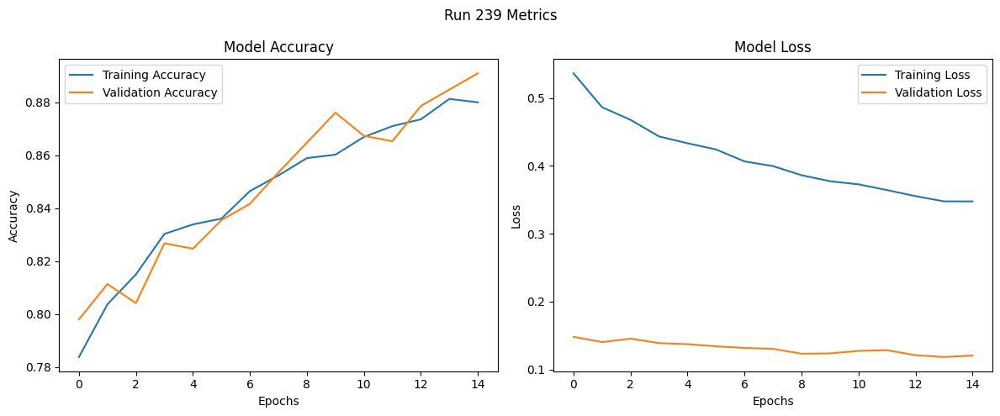

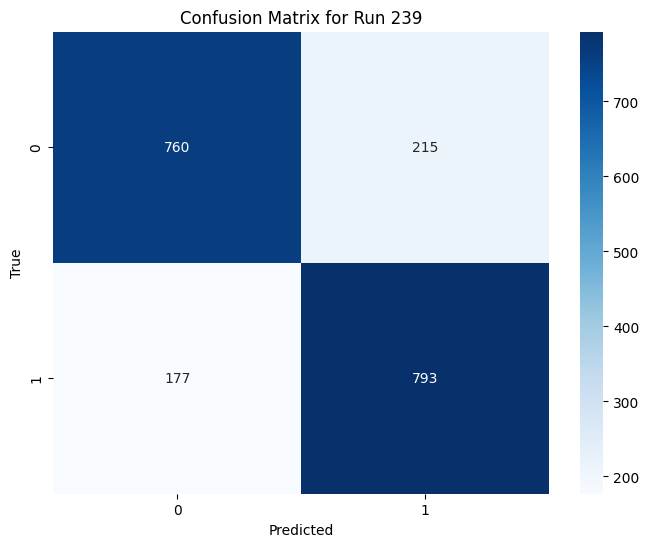

Run 240: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7418 - loss: 0.6052 - val_accuracy: 0.7892 - val_loss: 0.1543
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8113 - loss: 0.4917 - val_accuracy: 0.8118 - val_loss: 0.1459
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8233 - loss: 0.4460 - val_accuracy: 0.8149 - val_loss: 0.1477
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8266 - loss: 0.4655 - val_accuracy: 0.8226 - val_loss: 0.1401
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8422 - loss: 0.4206 - val_accuracy: 0.8360 - val_loss: 0.1368
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8536 - loss: 0.4092 - val_accuracy: 0.8386 - val_loss: 0.1351
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy

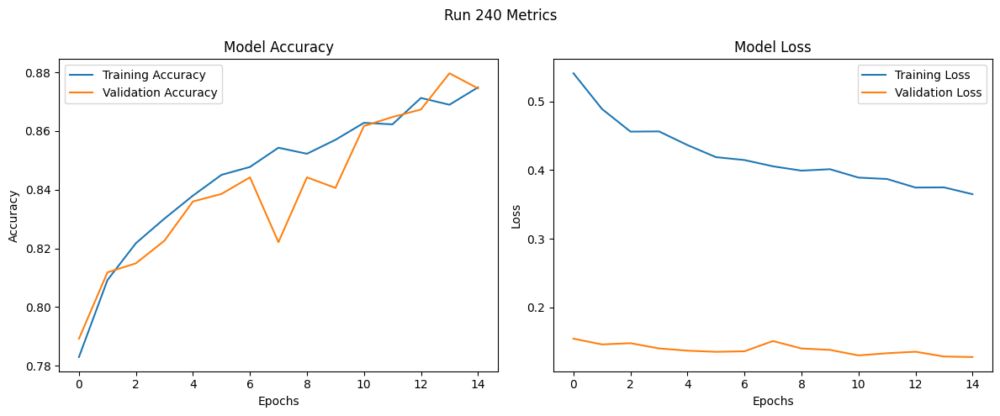

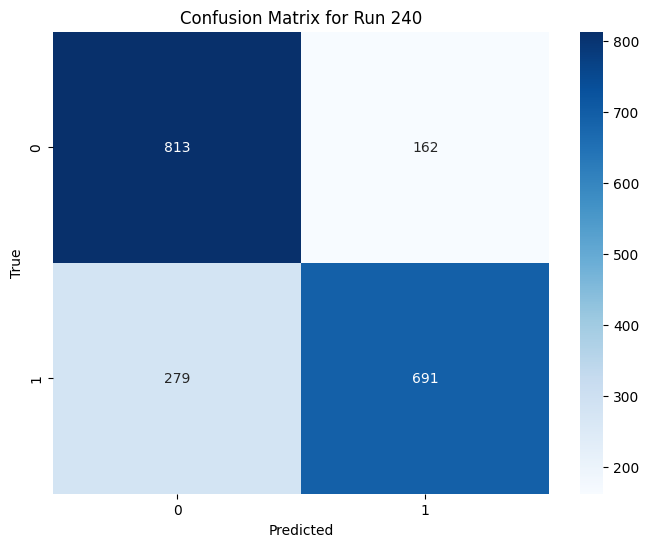

Run 241: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - accuracy: 0.7371 - loss: 0.2013 - val_accuracy: 0.8021 - val_loss: 0.0711
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8073 - loss: 0.1646 - val_accuracy: 0.8026 - val_loss: 0.0699
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8181 - loss: 0.1525 - val_accuracy: 0.7861 - val_loss: 0.0766
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8184 - loss: 0.1514 - val_accuracy: 0.8123 - val_loss: 0.0682
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8283 - loss: 0.1506 - val_accuracy: 0.8170 - val_loss: 0.0677
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8397 - loss: 0.1379 - val_accuracy: 0.8375 - val_loss: 0.0644
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8526 -

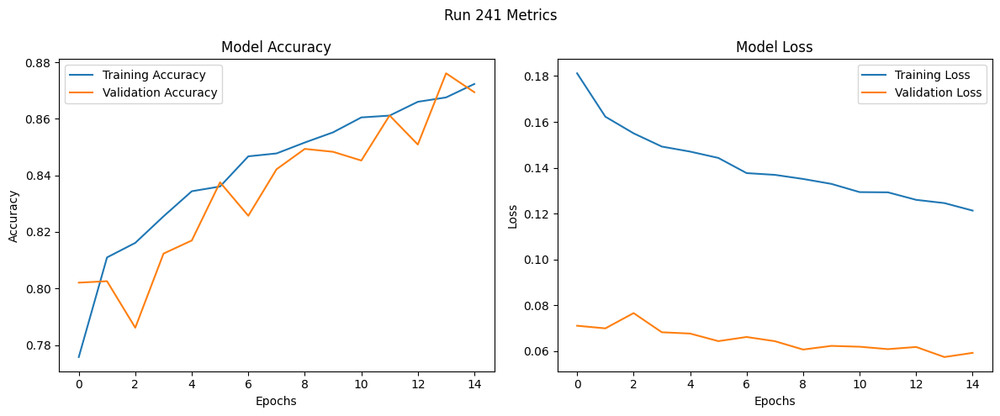

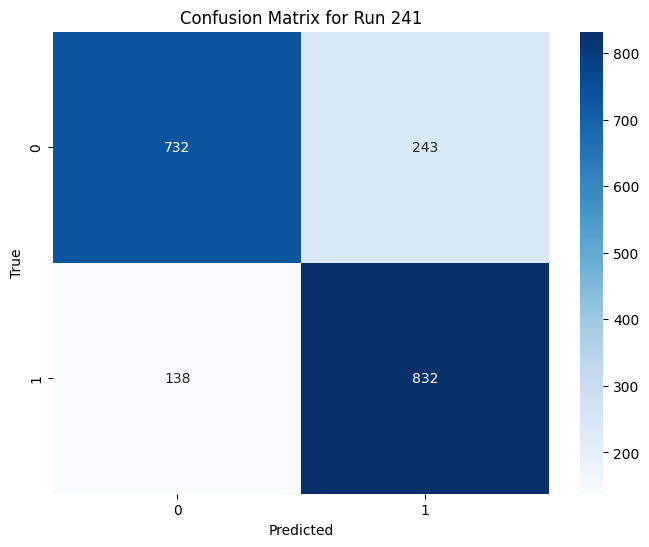

Run 242: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.7604 - loss: 0.1992 - val_accuracy: 0.7913 - val_loss: 0.0740
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8064 - loss: 0.1633 - val_accuracy: 0.8077 - val_loss: 0.0691
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8071 - loss: 0.1636 - val_accuracy: 0.8051 - val_loss: 0.0703
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8263 - loss: 0.1520 - val_accuracy: 0.8000 - val_loss: 0.0709
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8243 - loss: 0.1503 - val_accuracy: 0.8242 - val_loss: 0.0663
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8416 - loss: 0.1451 - val_accuracy: 0.8185 - val_loss: 0.0673
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8453 

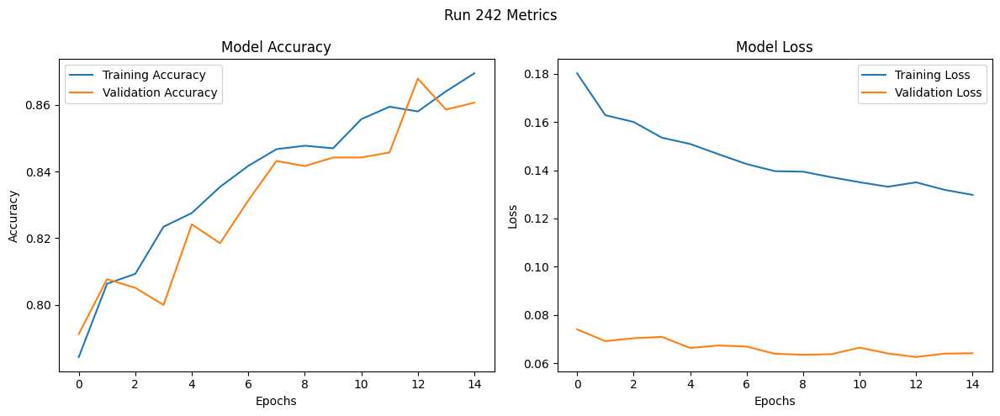

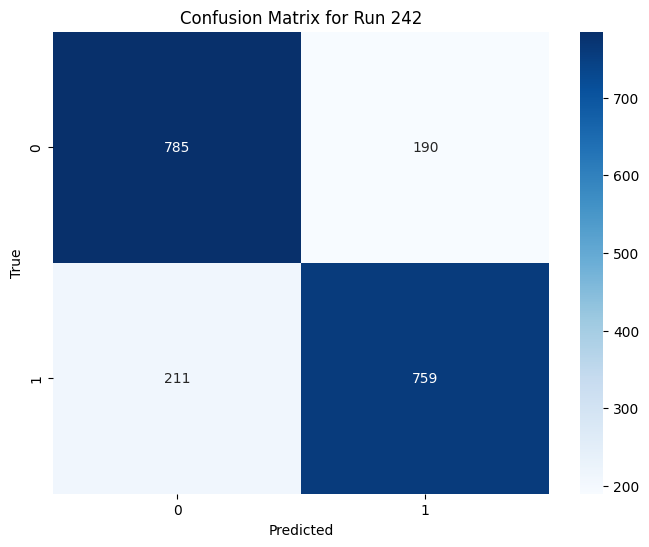

Run 243: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7620 - loss: 0.1983 - val_accuracy: 0.7964 - val_loss: 0.0754
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8043 - loss: 0.1675 - val_accuracy: 0.8021 - val_loss: 0.0723
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8205 - loss: 0.1560 - val_accuracy: 0.8051 - val_loss: 0.0710
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8216 - loss: 0.1530 - val_accuracy: 0.8195 - val_loss: 0.0711
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8362 - loss: 0.1492 - val_accuracy: 0.8123 - val_loss: 0.0717
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8476 - loss: 0.1406 - val_accuracy: 0.8195 - val_loss: 0.0722
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8350 - 

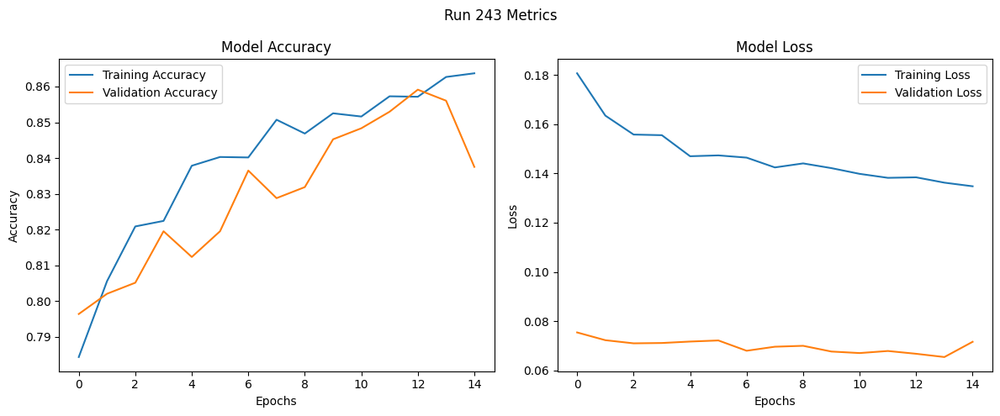

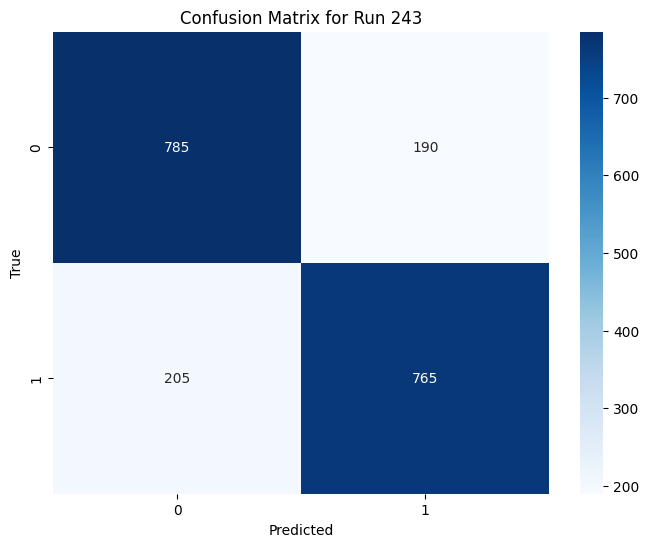

Run 244: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7589 - loss: 0.2858 - val_accuracy: 0.7964 - val_loss: 0.0728
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8034 - loss: 0.2282 - val_accuracy: 0.8077 - val_loss: 0.0714
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8284 - loss: 0.2149 - val_accuracy: 0.8144 - val_loss: 0.0683
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8341 - loss: 0.2070 - val_accuracy: 0.8303 - val_loss: 0.0663
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8401 - loss: 0.1975 - val_accuracy: 0.8149 - val_loss: 0.0712
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8408 - loss: 0.1984 - val_accuracy: 0.8437 - val_loss: 0.0633
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8489 -

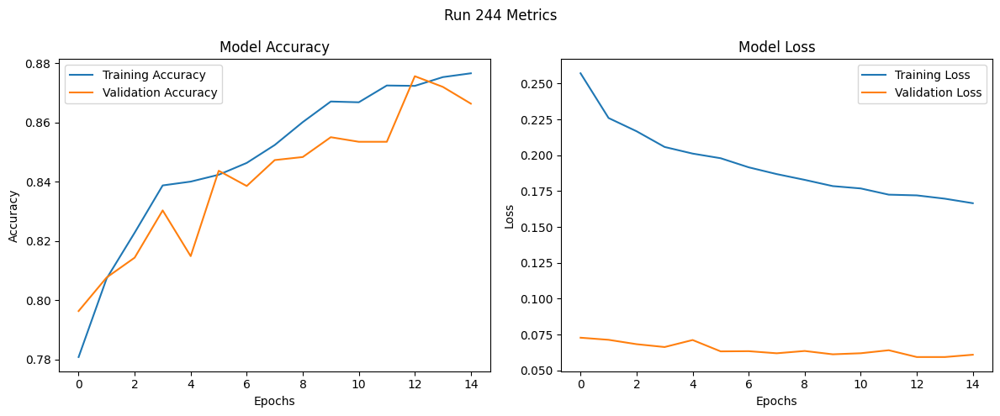

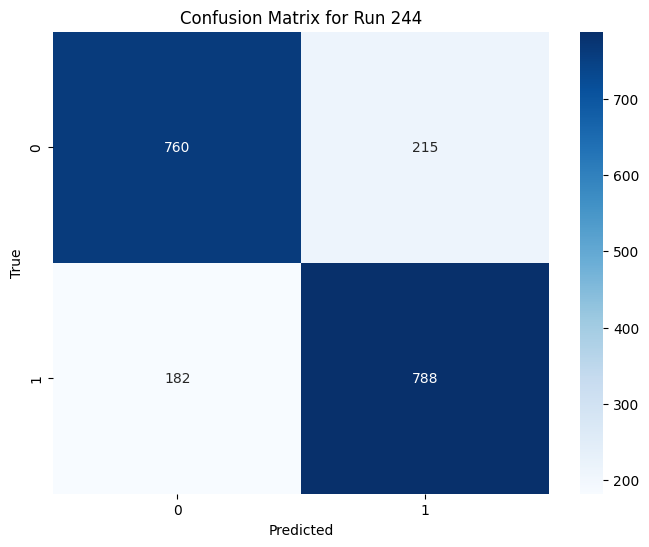

Run 245: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7490 - loss: 0.2769 - val_accuracy: 0.7938 - val_loss: 0.0725
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8046 - loss: 0.2295 - val_accuracy: 0.8072 - val_loss: 0.0705
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8185 - loss: 0.2192 - val_accuracy: 0.8206 - val_loss: 0.0684
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8230 - loss: 0.2149 - val_accuracy: 0.8257 - val_loss: 0.0691
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8401 - loss: 0.2018 - val_accuracy: 0.8344 - val_loss: 0.0676
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8405 - loss: 0.1976 - val_accuracy: 0.8288 - val_loss: 0.0693
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8482 

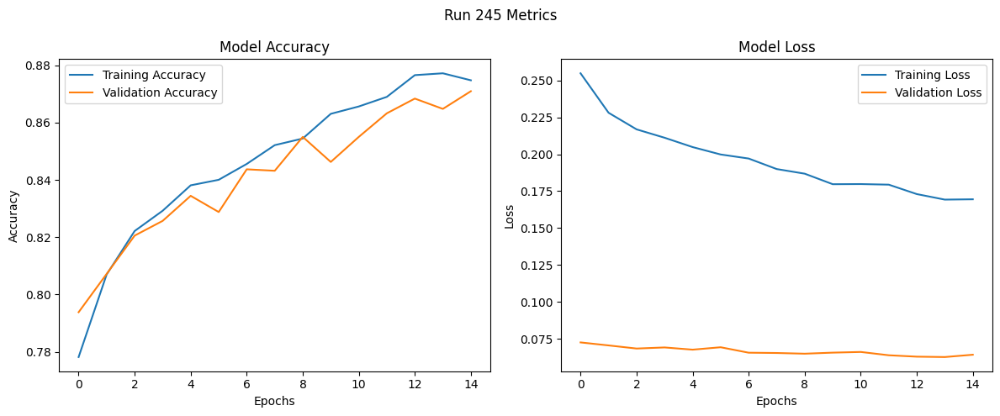

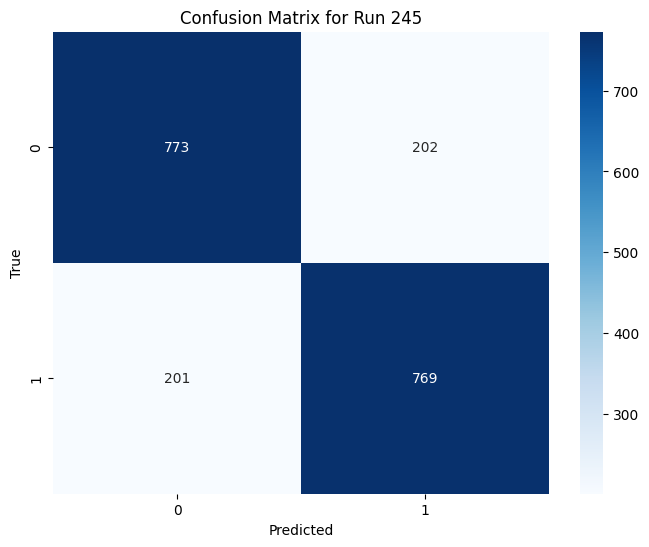

Run 246: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7645 - loss: 0.2762 - val_accuracy: 0.8041 - val_loss: 0.0715
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8136 - loss: 0.2275 - val_accuracy: 0.8057 - val_loss: 0.0701
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8295 - loss: 0.2141 - val_accuracy: 0.7979 - val_loss: 0.0729
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8214 - loss: 0.2223 - val_accuracy: 0.8159 - val_loss: 0.0720
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8291 - loss: 0.2126 - val_accuracy: 0.8159 - val_loss: 0.0735
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8437 - loss: 0.1998 - val_accuracy: 0.8334 - val_loss: 0.0708
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8464 - 

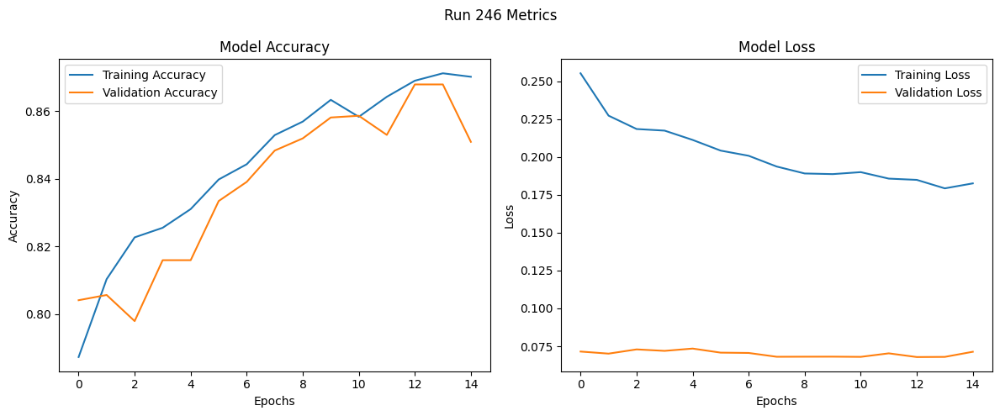

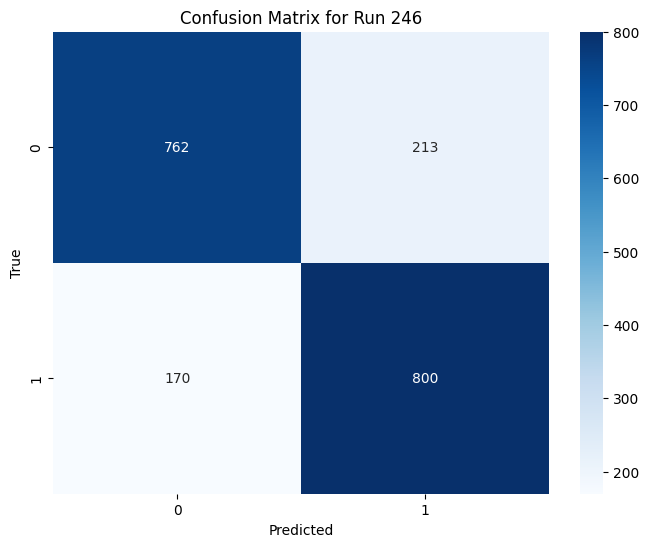

Run 247: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7452 - loss: 0.2020 - val_accuracy: 0.7918 - val_loss: 0.0724
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8089 - loss: 0.1681 - val_accuracy: 0.7964 - val_loss: 0.0715
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8177 - loss: 0.1567 - val_accuracy: 0.8087 - val_loss: 0.0700
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8210 - loss: 0.1513 - val_accuracy: 0.8231 - val_loss: 0.0659
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8360 - loss: 0.1468 - val_accuracy: 0.8257 - val_loss: 0.0649
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8422 - loss: 0.1465 - val_accuracy: 0.8370 - val_loss: 0.0642
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8421 

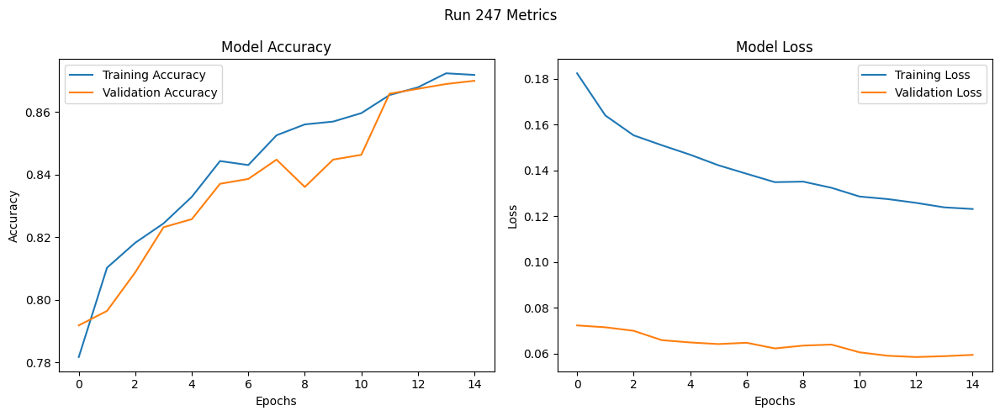

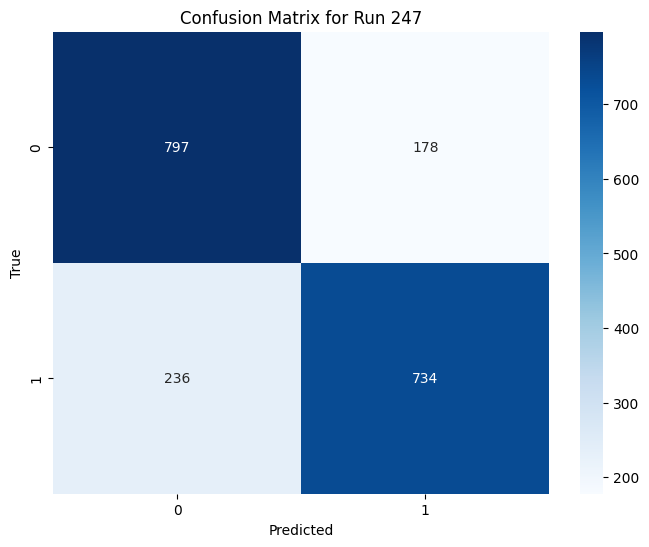

Run 248: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7332 - loss: 0.2000 - val_accuracy: 0.7815 - val_loss: 0.0780
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8060 - loss: 0.1629 - val_accuracy: 0.8026 - val_loss: 0.0709
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8164 - loss: 0.1533 - val_accuracy: 0.8041 - val_loss: 0.0723
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8311 - loss: 0.1504 - val_accuracy: 0.8237 - val_loss: 0.0664
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8416 - loss: 0.1443 - val_accuracy: 0.7979 - val_loss: 0.0725
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8437 - loss: 0.1428 - val_accuracy: 0.8308 - val_loss: 0.0674
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8428

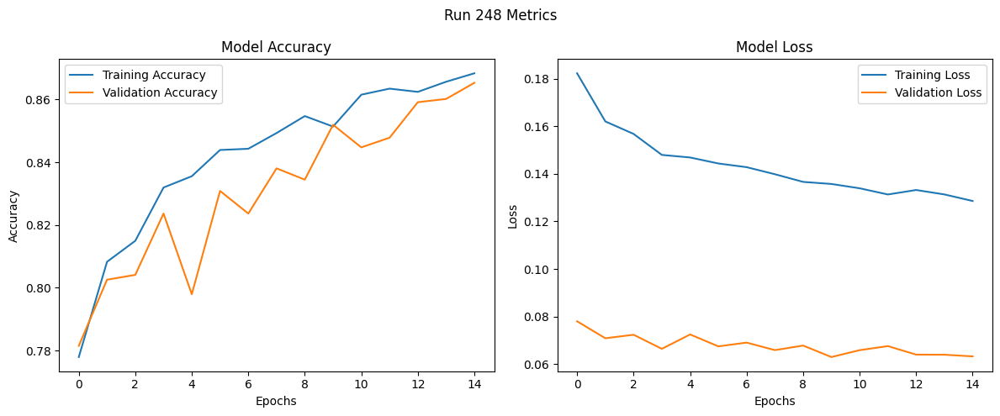

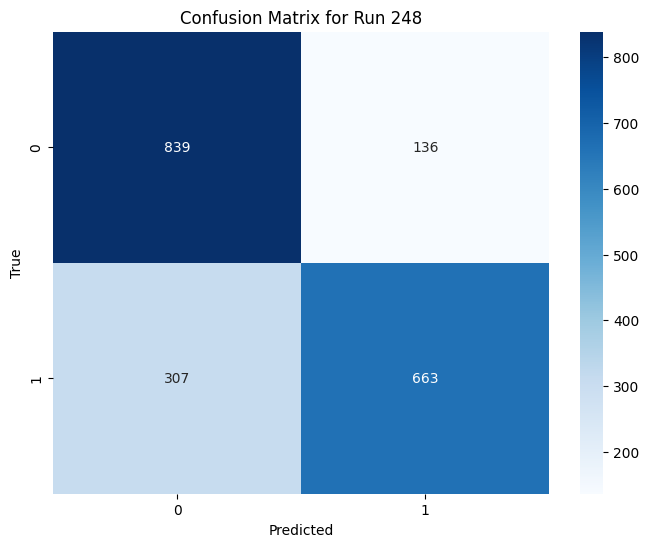

Run 249: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7709 - loss: 0.1958 - val_accuracy: 0.7887 - val_loss: 0.0767
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8044 - loss: 0.1677 - val_accuracy: 0.8087 - val_loss: 0.0706
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8223 - loss: 0.1534 - val_accuracy: 0.8231 - val_loss: 0.0696
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8237 - loss: 0.1565 - val_accuracy: 0.8237 - val_loss: 0.0692
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8284 - loss: 0.1519 - val_accuracy: 0.8226 - val_loss: 0.0690
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8465 - loss: 0.1423 - val_accuracy: 0.8206 - val_loss: 0.0697
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8401 -

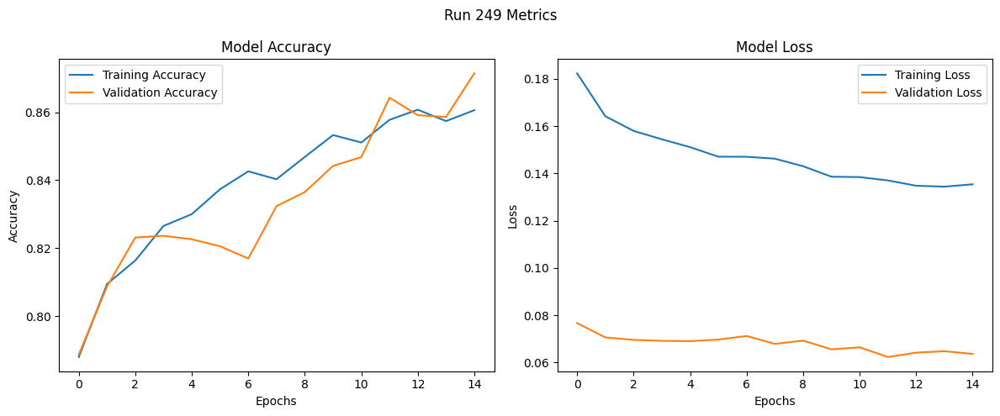

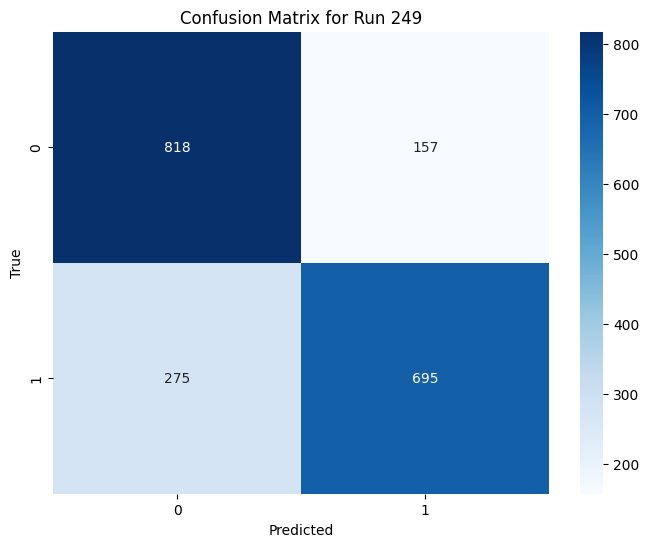

Run 250: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.7496 - loss: 0.2869 - val_accuracy: 0.7974 - val_loss: 0.0727
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8036 - loss: 0.2270 - val_accuracy: 0.8077 - val_loss: 0.0693
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8191 - loss: 0.2170 - val_accuracy: 0.8139 - val_loss: 0.0678
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8315 - loss: 0.2078 - val_accuracy: 0.8144 - val_loss: 0.0671
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8330 - loss: 0.2095 - val_accuracy: 0.8190 - val_loss: 0.0665
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8407 - loss: 0.2003 - val_accuracy: 0.8339 - val_loss: 0.0654
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8370 

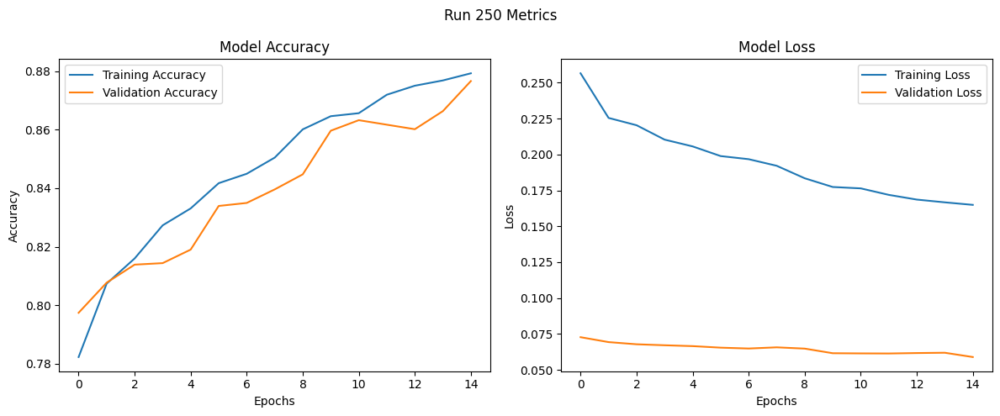

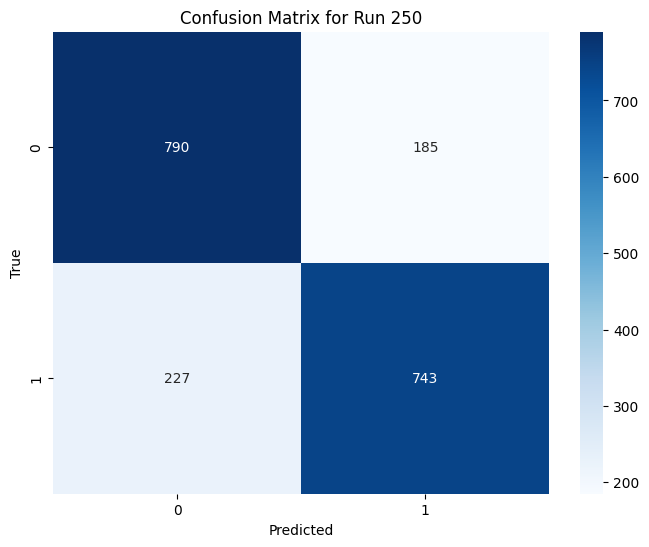

Run 251: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7533 - loss: 0.2839 - val_accuracy: 0.8010 - val_loss: 0.0717
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8068 - loss: 0.2343 - val_accuracy: 0.8149 - val_loss: 0.0689
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8169 - loss: 0.2194 - val_accuracy: 0.7738 - val_loss: 0.0818
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8187 - loss: 0.2169 - val_accuracy: 0.8180 - val_loss: 0.0714
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8305 - loss: 0.2116 - val_accuracy: 0.8262 - val_loss: 0.0668
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8441 - loss: 0.1971 - val_accuracy: 0.8231 - val_loss: 0.0707
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8434

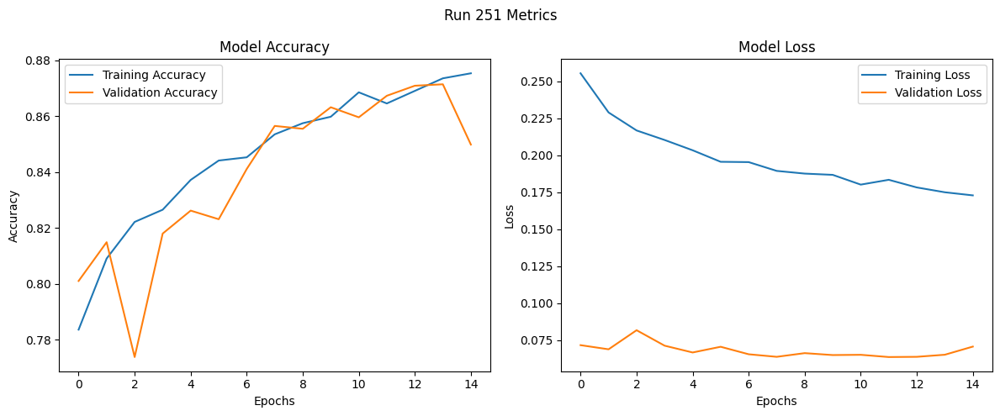

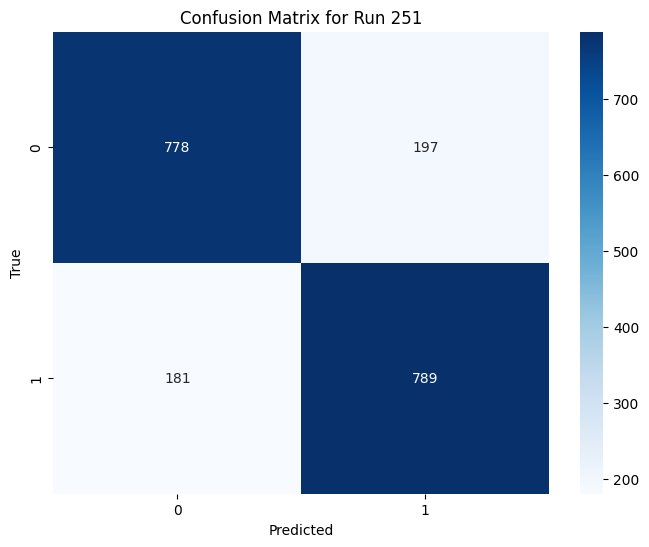

Run 252: L2: 5e-05, Dropout: 0.2, Layers: [128, 64], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7498 - loss: 0.2800 - val_accuracy: 0.7728 - val_loss: 0.0781
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8085 - loss: 0.2298 - val_accuracy: 0.8113 - val_loss: 0.0693
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8337 - loss: 0.2121 - val_accuracy: 0.8093 - val_loss: 0.0729
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8300 - loss: 0.2116 - val_accuracy: 0.8190 - val_loss: 0.0692
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8176 - loss: 0.2211 - val_accuracy: 0.8314 - val_loss: 0.0694
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8463 - loss: 0.1996 - val_accuracy: 0.8308 - val_loss: 0.0713
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8380 -

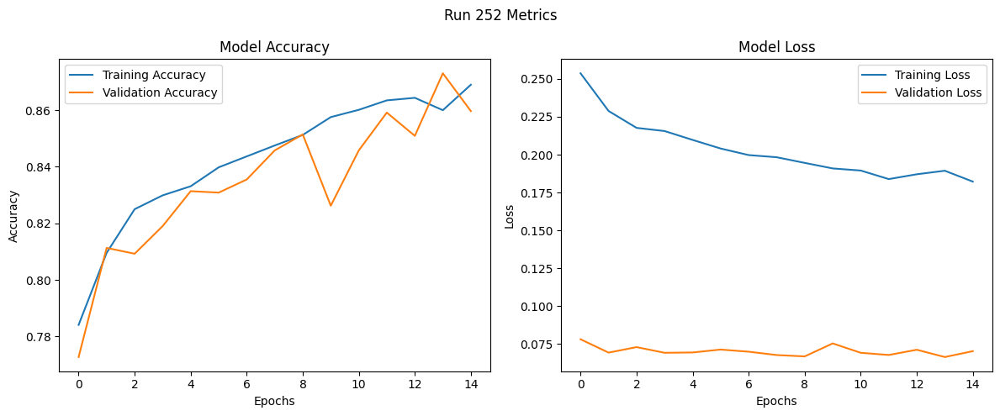

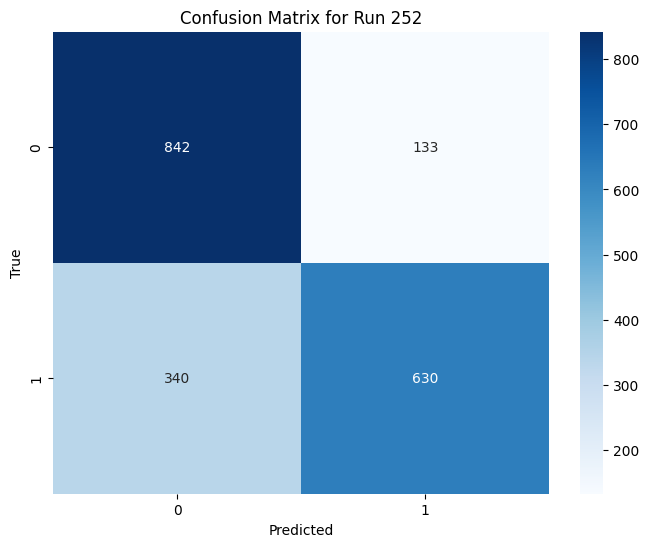

Run 253: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7578 - loss: 1.2111 - val_accuracy: 0.7753 - val_loss: 0.4741
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.7995 - loss: 1.0438 - val_accuracy: 0.8087 - val_loss: 0.4202
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8170 - loss: 0.9850 - val_accuracy: 0.8185 - val_loss: 0.4123
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8267 - loss: 0.9435 - val_accuracy: 0.8350 - val_loss: 0.3804
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8482 - loss: 0.8660 - val_accuracy: 0.8411 - val_loss: 0.3740
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8502 - loss: 0.8751 - val_accuracy: 0.8581 - val_loss: 0.3546
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step -

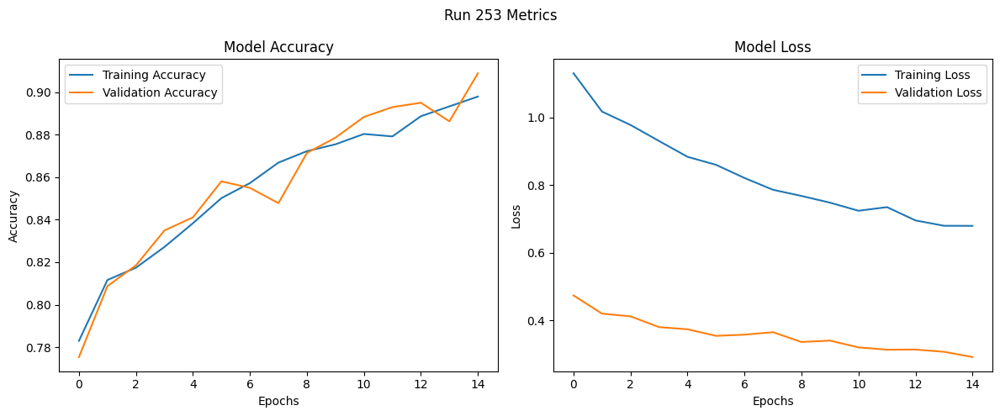

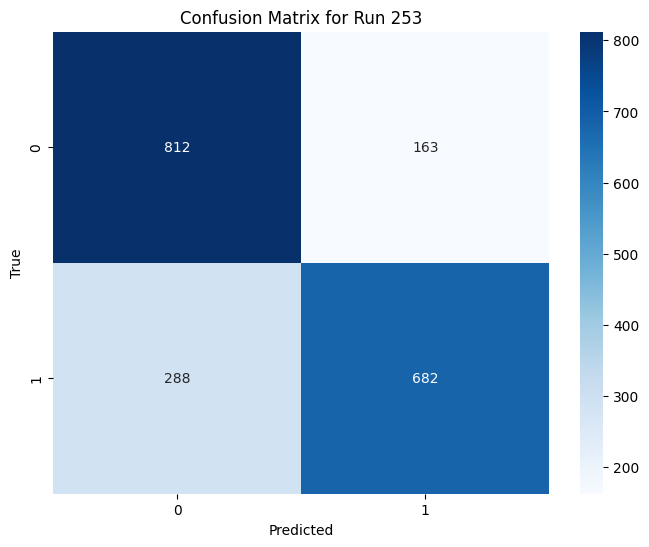

Run 254: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7506 - loss: 1.2292 - val_accuracy: 0.7990 - val_loss: 0.4343
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8103 - loss: 1.0405 - val_accuracy: 0.7841 - val_loss: 0.4546
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8063 - loss: 1.0177 - val_accuracy: 0.8262 - val_loss: 0.3961
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8241 - loss: 0.9632 - val_accuracy: 0.8154 - val_loss: 0.4139
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8392 - loss: 0.9231 - val_accuracy: 0.8401 - val_loss: 0.3714
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8418 - loss: 0.8832 - val_accuracy: 0.8468 - val_loss: 0.3677
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step -

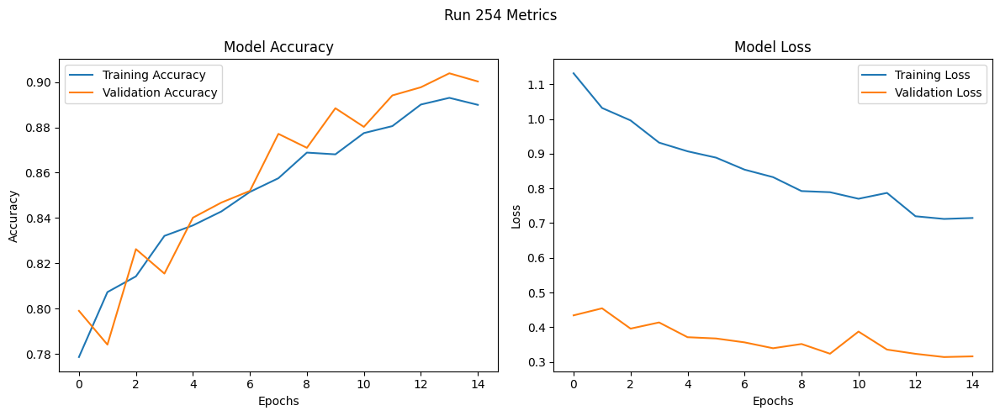

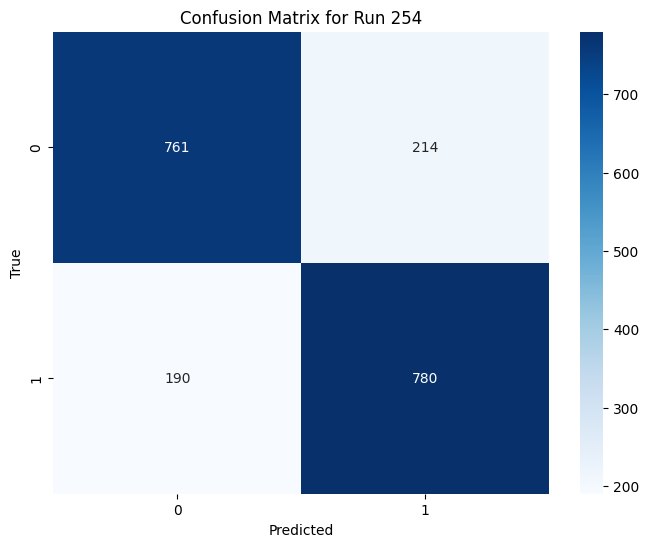

Run 255: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - accuracy: 0.7606 - loss: 1.2059 - val_accuracy: 0.7712 - val_loss: 0.4607
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.7929 - loss: 1.0570 - val_accuracy: 0.7825 - val_loss: 0.4566
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7960 - loss: 1.0363 - val_accuracy: 0.8242 - val_loss: 0.4123
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8279 - loss: 0.9497 - val_accuracy: 0.8195 - val_loss: 0.4120
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8353 - loss: 0.9319 - val_accuracy: 0.8339 - val_loss: 0.3883
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8421 - loss: 0.8882 - val_accuracy: 0.8350 - val_loss: 0.4093
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - a

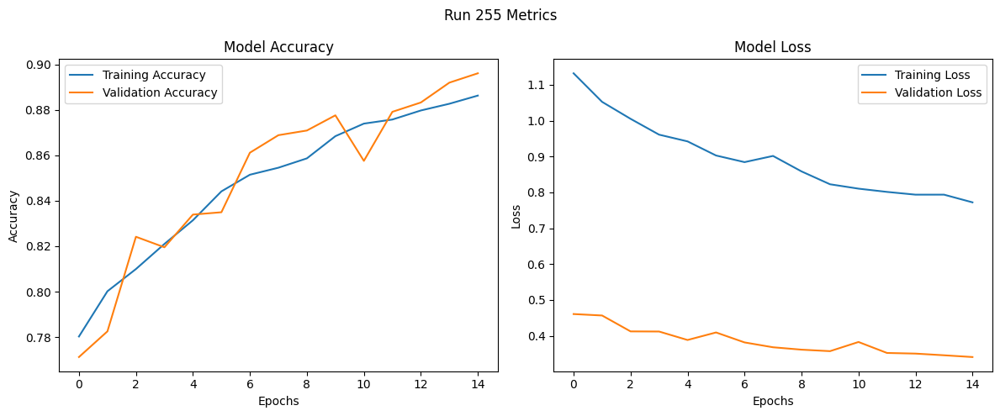

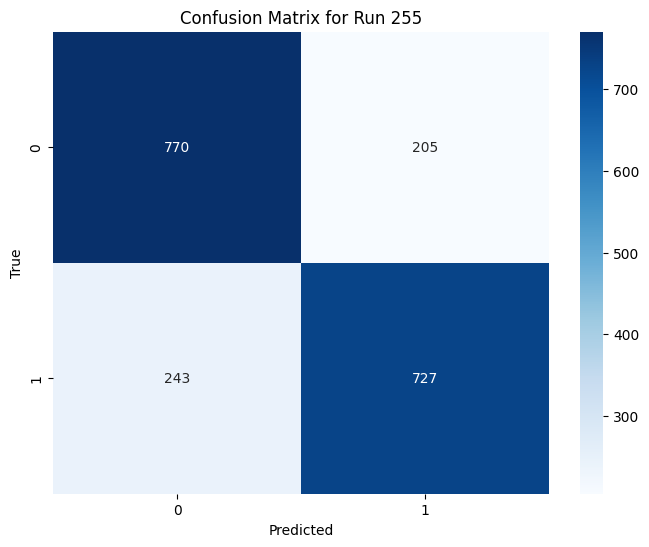

Run 256: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7669 - loss: 1.7078 - val_accuracy: 0.8010 - val_loss: 0.4470
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8073 - loss: 1.4510 - val_accuracy: 0.8103 - val_loss: 0.4239
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8236 - loss: 1.3391 - val_accuracy: 0.8278 - val_loss: 0.3921
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8422 - loss: 1.3148 - val_accuracy: 0.8226 - val_loss: 0.3975
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8405 - loss: 1.2755 - val_accuracy: 0.8473 - val_loss: 0.3703
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8527 - loss: 1.1908 - val_accuracy: 0.8571 - val_loss: 0.3599
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - 

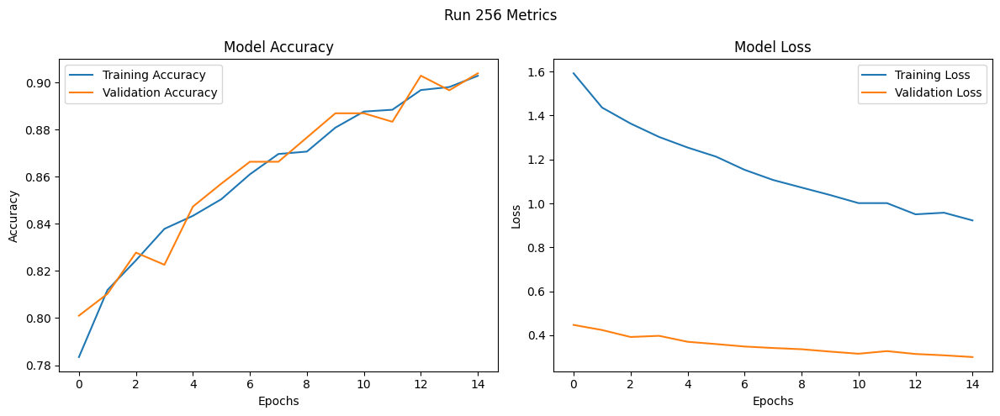

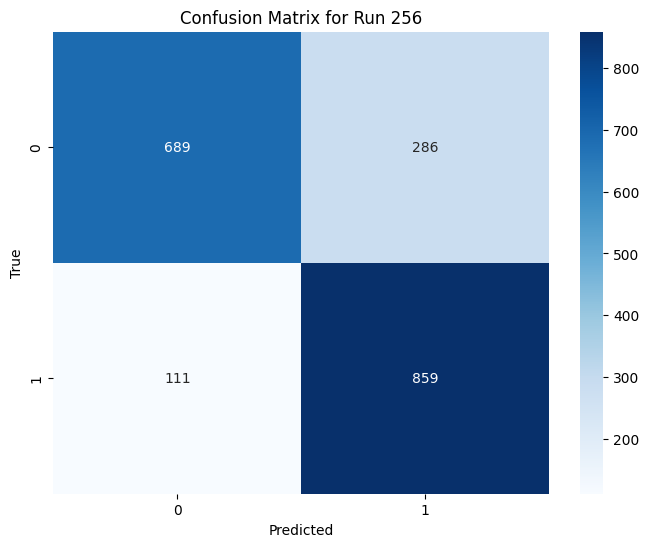

Run 257: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7604 - loss: 1.7202 - val_accuracy: 0.7969 - val_loss: 0.4378
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8096 - loss: 1.4703 - val_accuracy: 0.8062 - val_loss: 0.4292
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8165 - loss: 1.3696 - val_accuracy: 0.8180 - val_loss: 0.4027
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8330 - loss: 1.2942 - val_accuracy: 0.8242 - val_loss: 0.3920
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8474 - loss: 1.2455 - val_accuracy: 0.8360 - val_loss: 0.3884
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8540 - loss: 1.2111 - val_accuracy: 0.8504 - val_loss: 0.3700
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step -

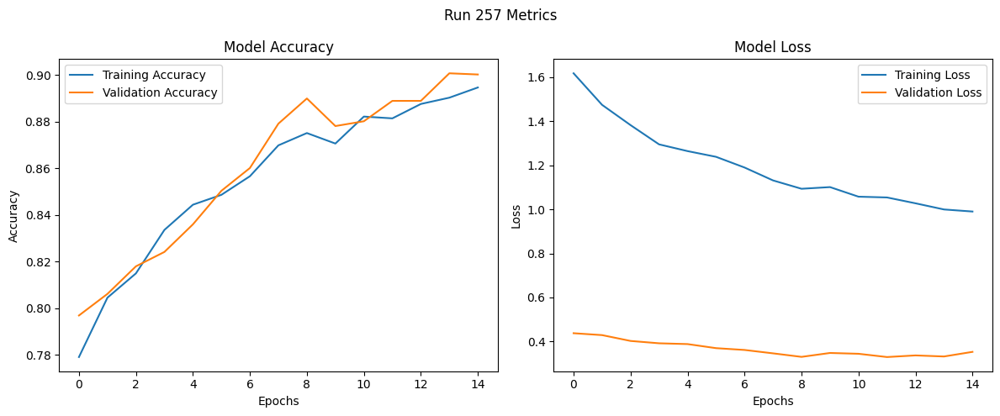

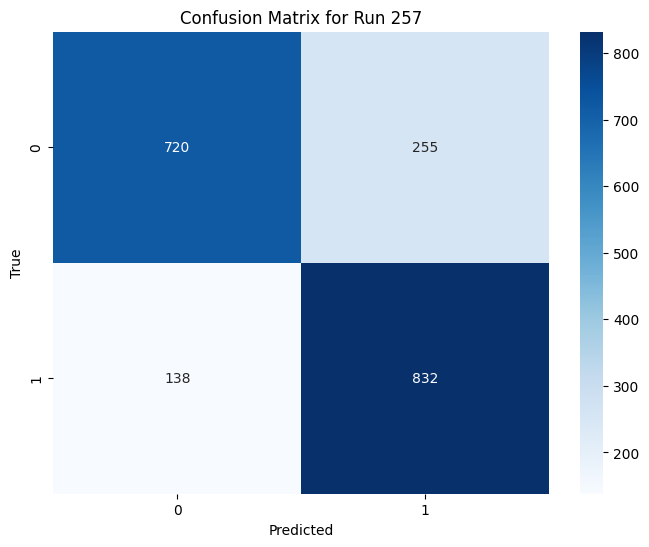

Run 258: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7587 - loss: 1.7054 - val_accuracy: 0.8051 - val_loss: 0.4474
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8146 - loss: 1.4783 - val_accuracy: 0.8051 - val_loss: 0.4459
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8188 - loss: 1.4110 - val_accuracy: 0.8180 - val_loss: 0.4257
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8286 - loss: 1.3560 - val_accuracy: 0.8401 - val_loss: 0.4104
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8353 - loss: 1.3049 - val_accuracy: 0.8288 - val_loss: 0.4228
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8448 - loss: 1.2571 - val_accuracy: 0.8298 - val_loss: 0.4087
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - a

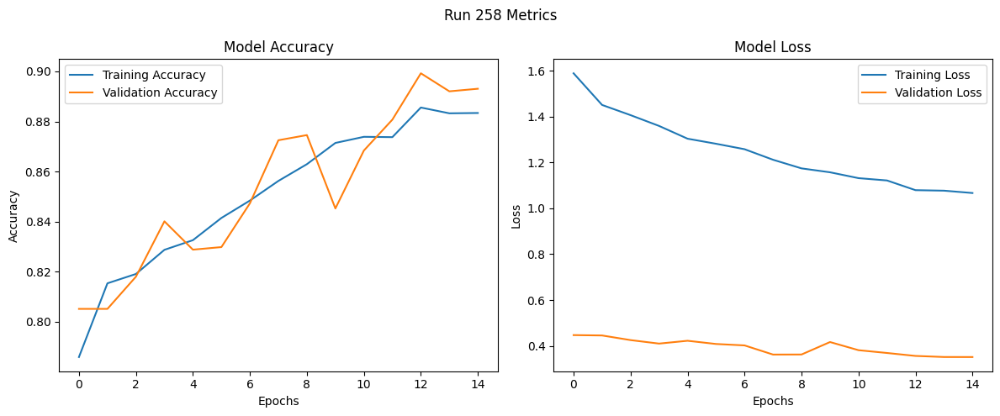

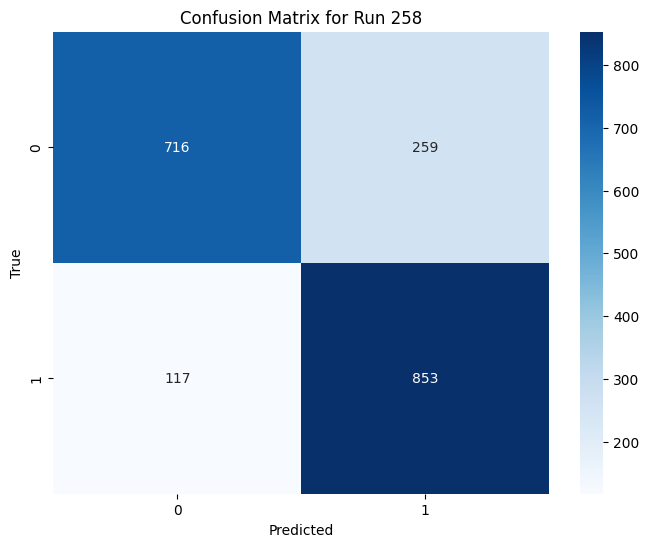

Run 259: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7590 - loss: 1.1955 - val_accuracy: 0.7913 - val_loss: 0.4401
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8102 - loss: 1.0204 - val_accuracy: 0.8000 - val_loss: 0.4250
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8178 - loss: 0.9726 - val_accuracy: 0.8216 - val_loss: 0.4166
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8320 - loss: 0.9389 - val_accuracy: 0.8267 - val_loss: 0.3966
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8278 - loss: 0.9050 - val_accuracy: 0.8468 - val_loss: 0.3815
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8522 - loss: 0.8541 - val_accuracy: 0.8524 - val_loss: 0.3556
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step -

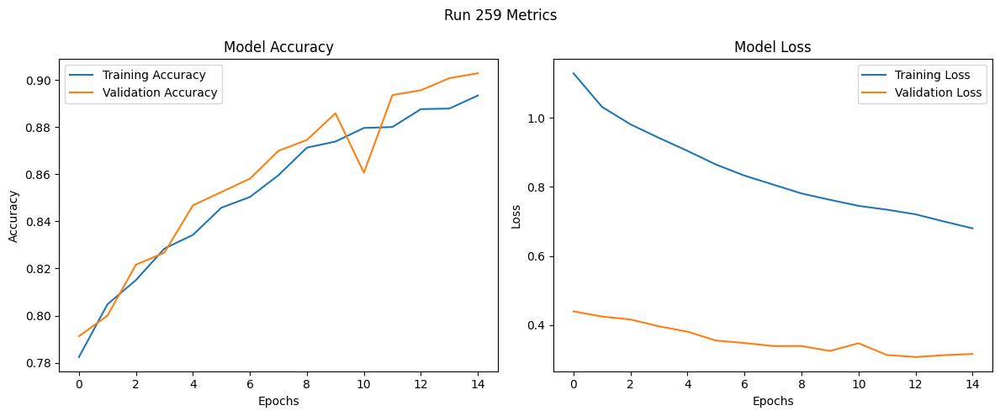

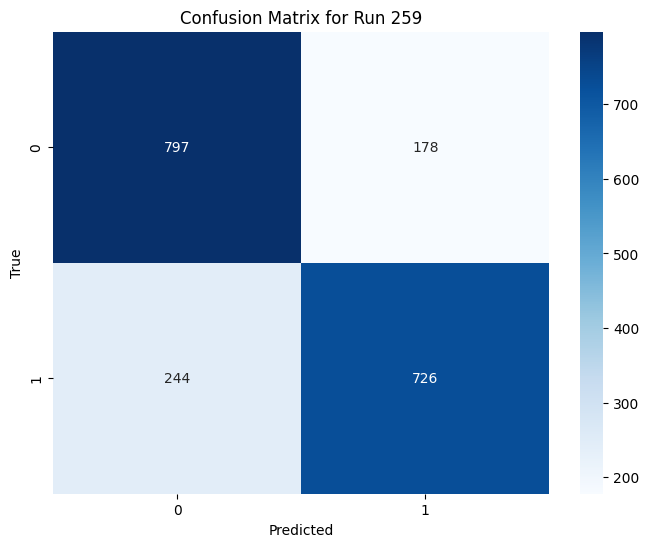

Run 260: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7353 - loss: 1.2410 - val_accuracy: 0.8108 - val_loss: 0.4366
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8133 - loss: 1.0135 - val_accuracy: 0.8087 - val_loss: 0.4205
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8132 - loss: 0.9934 - val_accuracy: 0.8087 - val_loss: 0.4237
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8214 - loss: 0.9358 - val_accuracy: 0.8247 - val_loss: 0.3987
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8216 - loss: 0.9235 - val_accuracy: 0.8334 - val_loss: 0.3885
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8324 - loss: 0.9317 - val_accuracy: 0.8452 - val_loss: 0.3681
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step 

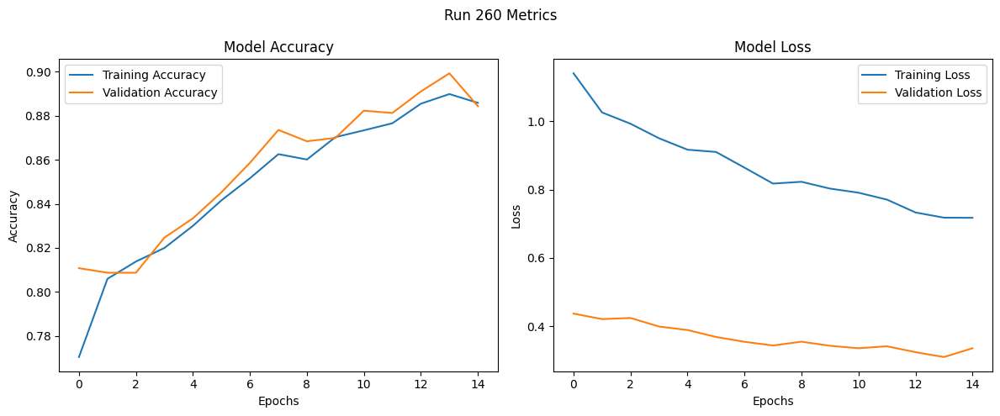

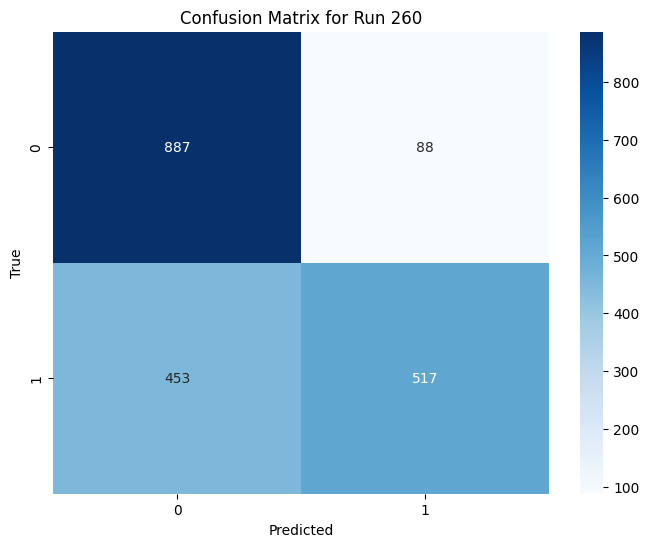

Run 261: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step - accuracy: 0.7475 - loss: 1.2495 - val_accuracy: 0.7887 - val_loss: 0.4644
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.8101 - loss: 1.0252 - val_accuracy: 0.8108 - val_loss: 0.4394
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8124 - loss: 1.0123 - val_accuracy: 0.7938 - val_loss: 0.4284
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8111 - loss: 0.9844 - val_accuracy: 0.8278 - val_loss: 0.4052
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8242 - loss: 0.9509 - val_accuracy: 0.8195 - val_loss: 0.4204
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8381 - loss: 0.9268 - val_accuracy: 0.8206 - val_loss: 0.4124
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - 

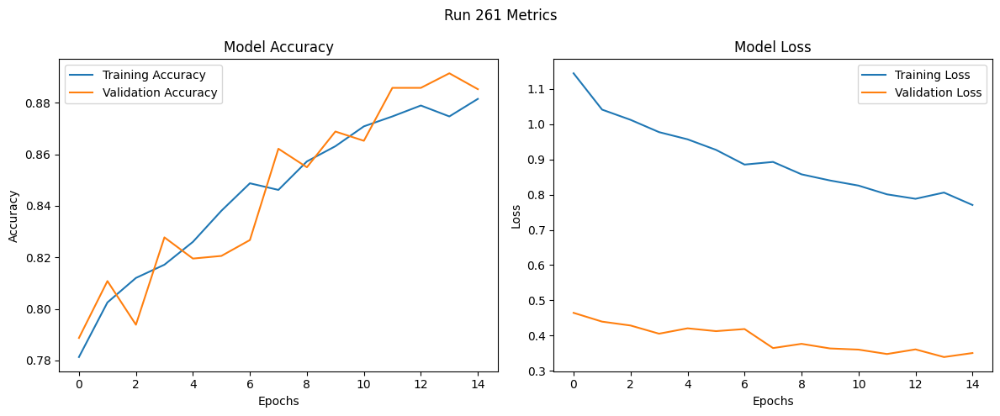

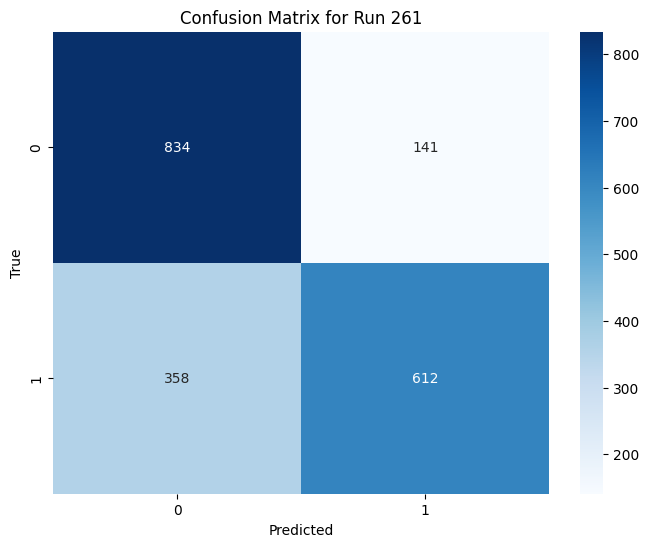

Run 262: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step - accuracy: 0.7516 - loss: 1.7350 - val_accuracy: 0.8015 - val_loss: 0.4365
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8112 - loss: 1.4220 - val_accuracy: 0.8005 - val_loss: 0.4205
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8200 - loss: 1.3829 - val_accuracy: 0.8206 - val_loss: 0.3949
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8276 - loss: 1.3255 - val_accuracy: 0.8344 - val_loss: 0.3884
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8410 - loss: 1.2132 - val_accuracy: 0.8437 - val_loss: 0.3884
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8461 - loss: 1.2178 - val_accuracy: 0.8586 - val_loss: 0.3588
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step -

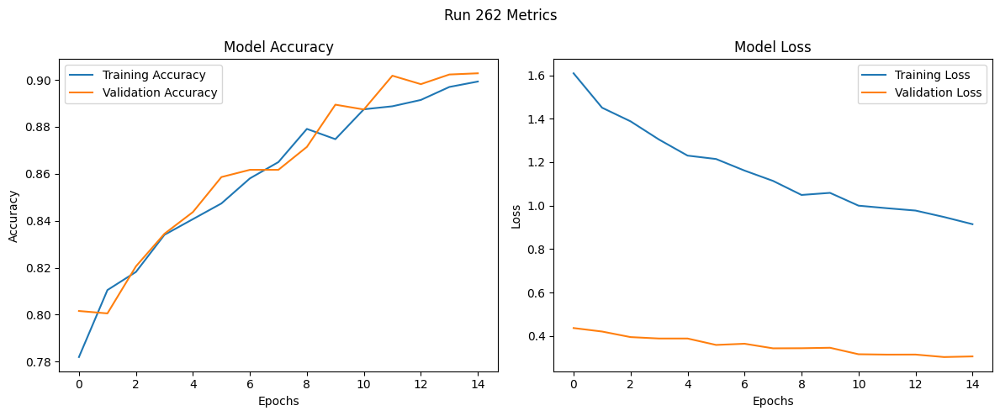

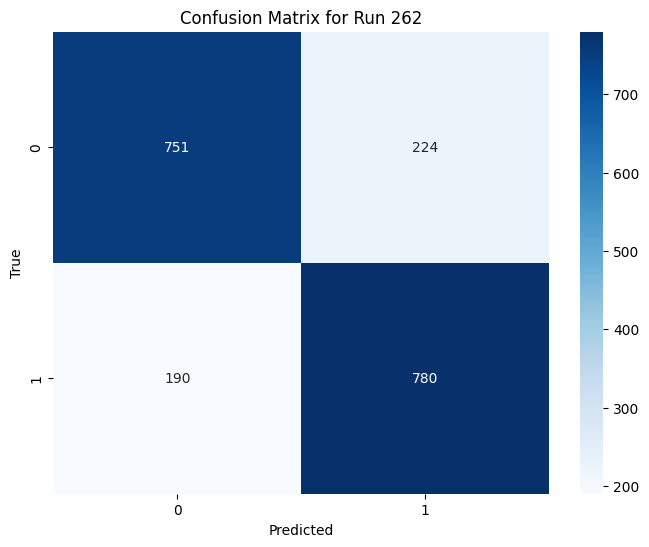

Run 263: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7657 - loss: 1.6804 - val_accuracy: 0.7743 - val_loss: 0.4672
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8064 - loss: 1.4413 - val_accuracy: 0.8031 - val_loss: 0.4189
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8230 - loss: 1.3458 - val_accuracy: 0.8087 - val_loss: 0.4163
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8282 - loss: 1.3254 - val_accuracy: 0.8175 - val_loss: 0.4087
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8437 - loss: 1.2546 - val_accuracy: 0.8427 - val_loss: 0.3790
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8486 - loss: 1.2083 - val_accuracy: 0.8530 - val_loss: 0.3741
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step 

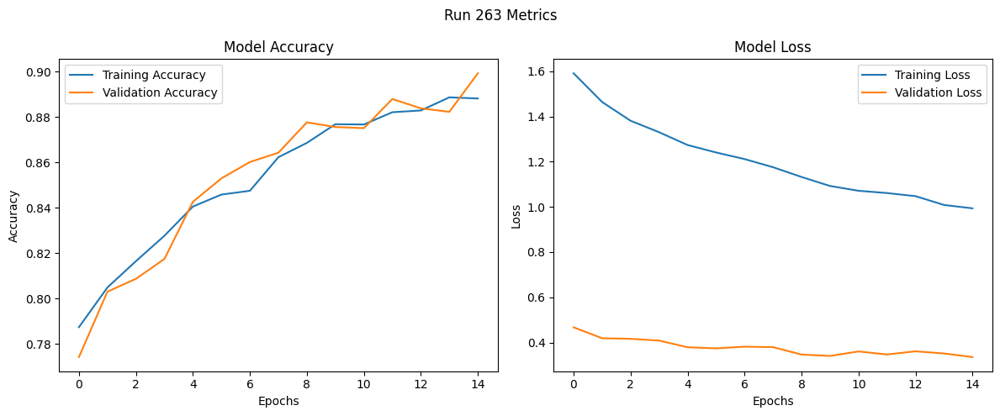

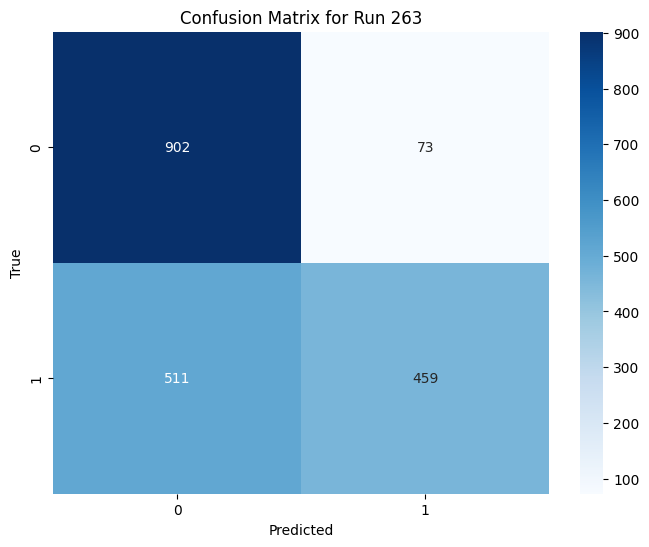

Run 264: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: categorical_crossentropy, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7496 - loss: 1.7790 - val_accuracy: 0.7897 - val_loss: 0.4599
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8028 - loss: 1.4905 - val_accuracy: 0.8103 - val_loss: 0.4237
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8117 - loss: 1.4173 - val_accuracy: 0.8098 - val_loss: 0.4200
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8256 - loss: 1.3414 - val_accuracy: 0.8129 - val_loss: 0.4183
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8282 - loss: 1.3565 - val_accuracy: 0.8458 - val_loss: 0.3937
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8381 - loss: 1.2595 - val_accuracy: 0.8550 - val_loss: 0.3749
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - 

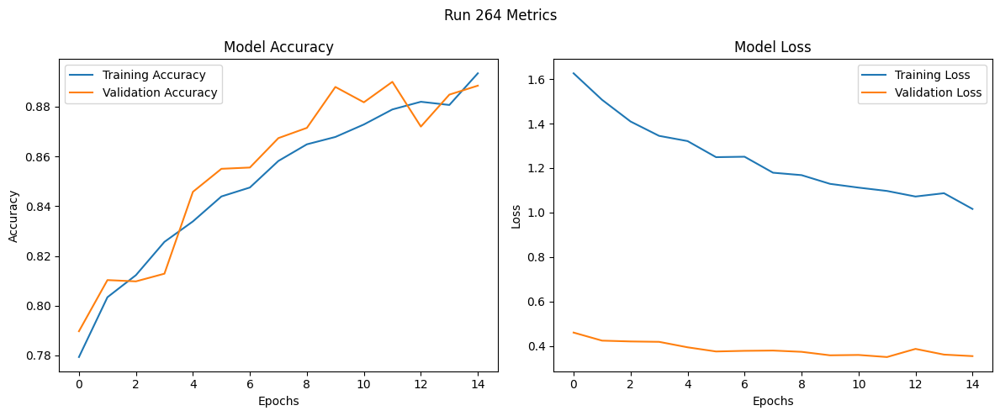

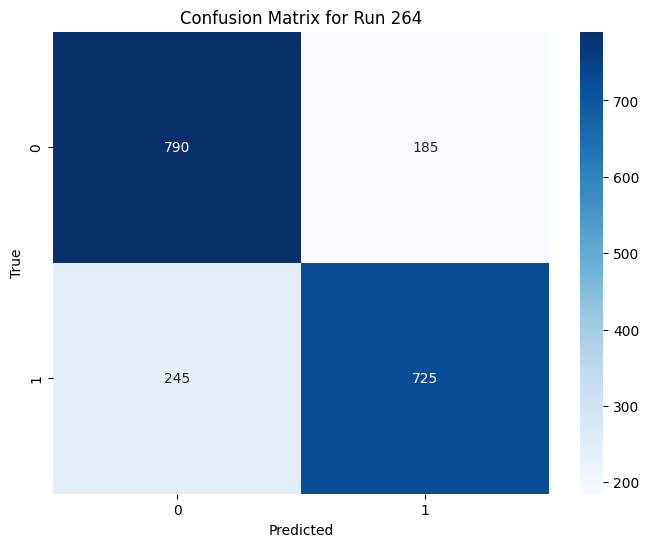

Run 265: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7676 - loss: 0.4049 - val_accuracy: 0.8057 - val_loss: 0.1495
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8013 - loss: 0.3528 - val_accuracy: 0.8077 - val_loss: 0.1429
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8186 - loss: 0.3309 - val_accuracy: 0.8093 - val_loss: 0.1460
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8313 - loss: 0.3219 - val_accuracy: 0.8159 - val_loss: 0.1391
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8434 - loss: 0.3001 - val_accuracy: 0.8293 - val_loss: 0.1376
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8525 - loss: 0.2832 - val_accuracy: 0.8427 - val_loss: 0.1342
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accurac

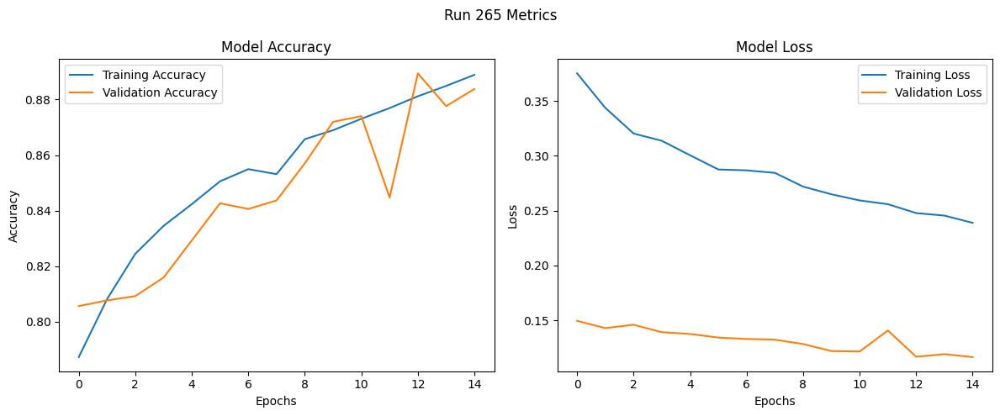

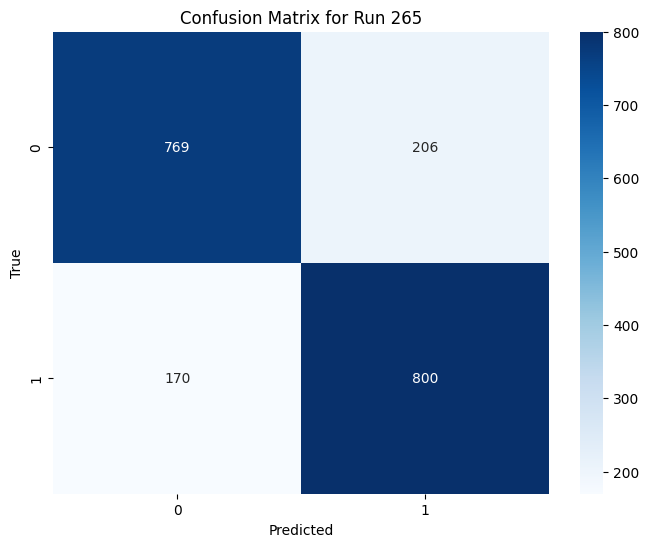

Run 266: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7578 - loss: 0.4119 - val_accuracy: 0.7830 - val_loss: 0.1556
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8115 - loss: 0.3372 - val_accuracy: 0.7990 - val_loss: 0.1501
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8267 - loss: 0.3182 - val_accuracy: 0.8154 - val_loss: 0.1400
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8234 - loss: 0.3227 - val_accuracy: 0.8231 - val_loss: 0.1418
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8389 - loss: 0.3036 - val_accuracy: 0.8221 - val_loss: 0.1424
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8506 - loss: 0.2846 - val_accuracy: 0.8375 - val_loss: 0.1339
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accura

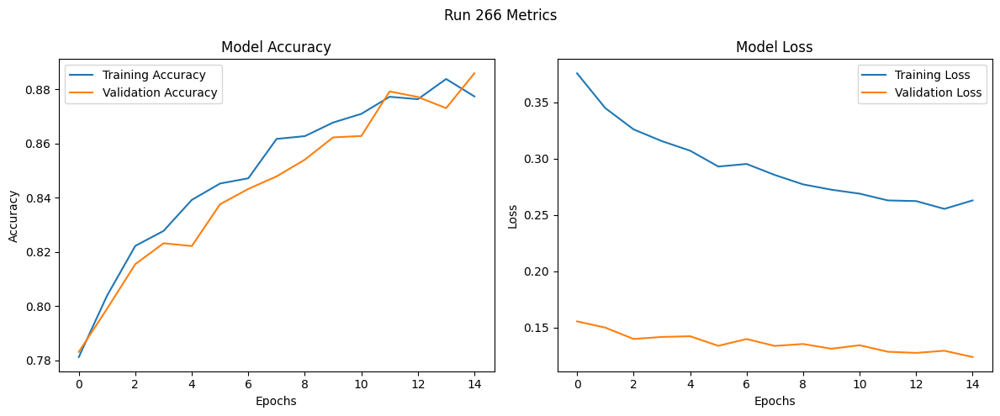

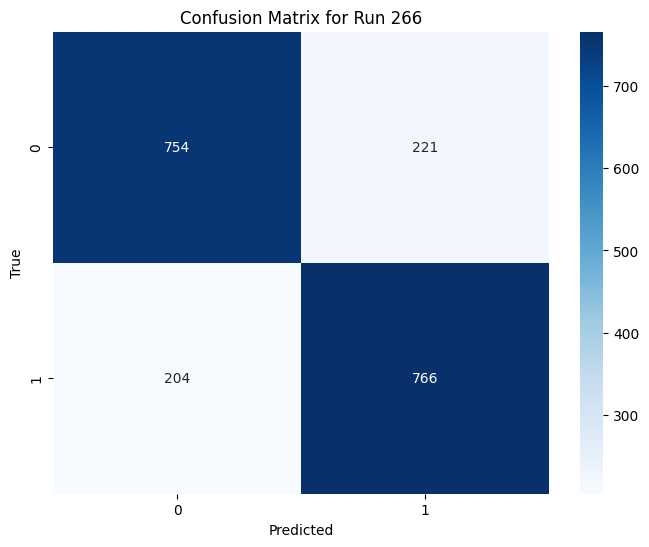

Run 267: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7600 - loss: 0.4099 - val_accuracy: 0.8021 - val_loss: 0.1609
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8094 - loss: 0.3484 - val_accuracy: 0.8072 - val_loss: 0.1490
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8228 - loss: 0.3328 - val_accuracy: 0.8206 - val_loss: 0.1447
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8216 - loss: 0.3352 - val_accuracy: 0.8272 - val_loss: 0.1447
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8326 - loss: 0.3213 - val_accuracy: 0.8175 - val_loss: 0.1514
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8496 - loss: 0.3044 - val_accuracy: 0.8406 - val_loss: 0.1467
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accurac

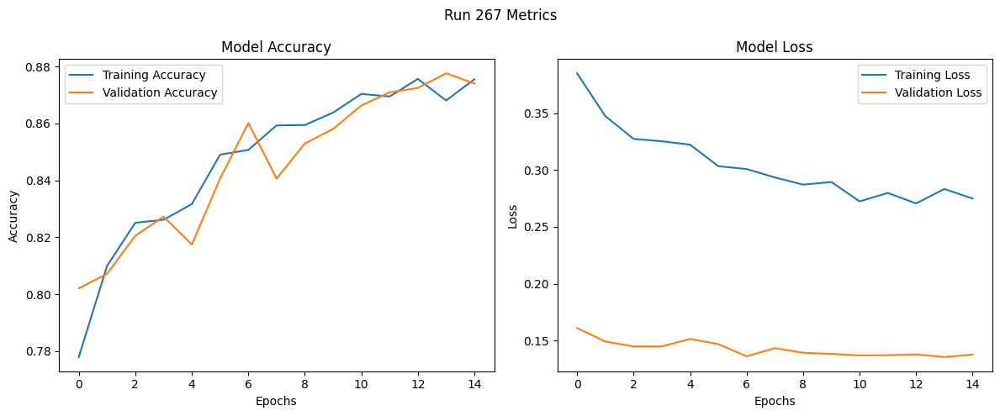

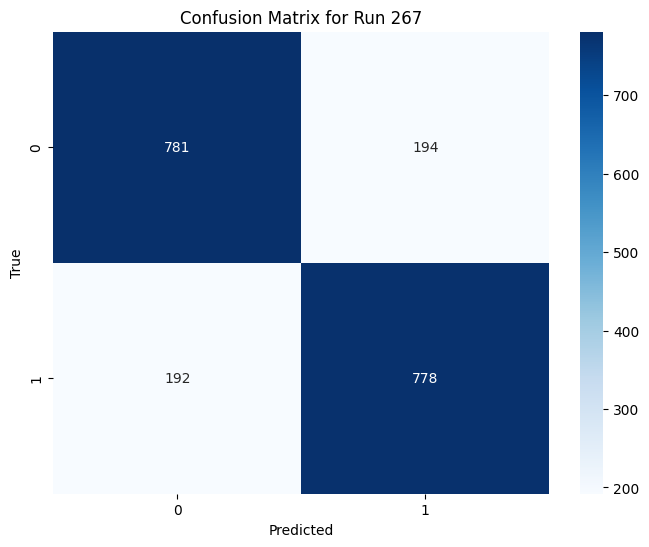

Run 268: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7557 - loss: 0.5841 - val_accuracy: 0.7990 - val_loss: 0.1522
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8136 - loss: 0.4768 - val_accuracy: 0.8123 - val_loss: 0.1461
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8306 - loss: 0.4503 - val_accuracy: 0.8226 - val_loss: 0.1397
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8424 - loss: 0.4252 - val_accuracy: 0.8314 - val_loss: 0.1402
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8463 - loss: 0.4016 - val_accuracy: 0.8473 - val_loss: 0.1297
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8497 - loss: 0.4002 - val_accuracy: 0.8452 - val_loss: 0.1331
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accurac

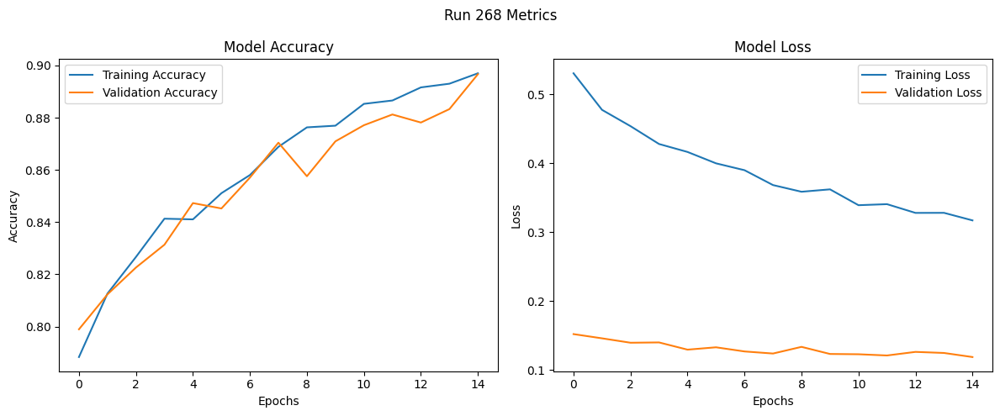

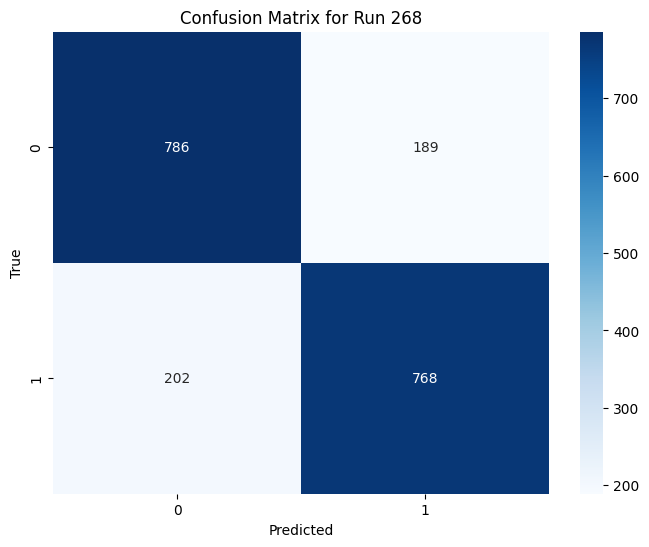

Run 269: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7500 - loss: 0.5892 - val_accuracy: 0.8000 - val_loss: 0.1533
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.8098 - loss: 0.4973 - val_accuracy: 0.8005 - val_loss: 0.1505
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8326 - loss: 0.4401 - val_accuracy: 0.8231 - val_loss: 0.1432
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8308 - loss: 0.4422 - val_accuracy: 0.8257 - val_loss: 0.1421
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8439 - loss: 0.4270 - val_accuracy: 0.8329 - val_loss: 0.1425
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8504 - loss: 0.4042 - val_accuracy: 0.8452 - val_loss: 0.1418
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accur

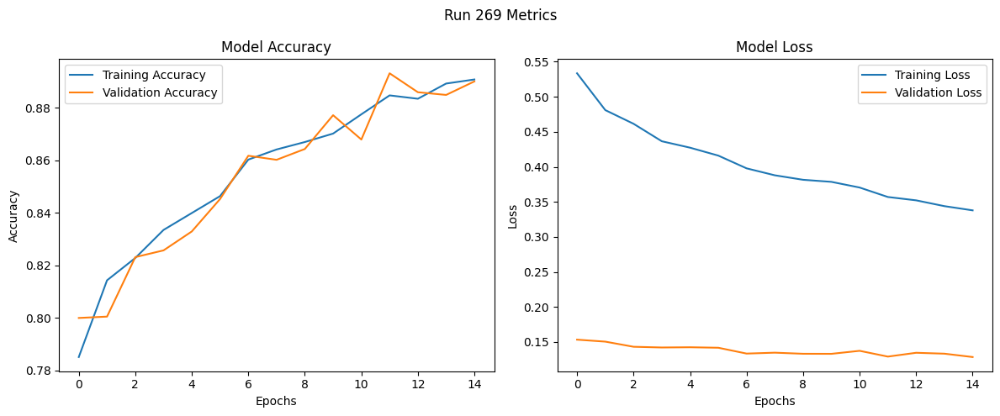

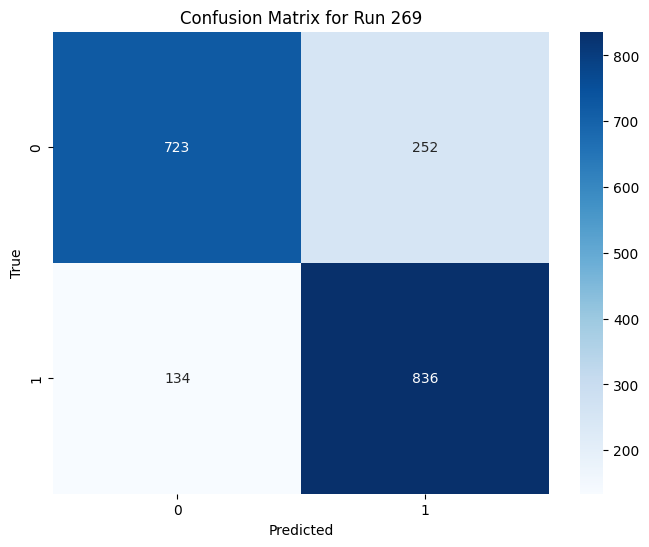

Run 270: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7640 - loss: 0.5834 - val_accuracy: 0.7825 - val_loss: 0.1619
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8148 - loss: 0.4684 - val_accuracy: 0.8134 - val_loss: 0.1463
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8233 - loss: 0.4670 - val_accuracy: 0.8149 - val_loss: 0.1497
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8241 - loss: 0.4617 - val_accuracy: 0.8113 - val_loss: 0.1494
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8455 - loss: 0.4246 - val_accuracy: 0.8427 - val_loss: 0.1465
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8465 - loss: 0.4295 - val_accuracy: 0.8391 - val_loss: 0.1450
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy

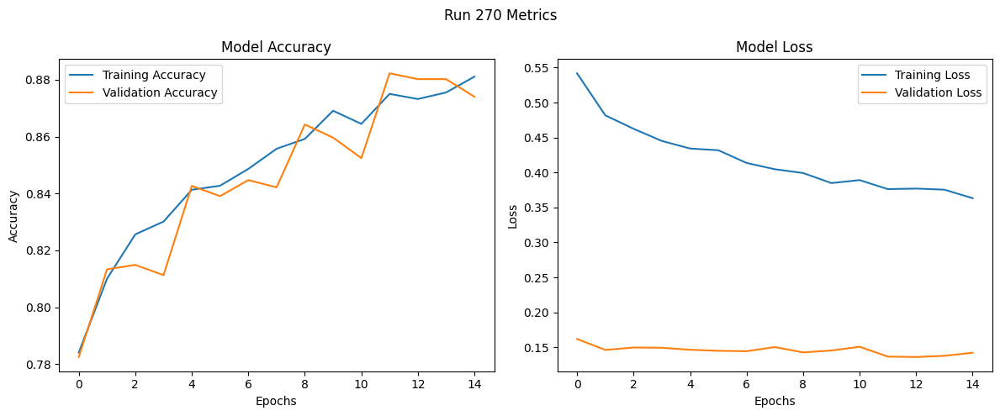

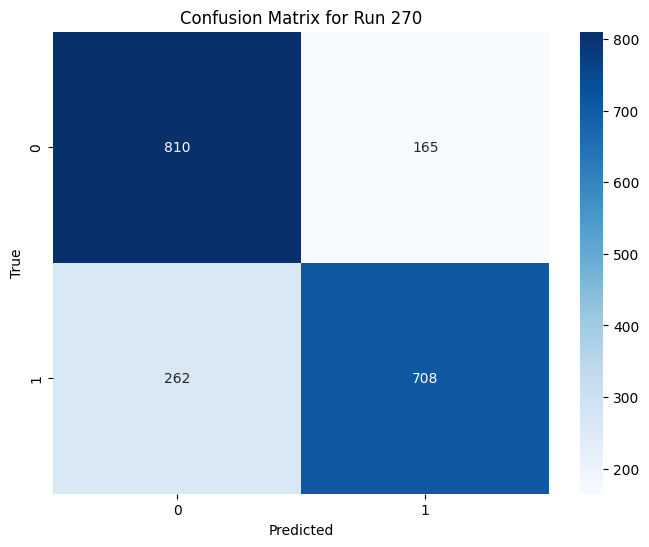

Run 271: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7576 - loss: 0.4159 - val_accuracy: 0.7810 - val_loss: 0.1597
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8006 - loss: 0.3498 - val_accuracy: 0.8144 - val_loss: 0.1460
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8197 - loss: 0.3271 - val_accuracy: 0.8216 - val_loss: 0.1406
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8308 - loss: 0.3137 - val_accuracy: 0.8272 - val_loss: 0.1377
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8322 - loss: 0.3100 - val_accuracy: 0.8334 - val_loss: 0.1357
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8519 - loss: 0.2888 - val_accuracy: 0.8360 - val_loss: 0.1368
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accur

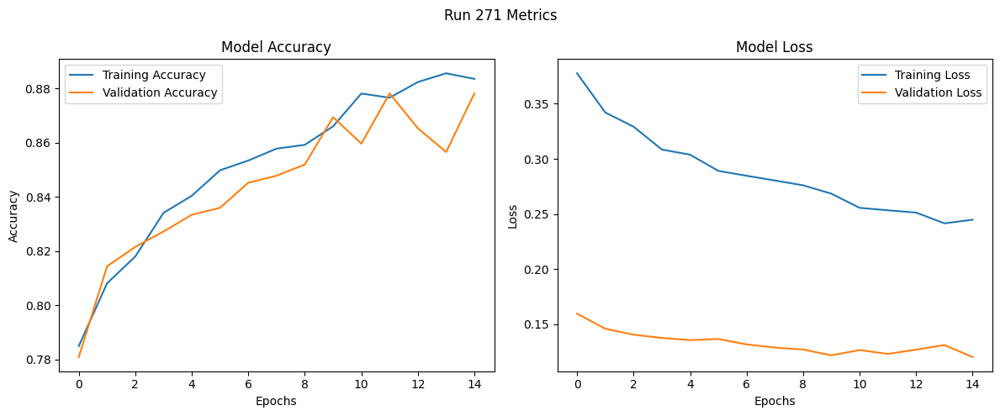

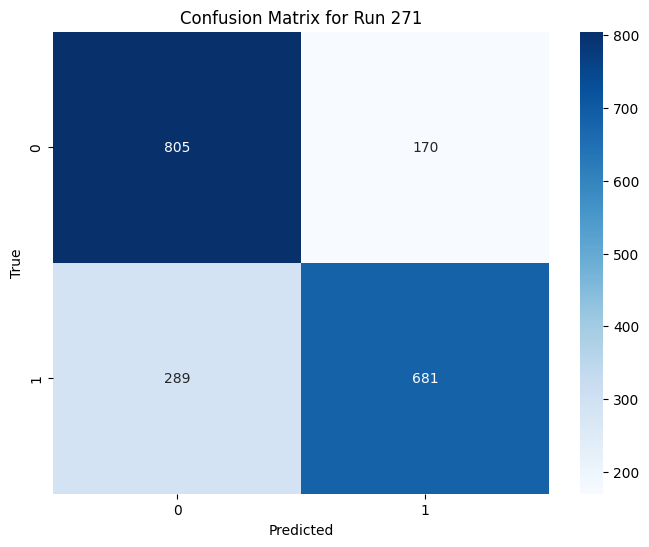

Run 272: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7620 - loss: 0.4109 - val_accuracy: 0.7959 - val_loss: 0.1538
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8148 - loss: 0.3374 - val_accuracy: 0.8093 - val_loss: 0.1473
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8138 - loss: 0.3290 - val_accuracy: 0.8103 - val_loss: 0.1473
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8256 - loss: 0.3241 - val_accuracy: 0.8231 - val_loss: 0.1480
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8393 - loss: 0.3108 - val_accuracy: 0.8303 - val_loss: 0.1405
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8370 - loss: 0.2949 - val_accuracy: 0.8344 - val_loss: 0.1395
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accu

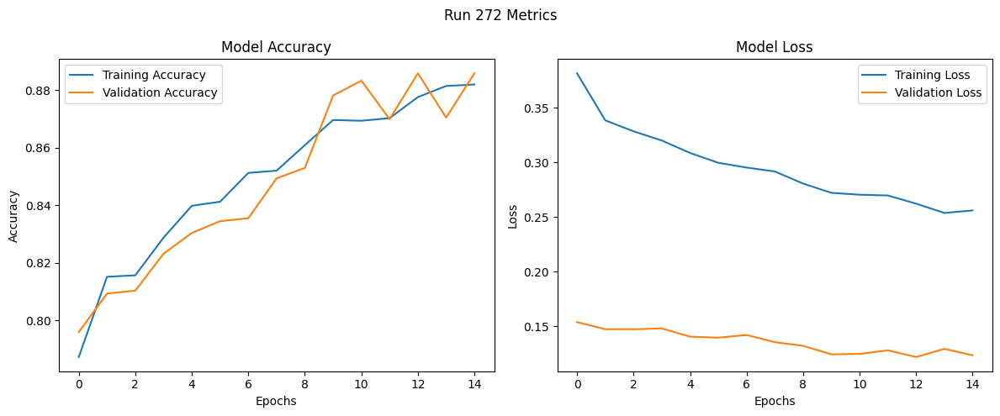

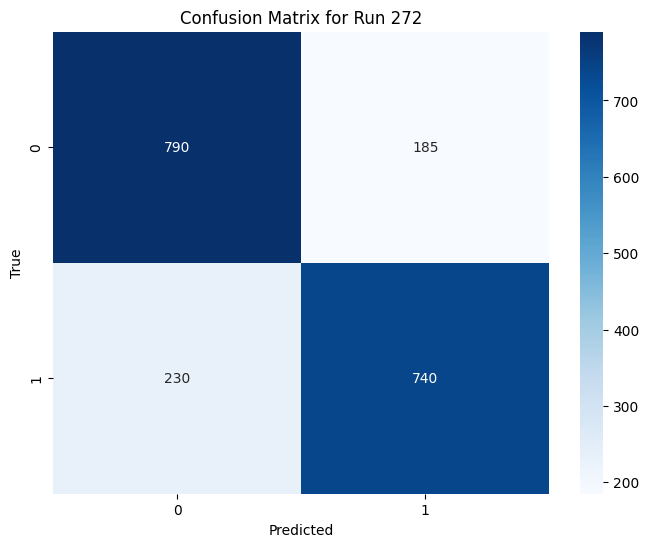

Run 273: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7658 - loss: 0.4133 - val_accuracy: 0.7851 - val_loss: 0.1624
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8106 - loss: 0.3514 - val_accuracy: 0.8010 - val_loss: 0.1516
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8137 - loss: 0.3394 - val_accuracy: 0.8129 - val_loss: 0.1490
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8258 - loss: 0.3271 - val_accuracy: 0.8226 - val_loss: 0.1476
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8342 - loss: 0.3267 - val_accuracy: 0.8365 - val_loss: 0.1409
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8468 - loss: 0.3059 - val_accuracy: 0.8314 - val_loss: 0.1452
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accurac

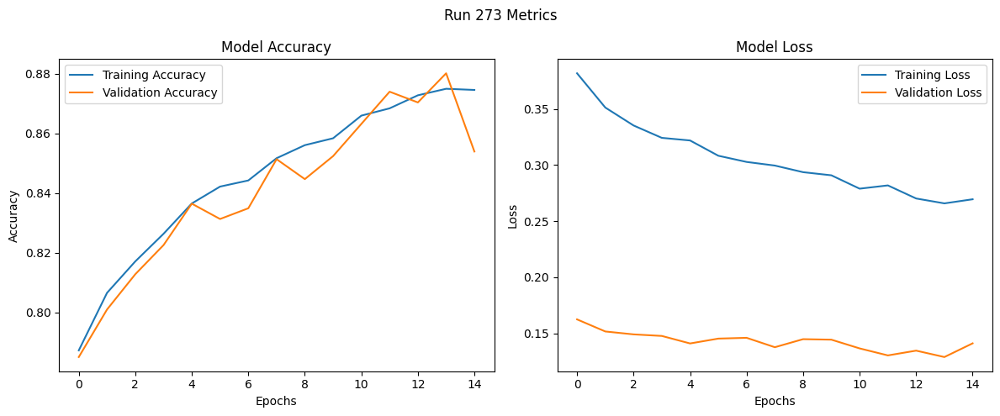

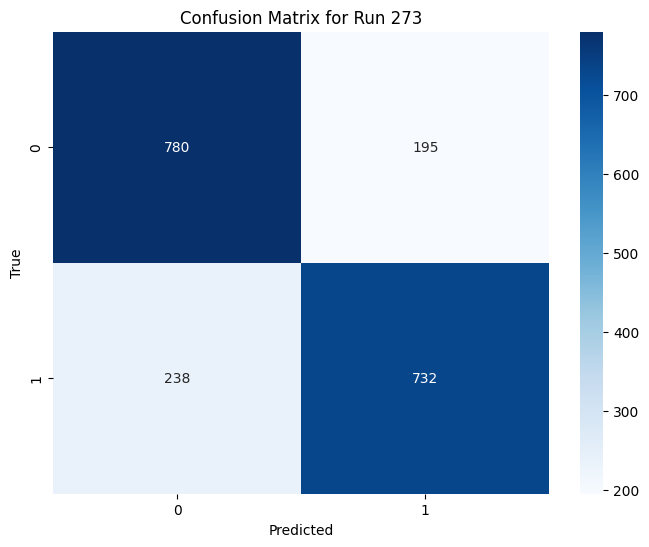

Run 274: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7430 - loss: 0.5931 - val_accuracy: 0.7959 - val_loss: 0.1490
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8037 - loss: 0.4870 - val_accuracy: 0.7979 - val_loss: 0.1467
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8242 - loss: 0.4458 - val_accuracy: 0.8077 - val_loss: 0.1476
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8363 - loss: 0.4330 - val_accuracy: 0.8170 - val_loss: 0.1396
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8467 - loss: 0.4135 - val_accuracy: 0.8494 - val_loss: 0.1304
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8559 - loss: 0.3960 - val_accuracy: 0.8468 - val_loss: 0.1352
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accura

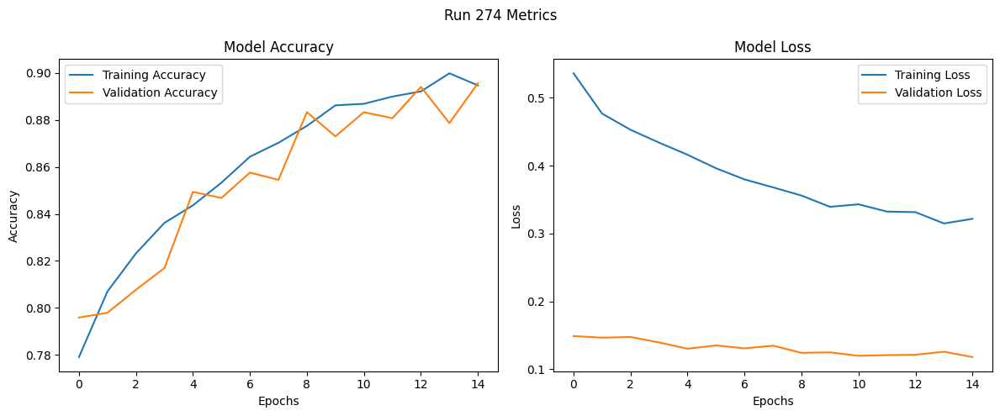

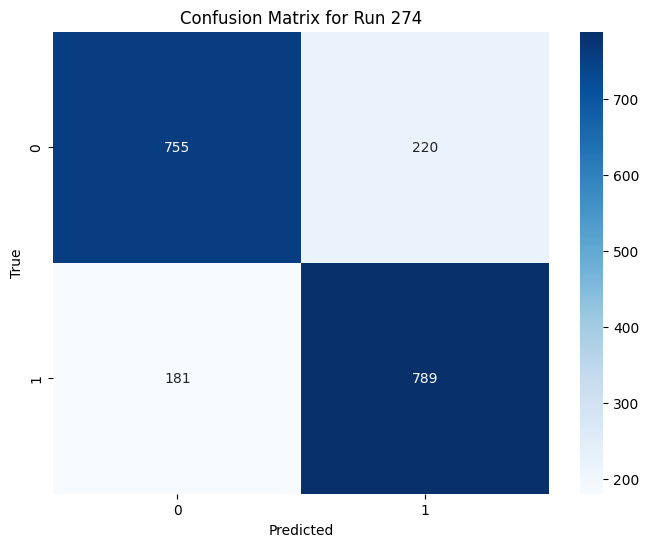

Run 275: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - accuracy: 0.7486 - loss: 0.5860 - val_accuracy: 0.7959 - val_loss: 0.1558
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8036 - loss: 0.4933 - val_accuracy: 0.8062 - val_loss: 0.1496
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8235 - loss: 0.4563 - val_accuracy: 0.8201 - val_loss: 0.1471
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8389 - loss: 0.4305 - val_accuracy: 0.8272 - val_loss: 0.1447
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8408 - loss: 0.4272 - val_accuracy: 0.8293 - val_loss: 0.1470
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8583 - loss: 0.4033 - val_accuracy: 0.8488 - val_loss: 0.1389
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accur

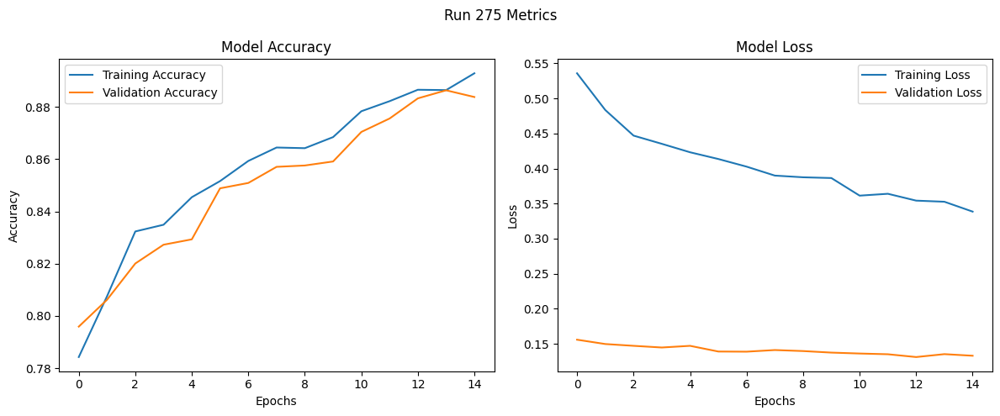

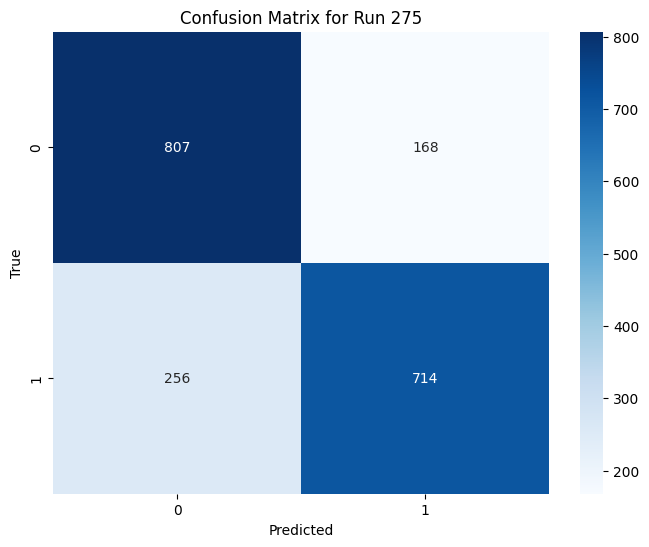

Run 276: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: mean_squared_error, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7538 - loss: 0.5879 - val_accuracy: 0.7882 - val_loss: 0.1581
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7934 - loss: 0.4981 - val_accuracy: 0.8082 - val_loss: 0.1493
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8159 - loss: 0.4724 - val_accuracy: 0.8154 - val_loss: 0.1483
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8302 - loss: 0.4489 - val_accuracy: 0.8211 - val_loss: 0.1486
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8407 - loss: 0.4320 - val_accuracy: 0.8237 - val_loss: 0.1481
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8436 - loss: 0.4256 - val_accuracy: 0.8422 - val_loss: 0.1405
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accurac

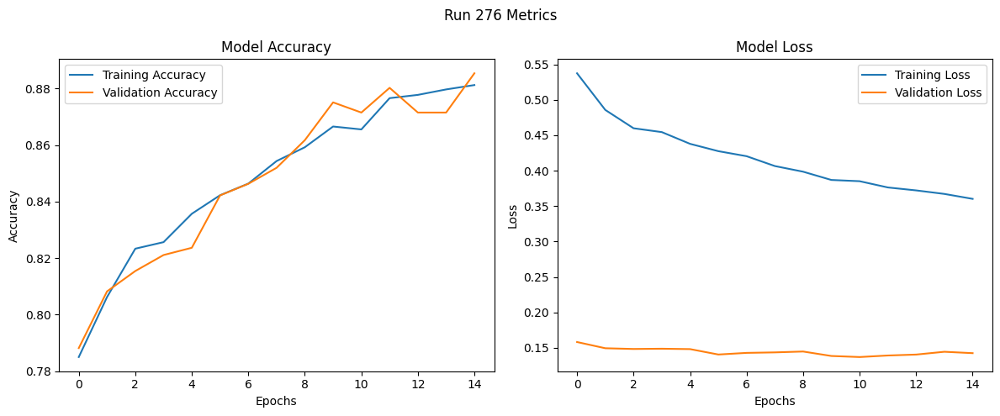

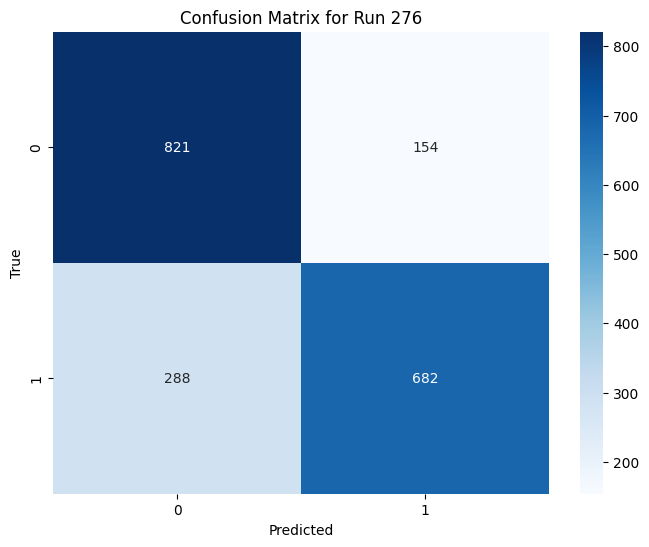

Run 277: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7399 - loss: 0.2041 - val_accuracy: 0.7897 - val_loss: 0.0767
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8057 - loss: 0.1652 - val_accuracy: 0.7938 - val_loss: 0.0742
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8210 - loss: 0.1541 - val_accuracy: 0.7913 - val_loss: 0.0749
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8313 - loss: 0.1496 - val_accuracy: 0.8206 - val_loss: 0.0666
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8397 - loss: 0.1421 - val_accuracy: 0.8308 - val_loss: 0.0649
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8435 - loss: 0.1373 - val_accuracy: 0.8303 - val_loss: 0.0671
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8468 

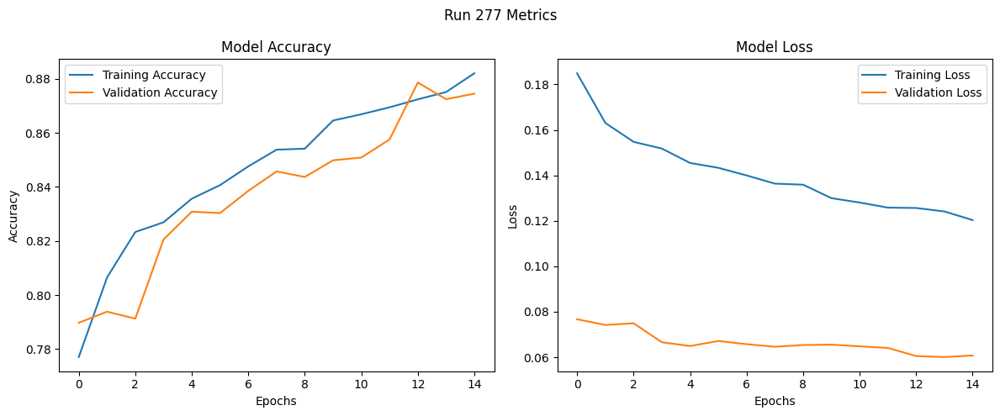

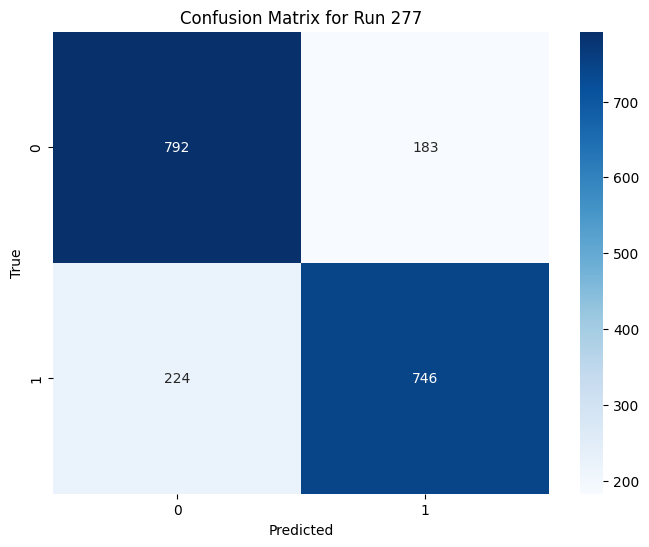

Run 278: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7569 - loss: 0.2021 - val_accuracy: 0.7928 - val_loss: 0.0777
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8071 - loss: 0.1626 - val_accuracy: 0.7969 - val_loss: 0.0746
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8148 - loss: 0.1585 - val_accuracy: 0.7995 - val_loss: 0.0751
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8301 - loss: 0.1512 - val_accuracy: 0.8165 - val_loss: 0.0695
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8449 - loss: 0.1427 - val_accuracy: 0.8087 - val_loss: 0.0735
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8422 - loss: 0.1421 - val_accuracy: 0.8216 - val_loss: 0.0716
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8532

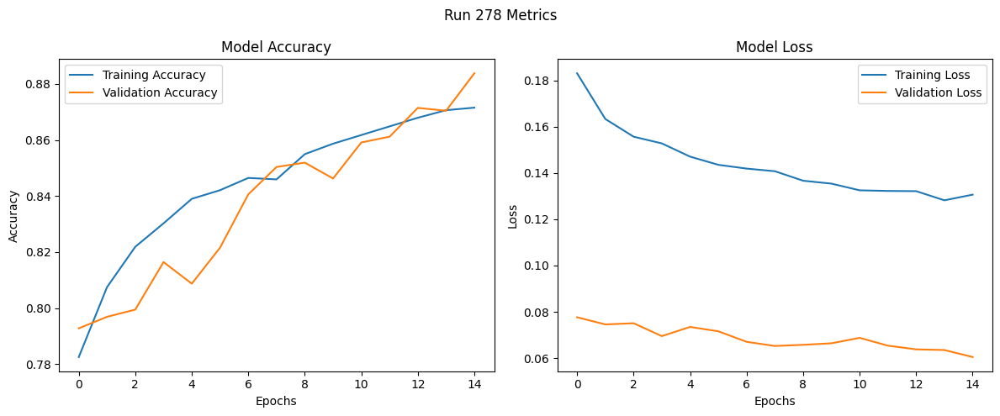

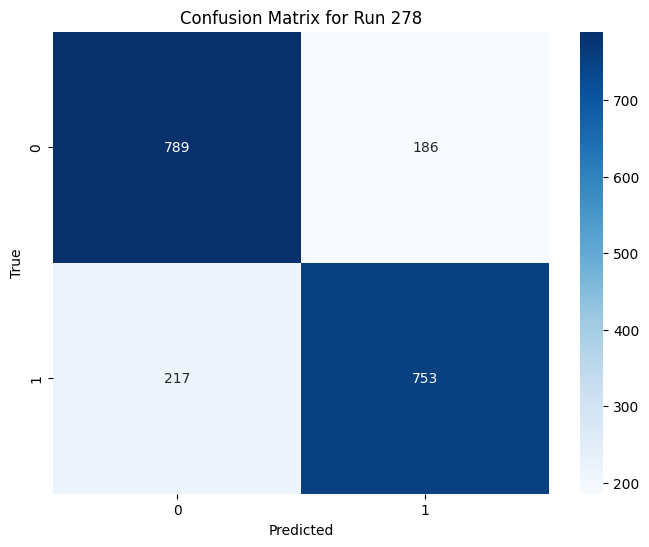

Run 279: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7475 - loss: 0.1987 - val_accuracy: 0.8000 - val_loss: 0.0756
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8155 - loss: 0.1626 - val_accuracy: 0.7897 - val_loss: 0.0755
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8123 - loss: 0.1634 - val_accuracy: 0.8206 - val_loss: 0.0718
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8211 - loss: 0.1588 - val_accuracy: 0.8170 - val_loss: 0.0716
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8294 - loss: 0.1532 - val_accuracy: 0.8221 - val_loss: 0.0706
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8319 - loss: 0.1502 - val_accuracy: 0.7907 - val_loss: 0.0833
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8358 

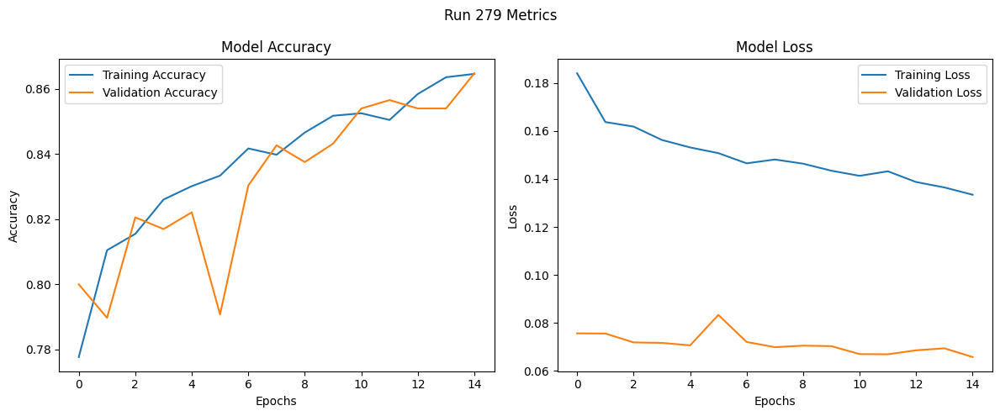

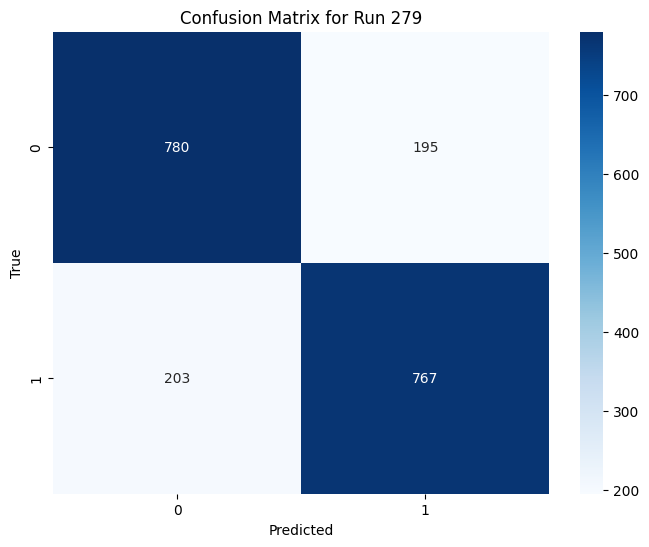

Run 280: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7489 - loss: 0.2865 - val_accuracy: 0.8000 - val_loss: 0.0748
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8043 - loss: 0.2346 - val_accuracy: 0.8057 - val_loss: 0.0718
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8199 - loss: 0.2150 - val_accuracy: 0.8108 - val_loss: 0.0710
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8212 - loss: 0.2114 - val_accuracy: 0.8221 - val_loss: 0.0687
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8431 - loss: 0.1973 - val_accuracy: 0.8103 - val_loss: 0.0736
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8394 - loss: 0.1970 - val_accuracy: 0.8380 - val_loss: 0.0665
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8568 

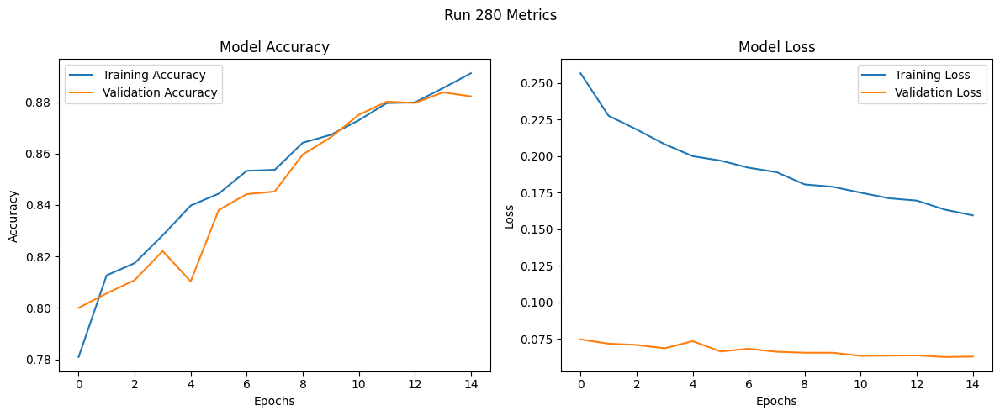

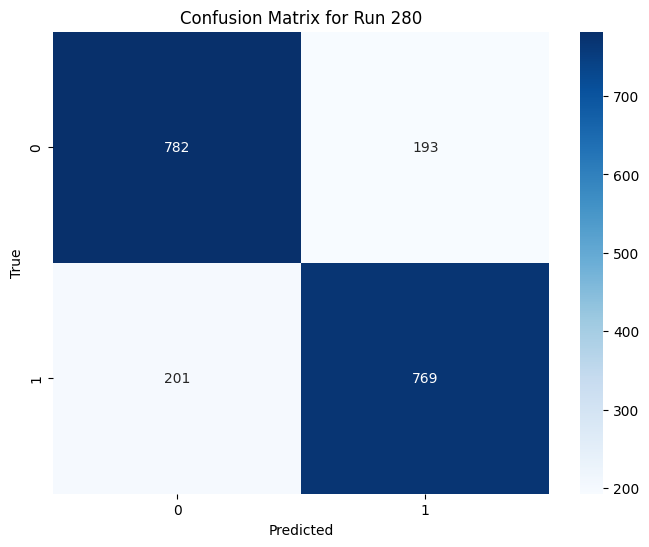

Run 281: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7570 - loss: 0.2732 - val_accuracy: 0.8005 - val_loss: 0.0743
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8139 - loss: 0.2306 - val_accuracy: 0.8134 - val_loss: 0.0724
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8251 - loss: 0.2164 - val_accuracy: 0.8113 - val_loss: 0.0745
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8381 - loss: 0.2055 - val_accuracy: 0.8185 - val_loss: 0.0720
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8305 - loss: 0.2090 - val_accuracy: 0.8201 - val_loss: 0.0705
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8382 - loss: 0.2036 - val_accuracy: 0.8180 - val_loss: 0.0748
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.844

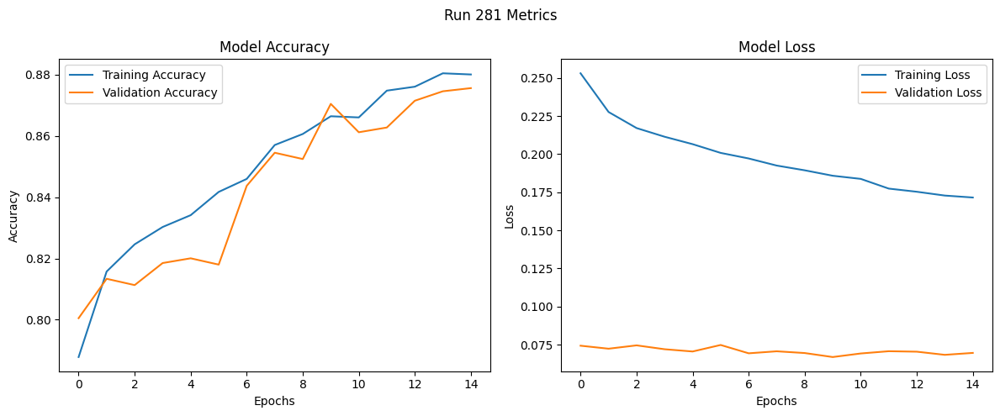

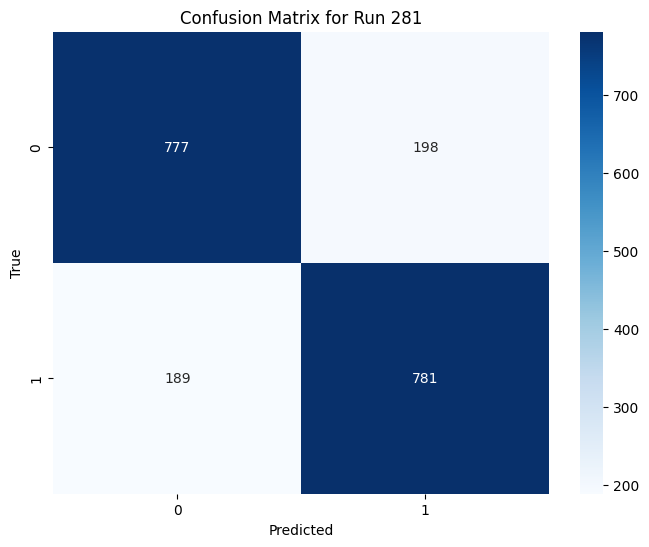

Run 282: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.5, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step - accuracy: 0.7654 - loss: 0.2779 - val_accuracy: 0.7810 - val_loss: 0.0798
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.8019 - loss: 0.2372 - val_accuracy: 0.7974 - val_loss: 0.0745
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8212 - loss: 0.2179 - val_accuracy: 0.8190 - val_loss: 0.0729
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8180 - loss: 0.2257 - val_accuracy: 0.8175 - val_loss: 0.0748
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8319 - loss: 0.2143 - val_accuracy: 0.8350 - val_loss: 0.0725
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8402 - loss: 0.2076 - val_accuracy: 0.8391 - val_loss: 0.0726
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8446 

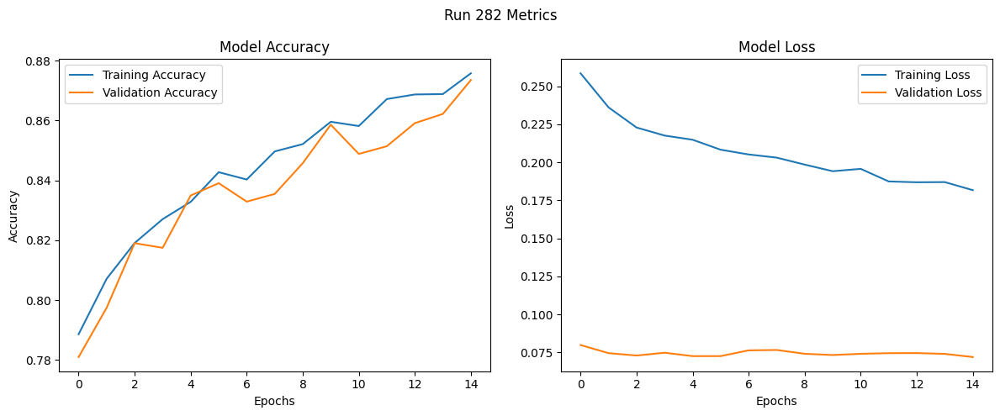

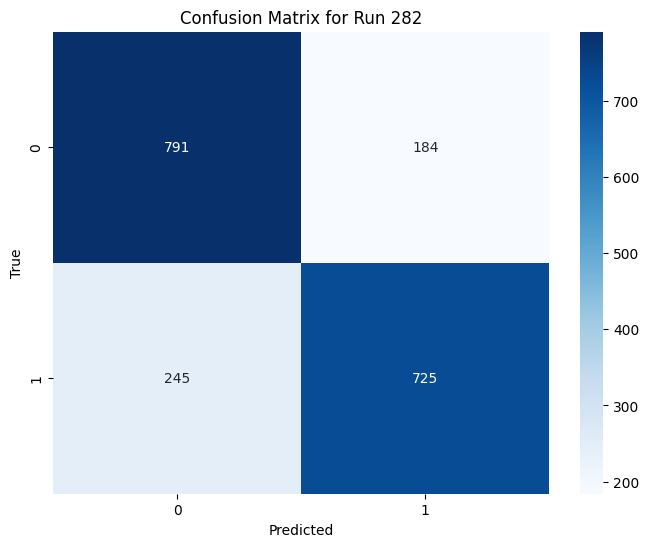

Run 283: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7505 - loss: 0.2003 - val_accuracy: 0.7743 - val_loss: 0.0783
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8026 - loss: 0.1635 - val_accuracy: 0.7779 - val_loss: 0.0792
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8152 - loss: 0.1573 - val_accuracy: 0.7928 - val_loss: 0.0747
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8271 - loss: 0.1505 - val_accuracy: 0.8201 - val_loss: 0.0672
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8362 - loss: 0.1476 - val_accuracy: 0.8288 - val_loss: 0.0687
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8461 - loss: 0.1438 - val_accuracy: 0.8324 - val_loss: 0.0667
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8449

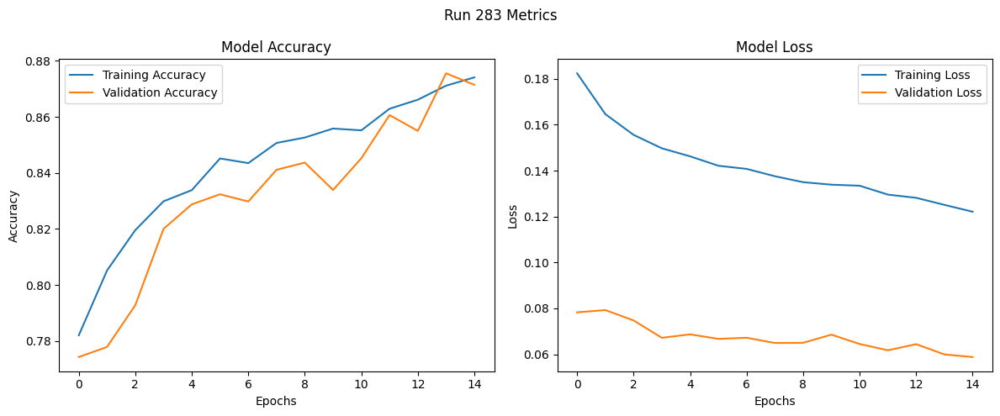

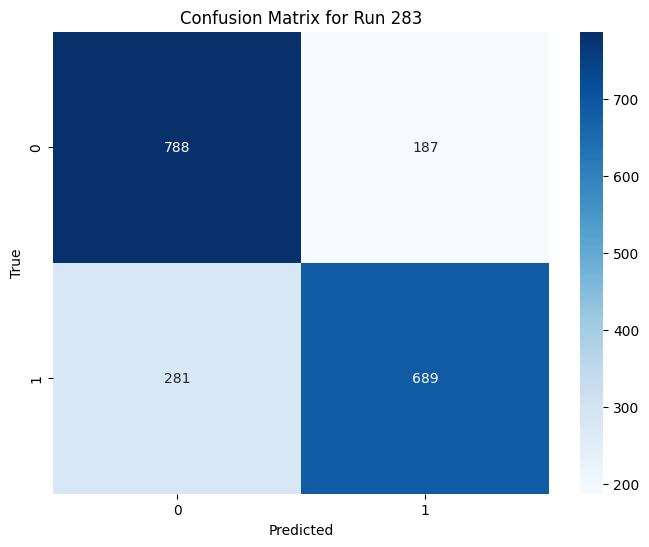

Run 284: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7599 - loss: 0.1962 - val_accuracy: 0.7979 - val_loss: 0.0752
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8016 - loss: 0.1660 - val_accuracy: 0.7789 - val_loss: 0.0787
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8192 - loss: 0.1544 - val_accuracy: 0.8180 - val_loss: 0.0696
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8215 - loss: 0.1561 - val_accuracy: 0.8237 - val_loss: 0.0689
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8405 - loss: 0.1454 - val_accuracy: 0.8262 - val_loss: 0.0677
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8404 - loss: 0.1437 - val_accuracy: 0.8391 - val_loss: 0.0679
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.84

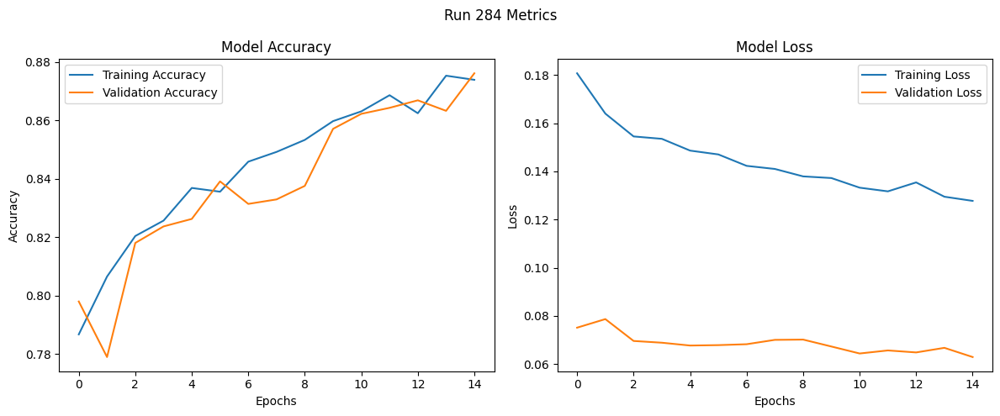

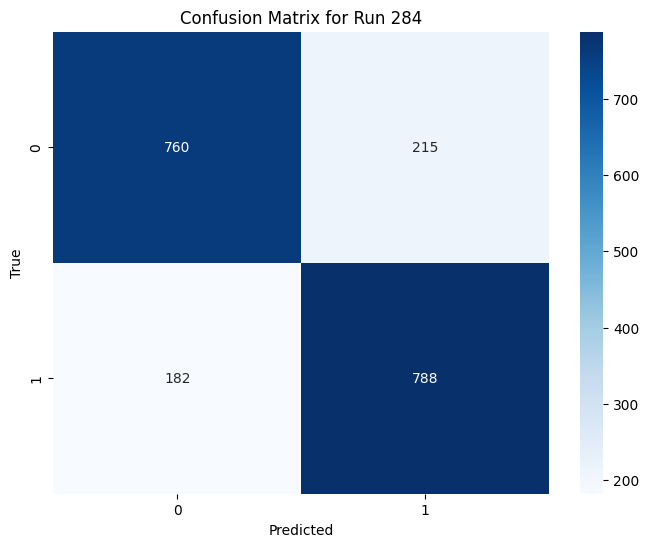

Run 285: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 3, 1: 2}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7706 - loss: 0.1944 - val_accuracy: 0.8062 - val_loss: 0.0728
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8098 - loss: 0.1651 - val_accuracy: 0.7789 - val_loss: 0.0805
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8096 - loss: 0.1608 - val_accuracy: 0.8041 - val_loss: 0.0750
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8279 - loss: 0.1507 - val_accuracy: 0.8175 - val_loss: 0.0748
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.8296 - loss: 0.1497 - val_accuracy: 0.8226 - val_loss: 0.0740
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8328 - loss: 0.1517 - val_accuracy: 0.8252 - val_loss: 0.0730
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8379

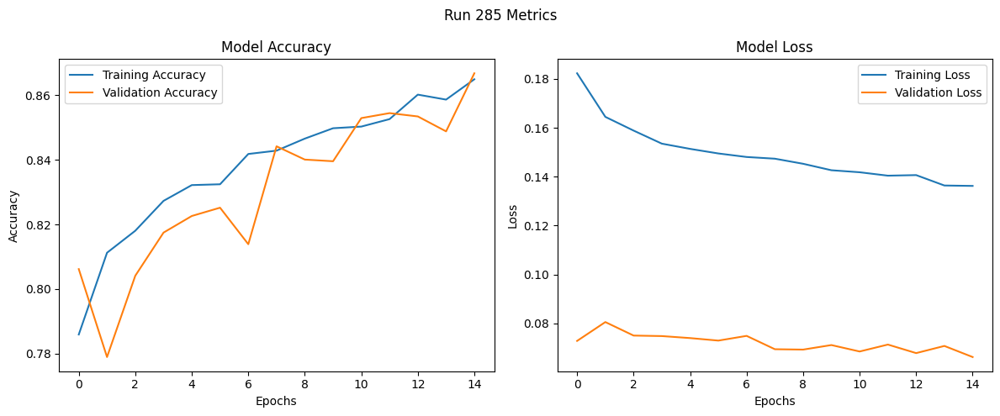

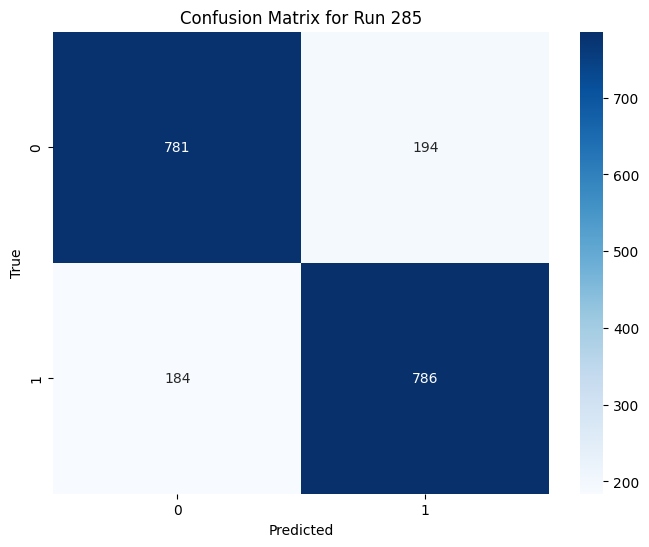

Run 286: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.005
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7660 - loss: 0.2816 - val_accuracy: 0.8021 - val_loss: 0.0737
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.8130 - loss: 0.2287 - val_accuracy: 0.8180 - val_loss: 0.0702
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8215 - loss: 0.2175 - val_accuracy: 0.8108 - val_loss: 0.0731
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8365 - loss: 0.2041 - val_accuracy: 0.8339 - val_loss: 0.0677
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8458 - loss: 0.1996 - val_accuracy: 0.8442 - val_loss: 0.0660
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8460 - loss: 0.1946 - val_accuracy: 0.8201 - val_loss: 0.0731
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.842

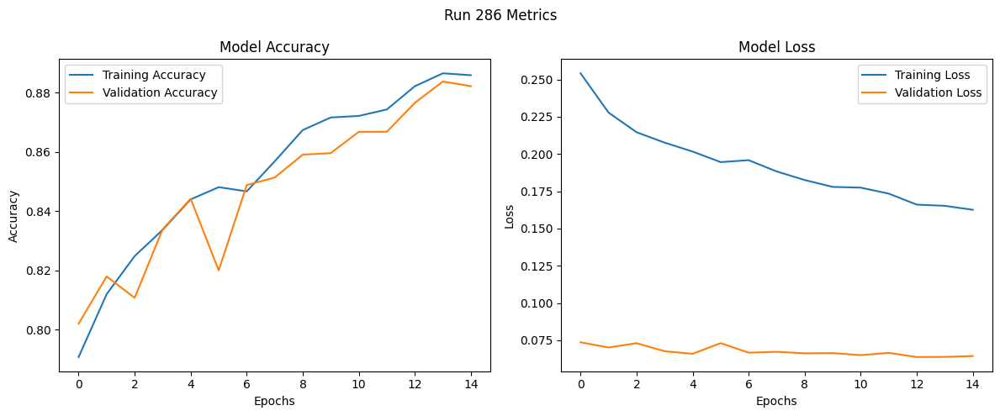

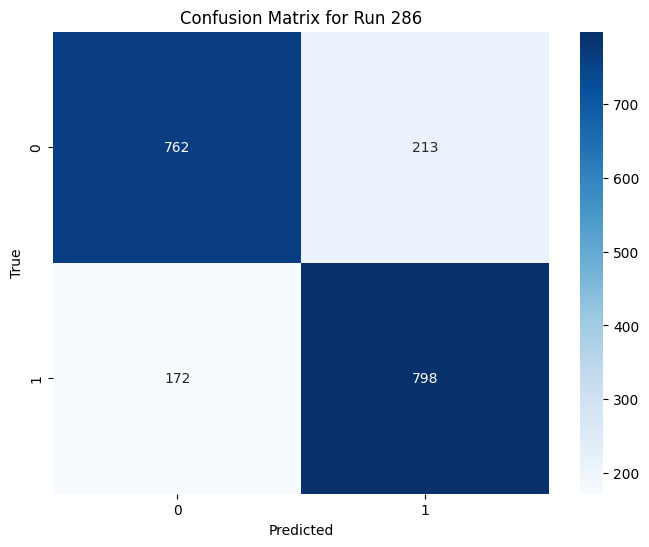

Run 287: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.0075
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step - accuracy: 0.7741 - loss: 0.2702 - val_accuracy: 0.7949 - val_loss: 0.0762
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 2s 8ms/step - accuracy: 0.8047 - loss: 0.2340 - val_accuracy: 0.8026 - val_loss: 0.0746
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8268 - loss: 0.2146 - val_accuracy: 0.8144 - val_loss: 0.0720
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8336 - loss: 0.2117 - val_accuracy: 0.8257 - val_loss: 0.0724
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8335 - loss: 0.2098 - val_accuracy: 0.8293 - val_loss: 0.0728
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8464 - loss: 0.2006 - val_accuracy: 0.8046 - val_loss: 0.0783
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.84

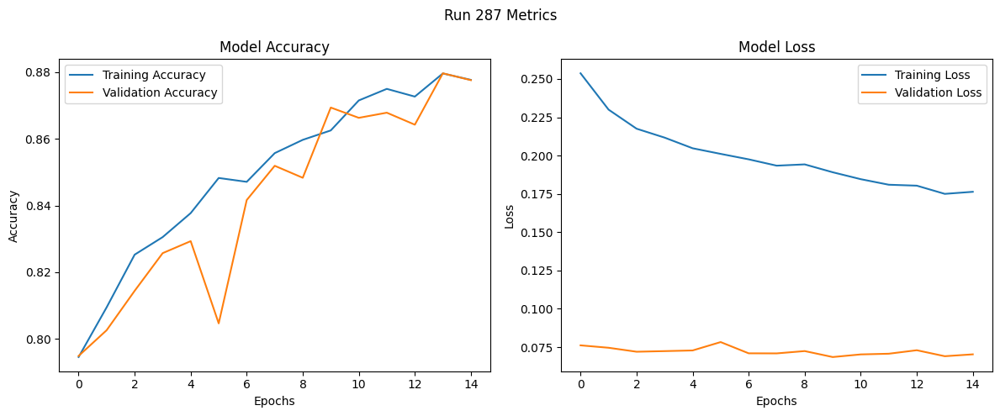

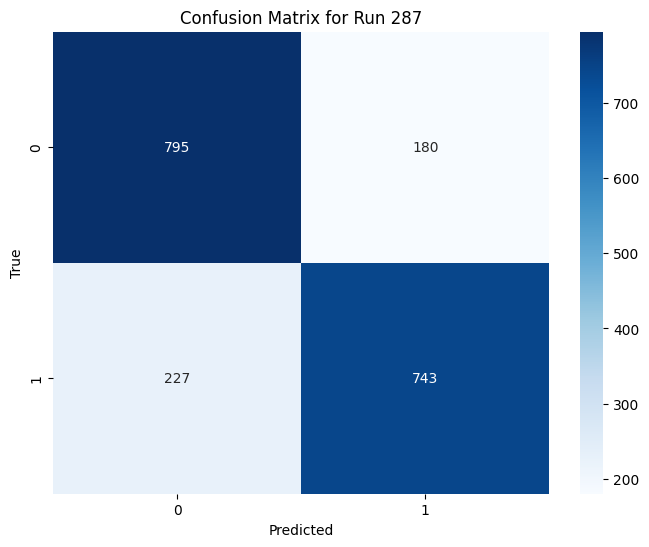

Run 288: L2: 5e-05, Dropout: 0.2, Layers: [256, 128], Activation: relu, Loss: log_cosh, Threshold: 0.55, Class Weights: {0: 4, 1: 3}, Learning Rate: 0.01
Epoch 1/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.7539 - loss: 0.2809 - val_accuracy: 0.7969 - val_loss: 0.0761
Epoch 2/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8005 - loss: 0.2362 - val_accuracy: 0.8098 - val_loss: 0.0742
Epoch 3/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8200 - loss: 0.2235 - val_accuracy: 0.8098 - val_loss: 0.0795
Epoch 4/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8258 - loss: 0.2212 - val_accuracy: 0.8252 - val_loss: 0.0740
Epoch 5/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8417 - loss: 0.2045 - val_accuracy: 0.8370 - val_loss: 0.0724
Epoch 6/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.8340 - loss: 0.2153 - val_accuracy: 0.8298 - val_loss: 0.0753
Epoch 7/100
122/122 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.8439

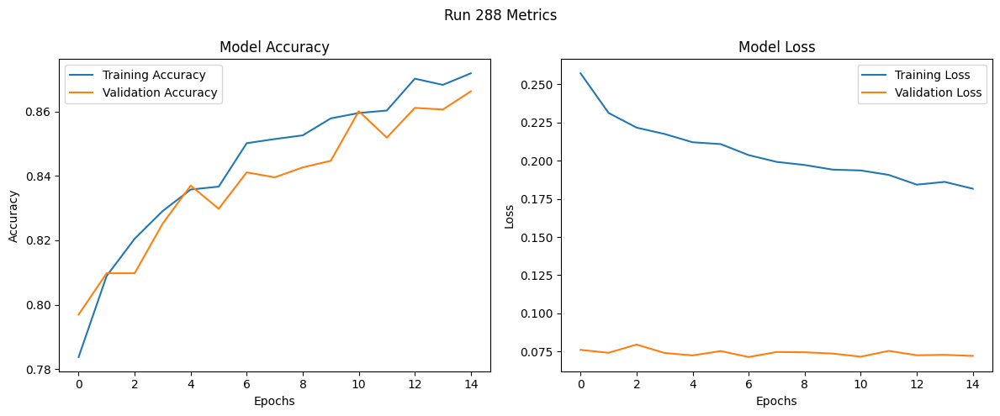

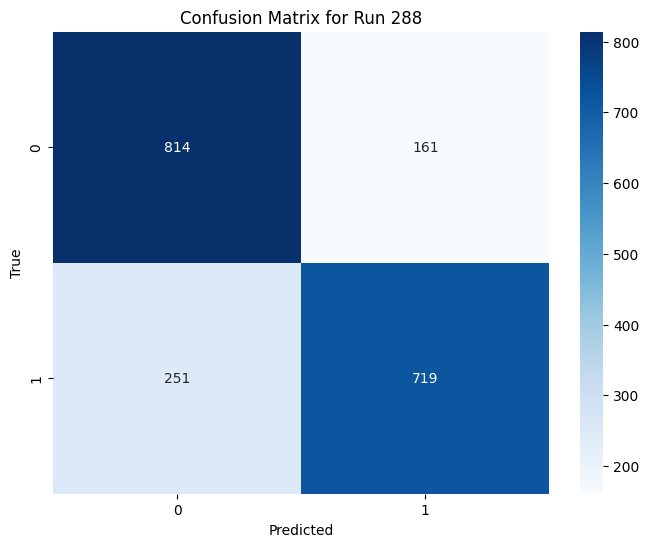

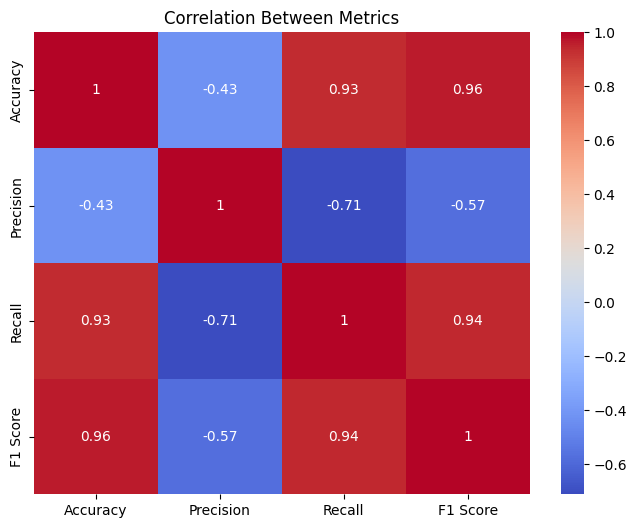

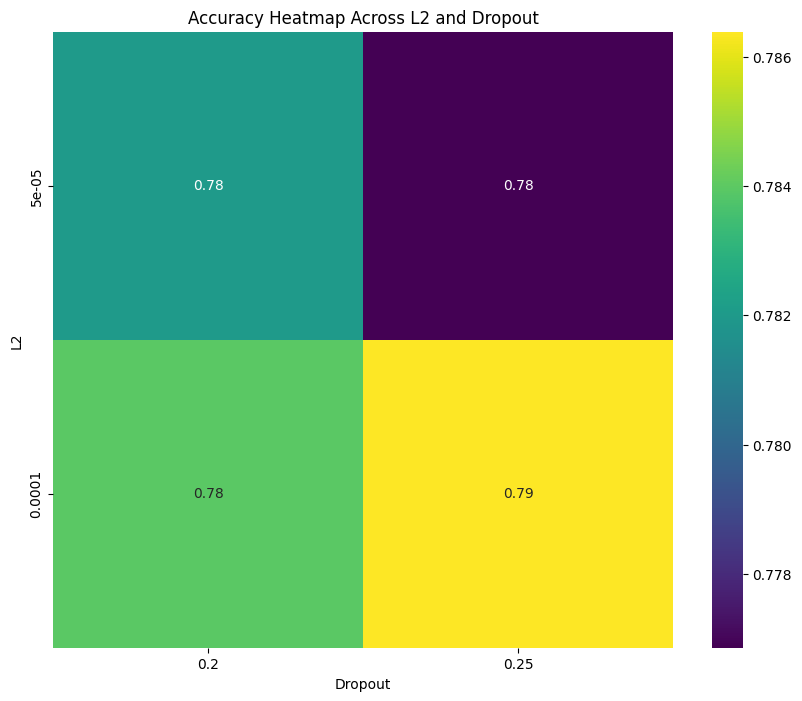

/usr/local/lib/python3.11/dist-packages/seaborn/categorical.py:3399: UserWarning: 15.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.11/dist-packages/seaborn/categorical.py:3399: UserWarning: 10.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


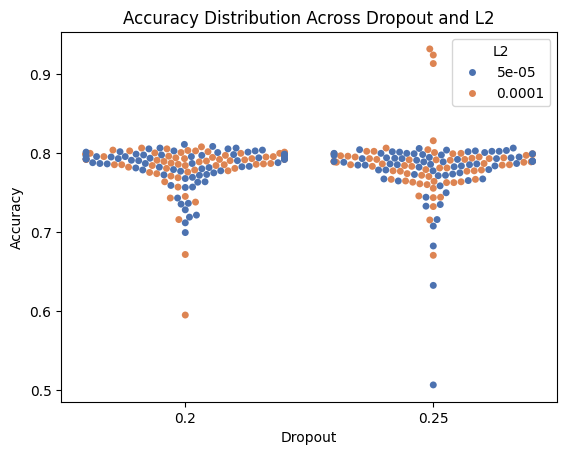

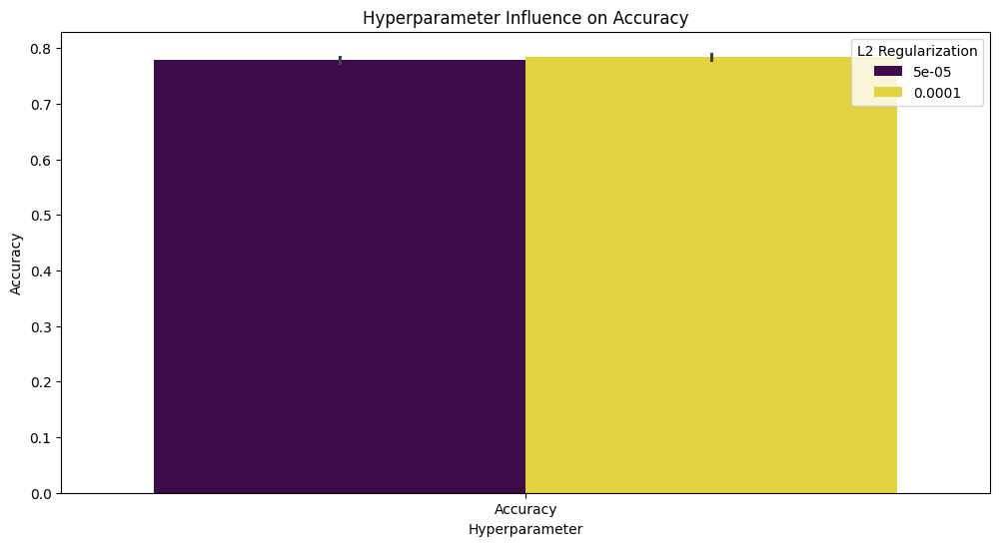

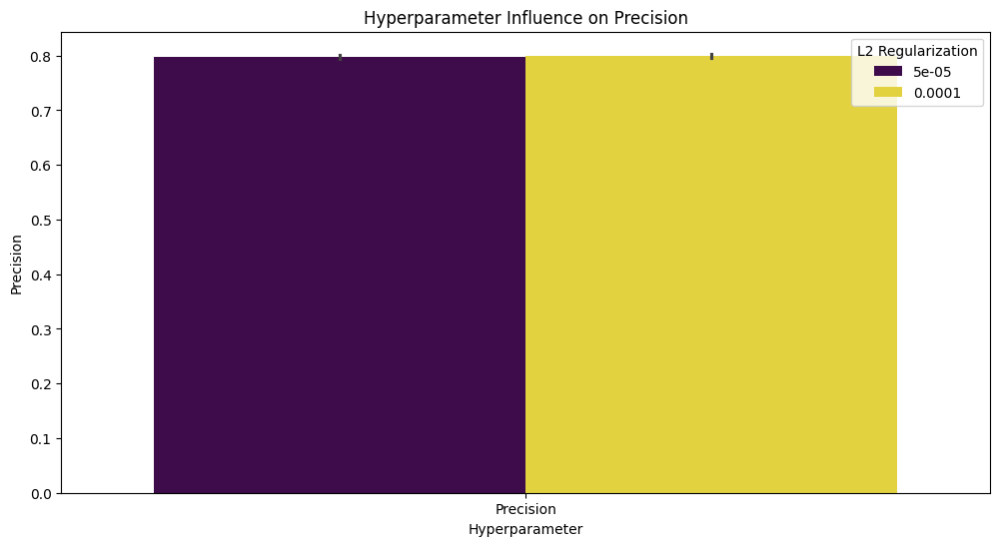

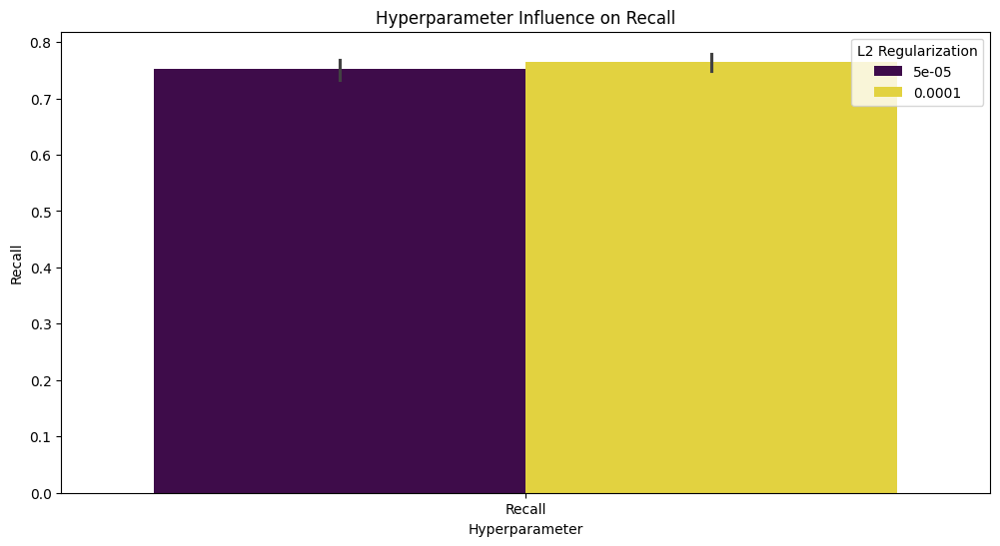

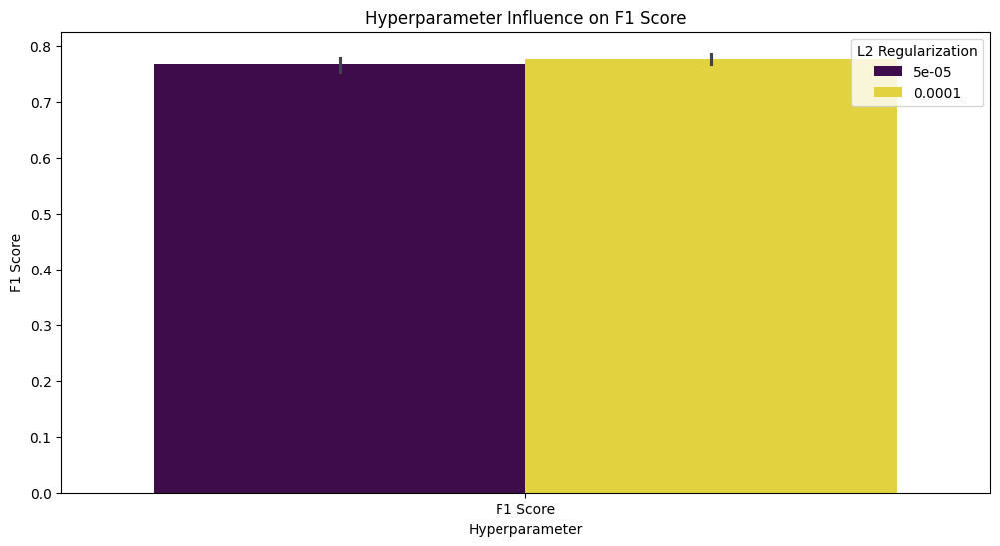

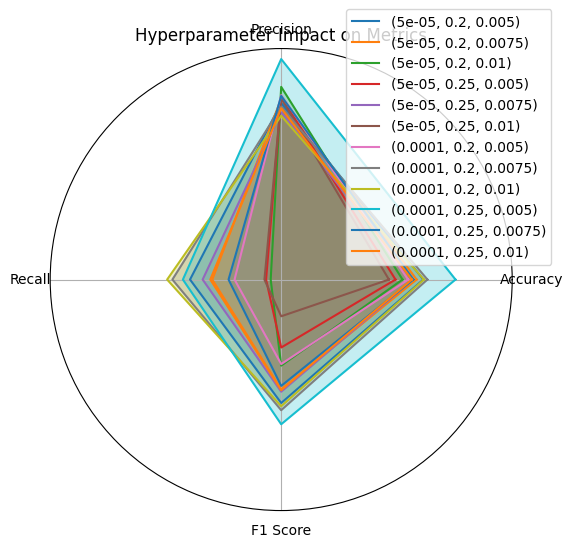

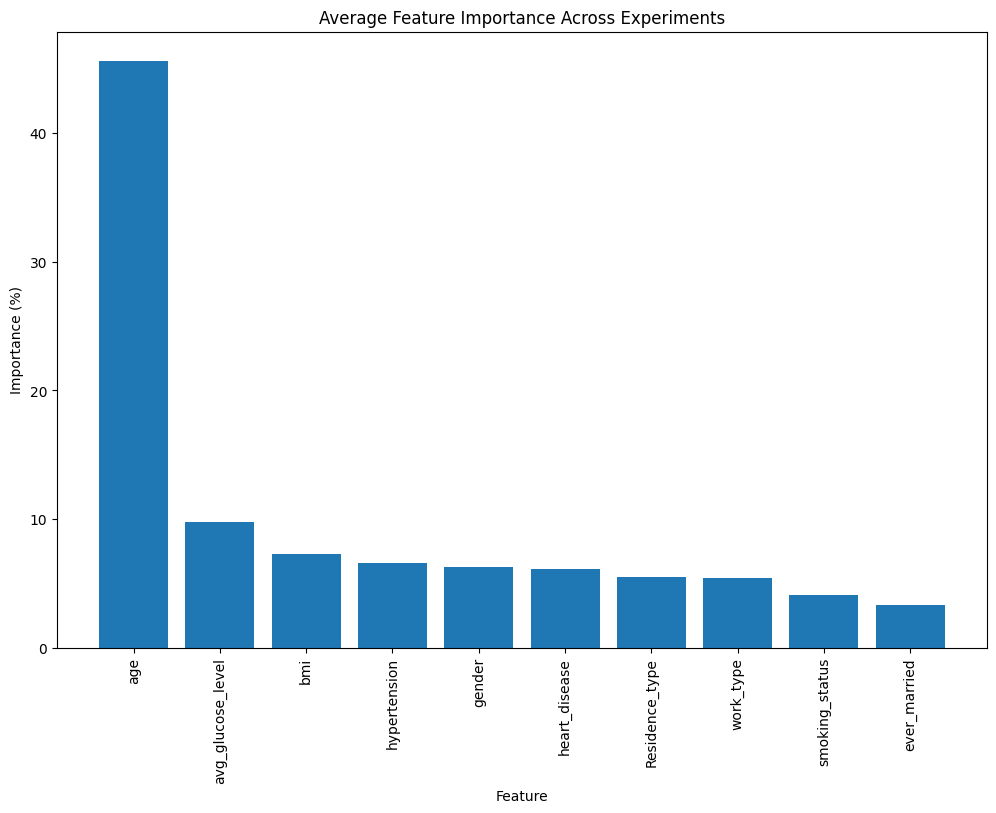

Top 3 Hyperparameter Combinations for F1 Score:
        L2  Dropout     Layers Activation             Loss Function  \
0   0.0001     0.25  [128, 64]       relu  categorical_crossentropy   
12  0.0001     0.25  [128, 64]       relu        mean_squared_error   
24  0.0001     0.25  [128, 64]       relu                  log_cosh   

   Class Weights  Learning Rate  F1 Score  
0   {0: 3, 1: 2}          0.005  0.934718  
12  {0: 3, 1: 2}          0.005  0.925267  
24  {0: 3, 1: 2}          0.005  0.916501  


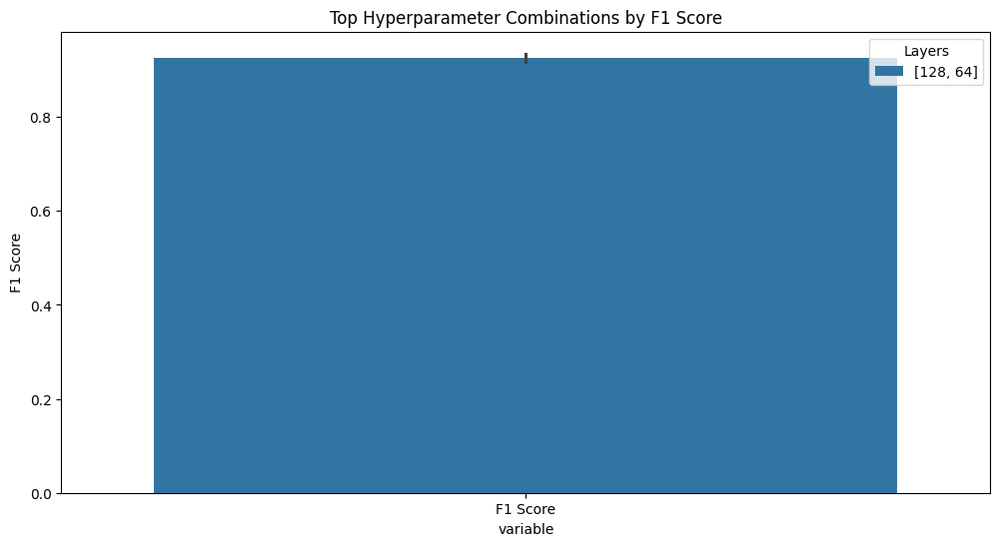

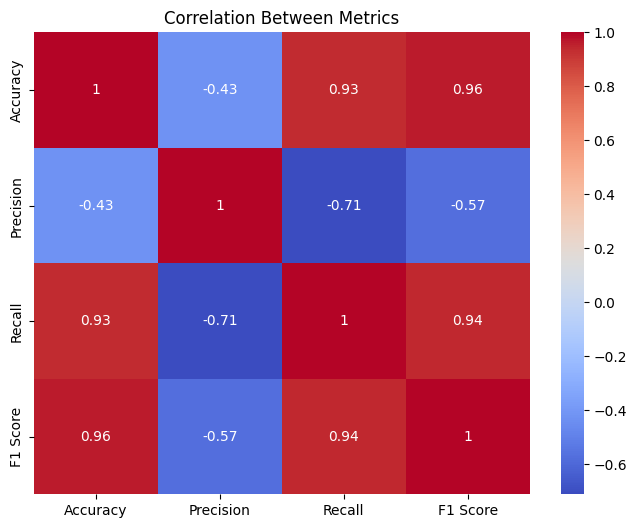

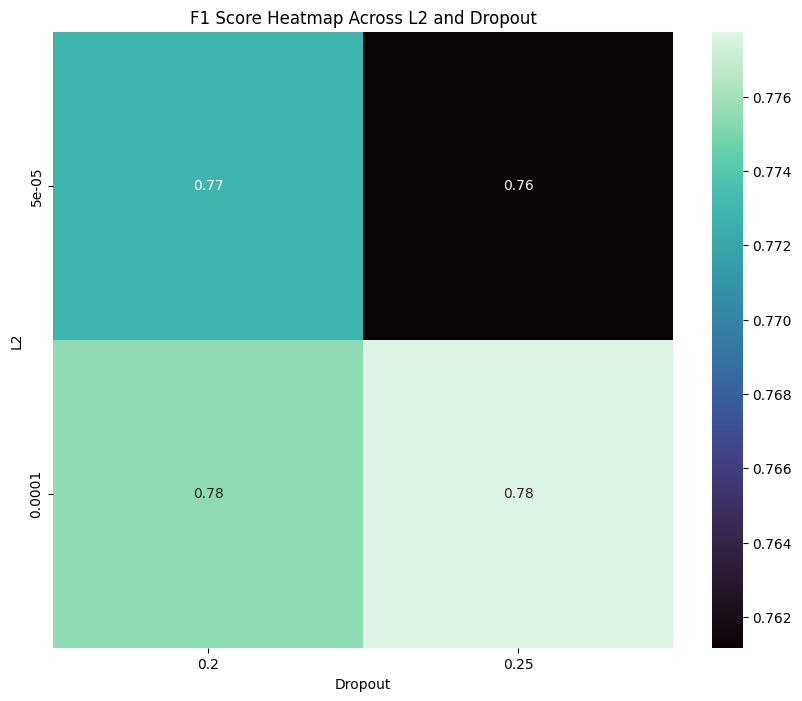

In [ ]:
import tensorflow as tf
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler

def calculate_feature_importance(model, X, y, feature_names):
    importances = []
    baseline_pred = model.predict(X, verbose=0)[:, 1]

    for i in range(X.shape[1]):
        X_temp = X.copy()
        col_mean = np.mean(X_temp[:, i])
        X_temp[:, i] = col_mean
        new_pred = model.predict(X_temp, verbose=0)[:, 1]
        importance = np.mean(np.abs(baseline_pred - new_pred))
        importances.append(importance)

    total = sum(importances) if sum(importances) != 0 else 1
    percentages = [100 * imp/total for imp in importances]

    df = pd.DataFrame({
        'Feature': feature_names,
        'Importance (%)': np.round(percentages, 2)
    })
    return df.sort_values('Importance (%)', ascending=False)

def load_data():
    X = data.drop('stroke', axis=1)
    y = data['stroke']

    # Normalize features
    scaler = StandardScaler()
    X = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)

    # Apply SMOTE
    smote = SMOTE(random_state=42)
    X_resampled, y_resampled = smote.fit_resample(X, y)

    # Train-validation split
    X_train, X_val, y_train, y_val = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42)

    X_train = X_train.to_numpy()
    X_val = X_val.to_numpy()

    y_train = tf.keras.utils.to_categorical(y_train, num_classes=2)
    y_val = tf.keras.utils.to_categorical(y_val, num_classes=2)

    return (X_train, y_train), (X_val, y_val), X.columns.tolist()

# Rest of your code remains the same starting from:
(x_train, y_train), (x_val, y_val), feature_names = load_data()

# Hyperparameter configurations to test
l2_values = [0.0001, 0.00005]
dropout_values = [0.25, 0.2]
layer_configurations = [
    [128, 64],
    [256, 128]
]
activation_functions = [
    'relu'
]
loss_functions = [
    tf.keras.losses.CategoricalCrossentropy(),
    tf.keras.losses.MeanSquaredError(),
    tf.keras.losses.LogCosh()
]
threshold_values = [0.5, 0.55]
class_weight_config = [{0: 3, 1: 2}, {0: 4, 1: 3}]
learning_rates = [0.005, 0.0075, 0.01]

# Early stopping configuration
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=15, restore_best_weights=True)

results = []
run_number = 1
feature_importances = []

# Loop through configurations
for l2_reg in l2_values:
    for dropout_rate in dropout_values:
        for layer_config in layer_configurations:
            for activation in activation_functions:
                for loss_function in loss_functions:
                  for threshold in threshold_values:
                    for class_weights in class_weight_config:
                        for lr in learning_rates:
                            print(f"Run {run_number}: L2: {l2_reg}, Dropout: {dropout_rate}, Layers: {layer_config}, Activation: {activation}, Loss: {loss_function.name}, Threshold: {threshold}, Class Weights: {class_weights}, Learning Rate: {lr}")

                            try:
                                # Build the model
                                model = Sequential()
                                for units in layer_config:
                                    model.add(Dense(units, activation=activation, kernel_regularizer=tf.keras.regularizers.l2(l2_reg)))
                                    model.add(Dropout(dropout_rate))
                                model.add(Dense(2, activation='sigmoid'))

                                # Compile the model
                                model.compile(optimizer=Adam(learning_rate=lr), loss=loss_function, metrics=['accuracy'])

                                # Train the model
                                history = model.fit(
                                    x_train, y_train,
                                    validation_data=(x_val, y_val),
                                    class_weight=class_weights,
                                    batch_size=64,
                                    epochs=100,
                                    verbose=1,
                                    callbacks=[early_stopping]
                                )

                                # Evaluate the model
                                y_pred_prob = model.predict(x_val, verbose=0)
                                y_pred = (y_pred_prob[:, 1] >= threshold).astype(int)
                                y_true = np.argmax(y_val, axis=1)

                                precision = precision_score(y_true, y_pred, zero_division=1)
                                recall = recall_score(y_true, y_pred, zero_division=1)
                                f1 = f1_score(y_true, y_pred, zero_division=1)
                                accuracy = accuracy_score(y_true, y_pred)

                                val_loss = history.history['val_loss'][-1] if history.history['val_loss'] else None
                                val_accuracy = history.history['val_accuracy'][-1] if history.history['val_accuracy'] else None

                                print(f"Metrics: Accuracy: {accuracy:.4f}, Val Accuracy: {val_accuracy:.4f}, Val Loss: {val_loss:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1 Score: {f1:.4f}")

                                results.append({
                                    'Run': run_number,
                                    'L2': l2_reg,
                                    'Dropout': dropout_rate,
                                    'Layers': str(layer_config),
                                    'Activation': activation,
                                    'Loss Function': loss_function.name,
                                    'Class Weights': str(class_weights),
                                    'Learning Rate': lr,
                                    'Accuracy': accuracy,
                                    'Precision': precision,
                                    'Recall': recall,
                                    'F1 Score': f1,
                                    'Val Loss': val_loss
                                })

                                # Calculate feature importance
                                importance_df = calculate_feature_importance(
                                    model,
                                    x_val,
                                    np.argmax(y_val, axis=1),
                                    feature_names  # Add your feature names here
                                )

                                # Save feature importance for this run
                                importance_df['Run'] = run_number
                                feature_importances.append(importance_df)

                                # Print feature importance
                                print(f"\nFeature Importance for Run {run_number}:")
                                print(importance_df.to_string(index=False))

                                # Plot individual run metrics
                                fig, axes = plt.subplots(1, 2, figsize=(12, 5))
                                axes[0].plot(history.history['accuracy'], label='Training Accuracy')
                                axes[0].plot(history.history['val_accuracy'], label='Validation Accuracy')
                                axes[0].set_title('Model Accuracy')
                                axes[0].set_xlabel('Epochs')
                                axes[0].set_ylabel('Accuracy')
                                axes[0].legend()

                                axes[1].plot(history.history['loss'], label='Training Loss')
                                axes[1].plot(history.history['val_loss'], label='Validation Loss')
                                axes[1].set_title('Model Loss')
                                axes[1].set_xlabel('Epochs')
                                axes[1].set_ylabel('Loss')
                                axes[1].legend()

                                plt.suptitle(f'Run {run_number} Metrics')
                                plt.tight_layout()
                                plt.show()
                                plt.close(fig)

                                cm = confusion_matrix(y_true, y_pred)
                                plt.figure(figsize=(8, 6))
                                sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
                                plt.title(f'Confusion Matrix for Run {run_number}')
                                plt.xlabel('Predicted')
                                plt.ylabel('True')
                                plt.show()

                            except Exception as e:
                                print(f"Error in Run {run_number}: {e}")

                            run_number += 1

# Convert results to a DataFrame
results_df = pd.DataFrame(results)

all_importances = pd.concat(feature_importances)
all_importances.to_csv('feature_importances5.csv', index=False)

# Save results to a CSV file
results_df.to_csv('test17_results.csv', index=False)

# Feature impact on predictions (Correlation Heatmap)
corr_matrix = results_df[['Accuracy', 'Precision', 'Recall', 'F1 Score']].corr()
plt.figure(figsize=(8, 6))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Between Metrics')
plt.show()

# Hyperparameter Tuning Performance Comparison
heatmap_data = results_df.pivot_table(index='L2', columns='Dropout', values='Accuracy')
plt.figure(figsize=(10, 8))
sns.heatmap(heatmap_data, annot=True, cmap='viridis')
plt.title('Accuracy Heatmap Across L2 and Dropout')
plt.show()

# Model Performance Across Hyperparameter Configurations
sns.swarmplot(data=results_df, x='Dropout', y='Accuracy', hue='L2', palette='deep')
plt.title('Accuracy Distribution Across Dropout and L2')
plt.show()

# Visualize hyperparameter influence on metrics
hyperparams = ['L2', 'Dropout', 'Learning Rate']
metrics = ['Accuracy', 'Precision', 'Recall', 'F1 Score']

for metric in metrics:
    plt.figure(figsize=(12, 6))
    sns.barplot(data=results_df.melt(id_vars=hyperparams, value_vars=[metric]),
                x='variable', y='value', hue='L2', palette='viridis')
    plt.title(f'Hyperparameter Influence on {metric}')
    plt.xlabel('Hyperparameter')
    plt.ylabel(metric)
    plt.legend(title='L2 Regularization')
    plt.show()

# Radar/Spider chart for hyperparameter impact
from math import pi

averaged_metrics = results_df.groupby(['L2', 'Dropout', 'Learning Rate']).mean(numeric_only=True)[['Accuracy', 'Precision', 'Recall', 'F1 Score']]

def radar_chart(data, metrics):
    if data.empty:
        print("No data available for radar chart.")
        return

    labels = metrics
    num_vars = len(labels)

    angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
    angles += angles[:1]

    fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))
    for idx, row in data.iterrows():
        values = row[metrics].tolist()
        values += values[:1]
        ax.plot(angles, values, label=str(idx))
        ax.fill(angles, values, alpha=0.25)

    ax.set_yticks([])
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(labels)
    ax.legend(loc='upper right', bbox_to_anchor=(1.1, 1.1))
    plt.title('Hyperparameter Impact on Metrics')
    plt.show()

radar_chart(averaged_metrics, ['Accuracy', 'Precision', 'Recall', 'F1 Score'])

# Average feature importance across experiments
avg_importances = all_importances.groupby('Feature')['Importance (%)'].mean().sort_values(ascending=False)
plt.figure(figsize=(12, 8))
plt.bar(avg_importances.index, avg_importances.values)
plt.xticks(rotation=90)
plt.title('Average Feature Importance Across Experiments')
plt.ylabel('Importance (%)')
plt.xlabel('Feature')
plt.show()

# Top hyperparameter combinations for F1 score
top_f1_scores = results_df.nlargest(3, 'F1 Score')
print("Top 3 Hyperparameter Combinations for F1 Score:")
print(top_f1_scores[['L2', 'Dropout', 'Layers', 'Activation', 'Loss Function', 'Class Weights', 'Learning Rate', 'F1 Score']])

# Barplot of hyperparameter combination vs F1 score
plt.figure(figsize=(12, 6))
sns.barplot(data=top_f1_scores.melt(id_vars=['L2', 'Dropout', 'Layers', 'Activation', 'Loss Function', 'Class Weights', 'Learning Rate'],
                                    value_vars=['F1 Score']), x='variable', y='value', hue='Layers')
plt.title('Top Hyperparameter Combinations by F1 Score')
plt.ylabel('F1 Score')
plt.show()

# Correlation heatmap for all metrics
corr_matrix = results_df[['Accuracy', 'Precision', 'Recall', 'F1 Score']].corr()
plt.figure(figsize=(8, 6))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Between Metrics')
plt.show()

# Heatmap for F1 Score
heatmap_data_f1 = results_df.pivot_table(index='L2', columns='Dropout', values='F1 Score')
plt.figure(figsize=(10, 8))
sns.heatmap(heatmap_data_f1, annot=True, cmap='mako')
plt.title('F1 Score Heatmap Across L2 and Dropout')
plt.show()


In [ ]:
pip install pytorch-tabnet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.5/44.5 kB 2.0 MB/s eta 0:00:00


In [ ]:
pip install catboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 MB 4.2 MB/s eta 0:00:00


# Second model- CatBoostClassifier

In [ ]:
import numpy as np
import pandas as pd
from catboost import CatBoostClassifier
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score, roc_auc_score
from imblearn.combine import SMOTETomek
from sklearn.model_selection import train_test_split, ParameterGrid
from sklearn.preprocessing import LabelEncoder, StandardScaler

# Load and preprocess dataset
target = 'stroke'
features = [col for col in data.columns if col != target]

# Encode categorical columns
label_encoders = {}
for col in data.select_dtypes(include=['object', 'category']).columns:
    le = LabelEncoder()
    data[col] = le.fit_transform(data[col].astype(str))
    label_encoders[col] = le

# Split data into train and test sets
X = data[features]
y = data[target]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

# Handle class imbalance using SMOTE-Tomek
smote_tomek = SMOTETomek(random_state=42)
X_train_resampled, y_train_resampled = smote_tomek.fit_resample(X_train, y_train)
print("Resampled class distribution:", np.bincount(y_train_resampled))

# Scale the data
scaler = StandardScaler()
X_train_resampled = scaler.fit_transform(X_train_resampled)
X_test = scaler.transform(X_test)

# Define a diverse parameter grid for tuning with dropout-like behavior and threshold tuning
param_grid = [
    {
        'depth': [2, 4, 6, 12],                  # Include very shallow and deeper trees
        'learning_rate': [0.005, 0.01, 0.05],   # Very small learning rates
        'iterations': [500, 1000, 2000],        # More iterations for exploration
        'l2_leaf_reg': [1, 10, 50],             # Include much higher regularization
        'class_weights': [[1, 20], [1, 10], [1, 5]],  # Adjusted class weights
        'loss_function': ['Logloss'],           # Supported with class weights
        'bagging_temperature': [0, 2, 5],       # Higher randomness in sampling
        'random_strength': [0, 10, 20]          # Higher randomness in splits
    },
    {
        'depth': [2, 4, 6, 12],
        'learning_rate': [0.005, 0.01, 0.05],
        'iterations': [500, 1000, 2000],
        'l2_leaf_reg': [1, 10, 50],
        'loss_function': ['CrossEntropy'],      # Not using class weights
        'bagging_temperature': [0, 2, 5],
        'random_strength': [0, 10, 20]
    }
]


# Initialize variables for tracking the best model
best_f1 = 0
best_params = None
best_model = None

# Perform grid search
for params in ParameterGrid(param_grid):
    print(f"Training with params: {params}")
    model = CatBoostClassifier(
        depth=params['depth'],
        learning_rate=params['learning_rate'],
        iterations=params['iterations'],
        l2_leaf_reg=params['l2_leaf_reg'],
        loss_function=params['loss_function'],
        eval_metric='F1',
        random_seed=42,
        verbose=False,
        bagging_temperature=params['bagging_temperature'],
        random_strength=params['random_strength'],
        class_weights=params.get('class_weights')  # Use class weights only if defined
    )
    # Train the model
    model.fit(
        X_train_resampled, y_train_resampled,
        eval_set=(X_test, y_test),
        early_stopping_rounds=50
    )

    # Predictions and evaluation
    pred_probs = model.predict_proba(X_test)[:, 1]

    # Threshold tuning
    thresholds = np.arange(0.1, 0.9, 0.1)
    for threshold in thresholds:
        predictions = (pred_probs >= threshold).astype(int)
        f1 = f1_score(y_test, predictions)
        if f1 > best_f1:
            best_f1 = f1
            best_params = {**params, 'threshold': threshold}
            best_model = model

# Print the best parameters and scores
print(f"Best Parameters: {best_params}")
print(f"Best F1 Score: {best_f1:.4f}")

# Evaluate the best model
pred_probs = best_model.predict_proba(X_test)[:, 1]
predictions = (pred_probs >= best_params['threshold']).astype(int)
precision = precision_score(y_test, predictions, zero_division=1)
recall = recall_score(y_test, predictions, zero_division=1)
f1 = f1_score(y_test, predictions, zero_division=1)
accuracy = accuracy_score(y_test, predictions)
roc_auc = roc_auc_score(y_test, pred_probs)

print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")
print(f"Accuracy: {accuracy:.4f}")
print(f"ROC AUC: {roc_auc:.4f}")

# Feature importance analysis
feature_importances = best_model.get_feature_importance()
feature_names = features  # Assuming 'features' contains the feature names
importance_with_names = sorted(zip(feature_names, feature_importances), key=lambda x: x[1], reverse=True)
print("Feature Importances:")
for name, importance in importance_with_names:
    print(f"{name}: {importance:.4f}")


Resampled class distribution: [3855 3855]
Training with params: {'bagging_temperature': 0, 'class_weights': [1, 20], 'depth': 2, 'iterations': 500, 'l2_leaf_reg': 1, 'learning_rate': 0.005, 'loss_function': 'Logloss', 'random_strength': 0}
Training with params: {'bagging_temperature': 0, 'class_weights': [1, 20], 'depth': 2, 'iterations': 500, 'l2_leaf_reg': 1, 'learning_rate': 0.005, 'loss_function': 'Logloss', 'random_strength': 10}
Training with params: {'bagging_temperature': 0, 'class_weights': [1, 20], 'depth': 2, 'iterations': 500, 'l2_leaf_reg': 1, 'learning_rate': 0.005, 'loss_function': 'Logloss', 'random_strength': 20}
Training with params: {'bagging_temperature': 0, 'class_weights': [1, 20], 'depth': 2, 'iterations': 500, 'l2_leaf_reg': 1, 'learning_rate': 0.01, 'loss_function': 'Logloss', 'random_strength': 0}
Training with params: {'bagging_temperature': 0, 'class_weights': [1, 20], 'depth': 2, 'iterations': 500, 'l2_leaf_reg': 1, 'learning_rate': 0.01, 'loss_function': '